In [40]:
""" USEFUL WEBSITES
https://www.kaggle.com/code/ravi20076/playgrounds5e01-public-baseline-v1#KEY-NOTE
https://www.kaggle.com/competitions/playground-series-s5e1/discussion/554349
https://www.kaggle.com/code/curtiscoding1/linear-reg-model-analysis-walk-forward-val#Model-Analysis-&-Validation
https://www.kaggle.com/code/jiaoyouzhang/fss-lightgbm-holidays-fitter
https://www.kaggle.com/code/sunilkumarmuduli/complete-tutorial-model-time-series-eda

Current plan, try elastinet using optuna to test which ratio works best

submission did rather poorly, I think it may be overfitted cause the cv_score performed siginificantly better
I will impute the values first, then I may attempt to check for multicolliearity unless someone else 
decides to do that sooner.
https://www.kaggle.com/code/sidcodegg/linearmodel-keep-it-simple-silly
use this model and do forward backward selection for ridge cause this model did quite poor
"""
"""
Do competition below immediately after this one finishes as it is similar
https://www.kaggle.com/competitions/playground-series-s5e1/discussion/554772
"""


In [39]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
import holidays
import optuna
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score, TimeSeriesSplit, GridSearchCV
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import LabelEncoder
import lightgbm as lgb
from sklearn.model_selection import KFold
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.statespace.sarimax import SARIMAX
from scipy.stats import boxcox
from scipy.special import inv_boxcox

df = pd.read_csv("train.csv")
df["date"] = pd.to_datetime(df["date"])

In [ ]:
df.head()

In [3]:
print(df.dtypes)
print(df.shape)

id            int64
date         object
country      object
store        object
product      object
num_sold    float64
dtype: object
(230130, 6)


In [4]:
print(df.isnull().sum()/len(df) * 100)
print(df.duplicated().sum())

id          0.000000
date        0.000000
country     0.000000
store       0.000000
product     0.000000
num_sold    3.854778
dtype: float64
0


In [7]:
for i in df.columns:
    if (i == "id") or (i == "num_sold"):
        continue
    print(i + " Unique Values: " + str(df[i].nunique()))

date Unique Values: 2557
country Unique Values: 6
store Unique Values: 3
product Unique Values: 5


In [12]:
for i in df.columns:
    if i == "id" or i == "num_sold":
        continue
    print(df[i].value_counts())
    print("")

date
2010-01-01    90
2014-09-05    90
2014-08-29    90
2014-08-30    90
2014-08-31    90
              ..
2012-05-03    90
2012-05-04    90
2012-05-05    90
2012-05-06    90
2016-12-31    90
Name: count, Length: 2557, dtype: int64

country
Canada       38355
Finland      38355
Italy        38355
Kenya        38355
Norway       38355
Singapore    38355
Name: count, dtype: int64

store
Discount Stickers       76710
Stickers for Less       76710
Premium Sticker Mart    76710
Name: count, dtype: int64

product
Holographic Goose     46026
Kaggle                46026
Kaggle Tiers          46026
Kerneler              46026
Kerneler Dark Mode    46026
Name: count, dtype: int64



In [26]:
for i in dfTest.columns:
    if i == "id" or i == "num_sold":
        continue
    print(dfTest[i].value_counts())
    print("")

date
2017-01-01    90
2018-12-30    90
2019-01-05    90
2019-01-04    90
2019-01-03    90
              ..
2018-01-07    90
2018-01-08    90
2018-01-09    90
2018-01-10    90
2019-12-31    90
Name: count, Length: 1095, dtype: int64

country
Canada       16425
Finland      16425
Italy        16425
Kenya        16425
Norway       16425
Singapore    16425
Name: count, dtype: int64

store
Discount Stickers       32850
Stickers for Less       32850
Premium Sticker Mart    32850
Name: count, dtype: int64

product
Holographic Goose     19710
Kaggle                19710
Kaggle Tiers          19710
Kerneler              19710
Kerneler Dark Mode    19710
Name: count, dtype: int64

year
2017    32850
2018    32850
2019    32850
Name: count, dtype: int64

month
1     8370
3     8370
5     8370
7     8370
8     8370
10    8370
12    8370
4     8100
6     8100
9     8100
11    8100
2     7560
Name: count, dtype: int64

day
1     3240
2     3240
28    3240
27    3240
26    3240
25    3240
24    3240


In [40]:
""" Credited to this https://www.kaggle.com/code/cabaxiom/s5e1-eda-and-linear-regression-baseline?scriptVersionId=216127469
I thought about creating this myself but there isn't really any poitn to that if this is shared, from future onwards
using ratios of relavant data as a means of imputing is viable and the best-performing datasets do this and either use lienar regression or fine-tune using optuna"""
gdp_per_capita_df = pd.read_csv("gdp.csv")

years =  ["2010", "2011", "2012", "2013", "2014", "2015", "2016", "2017", "2018", "2019", "2020"]
gdp_per_capita_filtered_df = gdp_per_capita_df.loc[gdp_per_capita_df["Country Name"].isin(df["country"].unique()), ["Country Name"] + years].set_index("Country Name")
gdp_to_merge = gdp_per_capita_filtered_df
gdp_per_capita_filtered_df["2010_ratio"] = gdp_per_capita_filtered_df["2010"] / gdp_per_capita_filtered_df.sum()["2010"]
for year in years:
    gdp_per_capita_filtered_df[f"{year}_ratio"] = gdp_per_capita_filtered_df[year] / gdp_per_capita_filtered_df.sum()[year]
gdp_per_capita_filtered_ratios_df = gdp_per_capita_filtered_df[[i+"_ratio" for i in years]]
gdp_per_capita_filtered_ratios_df.columns = [int(i) for i in years]
gdp_per_capita_filtered_ratios_df = gdp_per_capita_filtered_ratios_df.unstack().reset_index().rename(columns = {"level_0": "year", 0: "ratio", "Country Name": "country"})
gdp_per_capita_filtered_ratios_df['year'] = pd.to_datetime(gdp_per_capita_filtered_ratios_df['year'], format='%Y')
gdp_per_capita_filtered_df

,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,...,2011_ratio,2012_ratio,2013_ratio,2014_ratio,2015_ratio,2016_ratio,2017_ratio,2018_ratio,2019_ratio,2020_ratio
Country Name,,,,,,,,,,,,,,,,,,,,,
Canada,47560.666600,52223.858840,52670.344730,52638.118720,50960.843120,43594.194100,42314.061580,45129.628120,46539.176160,46352.869340,...,0.175045,0.178867,0.175479,0.173632,0.175439,0.171860,0.171772,0.164793,0.169793,0.169942
Finland,46506.291900,51060.324260,47551.674080,49691.014520,50073.776080,42560.345680,43451.256240,46085.017470,49654.249700,48358.180780,...,0.171145,0.161484,0.165654,0.170609,0.171278,0.176478,0.175408,0.175823,0.177138,0.190594
Italy,36184.711870,38851.388130,35235.798910,35747.707950,35750.719750,30387.129320,31126.324690,32554.146680,34746.344140,33812.788720,...,0.130223,0.119660,0.119171,0.121808,0.122289,0.126420,0.123907,0.123035,0.123858,0.125263
Kenya,1091.518731,1096.144998,1285.005362,1370.878852,1482.815663,1489.119598,1554.126103,1667.484472,1836.452755,1960.408089,...,0.003674,0.004364,0.004570,0.005052,0.005993,0.006312,0.006347,0.006503,0.007181,0.007524
Norway,88163.208590,101221.813500,102175.919300,103553.840100,97666.695180,74809.965800,70867.361000,76131.838400,82792.842710,76430.588950,...,0.339278,0.346987,0.345215,0.332766,0.301063,0.287829,0.289772,0.293166,0.279969,0.266753
Singapore,47236.683080,53891.457030,55547.555310,56967.425790,57564.802310,55645.606860,56899.918180,61162.097390,66840.637340,66081.719920,...,0.180635,0.188638,0.189911,0.196132,0.223938,0.231100,0.232794,0.236680,0.242061,0.239924


In [41]:
""" credit https://www.kaggle.com/code/cabaxiom/s5e1-eda-and-linear-regression-baseline?scriptVersionId=216127469 """
gdp_per_capita_filtered_ratios_df["year"] = gdp_per_capita_filtered_ratios_df["year"].dt.year
df_imputed = df.copy()
print(f"Missing values remaining: {df_imputed['num_sold'].isna().sum()}")

df_imputed["year"] = df_imputed["date"].dt.year
for year in df_imputed["year"].unique():
    # Impute Time Series 1 (Canada, Discount Stickers, Holographic Goose)
    target_ratio = gdp_per_capita_filtered_ratios_df.loc[(gdp_per_capita_filtered_ratios_df["year"] == year) & (gdp_per_capita_filtered_ratios_df["country"] == "Norway"), "ratio"].values[0] # Using Norway as should have the best precision
    current_raito = gdp_per_capita_filtered_ratios_df.loc[(gdp_per_capita_filtered_ratios_df["year"] == year) & (gdp_per_capita_filtered_ratios_df["country"] == "Canada"), "ratio"].values[0]
    ratio_can = current_raito / target_ratio
    df_imputed.loc[(df_imputed["country"] == "Canada") & (df_imputed["store"] == "Discount Stickers") & 
    (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year), "num_sold"] = (df_imputed.loc[(df_imputed["country"] == "Norway") & (df_imputed["store"] == "Discount Stickers") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year), "num_sold"] * ratio_can).values
    
    # Impute Time Series 2 (Only Missing Values)
    current_ts =  df_imputed.loc[(df_imputed["country"] == "Canada") & (df_imputed["store"] == "Premium Sticker Mart") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year)]
    missing_ts_dates = current_ts.loc[current_ts["num_sold"].isna(), "date"]
    df_imputed.loc[(df_imputed["country"] == "Canada") & (df_imputed["store"] == "Premium Sticker Mart") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year) & (df_imputed["date"].isin(missing_ts_dates)), "num_sold"] = (df_imputed.loc[(df_imputed["country"] == "Norway") & (df_imputed["store"] == "Premium Sticker Mart") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year) & (df_imputed["date"].isin(missing_ts_dates)), "num_sold"] * ratio_can).values

    # Impute Time Series 3 (Only Missing Values)
    current_ts =  df_imputed.loc[(df_imputed["country"] == "Canada") & (df_imputed["store"] == "Stickers for Less") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year)]
    missing_ts_dates = current_ts.loc[current_ts["num_sold"].isna(), "date"]
    df_imputed.loc[(df_imputed["country"] == "Canada") & (df_imputed["store"] == "Stickers for Less") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year) & (df_imputed["date"].isin(missing_ts_dates)), "num_sold"] = (df_imputed.loc[(df_imputed["country"] == "Norway") & (df_imputed["store"] == "Stickers for Less") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year) & (df_imputed["date"].isin(missing_ts_dates)), "num_sold"] * ratio_can).values
    
    # Impute Time Series 4 (Kenya, Discount Stickers, Holographic Goose)
    current_raito = gdp_per_capita_filtered_ratios_df.loc[(gdp_per_capita_filtered_ratios_df["year"] == year) & (gdp_per_capita_filtered_ratios_df["country"] == "Kenya"), "ratio"].values[0]
    ratio_ken = current_raito / target_ratio
    df_imputed.loc[(df_imputed["country"] == "Kenya") & (df_imputed["store"] == "Discount Stickers") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year), "num_sold"] = (df_imputed.loc[(df_imputed["country"] == "Norway") & (df_imputed["store"] == "Discount Stickers") & (df_imputed["product"] == "Holographic Goose")& (df_imputed["year"] == year), "num_sold"] * ratio_ken).values

    # Impute Time Series 5 (Only Missing Values)
    current_ts = df_imputed.loc[(df_imputed["country"] == "Kenya") & (df_imputed["store"] == "Premium Sticker Mart") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year)]
    missing_ts_dates = current_ts.loc[current_ts["num_sold"].isna(), "date"]
    df_imputed.loc[(df_imputed["country"] == "Kenya") & (df_imputed["store"] == "Premium Sticker Mart") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year) & (df_imputed["date"].isin(missing_ts_dates)), "num_sold"] = (df_imputed.loc[(df_imputed["country"] == "Norway") & (df_imputed["store"] == "Premium Sticker Mart") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year) & (df_imputed["date"].isin(missing_ts_dates)), "num_sold"] * ratio_ken).values

    # Impute Time Series 6 (Only Missing Values)
    current_ts = df_imputed.loc[(df_imputed["country"] == "Kenya") & (df_imputed["store"] == "Stickers for Less") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year)]
    missing_ts_dates = current_ts.loc[current_ts["num_sold"].isna(), "date"]
    df_imputed.loc[(df_imputed["country"] == "Kenya") & (df_imputed["store"] == "Stickers for Less") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year) & (df_imputed["date"].isin(missing_ts_dates)), "num_sold"] = (df_imputed.loc[(df_imputed["country"] == "Norway") & (df_imputed["store"] == "Stickers for Less") & (df_imputed["product"] == "Holographic Goose") & (df_imputed["year"] == year) & (df_imputed["date"].isin(missing_ts_dates)), "num_sold"] * ratio_ken).values

    # Impute Time Series 7 (Only Missing Values)
    current_ts = df_imputed.loc[(df_imputed["country"] == "Kenya") & (df_imputed["store"] == "Discount Stickers") & (df_imputed["product"] == "Kerneler") & (df_imputed["year"] == year)]
    missing_ts_dates = current_ts.loc[current_ts["num_sold"].isna(), "date"]
    df_imputed.loc[(df_imputed["country"] == "Kenya") & (df_imputed["store"] == "Discount Stickers") & (df_imputed["product"] == "Kerneler") & (df_imputed["year"] == year) & (df_imputed["date"].isin(missing_ts_dates)), "num_sold"] = (df_imputed.loc[(df_imputed["country"] == "Norway") & (df_imputed["store"] == "Discount Stickers") & (df_imputed["product"] == "Kerneler") & (df_imputed["year"] == year) & (df_imputed["date"].isin(missing_ts_dates)), "num_sold"] * ratio_ken).values
    
print(f"Missing values remaining: {df_imputed['num_sold'].isna().sum()}")

Missing values remaining: 8871
Missing values remaining: 2


In [42]:
""" Credit to https://www.kaggle.com/code/cabaxiom/s5e1-eda-and-linear-regression-baseline?scriptVersionId=216127469 """
missing_rows = df_imputed.loc[df_imputed["num_sold"].isna()]

df_imputed.loc[df_imputed["id"] == 23719, "num_sold"] = 4
df_imputed.loc[df_imputed["id"] == 207003, "num_sold"] = 195

print(f"Missing values remaining: {df_imputed['num_sold'].isna().sum()}")
df = df_imputed

Missing values remaining: 0


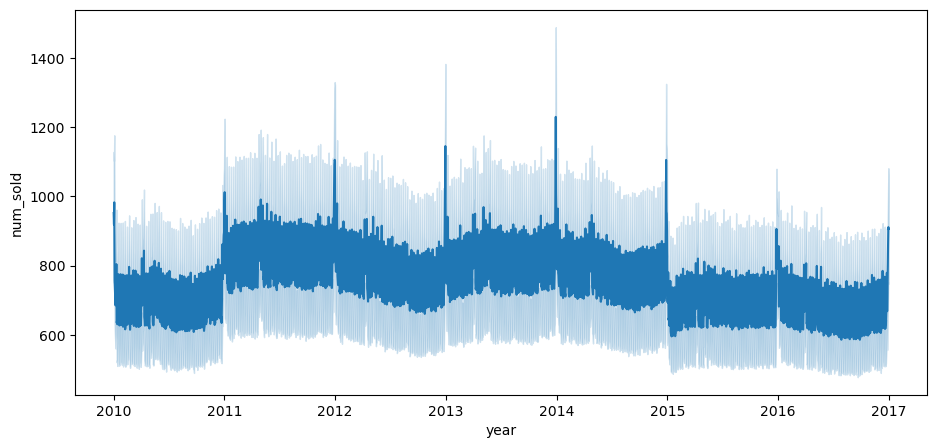

In [16]:
sns.lineplot(data=df, x='date', y=df['num_sold'])
plt.xlabel('year')                   # X-axis label
plt.ylabel('num_sold')                  # Y-axis label
plt.show()


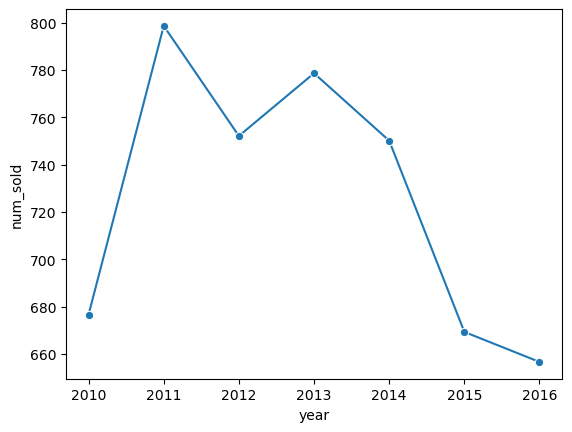

In [26]:
sns.lineplot(data=year, x='year', y='num_sold', marker='o')
plt.xlabel('year')                   # X-axis label
plt.ylabel('num_sold')                  # Y-axis label
plt.show()



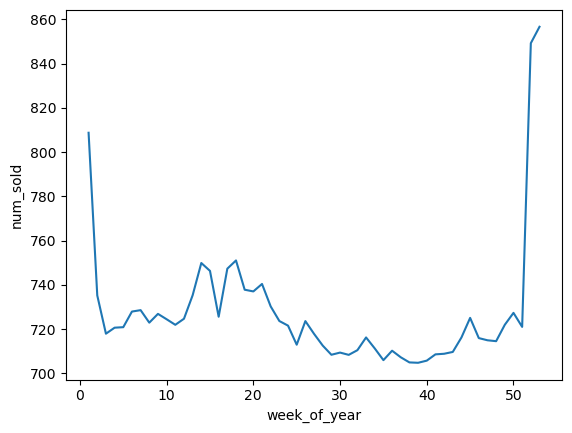

In [46]:
sns.lineplot(data=week_of_year, x='week_of_year', y='num_sold')
plt.xlabel('week_of_year')                   # X-axis label
plt.ylabel('num_sold')                  # Y-axis label
plt.show()

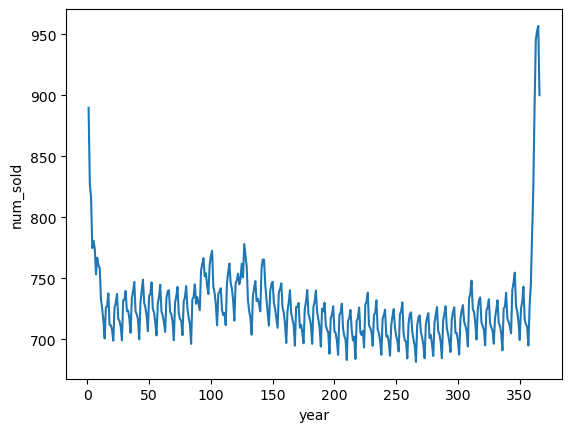

In [43]:
sns.lineplot(data=day_of_year, x='day_of_year', y='num_sold')
plt.xlabel('day_of_year')                   # X-axis label
plt.ylabel('num_sold')                  # Y-axis label
plt.show()


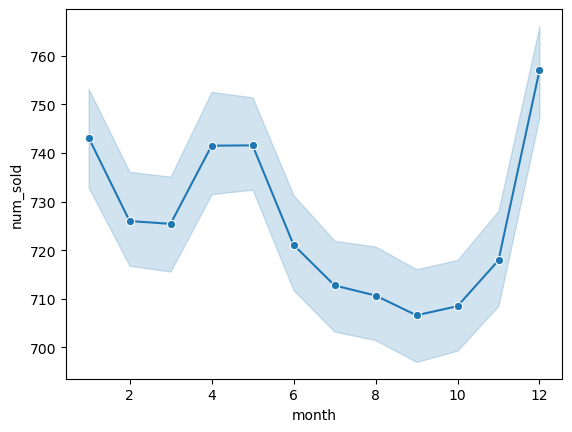

In [27]:
sns.lineplot(data=df, x='month', y='num_sold', marker='o')
plt.xlabel('month')                   # X-axis label
plt.ylabel('num_sold')                  # Y-axis label
plt.show()

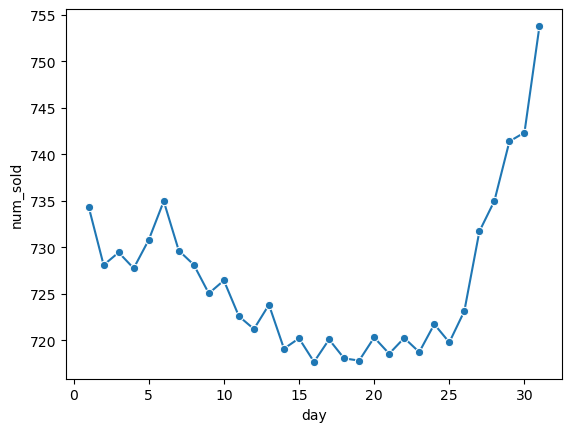

In [28]:
sns.lineplot(data=day, x='day', y='num_sold', marker='o')
plt.xlabel('day')                   # X-axis label
plt.ylabel('num_sold')                  # Y-axis label
plt.show()

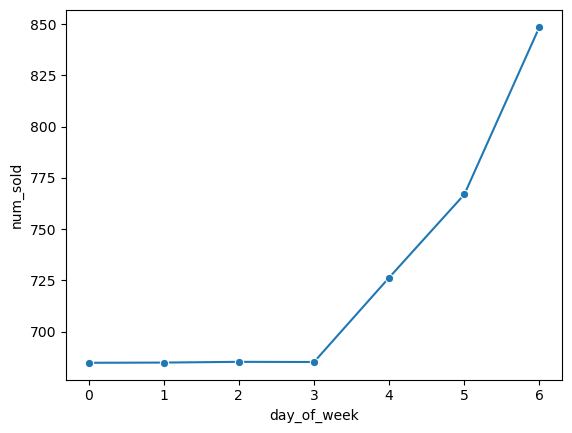

In [29]:
sns.lineplot(data=day_of_week, x='day_of_week', y='num_sold', marker='o')
plt.xlabel('day_of_week')                   # X-axis label
plt.ylabel('num_sold')                  # Y-axis label
plt.show()


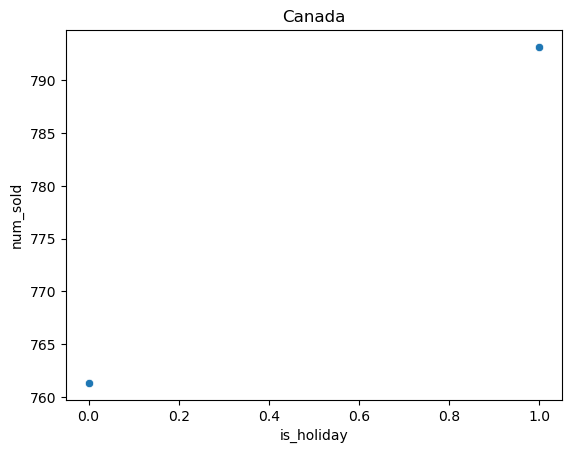

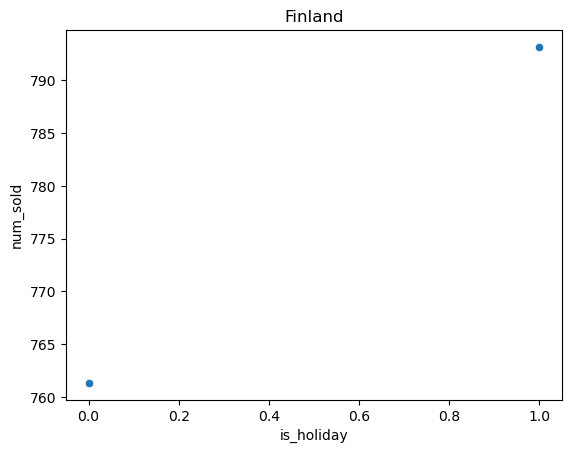

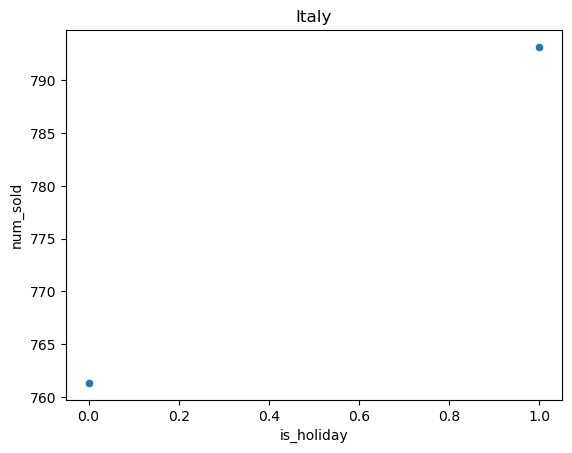

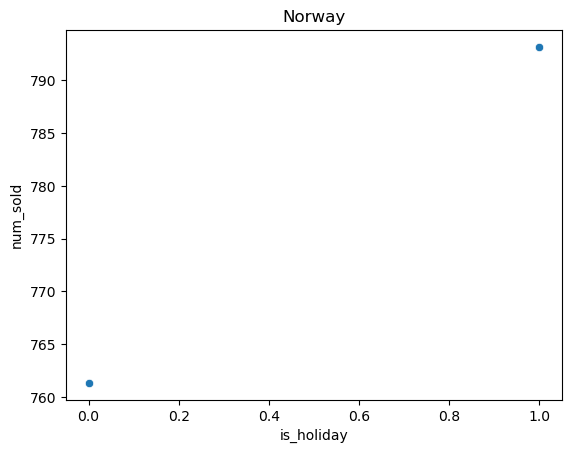

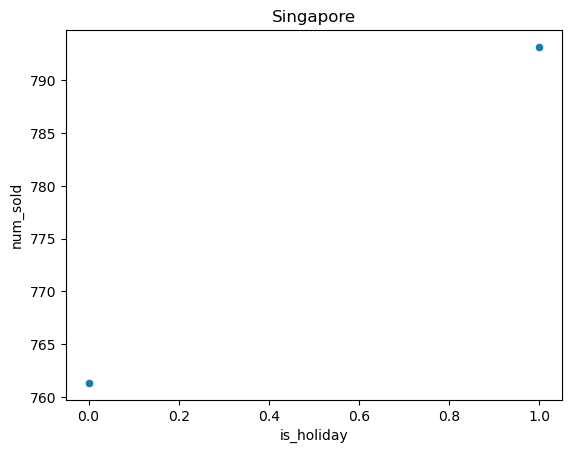

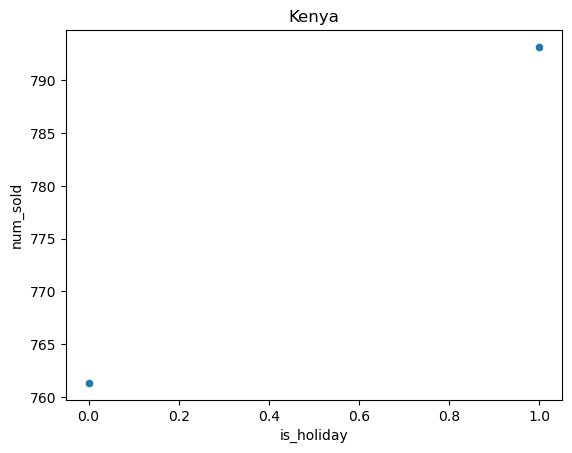

In [6]:
holiday_calendars = {
    "Canada": holidays.Canada(years=2015),
    "Finland": holidays.Finland(years=2015),
    "Italy": holidays.Italy(years=2015),
    "Norway": holidays.Norway(years=2015),
    "Singapore": holidays.Singapore(years=2015),
    "Kenya": holidays.Kenya(years=2015)
}

def is_holiday(row):
    country_holidays = holiday_calendars.get(row["country"])
    if country_holidays:
        return row["date"] in country_holidays
    return False


df["is_holiday"] = df.apply(is_holiday, axis = 1)
for i in holiday_calendars:
    country = df.loc[df["country"] == 'Canada', ["is_holiday", "num_sold"]].groupby("is_holiday").mean().reset_index()
    sns.scatterplot(x=country["is_holiday"], y=country["num_sold"])
    #sns.lineplot(data=country, x='is_holiday', y='num_sold', marker='o')
    plt.title(i)
    plt.xlabel('is_holiday')                   # X-axis label
    plt.ylabel('num_sold')                  # Y-axis label
    plt.show()

In [5]:
gdp_to_merge = gdp_to_merge[["2010", "2011", "2012", "2013", "2014", "2015", "2016", "2017", "2018", "2019", "2020"]].reset_index().melt(id_vars=['Country Name'], var_name='year', value_name="gdp")
gdp_to_merge = gdp_to_merge.rename(columns={"Country Name": "country"})

gdp_to_merge.head()

,country,year,gdp
0,Canada,2010,47560.666600
1,Finland,2010,46506.291900
2,Italy,2010,36184.711870
3,Kenya,2010,1091.518731
4,Norway,2010,88163.208590


In [6]:
def dmy_splitter(df):
    df["date"] = pd.to_datetime(df["date"])

    df["month"] = df["date"].dt.month
    df["year"] = df["date"].dt.year
    
    df["day"] = df["date"].dt.day
    df['dayofweek'] = df['date'].dt.dayofweek
    df["day_of_year"] = df["date"].dt.dayofyear
    df["day_of_biyear"] = (df["year"] % 2) * 365 + df["day_of_year"]

    
    
    df["day_of_biyear_sin"] = np.sin(2*np.pi*df['day_of_biyear']/730)
    df["day_of_biyear_cos"] = np.cos(2*np.pi*df['day_of_biyear']/730) 
    df["day_of_year_sin"] = np.sin(2 * np.pi* df["day_of_year"] /365)
    df["day_of_year_cos"] = np.cos(2*np.pi*df["day_of_year"]/365)
    df['day_sin'] = np.sin(2 * np.pi * df['day'] / 31)  # Assuming 31 days max
    df['day_cos'] = np.cos(2 * np.pi * df['day'] / 31)    
    df["country"] = df["country"].astype("category")
    df["store"] = df["store"].astype("category")
    df["product"] = df["product"].astype("category")
    df["is_holiday"] = df["is_holiday"].astype("category")
    df["month"] = df["month"].astype("category")
    df["day"] = df["day"].astype("category")

    df['dayofweek'] = df['dayofweek'].apply(
        lambda x: 0 if x in [0,1,2,3] else
        1 if x == 4 else
        2 if x == 5 else
        3).astype("category")
    #df["is_weekend"] = df["date"].dt.weekday >= 5
   
    df = df.drop(columns = ["dayofweek","day", "date"])
    return df

holiday_calendars = {
    "Canada": holidays.Canada(years=2015),
    "Finland": holidays.Finland(years=2015),
    "Italy": holidays.Italy(years=2015),
    "Norway": holidays.Norway(years=2015),
    "Singapore": holidays.Singapore(years=2015),
    "Kenya": holidays.Kenya(years=2015)
}

def is_holiday(row):
    country_holidays = holiday_calendars.get(row["country"])
    if country_holidays:
        return row["date"] in country_holidays
    return False


df["is_holiday"] = df.apply(is_holiday, axis = 1)

df = dmy_splitter(df)
df.head()

,id,country,store,product,num_sold,year,is_holiday,month,day_of_year,day_of_biyear,day_of_biyear_sin,day_of_biyear_cos,day_of_year_sin,day_of_year_cos,day_sin,day_cos
0,0,Canada,Discount Stickers,Holographic Goose,140.799481,2010,True,1,1,1,0.008607,0.999963,0.017213,0.999852,0.201299,0.97953
1,1,Canada,Discount Stickers,Kaggle,973.000000,2010,True,1,1,1,0.008607,0.999963,0.017213,0.999852,0.201299,0.97953
2,2,Canada,Discount Stickers,Kaggle Tiers,906.000000,2010,True,1,1,1,0.008607,0.999963,0.017213,0.999852,0.201299,0.97953
3,3,Canada,Discount Stickers,Kerneler,423.000000,2010,True,1,1,1,0.008607,0.999963,0.017213,0.999852,0.201299,0.97953
4,4,Canada,Discount Stickers,Kerneler Dark Mode,491.000000,2010,True,1,1,1,0.008607,0.999963,0.017213,0.999852,0.201299,0.97953


In [7]:
gdp_to_merge["country"] = gdp_to_merge["country"].astype("category")
gdp_to_merge["year"] = gdp_to_merge["year"].astype("int32")
df = pd.merge(df, gdp_to_merge, on=['country', 'year'], how='inner')
df.head()

,id,country,store,product,num_sold,year,is_holiday,month,day_of_year,day_of_biyear,day_of_biyear_sin,day_of_biyear_cos,day_of_year_sin,day_of_year_cos,day_sin,day_cos,gdp
0,0,Canada,Discount Stickers,Holographic Goose,140.799481,2010,True,1,1,1,0.008607,0.999963,0.017213,0.999852,0.201299,0.97953,47560.6666
1,1,Canada,Discount Stickers,Kaggle,973.000000,2010,True,1,1,1,0.008607,0.999963,0.017213,0.999852,0.201299,0.97953,47560.6666
2,2,Canada,Discount Stickers,Kaggle Tiers,906.000000,2010,True,1,1,1,0.008607,0.999963,0.017213,0.999852,0.201299,0.97953,47560.6666
3,3,Canada,Discount Stickers,Kerneler,423.000000,2010,True,1,1,1,0.008607,0.999963,0.017213,0.999852,0.201299,0.97953,47560.6666
4,4,Canada,Discount Stickers,Kerneler Dark Mode,491.000000,2010,True,1,1,1,0.008607,0.999963,0.017213,0.999852,0.201299,0.97953,47560.6666


In [14]:
for i in df[df.isna().any(axis=1)].columns:
    if (i == "id") or (i == "num_sold"):
        continue
    print(i + " Unique Values: " + str(df[i].nunique()))

date Unique Values: 2557
country Unique Values: 6
store Unique Values: 3
product Unique Values: 5


In [11]:
df["num_sold"], lamb = boxcox(df["num_sold"])

In [25]:
X_train, X_test, y_train, y_test = df.drop(columns = "num_sold")[:int(len(df)*0.8)], df.drop(columns = "num_sold")[int(len(df)*0.8):], df.iloc[:int(len(df)*0.8)]["num_sold"], df.iloc[int(len(df)*0.8):]["num_sold"]  

In [15]:
"""
X = df.drop(columns = ['id', 'num_sold', "year"])
y = df["num_sold"]
def LgbmObjective(trial):
    params = {
        "num_leaves": trial.suggest_int("num_leaves", 16, 128),  
        "learning_rate": trial.suggest_float("learning_rate", 1e-4, 1e-1, log=True),  
        "n_estimators": 3000,  
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),  
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
        "lambda_l1": trial.suggest_float("lambda_l1", 0, 1),
        "lambda_l2": trial.suggest_float("lambda_l1", 0, 1),
        "random_state": 42
    }
    
    model = lgb.LGBMRegressor(**params)
    tscv = TimeSeriesSplit(n_splits=5)
    errors = []  

    for train_index, val_index in tscv.split(df):
        X_train_cv, X_val_cv = X.iloc[train_index], X.iloc[val_index]
        y_train_cv, y_val_cv = y.iloc[train_index], y.iloc[val_index]
        model.fit(X_train_cv, y_train_cv, eval_set=[(X_val_cv, y_val_cv)], eval_metric="mape")  
        y_val_pred = model.predict(X_val_cv)  
        errors.append(np.mean(np.abs((y_val_cv-y_val_pred)/y_val_cv)))  
    return np.mean(errors) 
"""

In [16]:
"""studyLgbm = optuna.create_study(direction='minimize', sampler=optuna.samplers.RandomSampler(seed=42))

[I 2025-01-31 00:45:18,995] A new study created in memory with name: no-name-e01f79b7-fdfd-4565-8cb2-4659da710876


In [18]:
"""studyLgbm.optimize(LgbmObjective, n_trials = 600)

[LightGBM] [Warning] lambda_l1 is set=0.28093450968738076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28093450968738076
[LightGBM] [Warning] lambda_l2 is set=0.28093450968738076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28093450968738076
[LightGBM] [Warning] lambda_l1 is set=0.28093450968738076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28093450968738076
[LightGBM] [Warning] lambda_l2 is set=0.28093450968738076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28093450968738076
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000385 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.28093450968738076, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 00:57:20,279] Trial 12 finished with value: 0.21898233981714124 and parameters: {'num_leaves': 59, 'learning_rate': 0.0006516990611177178, 'subsample': 0.9143687545759647, 'colsample_bytree': 0.6783766633467947, 'lambda_l1': 0.28093450968738076}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.9868869366005173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9868869366005173
[LightGBM] [Warning] lambda_l2 is set=0.9868869366005173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9868869366005173
[LightGBM] [Warning] lambda_l1 is set=0.9868869366005173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9868869366005173
[LightGBM] [Warning] lambda_l2 is set=0.9868869366005173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9868869366005173
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000303 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9868869366005173, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 00:58:16,378] Trial 13 finished with value: 0.5863356153241865 and parameters: {'num_leaves': 77, 'learning_rate': 0.00026471141828218194, 'subsample': 0.9010984903770198, 'colsample_bytree': 0.5372753218398854, 'lambda_l1': 0.9868869366005173}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.7068573438476171, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7068573438476171
[LightGBM] [Warning] lambda_l2 is set=0.7068573438476171, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7068573438476171
[LightGBM] [Warning] lambda_l1 is set=0.7068573438476171, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7068573438476171
[LightGBM] [Warning] lambda_l2 is set=0.7068573438476171, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7068573438476171
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7068573438476171, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 00:59:31,142] Trial 14 finished with value: 0.34196092322288024 and parameters: {'num_leaves': 103, 'learning_rate': 0.00039459088111000007, 'subsample': 0.5027610585618012, 'colsample_bytree': 0.9077307142274171, 'lambda_l1': 0.7068573438476171}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.11586905952512971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11586905952512971
[LightGBM] [Warning] lambda_l2 is set=0.11586905952512971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11586905952512971
[LightGBM] [Warning] lambda_l1 is set=0.11586905952512971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11586905952512971
[LightGBM] [Warning] lambda_l2 is set=0.11586905952512971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11586905952512971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11586905952512971, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:00:17,100] Trial 15 finished with value: 0.05057346013914414 and parameters: {'num_leaves': 98, 'learning_rate': 0.020597335357437203, 'subsample': 0.5370223258670452, 'colsample_bytree': 0.6792328642721364, 'lambda_l1': 0.11586905952512971}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.3109823217156622, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3109823217156622
[LightGBM] [Warning] lambda_l2 is set=0.3109823217156622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3109823217156622
[LightGBM] [Warning] lambda_l1 is set=0.3109823217156622, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3109823217156622
[LightGBM] [Warning] lambda_l2 is set=0.3109823217156622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3109823217156622
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000243 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3109823217156622, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:01:13,726] Trial 16 finished with value: 0.048737543369518764 and parameters: {'num_leaves': 113, 'learning_rate': 0.0074112997810832455, 'subsample': 0.6654490124263246, 'colsample_bytree': 0.5317791751430119, 'lambda_l1': 0.3109823217156622}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.4722149251619493, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4722149251619493
[LightGBM] [Warning] lambda_l2 is set=0.4722149251619493, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4722149251619493
[LightGBM] [Warning] lambda_l1 is set=0.4722149251619493, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4722149251619493
[LightGBM] [Warning] lambda_l2 is set=0.4722149251619493, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4722149251619493
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4722149251619493, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:01:48,798] Trial 17 finished with value: 0.04880694732161346 and parameters: {'num_leaves': 52, 'learning_rate': 0.015446089075047083, 'subsample': 0.8187787356776066, 'colsample_bytree': 0.9436063712881633, 'lambda_l1': 0.4722149251619493}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.770967179954561, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.770967179954561
[LightGBM] [Warning] lambda_l2 is set=0.770967179954561, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.770967179954561
[LightGBM] [Warning] lambda_l1 is set=0.770967179954561, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.770967179954561
[LightGBM] [Warning] lambda_l2 is set=0.770967179954561, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.770967179954561
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.770967179954561, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.770967

[I 2025-01-31 01:02:17,231] Trial 18 finished with value: 0.04823934668073258 and parameters: {'num_leaves': 29, 'learning_rate': 0.013795402040204185, 'subsample': 0.8803925243084487, 'colsample_bytree': 0.7806385987847482, 'lambda_l1': 0.770967179954561}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.10789142699330445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10789142699330445
[LightGBM] [Warning] lambda_l2 is set=0.10789142699330445, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10789142699330445
[LightGBM] [Warning] lambda_l1 is set=0.10789142699330445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10789142699330445
[LightGBM] [Warning] lambda_l2 is set=0.10789142699330445, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10789142699330445
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000242 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.10789142699330445, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:03:04,112] Trial 19 finished with value: 0.044415050211698615 and parameters: {'num_leaves': 71, 'learning_rate': 0.0036999724314638123, 'subsample': 0.7137705091792748, 'colsample_bytree': 0.5127095633720475, 'lambda_l1': 0.10789142699330445}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.907566473926093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.907566473926093
[LightGBM] [Warning] lambda_l2 is set=0.907566473926093, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.907566473926093
[LightGBM] [Warning] lambda_l1 is set=0.907566473926093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.907566473926093
[LightGBM] [Warning] lambda_l2 is set=0.907566473926093, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.907566473926093
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.907566473926093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.907566

[I 2025-01-31 01:03:30,409] Trial 20 finished with value: 0.04586318310738442 and parameters: {'num_leaves': 19, 'learning_rate': 0.008113929572637844, 'subsample': 0.6571779905381634, 'colsample_bytree': 0.7542853455823514, 'lambda_l1': 0.907566473926093}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.07697990982879299, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07697990982879299
[LightGBM] [Warning] lambda_l2 is set=0.07697990982879299, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07697990982879299
[LightGBM] [Warning] lambda_l1 is set=0.07697990982879299, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07697990982879299
[LightGBM] [Warning] lambda_l2 is set=0.07697990982879299, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07697990982879299
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001048 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.07697990982879299, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07697990982879299
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 01:04:15,392] Trial 21 finished with value: 0.0447222420324531 and parameters: {'num_leaves': 44, 'learning_rate': 0.001702741688676441, 'subsample': 0.8777755692715243, 'colsample_bytree': 0.6143990827458112, 'lambda_l1': 0.07697990982879299}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.6334037565104235, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6334037565104235
[LightGBM] [Warning] lambda_l2 is set=0.6334037565104235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6334037565104235
[LightGBM] [Warning] lambda_l1 is set=0.6334037565104235, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6334037565104235
[LightGBM] [Warning] lambda_l2 is set=0.6334037565104235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6334037565104235
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6334037565104235, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:05:05,155] Trial 22 finished with value: 0.44698948527617005 and parameters: {'num_leaves': 48, 'learning_rate': 0.00030455368715396805, 'subsample': 0.9648488261712865, 'colsample_bytree': 0.9040601897822085, 'lambda_l1': 0.6334037565104235}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.5393422419156507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5393422419156507
[LightGBM] [Warning] lambda_l2 is set=0.5393422419156507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5393422419156507
[LightGBM] [Warning] lambda_l1 is set=0.5393422419156507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5393422419156507
[LightGBM] [Warning] lambda_l2 is set=0.5393422419156507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5393422419156507
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000391 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5393422419156507, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:05:54,282] Trial 23 finished with value: 0.05022226503019811 and parameters: {'num_leaves': 114, 'learning_rate': 0.025764174425233172, 'subsample': 0.5932850294430179, 'colsample_bytree': 0.9462794992449889, 'lambda_l1': 0.5393422419156507}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.22793516254194168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22793516254194168
[LightGBM] [Warning] lambda_l2 is set=0.22793516254194168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22793516254194168
[LightGBM] [Warning] lambda_l1 is set=0.22793516254194168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22793516254194168
[LightGBM] [Warning] lambda_l2 is set=0.22793516254194168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22793516254194168
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000289 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.22793516254194168, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:06:37,246] Trial 24 finished with value: 0.051541579991122785 and parameters: {'num_leaves': 107, 'learning_rate': 0.04878360603452144, 'subsample': 0.6590017374859319, 'colsample_bytree': 0.5550259622638384, 'lambda_l1': 0.22793516254194168}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.5107473025775657, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5107473025775657
[LightGBM] [Warning] lambda_l2 is set=0.5107473025775657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5107473025775657
[LightGBM] [Warning] lambda_l1 is set=0.5107473025775657, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5107473025775657
[LightGBM] [Warning] lambda_l2 is set=0.5107473025775657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5107473025775657
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000272 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5107473025775657, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:07:12,129] Trial 25 finished with value: 0.0522602419458146 and parameters: {'num_leaves': 64, 'learning_rate': 0.028447512555118206, 'subsample': 0.9303652916281717, 'colsample_bytree': 0.5034760652655954, 'lambda_l1': 0.5107473025775657}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.9429097039125192, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9429097039125192
[LightGBM] [Warning] lambda_l2 is set=0.9429097039125192, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9429097039125192
[LightGBM] [Warning] lambda_l1 is set=0.9429097039125192, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9429097039125192
[LightGBM] [Warning] lambda_l2 is set=0.9429097039125192, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9429097039125192
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000266 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9429097039125192, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:08:05,691] Trial 26 finished with value: 0.34364962781203484 and parameters: {'num_leaves': 63, 'learning_rate': 0.00046379219034580355, 'subsample': 0.5599326836668415, 'colsample_bytree': 0.668807585701814, 'lambda_l1': 0.9429097039125192}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.9717820827209607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9717820827209607
[LightGBM] [Warning] lambda_l2 is set=0.9717820827209607, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9717820827209607
[LightGBM] [Warning] lambda_l1 is set=0.9717820827209607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9717820827209607
[LightGBM] [Warning] lambda_l2 is set=0.9717820827209607, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9717820827209607
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9717820827209607, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:08:53,766] Trial 27 finished with value: 0.04305796956909129 and parameters: {'num_leaves': 52, 'learning_rate': 0.003600575029200904, 'subsample': 0.8515094794475889, 'colsample_bytree': 0.681814801189647, 'lambda_l1': 0.9717820827209607}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.2848404943774676, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848404943774676
[LightGBM] [Warning] lambda_l2 is set=0.2848404943774676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2848404943774676
[LightGBM] [Warning] lambda_l1 is set=0.2848404943774676, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2848404943774676
[LightGBM] [Warning] lambda_l2 is set=0.2848404943774676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2848404943774676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000331 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2848404943774676, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:10:10,136] Trial 28 finished with value: 0.26637113379862803 and parameters: {'num_leaves': 124, 'learning_rate': 0.0005693074767644616, 'subsample': 0.7486242529461927, 'colsample_bytree': 0.6504391549083848, 'lambda_l1': 0.2848404943774676}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.27864646423661144, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.27864646423661144
[LightGBM] [Warning] lambda_l2 is set=0.27864646423661144, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.27864646423661144
[LightGBM] [Warning] lambda_l1 is set=0.27864646423661144, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.27864646423661144
[LightGBM] [Warning] lambda_l2 is set=0.27864646423661144, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.27864646423661144
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000286 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.27864646423661144, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:10:36,360] Trial 29 finished with value: 0.045594073012210246 and parameters: {'num_leaves': 20, 'learning_rate': 0.0067405137963740475, 'subsample': 0.7513395116144308, 'colsample_bytree': 0.5257393756249946, 'lambda_l1': 0.27864646423661144}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.9856504541106007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9856504541106007
[LightGBM] [Warning] lambda_l2 is set=0.9856504541106007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9856504541106007
[LightGBM] [Warning] lambda_l1 is set=0.9856504541106007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9856504541106007
[LightGBM] [Warning] lambda_l2 is set=0.9856504541106007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9856504541106007
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000296 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9856504541106007, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:11:51,967] Trial 30 finished with value: 0.2759079012650537 and parameters: {'num_leaves': 118, 'learning_rate': 0.000523221608994876, 'subsample': 0.5724474360456115, 'colsample_bytree': 0.7447263801387816, 'lambda_l1': 0.9856504541106007}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.7282163486118596, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7282163486118596
[LightGBM] [Warning] lambda_l2 is set=0.7282163486118596, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7282163486118596
[LightGBM] [Warning] lambda_l1 is set=0.7282163486118596, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7282163486118596
[LightGBM] [Warning] lambda_l2 is set=0.7282163486118596, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7282163486118596
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001224 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7282163486118596, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7282163486118596
[LightGBM] [Warning] lambda_l2 is set=0.7282

[I 2025-01-31 01:12:27,329] Trial 31 finished with value: 0.0483238126009337 and parameters: {'num_leaves': 43, 'learning_rate': 0.010385003379927421, 'subsample': 0.8808098076643588, 'colsample_bytree': 0.6188187719961998, 'lambda_l1': 0.7282163486118596}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.0902897700544083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0902897700544083
[LightGBM] [Warning] lambda_l2 is set=0.0902897700544083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0902897700544083
[LightGBM] [Warning] lambda_l1 is set=0.0902897700544083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0902897700544083
[LightGBM] [Warning] lambda_l2 is set=0.0902897700544083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0902897700544083
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000337 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.0902897700544083, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:13:08,496] Trial 32 finished with value: 0.04707846492283855 and parameters: {'num_leaves': 57, 'learning_rate': 0.007887102624766478, 'subsample': 0.8167648553804474, 'colsample_bytree': 0.7678873420373793, 'lambda_l1': 0.0902897700544083}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.5908929431882418, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5908929431882418
[LightGBM] [Warning] lambda_l2 is set=0.5908929431882418, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5908929431882418
[LightGBM] [Warning] lambda_l1 is set=0.5908929431882418, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5908929431882418
[LightGBM] [Warning] lambda_l2 is set=0.5908929431882418, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5908929431882418
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000315 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5908929431882418, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:14:09,240] Trial 33 finished with value: 0.15997186192741275 and parameters: {'num_leaves': 110, 'learning_rate': 0.0009169384722192332, 'subsample': 0.5932592551999272, 'colsample_bytree': 0.520387570777382, 'lambda_l1': 0.5908929431882418}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.6451727904094499, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6451727904094499
[LightGBM] [Warning] lambda_l2 is set=0.6451727904094499, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6451727904094499
[LightGBM] [Warning] lambda_l1 is set=0.6451727904094499, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6451727904094499
[LightGBM] [Warning] lambda_l2 is set=0.6451727904094499, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6451727904094499
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000333 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6451727904094499, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:15:13,173] Trial 34 finished with value: 0.8231206211927921 and parameters: {'num_leaves': 92, 'learning_rate': 0.00011214075785991138, 'subsample': 0.7560465291496405, 'colsample_bytree': 0.613247887598969, 'lambda_l1': 0.6451727904094499}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.13752094414599325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13752094414599325
[LightGBM] [Warning] lambda_l2 is set=0.13752094414599325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13752094414599325
[LightGBM] [Warning] lambda_l1 is set=0.13752094414599325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13752094414599325
[LightGBM] [Warning] lambda_l2 is set=0.13752094414599325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13752094414599325
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000392 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.13752094414599325, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:15:43,859] Trial 35 finished with value: 0.048419648638859725 and parameters: {'num_leaves': 35, 'learning_rate': 0.011825328508422656, 'subsample': 0.6933676731502687, 'colsample_bytree': 0.9683649943683672, 'lambda_l1': 0.13752094414599325}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.2579416277151556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2579416277151556
[LightGBM] [Warning] lambda_l2 is set=0.2579416277151556, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2579416277151556
[LightGBM] [Warning] lambda_l1 is set=0.2579416277151556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2579416277151556
[LightGBM] [Warning] lambda_l2 is set=0.2579416277151556, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2579416277151556
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000372 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2579416277151556, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:16:36,970] Trial 36 finished with value: 0.5734105444502994 and parameters: {'num_leaves': 54, 'learning_rate': 0.00021898812429056952, 'subsample': 0.9623468091392814, 'colsample_bytree': 0.9386696766904905, 'lambda_l1': 0.2579416277151556}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.24185229090045168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24185229090045168
[LightGBM] [Warning] lambda_l2 is set=0.24185229090045168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24185229090045168
[LightGBM] [Warning] lambda_l1 is set=0.24185229090045168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24185229090045168
[LightGBM] [Warning] lambda_l2 is set=0.24185229090045168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24185229090045168
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000431 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.24185229090045168, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:17:19,400] Trial 37 finished with value: 0.050402546583774785 and parameters: {'num_leaves': 90, 'learning_rate': 0.028292192255361892, 'subsample': 0.7776004057997312, 'colsample_bytree': 0.7648252891780032, 'lambda_l1': 0.24185229090045168}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.3390297910487007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3390297910487007
[LightGBM] [Warning] lambda_l2 is set=0.3390297910487007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3390297910487007
[LightGBM] [Warning] lambda_l1 is set=0.3390297910487007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3390297910487007
[LightGBM] [Warning] lambda_l2 is set=0.3390297910487007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3390297910487007
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3390297910487007, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:17:42,868] Trial 38 finished with value: 0.050676481147661254 and parameters: {'num_leaves': 26, 'learning_rate': 0.04916400722913765, 'subsample': 0.9502090285816652, 'colsample_bytree': 0.816550728636634, 'lambda_l1': 0.3390297910487007}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.7798755458576239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7798755458576239
[LightGBM] [Warning] lambda_l2 is set=0.7798755458576239, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7798755458576239
[LightGBM] [Warning] lambda_l1 is set=0.7798755458576239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7798755458576239
[LightGBM] [Warning] lambda_l2 is set=0.7798755458576239, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7798755458576239
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7798755458576239, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:18:19,419] Trial 39 finished with value: 0.048724885693015904 and parameters: {'num_leaves': 55, 'learning_rate': 0.015061458746961166, 'subsample': 0.9485551299762885, 'colsample_bytree': 0.9435432121325587, 'lambda_l1': 0.7798755458576239}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.6064290596595899, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6064290596595899
[LightGBM] [Warning] lambda_l2 is set=0.6064290596595899, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6064290596595899
[LightGBM] [Warning] lambda_l1 is set=0.6064290596595899, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6064290596595899
[LightGBM] [Warning] lambda_l2 is set=0.6064290596595899, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6064290596595899
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000344 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6064290596595899, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:19:26,929] Trial 40 finished with value: 0.6441055075345857 and parameters: {'num_leaves': 88, 'learning_rate': 0.00017882156647879504, 'subsample': 0.5808143570473069, 'colsample_bytree': 0.9492770942635396, 'lambda_l1': 0.6064290596595899}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.16080805141749865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16080805141749865
[LightGBM] [Warning] lambda_l2 is set=0.16080805141749865, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16080805141749865
[LightGBM] [Warning] lambda_l1 is set=0.16080805141749865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16080805141749865
[LightGBM] [Warning] lambda_l2 is set=0.16080805141749865, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16080805141749865
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000204 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.16080805141749865, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:19:54,605] Trial 41 finished with value: 0.7079895164675618 and parameters: {'num_leaves': 17, 'learning_rate': 0.00020156477059365003, 'subsample': 0.8317508845540279, 'colsample_bytree': 0.5025307919231093, 'lambda_l1': 0.16080805141749865}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.7121792213475359, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7121792213475359
[LightGBM] [Warning] lambda_l2 is set=0.7121792213475359, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7121792213475359
[LightGBM] [Warning] lambda_l1 is set=0.7121792213475359, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7121792213475359
[LightGBM] [Warning] lambda_l2 is set=0.7121792213475359, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7121792213475359
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000266 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7121792213475359, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:20:39,465] Trial 42 finished with value: 0.049550507780207885 and parameters: {'num_leaves': 78, 'learning_rate': 0.011903799220250161, 'subsample': 0.8259806297513003, 'colsample_bytree': 0.61213465473028, 'lambda_l1': 0.7121792213475359}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.8492234104941779, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8492234104941779
[LightGBM] [Warning] lambda_l2 is set=0.8492234104941779, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8492234104941779
[LightGBM] [Warning] lambda_l1 is set=0.8492234104941779, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8492234104941779
[LightGBM] [Warning] lambda_l2 is set=0.8492234104941779, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8492234104941779
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8492234104941779, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:21:25,750] Trial 43 finished with value: 0.08591738897845652 and parameters: {'num_leaves': 42, 'learning_rate': 0.0009466710461838319, 'subsample': 0.8732457025590121, 'colsample_bytree': 0.8248164495236073, 'lambda_l1': 0.8492234104941779}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.26520236768172545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.26520236768172545
[LightGBM] [Warning] lambda_l2 is set=0.26520236768172545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.26520236768172545
[LightGBM] [Warning] lambda_l1 is set=0.26520236768172545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.26520236768172545
[LightGBM] [Warning] lambda_l2 is set=0.26520236768172545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.26520236768172545
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000414 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.26520236768172545, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:22:21,952] Trial 44 finished with value: 0.04648402547568554 and parameters: {'num_leaves': 90, 'learning_rate': 0.005069041070711459, 'subsample': 0.5468373839140462, 'colsample_bytree': 0.6838579015297168, 'lambda_l1': 0.26520236768172545}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.6311386259972629, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6311386259972629
[LightGBM] [Warning] lambda_l2 is set=0.6311386259972629, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6311386259972629
[LightGBM] [Warning] lambda_l1 is set=0.6311386259972629, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6311386259972629
[LightGBM] [Warning] lambda_l2 is set=0.6311386259972629, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6311386259972629
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000402 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6311386259972629, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:22:48,031] Trial 45 finished with value: 0.05100933657793734 and parameters: {'num_leaves': 43, 'learning_rate': 0.08299112738466033, 'subsample': 0.6965488623333802, 'colsample_bytree': 0.9460232775885566, 'lambda_l1': 0.6311386259972629}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.1952429877980445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1952429877980445
[LightGBM] [Warning] lambda_l2 is set=0.1952429877980445, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1952429877980445
[LightGBM] [Warning] lambda_l1 is set=0.1952429877980445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1952429877980445
[LightGBM] [Warning] lambda_l2 is set=0.1952429877980445, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1952429877980445
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.1952429877980445, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:23:52,991] Trial 46 finished with value: 0.04380907964697746 and parameters: {'num_leaves': 105, 'learning_rate': 0.0032204108362516755, 'subsample': 0.7884519423131795, 'colsample_bytree': 0.746258846909432, 'lambda_l1': 0.1952429877980445}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.17711067940704894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17711067940704894
[LightGBM] [Warning] lambda_l2 is set=0.17711067940704894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17711067940704894
[LightGBM] [Warning] lambda_l1 is set=0.17711067940704894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17711067940704894
[LightGBM] [Warning] lambda_l2 is set=0.17711067940704894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17711067940704894
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.17711067940704894, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:25:04,894] Trial 47 finished with value: 0.15358245688882727 and parameters: {'num_leaves': 97, 'learning_rate': 0.0006955319544158293, 'subsample': 0.5121579832157269, 'colsample_bytree': 0.822736147953584, 'lambda_l1': 0.17711067940704894}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.015456616528867428, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015456616528867428
[LightGBM] [Warning] lambda_l2 is set=0.015456616528867428, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.015456616528867428
[LightGBM] [Warning] lambda_l1 is set=0.015456616528867428, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015456616528867428
[LightGBM] [Warning] lambda_l2 is set=0.015456616528867428, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.015456616528867428
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.015456616528867428, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 01:25:49,880] Trial 48 finished with value: 0.05177457105078964 and parameters: {'num_leaves': 122, 'learning_rate': 0.07274208264938348, 'subsample': 0.9574321951102243, 'colsample_bytree': 0.6850793501277221, 'lambda_l1': 0.015456616528867428}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.8530094554673601, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8530094554673601
[LightGBM] [Warning] lambda_l2 is set=0.8530094554673601, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8530094554673601
[LightGBM] [Warning] lambda_l1 is set=0.8530094554673601, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8530094554673601
[LightGBM] [Warning] lambda_l2 is set=0.8530094554673601, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8530094554673601
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000497 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8530094554673601, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:27:07,577] Trial 49 finished with value: 0.044140670784140336 and parameters: {'num_leaves': 120, 'learning_rate': 0.0019255395572015624, 'subsample': 0.9833274095218347, 'colsample_bytree': 0.9818099885446264, 'lambda_l1': 0.8530094554673601}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.1694927466860925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1694927466860925
[LightGBM] [Warning] lambda_l2 is set=0.1694927466860925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1694927466860925
[LightGBM] [Warning] lambda_l1 is set=0.1694927466860925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1694927466860925
[LightGBM] [Warning] lambda_l2 is set=0.1694927466860925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1694927466860925
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.1694927466860925, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:27:56,229] Trial 50 finished with value: 0.05281325058902964 and parameters: {'num_leaves': 49, 'learning_rate': 0.001429858909444399, 'subsample': 0.9255683357584285, 'colsample_bytree': 0.6584610025781388, 'lambda_l1': 0.1694927466860925}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.09717649377076854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09717649377076854
[LightGBM] [Warning] lambda_l2 is set=0.09717649377076854, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09717649377076854
[LightGBM] [Warning] lambda_l1 is set=0.09717649377076854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09717649377076854
[LightGBM] [Warning] lambda_l2 is set=0.09717649377076854, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09717649377076854
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000347 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.09717649377076854, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:28:31,265] Trial 51 finished with value: 0.05128851545087807 and parameters: {'num_leaves': 78, 'learning_rate': 0.06433752092130689, 'subsample': 0.8480148983374864, 'colsample_bytree': 0.7850305850446825, 'lambda_l1': 0.09717649377076854}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.8773730719279554, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8773730719279554
[LightGBM] [Warning] lambda_l2 is set=0.8773730719279554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8773730719279554
[LightGBM] [Warning] lambda_l1 is set=0.8773730719279554, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8773730719279554
[LightGBM] [Warning] lambda_l2 is set=0.8773730719279554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8773730719279554
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8773730719279554, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:29:05,811] Trial 52 finished with value: 0.050753697759072035 and parameters: {'num_leaves': 85, 'learning_rate': 0.09336015204266922, 'subsample': 0.570042007618262, 'colsample_bytree': 0.7591648261818684, 'lambda_l1': 0.8773730719279554}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.29359184426449336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29359184426449336
[LightGBM] [Warning] lambda_l2 is set=0.29359184426449336, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.29359184426449336
[LightGBM] [Warning] lambda_l1 is set=0.29359184426449336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29359184426449336
[LightGBM] [Warning] lambda_l2 is set=0.29359184426449336, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.29359184426449336
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000346 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.29359184426449336, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:29:56,751] Trial 53 finished with value: 0.04982145309949798 and parameters: {'num_leaves': 99, 'learning_rate': 0.012332389221028014, 'subsample': 0.8512420419935547, 'colsample_bytree': 0.6797455756098776, 'lambda_l1': 0.29359184426449336}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.5113423988609378, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5113423988609378
[LightGBM] [Warning] lambda_l2 is set=0.5113423988609378, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5113423988609378
[LightGBM] [Warning] lambda_l1 is set=0.5113423988609378, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5113423988609378
[LightGBM] [Warning] lambda_l2 is set=0.5113423988609378, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5113423988609378
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000458 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5113423988609378, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:30:43,824] Trial 54 finished with value: 0.050197225134921045 and parameters: {'num_leaves': 107, 'learning_rate': 0.026936439163179417, 'subsample': 0.9335361592900518, 'colsample_bytree': 0.9566202762782356, 'lambda_l1': 0.5113423988609378}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.795792669436101, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.795792669436101
[LightGBM] [Warning] lambda_l2 is set=0.795792669436101, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.795792669436101
[LightGBM] [Warning] lambda_l1 is set=0.795792669436101, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.795792669436101
[LightGBM] [Warning] lambda_l2 is set=0.795792669436101, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.795792669436101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000491 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.795792669436101, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.795792

[I 2025-01-31 01:31:22,845] Trial 55 finished with value: 0.04983731877794147 and parameters: {'num_leaves': 72, 'learning_rate': 0.024824787344212586, 'subsample': 0.8249819653888826, 'colsample_bytree': 0.8509834386288517, 'lambda_l1': 0.795792669436101}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.578280140996174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.578280140996174
[LightGBM] [Warning] lambda_l2 is set=0.578280140996174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.578280140996174
[LightGBM] [Warning] lambda_l1 is set=0.578280140996174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.578280140996174
[LightGBM] [Warning] lambda_l2 is set=0.578280140996174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.578280140996174
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000223 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.578280140996174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.578280

[I 2025-01-31 01:32:31,148] Trial 56 finished with value: 0.10866336829235794 and parameters: {'num_leaves': 116, 'learning_rate': 0.001032726855012838, 'subsample': 0.687791476319972, 'colsample_bytree': 0.5469909699204345, 'lambda_l1': 0.578280140996174}. Best is trial 8 with value: 0.04217226964107161.


[LightGBM] [Warning] lambda_l1 is set=0.5908332605690108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5908332605690108
[LightGBM] [Warning] lambda_l2 is set=0.5908332605690108, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5908332605690108
[LightGBM] [Warning] lambda_l1 is set=0.5908332605690108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5908332605690108
[LightGBM] [Warning] lambda_l2 is set=0.5908332605690108, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5908332605690108
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001117 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5908332605690108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5908332605690108
[LightGBM] [Warning] lambda_l2 is set=0.5908

[I 2025-01-31 01:33:05,283] Trial 57 finished with value: 0.04157146847498999 and parameters: {'num_leaves': 20, 'learning_rate': 0.002493412052414958, 'subsample': 0.7713223173537883, 'colsample_bytree': 0.6432706260641422, 'lambda_l1': 0.5908332605690108}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.12706051265188478, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12706051265188478
[LightGBM] [Warning] lambda_l2 is set=0.12706051265188478, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12706051265188478
[LightGBM] [Warning] lambda_l1 is set=0.12706051265188478, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12706051265188478
[LightGBM] [Warning] lambda_l2 is set=0.12706051265188478, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12706051265188478
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000292 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.12706051265188478, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:33:37,967] Trial 58 finished with value: 0.7764466493571982 and parameters: {'num_leaves': 19, 'learning_rate': 0.00012943286555064254, 'subsample': 0.9113002803298291, 'colsample_bytree': 0.6800953207056315, 'lambda_l1': 0.12706051265188478}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.085347464993768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.085347464993768
[LightGBM] [Warning] lambda_l2 is set=0.085347464993768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.085347464993768
[LightGBM] [Warning] lambda_l1 is set=0.085347464993768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.085347464993768
[LightGBM] [Warning] lambda_l2 is set=0.085347464993768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.085347464993768
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.085347464993768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.085347

[I 2025-01-31 01:34:17,815] Trial 59 finished with value: 0.04971205649105394 and parameters: {'num_leaves': 75, 'learning_rate': 0.020416470207182777, 'subsample': 0.6079105137484215, 'colsample_bytree': 0.8114452379095001, 'lambda_l1': 0.085347464993768}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7260913337226615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7260913337226615
[LightGBM] [Warning] lambda_l2 is set=0.7260913337226615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7260913337226615
[LightGBM] [Warning] lambda_l1 is set=0.7260913337226615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7260913337226615
[LightGBM] [Warning] lambda_l2 is set=0.7260913337226615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7260913337226615
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000416 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7260913337226615, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:34:49,034] Trial 60 finished with value: 0.04205568319910112 and parameters: {'num_leaves': 21, 'learning_rate': 0.0039270270674770765, 'subsample': 0.7703175608050532, 'colsample_bytree': 0.8187149507491033, 'lambda_l1': 0.7260913337226615}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2708322512620742, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2708322512620742
[LightGBM] [Warning] lambda_l2 is set=0.2708322512620742, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2708322512620742
[LightGBM] [Warning] lambda_l1 is set=0.2708322512620742, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2708322512620742
[LightGBM] [Warning] lambda_l2 is set=0.2708322512620742, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2708322512620742
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2708322512620742, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:36:01,182] Trial 61 finished with value: 0.045614715632952774 and parameters: {'num_leaves': 126, 'learning_rate': 0.003539166910822011, 'subsample': 0.661478236470623, 'colsample_bytree': 0.8975930973843518, 'lambda_l1': 0.2708322512620742}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8359801205122058, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8359801205122058
[LightGBM] [Warning] lambda_l2 is set=0.8359801205122058, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8359801205122058
[LightGBM] [Warning] lambda_l1 is set=0.8359801205122058, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8359801205122058
[LightGBM] [Warning] lambda_l2 is set=0.8359801205122058, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8359801205122058
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000386 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8359801205122058, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:37:02,153] Trial 62 finished with value: 0.6527328461168539 and parameters: {'num_leaves': 65, 'learning_rate': 0.00017193692051833056, 'subsample': 0.5126753717077288, 'colsample_bytree': 0.9813242073389625, 'lambda_l1': 0.8359801205122058}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.25024289816459533, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25024289816459533
[LightGBM] [Warning] lambda_l2 is set=0.25024289816459533, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.25024289816459533
[LightGBM] [Warning] lambda_l1 is set=0.25024289816459533, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25024289816459533
[LightGBM] [Warning] lambda_l2 is set=0.25024289816459533, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.25024289816459533
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001148 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.25024289816459533, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25024289816459533
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 01:38:10,476] Trial 63 finished with value: 0.04721414193046192 and parameters: {'num_leaves': 94, 'learning_rate': 0.0016860049029950289, 'subsample': 0.5866471600354228, 'colsample_bytree': 0.5782185213355431, 'lambda_l1': 0.25024289816459533}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9548652806631941, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9548652806631941
[LightGBM] [Warning] lambda_l2 is set=0.9548652806631941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9548652806631941
[LightGBM] [Warning] lambda_l1 is set=0.9548652806631941, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9548652806631941
[LightGBM] [Warning] lambda_l2 is set=0.9548652806631941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9548652806631941
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001101 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9548652806631941, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9548652806631941
[LightGBM] [Warning] lambda_l2 is set=0.9548

[I 2025-01-31 01:38:56,371] Trial 64 finished with value: 0.049659371647710664 and parameters: {'num_leaves': 78, 'learning_rate': 0.013924761586031807, 'subsample': 0.8300986883588657, 'colsample_bytree': 0.6399669484729714, 'lambda_l1': 0.9548652806631941}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.24773098950115746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24773098950115746
[LightGBM] [Warning] lambda_l2 is set=0.24773098950115746, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24773098950115746
[LightGBM] [Warning] lambda_l1 is set=0.24773098950115746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24773098950115746
[LightGBM] [Warning] lambda_l2 is set=0.24773098950115746, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24773098950115746
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000415 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.24773098950115746, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:39:57,319] Trial 65 finished with value: 0.046308863543081724 and parameters: {'num_leaves': 99, 'learning_rate': 0.004603224516025264, 'subsample': 0.8058603731171761, 'colsample_bytree': 0.709800031213895, 'lambda_l1': 0.24773098950115746}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.04600264202175275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04600264202175275
[LightGBM] [Warning] lambda_l2 is set=0.04600264202175275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04600264202175275
[LightGBM] [Warning] lambda_l1 is set=0.04600264202175275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04600264202175275
[LightGBM] [Warning] lambda_l2 is set=0.04600264202175275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04600264202175275
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000289 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.04600264202175275, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:40:31,695] Trial 66 finished with value: 0.050840998761993675 and parameters: {'num_leaves': 56, 'learning_rate': 0.01877320105765493, 'subsample': 0.5071967443148779, 'colsample_bytree': 0.5580363202534582, 'lambda_l1': 0.04600264202175275}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.09783416065100148, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09783416065100148
[LightGBM] [Warning] lambda_l2 is set=0.09783416065100148, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09783416065100148
[LightGBM] [Warning] lambda_l1 is set=0.09783416065100148, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09783416065100148
[LightGBM] [Warning] lambda_l2 is set=0.09783416065100148, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09783416065100148
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000297 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.09783416065100148, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:40:52,945] Trial 67 finished with value: 0.05092828132540959 and parameters: {'num_leaves': 20, 'learning_rate': 0.036845270736218676, 'subsample': 0.8518289296900119, 'colsample_bytree': 0.7370869145436626, 'lambda_l1': 0.09783416065100148}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.39850473439737344, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39850473439737344
[LightGBM] [Warning] lambda_l2 is set=0.39850473439737344, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39850473439737344
[LightGBM] [Warning] lambda_l1 is set=0.39850473439737344, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39850473439737344
[LightGBM] [Warning] lambda_l2 is set=0.39850473439737344, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39850473439737344
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000351 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.39850473439737344, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:41:48,241] Trial 68 finished with value: 0.04168171369902678 and parameters: {'num_leaves': 71, 'learning_rate': 0.0026327844992182544, 'subsample': 0.5866009349550076, 'colsample_bytree': 0.7169258246189865, 'lambda_l1': 0.39850473439737344}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6258599157142364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6258599157142364
[LightGBM] [Warning] lambda_l2 is set=0.6258599157142364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6258599157142364
[LightGBM] [Warning] lambda_l1 is set=0.6258599157142364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6258599157142364
[LightGBM] [Warning] lambda_l2 is set=0.6258599157142364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6258599157142364
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000374 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6258599157142364, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:42:38,849] Trial 69 finished with value: 0.04825990586438823 and parameters: {'num_leaves': 85, 'learning_rate': 0.00804046105290145, 'subsample': 0.5226520048860223, 'colsample_bytree': 0.6873063073132356, 'lambda_l1': 0.6258599157142364}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.07056874740042984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07056874740042984
[LightGBM] [Warning] lambda_l2 is set=0.07056874740042984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07056874740042984
[LightGBM] [Warning] lambda_l1 is set=0.07056874740042984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07056874740042984
[LightGBM] [Warning] lambda_l2 is set=0.07056874740042984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07056874740042984
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000265 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.07056874740042984, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:43:15,015] Trial 70 finished with value: 0.05153453217119406 and parameters: {'num_leaves': 72, 'learning_rate': 0.0371081688075754, 'subsample': 0.8293468158094726, 'colsample_bytree': 0.5814672135407148, 'lambda_l1': 0.07056874740042984}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.575474177875879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.575474177875879
[LightGBM] [Warning] lambda_l2 is set=0.575474177875879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.575474177875879
[LightGBM] [Warning] lambda_l1 is set=0.575474177875879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.575474177875879
[LightGBM] [Warning] lambda_l2 is set=0.575474177875879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.575474177875879
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000391 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.575474177875879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.575474

[I 2025-01-31 01:44:24,005] Trial 71 finished with value: 0.7614884140943872 and parameters: {'num_leaves': 88, 'learning_rate': 0.00012009749020630267, 'subsample': 0.7928877906367316, 'colsample_bytree': 0.9701151207124787, 'lambda_l1': 0.575474177875879}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9414648087765252, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9414648087765252
[LightGBM] [Warning] lambda_l2 is set=0.9414648087765252, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9414648087765252
[LightGBM] [Warning] lambda_l1 is set=0.9414648087765252, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9414648087765252
[LightGBM] [Warning] lambda_l2 is set=0.9414648087765252, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9414648087765252
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9414648087765252, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:45:05,632] Trial 72 finished with value: 0.04742778994517189 and parameters: {'num_leaves': 59, 'learning_rate': 0.008508728286362328, 'subsample': 0.7291264452457583, 'colsample_bytree': 0.7728083946579675, 'lambda_l1': 0.9414648087765252}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.06936130087516545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06936130087516545
[LightGBM] [Warning] lambda_l2 is set=0.06936130087516545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06936130087516545
[LightGBM] [Warning] lambda_l1 is set=0.06936130087516545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06936130087516545
[LightGBM] [Warning] lambda_l2 is set=0.06936130087516545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06936130087516545
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000210 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.06936130087516545, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:45:35,566] Trial 73 finished with value: 0.05218320169149491 and parameters: {'num_leaves': 59, 'learning_rate': 0.07648419348470313, 'subsample': 0.9526753209780319, 'colsample_bytree': 0.5978955673946482, 'lambda_l1': 0.06936130087516545}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.07118864846022899, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07118864846022899
[LightGBM] [Warning] lambda_l2 is set=0.07118864846022899, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07118864846022899
[LightGBM] [Warning] lambda_l1 is set=0.07118864846022899, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07118864846022899
[LightGBM] [Warning] lambda_l2 is set=0.07118864846022899, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07118864846022899
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.07118864846022899, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:46:13,642] Trial 74 finished with value: 0.7897593877076879 and parameters: {'num_leaves': 27, 'learning_rate': 0.00011341368900354926, 'subsample': 0.5472214803779643, 'colsample_bytree': 0.8415033867081785, 'lambda_l1': 0.07118864846022899}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.28185477477339993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28185477477339993
[LightGBM] [Warning] lambda_l2 is set=0.28185477477339993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28185477477339993
[LightGBM] [Warning] lambda_l1 is set=0.28185477477339993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28185477477339993
[LightGBM] [Warning] lambda_l2 is set=0.28185477477339993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28185477477339993
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.28185477477339993, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:46:44,737] Trial 75 finished with value: 0.0502173939921897 and parameters: {'num_leaves': 52, 'learning_rate': 0.034247268045669174, 'subsample': 0.511635967867913, 'colsample_bytree': 0.9072342412944678, 'lambda_l1': 0.28185477477339993}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7350710438038858, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7350710438038858
[LightGBM] [Warning] lambda_l2 is set=0.7350710438038858, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7350710438038858
[LightGBM] [Warning] lambda_l1 is set=0.7350710438038858, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7350710438038858
[LightGBM] [Warning] lambda_l2 is set=0.7350710438038858, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7350710438038858
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7350710438038858, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:47:13,529] Trial 76 finished with value: 0.047988778551036594 and parameters: {'num_leaves': 29, 'learning_rate': 0.012308680425397657, 'subsample': 0.8144714233899419, 'colsample_bytree': 0.9387360067635264, 'lambda_l1': 0.7350710438038858}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.806834739267264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.806834739267264
[LightGBM] [Warning] lambda_l2 is set=0.806834739267264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.806834739267264
[LightGBM] [Warning] lambda_l1 is set=0.806834739267264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.806834739267264
[LightGBM] [Warning] lambda_l2 is set=0.806834739267264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.806834739267264
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000336 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.806834739267264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.806834

[I 2025-01-31 01:48:28,308] Trial 77 finished with value: 0.1511324301889609 and parameters: {'num_leaves': 106, 'learning_rate': 0.0007016228391812, 'subsample': 0.5887197718898614, 'colsample_bytree': 0.8753073758204292, 'lambda_l1': 0.806834739267264}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.34080354025301784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34080354025301784
[LightGBM] [Warning] lambda_l2 is set=0.34080354025301784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34080354025301784
[LightGBM] [Warning] lambda_l1 is set=0.34080354025301784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34080354025301784
[LightGBM] [Warning] lambda_l2 is set=0.34080354025301784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34080354025301784
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000439 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.34080354025301784, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:49:47,800] Trial 78 finished with value: 0.04218486658467003 and parameters: {'num_leaves': 127, 'learning_rate': 0.0017292310724138062, 'subsample': 0.6860090428963916, 'colsample_bytree': 0.8882064803709984, 'lambda_l1': 0.34080354025301784}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7545428740846823, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7545428740846823
[LightGBM] [Warning] lambda_l2 is set=0.7545428740846823, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7545428740846823
[LightGBM] [Warning] lambda_l1 is set=0.7545428740846823, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7545428740846823
[LightGBM] [Warning] lambda_l2 is set=0.7545428740846823, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7545428740846823
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000383 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7545428740846823, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:50:33,434] Trial 79 finished with value: 0.05068616810685288 and parameters: {'num_leaves': 121, 'learning_rate': 0.037604364662000477, 'subsample': 0.7144970136875092, 'colsample_bytree': 0.8754355338957487, 'lambda_l1': 0.7545428740846823}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.32004960103061175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32004960103061175
[LightGBM] [Warning] lambda_l2 is set=0.32004960103061175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.32004960103061175
[LightGBM] [Warning] lambda_l1 is set=0.32004960103061175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.32004960103061175
[LightGBM] [Warning] lambda_l2 is set=0.32004960103061175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.32004960103061175
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000484 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.32004960103061175, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:50:56,332] Trial 80 finished with value: 0.05103549925933657 and parameters: {'num_leaves': 27, 'learning_rate': 0.05101039893789345, 'subsample': 0.7526261862239285, 'colsample_bytree': 0.9132287330538709, 'lambda_l1': 0.32004960103061175}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.09128667678613356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09128667678613356
[LightGBM] [Warning] lambda_l2 is set=0.09128667678613356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09128667678613356
[LightGBM] [Warning] lambda_l1 is set=0.09128667678613356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09128667678613356
[LightGBM] [Warning] lambda_l2 is set=0.09128667678613356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09128667678613356
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000400 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.09128667678613356, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:52:17,356] Trial 81 finished with value: 0.04486667510886212 and parameters: {'num_leaves': 117, 'learning_rate': 0.0014709741345330393, 'subsample': 0.5054188257401492, 'colsample_bytree': 0.9526909882096318, 'lambda_l1': 0.09128667678613356}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6318372121697993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6318372121697993
[LightGBM] [Warning] lambda_l2 is set=0.6318372121697993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6318372121697993
[LightGBM] [Warning] lambda_l1 is set=0.6318372121697993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6318372121697993
[LightGBM] [Warning] lambda_l2 is set=0.6318372121697993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6318372121697993
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000456 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6318372121697993, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:52:45,468] Trial 82 finished with value: 0.05087870171510189 and parameters: {'num_leaves': 52, 'learning_rate': 0.07082488877259253, 'subsample': 0.975303573468778, 'colsample_bytree': 0.7867189440616431, 'lambda_l1': 0.6318372121697993}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.75237452943768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.75237452943768
[LightGBM] [Warning] lambda_l2 is set=0.75237452943768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.75237452943768
[LightGBM] [Warning] lambda_l1 is set=0.75237452943768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.75237452943768
[LightGBM] [Warning] lambda_l2 is set=0.75237452943768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.75237452943768
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000334 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.75237452943768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.75237452943768


[I 2025-01-31 01:53:43,481] Trial 83 finished with value: 0.13107379808986624 and parameters: {'num_leaves': 66, 'learning_rate': 0.0007579356154838339, 'subsample': 0.664332272684958, 'colsample_bytree': 0.8362592280385193, 'lambda_l1': 0.75237452943768}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.057558760016644284, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.057558760016644284
[LightGBM] [Warning] lambda_l2 is set=0.057558760016644284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.057558760016644284
[LightGBM] [Warning] lambda_l1 is set=0.057558760016644284, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.057558760016644284
[LightGBM] [Warning] lambda_l2 is set=0.057558760016644284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.057558760016644284
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.057558760016644284, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 01:54:28,955] Trial 84 finished with value: 0.05080544333566206 and parameters: {'num_leaves': 105, 'learning_rate': 0.023380534127606184, 'subsample': 0.5456030515243452, 'colsample_bytree': 0.7472101523512907, 'lambda_l1': 0.057558760016644284}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.11706701642760586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11706701642760586
[LightGBM] [Warning] lambda_l2 is set=0.11706701642760586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11706701642760586
[LightGBM] [Warning] lambda_l1 is set=0.11706701642760586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11706701642760586
[LightGBM] [Warning] lambda_l2 is set=0.11706701642760586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11706701642760586
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000405 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11706701642760586, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:55:26,757] Trial 85 finished with value: 0.042128523427247336 and parameters: {'num_leaves': 78, 'learning_rate': 0.0021115020340251225, 'subsample': 0.9438520913791499, 'colsample_bytree': 0.6754575062760393, 'lambda_l1': 0.11706701642760586}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.08410680611499743, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08410680611499743
[LightGBM] [Warning] lambda_l2 is set=0.08410680611499743, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08410680611499743
[LightGBM] [Warning] lambda_l1 is set=0.08410680611499743, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08410680611499743
[LightGBM] [Warning] lambda_l2 is set=0.08410680611499743, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08410680611499743
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001131 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.08410680611499743, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08410680611499743
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 01:55:54,721] Trial 86 finished with value: 0.050490470182205406 and parameters: {'num_leaves': 32, 'learning_rate': 0.01925448447327095, 'subsample': 0.8091090316581305, 'colsample_bytree': 0.5505613380613952, 'lambda_l1': 0.08410680611499743}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.08134878064189976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08134878064189976
[LightGBM] [Warning] lambda_l2 is set=0.08134878064189976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08134878064189976
[LightGBM] [Warning] lambda_l1 is set=0.08134878064189976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08134878064189976
[LightGBM] [Warning] lambda_l2 is set=0.08134878064189976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08134878064189976
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.08134878064189976, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:57:06,031] Trial 87 finished with value: 0.6782271725210992 and parameters: {'num_leaves': 95, 'learning_rate': 0.0001653061529917775, 'subsample': 0.9109300296451781, 'colsample_bytree': 0.8531211135782482, 'lambda_l1': 0.08134878064189976}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8127995672575026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8127995672575026
[LightGBM] [Warning] lambda_l2 is set=0.8127995672575026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8127995672575026
[LightGBM] [Warning] lambda_l1 is set=0.8127995672575026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8127995672575026
[LightGBM] [Warning] lambda_l2 is set=0.8127995672575026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8127995672575026
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8127995672575026, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 01:57:27,352] Trial 88 finished with value: 0.051856274948502236 and parameters: {'num_leaves': 25, 'learning_rate': 0.09118402012955565, 'subsample': 0.6871353978780601, 'colsample_bytree': 0.6853210735334454, 'lambda_l1': 0.8127995672575026}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.08350071669866876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08350071669866876
[LightGBM] [Warning] lambda_l2 is set=0.08350071669866876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08350071669866876
[LightGBM] [Warning] lambda_l1 is set=0.08350071669866876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08350071669866876
[LightGBM] [Warning] lambda_l2 is set=0.08350071669866876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08350071669866876
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.08350071669866876, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:58:22,031] Trial 89 finished with value: 0.05132782052269341 and parameters: {'num_leaves': 123, 'learning_rate': 0.09078272014381135, 'subsample': 0.8766890926294708, 'colsample_bytree': 0.6881297927654579, 'lambda_l1': 0.08350071669866876}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.11119748230615134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11119748230615134
[LightGBM] [Warning] lambda_l2 is set=0.11119748230615134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11119748230615134
[LightGBM] [Warning] lambda_l1 is set=0.11119748230615134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11119748230615134
[LightGBM] [Warning] lambda_l2 is set=0.11119748230615134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11119748230615134
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000414 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11119748230615134, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 01:59:33,953] Trial 90 finished with value: 0.04676560327324629 and parameters: {'num_leaves': 103, 'learning_rate': 0.004733830998424855, 'subsample': 0.7121110046234882, 'colsample_bytree': 0.953177192547368, 'lambda_l1': 0.11119748230615134}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.11881791626807192, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11881791626807192
[LightGBM] [Warning] lambda_l2 is set=0.11881791626807192, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11881791626807192
[LightGBM] [Warning] lambda_l1 is set=0.11881791626807192, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11881791626807192
[LightGBM] [Warning] lambda_l2 is set=0.11881791626807192, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11881791626807192
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000230 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11881791626807192, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:00:33,102] Trial 91 finished with value: 0.863854493830647 and parameters: {'num_leaves': 71, 'learning_rate': 0.0001081585694064811, 'subsample': 0.7343303209970631, 'colsample_bytree': 0.5281516378409187, 'lambda_l1': 0.11881791626807192}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9621725484745419, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9621725484745419
[LightGBM] [Warning] lambda_l2 is set=0.9621725484745419, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9621725484745419
[LightGBM] [Warning] lambda_l1 is set=0.9621725484745419, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9621725484745419
[LightGBM] [Warning] lambda_l2 is set=0.9621725484745419, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9621725484745419
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000434 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9621725484745419, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:01:08,581] Trial 92 finished with value: 0.046711447749658554 and parameters: {'num_leaves': 29, 'learning_rate': 0.008864023654615895, 'subsample': 0.8730224396327116, 'colsample_bytree': 0.7916843825485798, 'lambda_l1': 0.9621725484745419}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9632225394406113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9632225394406113
[LightGBM] [Warning] lambda_l2 is set=0.9632225394406113, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9632225394406113
[LightGBM] [Warning] lambda_l1 is set=0.9632225394406113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9632225394406113
[LightGBM] [Warning] lambda_l2 is set=0.9632225394406113, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9632225394406113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9632225394406113, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:02:07,840] Trial 93 finished with value: 0.18653567306117882 and parameters: {'num_leaves': 58, 'learning_rate': 0.0007196747387983497, 'subsample': 0.9342995640947301, 'colsample_bytree': 0.6117979192597263, 'lambda_l1': 0.9632225394406113}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5277011090862999, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5277011090862999
[LightGBM] [Warning] lambda_l2 is set=0.5277011090862999, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5277011090862999
[LightGBM] [Warning] lambda_l1 is set=0.5277011090862999, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5277011090862999
[LightGBM] [Warning] lambda_l2 is set=0.5277011090862999, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5277011090862999
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5277011090862999, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:02:30,044] Trial 94 finished with value: 0.05225055808047827 and parameters: {'num_leaves': 17, 'learning_rate': 0.08121504328738652, 'subsample': 0.5215799559752881, 'colsample_bytree': 0.9455715568490355, 'lambda_l1': 0.5277011090862999}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5230978441701488, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5230978441701488
[LightGBM] [Warning] lambda_l2 is set=0.5230978441701488, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5230978441701488
[LightGBM] [Warning] lambda_l1 is set=0.5230978441701488, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5230978441701488
[LightGBM] [Warning] lambda_l2 is set=0.5230978441701488, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5230978441701488
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5230978441701488, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:04:07,195] Trial 95 finished with value: 0.6625457709578998 and parameters: {'num_leaves': 128, 'learning_rate': 0.00016649059071639685, 'subsample': 0.7769271422006604, 'colsample_bytree': 0.9846512678095495, 'lambda_l1': 0.5230978441701488}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5843143119231002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5843143119231002
[LightGBM] [Warning] lambda_l2 is set=0.5843143119231002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5843143119231002
[LightGBM] [Warning] lambda_l1 is set=0.5843143119231002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5843143119231002
[LightGBM] [Warning] lambda_l2 is set=0.5843143119231002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5843143119231002
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000501 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5843143119231002, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:05:01,021] Trial 96 finished with value: 0.04920437232613852 and parameters: {'num_leaves': 87, 'learning_rate': 0.012224921159070418, 'subsample': 0.7272705323838866, 'colsample_bytree': 0.8137790400420317, 'lambda_l1': 0.5843143119231002}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8902637838909163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8902637838909163
[LightGBM] [Warning] lambda_l2 is set=0.8902637838909163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8902637838909163
[LightGBM] [Warning] lambda_l1 is set=0.8902637838909163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8902637838909163
[LightGBM] [Warning] lambda_l2 is set=0.8902637838909163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8902637838909163
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000420 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8902637838909163, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:06:34,732] Trial 97 finished with value: 0.7240994705363528 and parameters: {'num_leaves': 117, 'learning_rate': 0.00013687973036288458, 'subsample': 0.6404815947961151, 'colsample_bytree': 0.9752057420382794, 'lambda_l1': 0.8902637838909163}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.46369840493998216, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.46369840493998216
[LightGBM] [Warning] lambda_l2 is set=0.46369840493998216, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46369840493998216
[LightGBM] [Warning] lambda_l1 is set=0.46369840493998216, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.46369840493998216
[LightGBM] [Warning] lambda_l2 is set=0.46369840493998216, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46369840493998216
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001269 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.46369840493998216, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.46369840493998216
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 02:07:25,712] Trial 98 finished with value: 0.047593673067925626 and parameters: {'num_leaves': 67, 'learning_rate': 0.007250998134673028, 'subsample': 0.6386905914905663, 'colsample_bytree': 0.5940605798618807, 'lambda_l1': 0.46369840493998216}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9862107444796029, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9862107444796029
[LightGBM] [Warning] lambda_l2 is set=0.9862107444796029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9862107444796029
[LightGBM] [Warning] lambda_l1 is set=0.9862107444796029, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9862107444796029
[LightGBM] [Warning] lambda_l2 is set=0.9862107444796029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9862107444796029
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9862107444796029, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:08:16,279] Trial 99 finished with value: 0.046090139131926056 and parameters: {'num_leaves': 55, 'learning_rate': 0.005635965624549068, 'subsample': 0.5388673184824924, 'colsample_bytree': 0.9871974038330833, 'lambda_l1': 0.9862107444796029}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6847311725538793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6847311725538793
[LightGBM] [Warning] lambda_l2 is set=0.6847311725538793, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6847311725538793
[LightGBM] [Warning] lambda_l1 is set=0.6847311725538793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6847311725538793
[LightGBM] [Warning] lambda_l2 is set=0.6847311725538793, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6847311725538793
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000405 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6847311725538793, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:09:25,046] Trial 100 finished with value: 0.0458913316431517 and parameters: {'num_leaves': 94, 'learning_rate': 0.004057785622574116, 'subsample': 0.6547638081431639, 'colsample_bytree': 0.9068975098534744, 'lambda_l1': 0.6847311725538793}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.72571950838836, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.72571950838836
[LightGBM] [Warning] lambda_l2 is set=0.72571950838836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.72571950838836
[LightGBM] [Warning] lambda_l1 is set=0.72571950838836, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.72571950838836
[LightGBM] [Warning] lambda_l2 is set=0.72571950838836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.72571950838836
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000449 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.72571950838836, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.72571950838836


[I 2025-01-31 02:09:52,903] Trial 101 finished with value: 0.0508093383706282 and parameters: {'num_leaves': 34, 'learning_rate': 0.05404823964051241, 'subsample': 0.9112686214615845, 'colsample_bytree': 0.974899956645962, 'lambda_l1': 0.72571950838836}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.04521867010618941, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04521867010618941
[LightGBM] [Warning] lambda_l2 is set=0.04521867010618941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04521867010618941
[LightGBM] [Warning] lambda_l1 is set=0.04521867010618941, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04521867010618941
[LightGBM] [Warning] lambda_l2 is set=0.04521867010618941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04521867010618941
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000351 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.04521867010618941, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:11:07,186] Trial 102 finished with value: 0.04267474915389945 and parameters: {'num_leaves': 85, 'learning_rate': 0.0017977492194881824, 'subsample': 0.9663642416770066, 'colsample_bytree': 0.9330319447502042, 'lambda_l1': 0.04521867010618941}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.15041689110352818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15041689110352818
[LightGBM] [Warning] lambda_l2 is set=0.15041689110352818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15041689110352818
[LightGBM] [Warning] lambda_l1 is set=0.15041689110352818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15041689110352818
[LightGBM] [Warning] lambda_l2 is set=0.15041689110352818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15041689110352818
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.15041689110352818, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:11:43,924] Trial 103 finished with value: 0.057932671092375376 and parameters: {'num_leaves': 18, 'learning_rate': 0.0013470698026386352, 'subsample': 0.9052766653909164, 'colsample_bytree': 0.9936380646574723, 'lambda_l1': 0.15041689110352818}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8383287047111379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8383287047111379
[LightGBM] [Warning] lambda_l2 is set=0.8383287047111379, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8383287047111379
[LightGBM] [Warning] lambda_l1 is set=0.8383287047111379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8383287047111379
[LightGBM] [Warning] lambda_l2 is set=0.8383287047111379, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8383287047111379
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8383287047111379, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:13:00,956] Trial 104 finished with value: 0.04712981289755144 and parameters: {'num_leaves': 83, 'learning_rate': 0.0013889050912651805, 'subsample': 0.9849571989073016, 'colsample_bytree': 0.9210594615678543, 'lambda_l1': 0.8383287047111379}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8647223762550532, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8647223762550532
[LightGBM] [Warning] lambda_l2 is set=0.8647223762550532, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8647223762550532
[LightGBM] [Warning] lambda_l1 is set=0.8647223762550532, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8647223762550532
[LightGBM] [Warning] lambda_l2 is set=0.8647223762550532, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8647223762550532
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000237 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8647223762550532, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:13:56,376] Trial 105 finished with value: 0.050111739676931236 and parameters: {'num_leaves': 68, 'learning_rate': 0.0017557331414514517, 'subsample': 0.6367035359653531, 'colsample_bytree': 0.5281877483254636, 'lambda_l1': 0.8647223762550532}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7689874151805105, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7689874151805105
[LightGBM] [Warning] lambda_l2 is set=0.7689874151805105, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7689874151805105
[LightGBM] [Warning] lambda_l1 is set=0.7689874151805105, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7689874151805105
[LightGBM] [Warning] lambda_l2 is set=0.7689874151805105, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7689874151805105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000422 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7689874151805105, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:14:37,217] Trial 106 finished with value: 0.05133759315494045 and parameters: {'num_leaves': 107, 'learning_rate': 0.09980516566417315, 'subsample': 0.9983184185369527, 'colsample_bytree': 0.7777158528013137, 'lambda_l1': 0.7689874151805105}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.12915941515149498, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12915941515149498
[LightGBM] [Warning] lambda_l2 is set=0.12915941515149498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12915941515149498
[LightGBM] [Warning] lambda_l1 is set=0.12915941515149498, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12915941515149498
[LightGBM] [Warning] lambda_l2 is set=0.12915941515149498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12915941515149498
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000389 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.12915941515149498, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:15:32,403] Trial 107 finished with value: 0.051050797805919 and parameters: {'num_leaves': 122, 'learning_rate': 0.03539502081244626, 'subsample': 0.6236740508715988, 'colsample_bytree': 0.7252720676550468, 'lambda_l1': 0.12915941515149498}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6181282404578958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6181282404578958
[LightGBM] [Warning] lambda_l2 is set=0.6181282404578958, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6181282404578958
[LightGBM] [Warning] lambda_l1 is set=0.6181282404578958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6181282404578958
[LightGBM] [Warning] lambda_l2 is set=0.6181282404578958, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6181282404578958
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000478 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6181282404578958, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:16:45,325] Trial 108 finished with value: 0.048134150999477605 and parameters: {'num_leaves': 123, 'learning_rate': 0.006584516697990211, 'subsample': 0.6143214027517314, 'colsample_bytree': 0.8358503422029284, 'lambda_l1': 0.6181282404578958}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7723183917356393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7723183917356393
[LightGBM] [Warning] lambda_l2 is set=0.7723183917356393, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7723183917356393
[LightGBM] [Warning] lambda_l1 is set=0.7723183917356393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7723183917356393
[LightGBM] [Warning] lambda_l2 is set=0.7723183917356393, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7723183917356393
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000434 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7723183917356393, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:17:43,113] Trial 109 finished with value: 0.5938270760125206 and parameters: {'num_leaves': 56, 'learning_rate': 0.0002191153367418921, 'subsample': 0.8357865977963999, 'colsample_bytree': 0.7601538504518967, 'lambda_l1': 0.7723183917356393}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.876653602658345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.876653602658345
[LightGBM] [Warning] lambda_l2 is set=0.876653602658345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.876653602658345
[LightGBM] [Warning] lambda_l1 is set=0.876653602658345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.876653602658345
[LightGBM] [Warning] lambda_l2 is set=0.876653602658345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.876653602658345
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.876653602658345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.876653

[I 2025-01-31 02:18:23,886] Trial 110 finished with value: 0.05021777775900662 and parameters: {'num_leaves': 74, 'learning_rate': 0.03602006572699516, 'subsample': 0.7759534193872428, 'colsample_bytree': 0.7804689857676932, 'lambda_l1': 0.876653602658345}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6203095513534647, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6203095513534647
[LightGBM] [Warning] lambda_l2 is set=0.6203095513534647, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6203095513534647
[LightGBM] [Warning] lambda_l1 is set=0.6203095513534647, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6203095513534647
[LightGBM] [Warning] lambda_l2 is set=0.6203095513534647, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6203095513534647
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000393 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6203095513534647, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:19:24,570] Trial 111 finished with value: 0.528816145593428 and parameters: {'num_leaves': 61, 'learning_rate': 0.0002523746242515088, 'subsample': 0.5143913381566695, 'colsample_bytree': 0.8775686278368096, 'lambda_l1': 0.6203095513534647}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.350587558806597, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.350587558806597
[LightGBM] [Warning] lambda_l2 is set=0.350587558806597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.350587558806597
[LightGBM] [Warning] lambda_l1 is set=0.350587558806597, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.350587558806597
[LightGBM] [Warning] lambda_l2 is set=0.350587558806597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.350587558806597
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000213 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.350587558806597, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.350587

[I 2025-01-31 02:20:27,777] Trial 112 finished with value: 0.42897542363081786 and parameters: {'num_leaves': 95, 'learning_rate': 0.00043540407017515797, 'subsample': 0.5681857377933849, 'colsample_bytree': 0.507272332833941, 'lambda_l1': 0.350587558806597}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.34825546702330035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34825546702330035
[LightGBM] [Warning] lambda_l2 is set=0.34825546702330035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34825546702330035
[LightGBM] [Warning] lambda_l1 is set=0.34825546702330035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34825546702330035
[LightGBM] [Warning] lambda_l2 is set=0.34825546702330035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34825546702330035
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000438 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.34825546702330035, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:21:43,712] Trial 113 finished with value: 0.045156102104305464 and parameters: {'num_leaves': 82, 'learning_rate': 0.0015022151421368929, 'subsample': 0.7187374610118645, 'colsample_bytree': 0.9520793472468743, 'lambda_l1': 0.34825546702330035}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8623637087467452, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8623637087467452
[LightGBM] [Warning] lambda_l2 is set=0.8623637087467452, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8623637087467452
[LightGBM] [Warning] lambda_l1 is set=0.8623637087467452, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8623637087467452
[LightGBM] [Warning] lambda_l2 is set=0.8623637087467452, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8623637087467452
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000443 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8623637087467452, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:22:29,782] Trial 114 finished with value: 0.04967885626461556 and parameters: {'num_leaves': 74, 'learning_rate': 0.022436702953614152, 'subsample': 0.6982713911606351, 'colsample_bytree': 0.8110433501139367, 'lambda_l1': 0.8623637087467452}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.25824438829895835, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25824438829895835
[LightGBM] [Warning] lambda_l2 is set=0.25824438829895835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.25824438829895835
[LightGBM] [Warning] lambda_l1 is set=0.25824438829895835, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25824438829895835
[LightGBM] [Warning] lambda_l2 is set=0.25824438829895835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.25824438829895835
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000434 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.25824438829895835, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:24:03,002] Trial 115 finished with value: 0.5249473288075648 and parameters: {'num_leaves': 123, 'learning_rate': 0.00027619794488595805, 'subsample': 0.9632938125807472, 'colsample_bytree': 0.7460581465397691, 'lambda_l1': 0.25824438829895835}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6334008543167258, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6334008543167258
[LightGBM] [Warning] lambda_l2 is set=0.6334008543167258, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6334008543167258
[LightGBM] [Warning] lambda_l1 is set=0.6334008543167258, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6334008543167258
[LightGBM] [Warning] lambda_l2 is set=0.6334008543167258, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6334008543167258
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001157 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6334008543167258, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6334008543167258
[LightGBM] [Warning] lambda_l2 is set=0.6334

[I 2025-01-31 02:24:38,600] Trial 116 finished with value: 0.05164470526451118 and parameters: {'num_leaves': 67, 'learning_rate': 0.08711595980645581, 'subsample': 0.7463090469964349, 'colsample_bytree': 0.664375805143754, 'lambda_l1': 0.6334008543167258}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.15190269351229435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15190269351229435
[LightGBM] [Warning] lambda_l2 is set=0.15190269351229435, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15190269351229435
[LightGBM] [Warning] lambda_l1 is set=0.15190269351229435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15190269351229435
[LightGBM] [Warning] lambda_l2 is set=0.15190269351229435, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15190269351229435
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000993 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.15190269351229435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15190269351229435
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 02:25:25,903] Trial 117 finished with value: 0.7335939038161916 and parameters: {'num_leaves': 43, 'learning_rate': 0.00016888457462797216, 'subsample': 0.5644398609553246, 'colsample_bytree': 0.5640229194788862, 'lambda_l1': 0.15190269351229435}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8967884099060118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8967884099060118
[LightGBM] [Warning] lambda_l2 is set=0.8967884099060118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8967884099060118
[LightGBM] [Warning] lambda_l1 is set=0.8967884099060118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8967884099060118
[LightGBM] [Warning] lambda_l2 is set=0.8967884099060118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8967884099060118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8967884099060118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8967884099060118
[LightGBM] [Warning] lambda_l2 is set=0.8967

[I 2025-01-31 02:26:01,190] Trial 118 finished with value: 0.046784517942724764 and parameters: {'num_leaves': 31, 'learning_rate': 0.008368049381923896, 'subsample': 0.5909400421995724, 'colsample_bytree': 0.6728336416619316, 'lambda_l1': 0.8967884099060118}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.04086861626647886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04086861626647886
[LightGBM] [Warning] lambda_l2 is set=0.04086861626647886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04086861626647886
[LightGBM] [Warning] lambda_l1 is set=0.04086861626647886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04086861626647886
[LightGBM] [Warning] lambda_l2 is set=0.04086861626647886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04086861626647886
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001118 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.04086861626647886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04086861626647886
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 02:26:48,164] Trial 119 finished with value: 0.048923948566432854 and parameters: {'num_leaves': 69, 'learning_rate': 0.010061742891321557, 'subsample': 0.5861599356008149, 'colsample_bytree': 0.5961445094043354, 'lambda_l1': 0.04086861626647886}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.12063587110060081, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12063587110060081
[LightGBM] [Warning] lambda_l2 is set=0.12063587110060081, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12063587110060081
[LightGBM] [Warning] lambda_l1 is set=0.12063587110060081, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12063587110060081
[LightGBM] [Warning] lambda_l2 is set=0.12063587110060081, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12063587110060081
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001224 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.12063587110060081, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12063587110060081
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 02:27:32,630] Trial 120 finished with value: 0.22576082784078738 and parameters: {'num_leaves': 35, 'learning_rate': 0.0006851268962527163, 'subsample': 0.5885052421383734, 'colsample_bytree': 0.5443512668785278, 'lambda_l1': 0.12063587110060081}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6903948286293653, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6903948286293653
[LightGBM] [Warning] lambda_l2 is set=0.6903948286293653, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6903948286293653
[LightGBM] [Warning] lambda_l1 is set=0.6903948286293653, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6903948286293653
[LightGBM] [Warning] lambda_l2 is set=0.6903948286293653, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6903948286293653
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000402 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6903948286293653, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:28:38,030] Trial 121 finished with value: 0.3454995829680692 and parameters: {'num_leaves': 68, 'learning_rate': 0.00041591171681202503, 'subsample': 0.6821349305240377, 'colsample_bytree': 0.7517086354274285, 'lambda_l1': 0.6903948286293653}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8735786241067772, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8735786241067772
[LightGBM] [Warning] lambda_l2 is set=0.8735786241067772, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8735786241067772
[LightGBM] [Warning] lambda_l1 is set=0.8735786241067772, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8735786241067772
[LightGBM] [Warning] lambda_l2 is set=0.8735786241067772, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8735786241067772
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8735786241067772, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:29:03,436] Trial 122 finished with value: 0.05095287237880221 and parameters: {'num_leaves': 20, 'learning_rate': 0.025016767752510164, 'subsample': 0.8139501947454539, 'colsample_bytree': 0.540879515974436, 'lambda_l1': 0.8735786241067772}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7482596903836584, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7482596903836584
[LightGBM] [Warning] lambda_l2 is set=0.7482596903836584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7482596903836584
[LightGBM] [Warning] lambda_l1 is set=0.7482596903836584, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7482596903836584
[LightGBM] [Warning] lambda_l2 is set=0.7482596903836584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7482596903836584
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000405 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7482596903836584, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:30:33,903] Trial 123 finished with value: 0.6961391881586272 and parameters: {'num_leaves': 120, 'learning_rate': 0.0001524873719303971, 'subsample': 0.6384388240736019, 'colsample_bytree': 0.9031006398965307, 'lambda_l1': 0.7482596903836584}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.618254771530296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.618254771530296
[LightGBM] [Warning] lambda_l2 is set=0.618254771530296, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.618254771530296
[LightGBM] [Warning] lambda_l1 is set=0.618254771530296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.618254771530296
[LightGBM] [Warning] lambda_l2 is set=0.618254771530296, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.618254771530296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000466 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.618254771530296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.618254

[I 2025-01-31 02:31:21,936] Trial 124 finished with value: 0.3571987142059846 and parameters: {'num_leaves': 36, 'learning_rate': 0.00042466646790343006, 'subsample': 0.685236051395691, 'colsample_bytree': 0.7422614925955107, 'lambda_l1': 0.618254771530296}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.25243694434402075, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25243694434402075
[LightGBM] [Warning] lambda_l2 is set=0.25243694434402075, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.25243694434402075
[LightGBM] [Warning] lambda_l1 is set=0.25243694434402075, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25243694434402075
[LightGBM] [Warning] lambda_l2 is set=0.25243694434402075, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.25243694434402075
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000213 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.25243694434402075, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:32:11,212] Trial 125 finished with value: 0.044732720712090966 and parameters: {'num_leaves': 57, 'learning_rate': 0.00244120442443247, 'subsample': 0.8737354690668783, 'colsample_bytree': 0.518341601445299, 'lambda_l1': 0.25243694434402075}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.10717201133977605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10717201133977605
[LightGBM] [Warning] lambda_l2 is set=0.10717201133977605, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10717201133977605
[LightGBM] [Warning] lambda_l1 is set=0.10717201133977605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10717201133977605
[LightGBM] [Warning] lambda_l2 is set=0.10717201133977605, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10717201133977605
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000454 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.10717201133977605, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:32:56,873] Trial 126 finished with value: 0.05064054625762713 and parameters: {'num_leaves': 96, 'learning_rate': 0.04848646398129963, 'subsample': 0.755838721057833, 'colsample_bytree': 0.7660567426326579, 'lambda_l1': 0.10717201133977605}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.37728416310462265, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37728416310462265
[LightGBM] [Warning] lambda_l2 is set=0.37728416310462265, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37728416310462265
[LightGBM] [Warning] lambda_l1 is set=0.37728416310462265, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37728416310462265
[LightGBM] [Warning] lambda_l2 is set=0.37728416310462265, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37728416310462265
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.37728416310462265, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37728416310462265
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 02:33:48,716] Trial 127 finished with value: 0.044243594345361945 and parameters: {'num_leaves': 66, 'learning_rate': 0.003961428295971848, 'subsample': 0.6212352518173648, 'colsample_bytree': 0.6346216154746904, 'lambda_l1': 0.37728416310462265}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.11976213181925122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11976213181925122
[LightGBM] [Warning] lambda_l2 is set=0.11976213181925122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11976213181925122
[LightGBM] [Warning] lambda_l1 is set=0.11976213181925122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11976213181925122
[LightGBM] [Warning] lambda_l2 is set=0.11976213181925122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11976213181925122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000308 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11976213181925122, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:34:20,841] Trial 128 finished with value: 0.12205074520147133 and parameters: {'num_leaves': 18, 'learning_rate': 0.0009252039894137956, 'subsample': 0.6057240034982723, 'colsample_bytree': 0.6637486760889573, 'lambda_l1': 0.11976213181925122}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.4984421989290573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4984421989290573
[LightGBM] [Warning] lambda_l2 is set=0.4984421989290573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4984421989290573
[LightGBM] [Warning] lambda_l1 is set=0.4984421989290573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4984421989290573
[LightGBM] [Warning] lambda_l2 is set=0.4984421989290573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4984421989290573
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4984421989290573, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:35:23,387] Trial 129 finished with value: 0.04825138750263258 and parameters: {'num_leaves': 116, 'learning_rate': 0.006036390968620551, 'subsample': 0.8395511595722448, 'colsample_bytree': 0.8945856193036692, 'lambda_l1': 0.4984421989290573}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.4316595462296794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4316595462296794
[LightGBM] [Warning] lambda_l2 is set=0.4316595462296794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4316595462296794
[LightGBM] [Warning] lambda_l1 is set=0.4316595462296794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4316595462296794
[LightGBM] [Warning] lambda_l2 is set=0.4316595462296794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4316595462296794
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4316595462296794, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:35:56,234] Trial 130 finished with value: 0.04250358405216284 and parameters: {'num_leaves': 25, 'learning_rate': 0.004086200056411192, 'subsample': 0.7934205590104395, 'colsample_bytree': 0.872719737092165, 'lambda_l1': 0.4316595462296794}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5707783046689119, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5707783046689119
[LightGBM] [Warning] lambda_l2 is set=0.5707783046689119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5707783046689119
[LightGBM] [Warning] lambda_l1 is set=0.5707783046689119, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5707783046689119
[LightGBM] [Warning] lambda_l2 is set=0.5707783046689119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5707783046689119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000362 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5707783046689119, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:36:35,451] Trial 131 finished with value: 0.15160469126389114 and parameters: {'num_leaves': 30, 'learning_rate': 0.0007101134154276115, 'subsample': 0.6815411481993175, 'colsample_bytree': 0.8229586206658006, 'lambda_l1': 0.5707783046689119}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.10178247262040374, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10178247262040374
[LightGBM] [Warning] lambda_l2 is set=0.10178247262040374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10178247262040374
[LightGBM] [Warning] lambda_l1 is set=0.10178247262040374, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10178247262040374
[LightGBM] [Warning] lambda_l2 is set=0.10178247262040374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10178247262040374
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001056 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.10178247262040374, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10178247262040374
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 02:37:04,430] Trial 132 finished with value: 0.052195582291007535 and parameters: {'num_leaves': 56, 'learning_rate': 0.09110574133808465, 'subsample': 0.8028874096784435, 'colsample_bytree': 0.6186133958679972, 'lambda_l1': 0.10178247262040374}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2850951686938471, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2850951686938471
[LightGBM] [Warning] lambda_l2 is set=0.2850951686938471, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2850951686938471
[LightGBM] [Warning] lambda_l1 is set=0.2850951686938471, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2850951686938471
[LightGBM] [Warning] lambda_l2 is set=0.2850951686938471, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2850951686938471
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000886 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2850951686938471, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2850951686938471
[LightGBM] [Warning] lambda_l2 is set=0.2850

[I 2025-01-31 02:37:41,937] Trial 133 finished with value: 0.30745500362844325 and parameters: {'num_leaves': 33, 'learning_rate': 0.0005468562564708453, 'subsample': 0.5803406866297778, 'colsample_bytree': 0.5932835120256529, 'lambda_l1': 0.2850951686938471}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.4103968269896615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4103968269896615
[LightGBM] [Warning] lambda_l2 is set=0.4103968269896615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4103968269896615
[LightGBM] [Warning] lambda_l1 is set=0.4103968269896615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4103968269896615
[LightGBM] [Warning] lambda_l2 is set=0.4103968269896615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4103968269896615
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4103968269896615, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:38:07,010] Trial 134 finished with value: 0.05049814760227839 and parameters: {'num_leaves': 35, 'learning_rate': 0.04901130584259785, 'subsample': 0.5401168728308211, 'colsample_bytree': 0.7622556947851273, 'lambda_l1': 0.4103968269896615}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8655071258939803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8655071258939803
[LightGBM] [Warning] lambda_l2 is set=0.8655071258939803, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8655071258939803
[LightGBM] [Warning] lambda_l1 is set=0.8655071258939803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8655071258939803
[LightGBM] [Warning] lambda_l2 is set=0.8655071258939803, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8655071258939803
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8655071258939803, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:39:29,695] Trial 135 finished with value: 0.5697004965435843 and parameters: {'num_leaves': 127, 'learning_rate': 0.00021682867029728796, 'subsample': 0.6989277995228709, 'colsample_bytree': 0.9847352166376844, 'lambda_l1': 0.8655071258939803}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9293759891275858, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9293759891275858
[LightGBM] [Warning] lambda_l2 is set=0.9293759891275858, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9293759891275858
[LightGBM] [Warning] lambda_l1 is set=0.9293759891275858, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9293759891275858
[LightGBM] [Warning] lambda_l2 is set=0.9293759891275858, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9293759891275858
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000385 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9293759891275858, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:40:44,308] Trial 136 finished with value: 0.2017193992225602 and parameters: {'num_leaves': 108, 'learning_rate': 0.0005938933756468736, 'subsample': 0.585443793695033, 'colsample_bytree': 0.8343216099622155, 'lambda_l1': 0.9293759891275858}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.18704374855752337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18704374855752337
[LightGBM] [Warning] lambda_l2 is set=0.18704374855752337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18704374855752337
[LightGBM] [Warning] lambda_l1 is set=0.18704374855752337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18704374855752337
[LightGBM] [Warning] lambda_l2 is set=0.18704374855752337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18704374855752337
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000465 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.18704374855752337, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:41:35,779] Trial 137 finished with value: 0.046245499433816575 and parameters: {'num_leaves': 78, 'learning_rate': 0.005186066345484336, 'subsample': 0.6399895468301421, 'colsample_bytree': 0.8847464665959685, 'lambda_l1': 0.18704374855752337}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.11483682473920354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11483682473920354
[LightGBM] [Warning] lambda_l2 is set=0.11483682473920354, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11483682473920354
[LightGBM] [Warning] lambda_l1 is set=0.11483682473920354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11483682473920354
[LightGBM] [Warning] lambda_l2 is set=0.11483682473920354, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11483682473920354
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000962 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11483682473920354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11483682473920354
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 02:42:24,834] Trial 138 finished with value: 0.04267813844793428 and parameters: {'num_leaves': 52, 'learning_rate': 0.0018893365047133858, 'subsample': 0.7538051893422275, 'colsample_bytree': 0.6212048662075401, 'lambda_l1': 0.11483682473920354}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.4811401018548175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4811401018548175
[LightGBM] [Warning] lambda_l2 is set=0.4811401018548175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4811401018548175
[LightGBM] [Warning] lambda_l1 is set=0.4811401018548175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4811401018548175
[LightGBM] [Warning] lambda_l2 is set=0.4811401018548175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4811401018548175
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001146 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4811401018548175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4811401018548175
[LightGBM] [Warning] lambda_l2 is set=0.4811

[I 2025-01-31 02:43:21,573] Trial 139 finished with value: 0.20216936876335465 and parameters: {'num_leaves': 85, 'learning_rate': 0.0007343306571887164, 'subsample': 0.7906191107113061, 'colsample_bytree': 0.5771813576371012, 'lambda_l1': 0.4811401018548175}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.06337497047276774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06337497047276774
[LightGBM] [Warning] lambda_l2 is set=0.06337497047276774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06337497047276774
[LightGBM] [Warning] lambda_l1 is set=0.06337497047276774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06337497047276774
[LightGBM] [Warning] lambda_l2 is set=0.06337497047276774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06337497047276774
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000304 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.06337497047276774, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:44:20,955] Trial 140 finished with value: 0.7796518735388499 and parameters: {'num_leaves': 76, 'learning_rate': 0.0001430443176737134, 'subsample': 0.6683021390969603, 'colsample_bytree': 0.5672073384694871, 'lambda_l1': 0.06337497047276774}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6815027222239293, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6815027222239293
[LightGBM] [Warning] lambda_l2 is set=0.6815027222239293, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6815027222239293
[LightGBM] [Warning] lambda_l1 is set=0.6815027222239293, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6815027222239293
[LightGBM] [Warning] lambda_l2 is set=0.6815027222239293, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6815027222239293
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6815027222239293, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:45:55,422] Trial 141 finished with value: 0.1175256518266004 and parameters: {'num_leaves': 127, 'learning_rate': 0.000926961154643987, 'subsample': 0.9049372229273174, 'colsample_bytree': 0.6273203273818819, 'lambda_l1': 0.6815027222239293}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.3488682665429953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3488682665429953
[LightGBM] [Warning] lambda_l2 is set=0.3488682665429953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3488682665429953
[LightGBM] [Warning] lambda_l1 is set=0.3488682665429953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3488682665429953
[LightGBM] [Warning] lambda_l2 is set=0.3488682665429953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3488682665429953
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000470 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3488682665429953, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:47:01,042] Trial 142 finished with value: 0.04776113535631124 and parameters: {'num_leaves': 101, 'learning_rate': 0.006122322768201864, 'subsample': 0.7357880942750792, 'colsample_bytree': 0.7059204570736343, 'lambda_l1': 0.3488682665429953}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7308674752036443, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7308674752036443
[LightGBM] [Warning] lambda_l2 is set=0.7308674752036443, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7308674752036443
[LightGBM] [Warning] lambda_l1 is set=0.7308674752036443, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7308674752036443
[LightGBM] [Warning] lambda_l2 is set=0.7308674752036443, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7308674752036443
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001381 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7308674752036443, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7308674752036443
[LightGBM] [Warning] lambda_l2 is set=0.7308

[I 2025-01-31 02:47:53,876] Trial 143 finished with value: 0.050889582525034595 and parameters: {'num_leaves': 121, 'learning_rate': 0.031035462614604048, 'subsample': 0.9825134553332563, 'colsample_bytree': 0.5621486117427723, 'lambda_l1': 0.7308674752036443}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5744731131799119, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5744731131799119
[LightGBM] [Warning] lambda_l2 is set=0.5744731131799119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5744731131799119
[LightGBM] [Warning] lambda_l1 is set=0.5744731131799119, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5744731131799119
[LightGBM] [Warning] lambda_l2 is set=0.5744731131799119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5744731131799119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000504 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5744731131799119, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:49:27,706] Trial 144 finished with value: 0.39967391409750264 and parameters: {'num_leaves': 122, 'learning_rate': 0.0003497028715561066, 'subsample': 0.5332481336833887, 'colsample_bytree': 0.8705603246450295, 'lambda_l1': 0.5744731131799119}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.1636559428657045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1636559428657045
[LightGBM] [Warning] lambda_l2 is set=0.1636559428657045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1636559428657045
[LightGBM] [Warning] lambda_l1 is set=0.1636559428657045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1636559428657045
[LightGBM] [Warning] lambda_l2 is set=0.1636559428657045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1636559428657045
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001393 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.1636559428657045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1636559428657045
[LightGBM] [Warning] lambda_l2 is set=0.1636

[I 2025-01-31 02:50:42,994] Trial 145 finished with value: 0.5897063610103522 and parameters: {'num_leaves': 111, 'learning_rate': 0.0002626135496207919, 'subsample': 0.8976336559299452, 'colsample_bytree': 0.6008136600238723, 'lambda_l1': 0.1636559428657045}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.3588304841235025, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3588304841235025
[LightGBM] [Warning] lambda_l2 is set=0.3588304841235025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3588304841235025
[LightGBM] [Warning] lambda_l1 is set=0.3588304841235025, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3588304841235025
[LightGBM] [Warning] lambda_l2 is set=0.3588304841235025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3588304841235025
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003866 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3588304841235025, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:51:12,382] Trial 146 finished with value: 0.04996057833140478 and parameters: {'num_leaves': 34, 'learning_rate': 0.027779483115779914, 'subsample': 0.8325986103481, 'colsample_bytree': 0.7615327123845597, 'lambda_l1': 0.3588304841235025}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.3769444294249076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3769444294249076
[LightGBM] [Warning] lambda_l2 is set=0.3769444294249076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3769444294249076
[LightGBM] [Warning] lambda_l1 is set=0.3769444294249076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3769444294249076
[LightGBM] [Warning] lambda_l2 is set=0.3769444294249076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3769444294249076
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000297 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3769444294249076, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:52:34,331] Trial 147 finished with value: 0.046730648110468384 and parameters: {'num_leaves': 115, 'learning_rate': 0.0015043030022755127, 'subsample': 0.9082997197357885, 'colsample_bytree': 0.7195674542851092, 'lambda_l1': 0.3769444294249076}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2322126951468173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2322126951468173
[LightGBM] [Warning] lambda_l2 is set=0.2322126951468173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2322126951468173
[LightGBM] [Warning] lambda_l1 is set=0.2322126951468173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2322126951468173
[LightGBM] [Warning] lambda_l2 is set=0.2322126951468173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2322126951468173
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000405 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2322126951468173, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:53:39,705] Trial 148 finished with value: 0.12617326762616424 and parameters: {'num_leaves': 68, 'learning_rate': 0.0008019247593661879, 'subsample': 0.8738046900881256, 'colsample_bytree': 0.7513601950462396, 'lambda_l1': 0.2322126951468173}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6242379959139921, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6242379959139921
[LightGBM] [Warning] lambda_l2 is set=0.6242379959139921, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6242379959139921
[LightGBM] [Warning] lambda_l1 is set=0.6242379959139921, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6242379959139921
[LightGBM] [Warning] lambda_l2 is set=0.6242379959139921, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6242379959139921
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000489 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6242379959139921, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:55:07,903] Trial 149 finished with value: 0.04545267876080474 and parameters: {'num_leaves': 117, 'learning_rate': 0.0014179916194912256, 'subsample': 0.7717764305569943, 'colsample_bytree': 0.9532360554822734, 'lambda_l1': 0.6242379959139921}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.13927207266338726, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13927207266338726
[LightGBM] [Warning] lambda_l2 is set=0.13927207266338726, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13927207266338726
[LightGBM] [Warning] lambda_l1 is set=0.13927207266338726, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13927207266338726
[LightGBM] [Warning] lambda_l2 is set=0.13927207266338726, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13927207266338726
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000322 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.13927207266338726, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:55:32,186] Trial 150 finished with value: 0.05207690723362224 and parameters: {'num_leaves': 29, 'learning_rate': 0.06599277195883645, 'subsample': 0.8138540265357089, 'colsample_bytree': 0.6674528073285431, 'lambda_l1': 0.13927207266338726}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7885972112245307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7885972112245307
[LightGBM] [Warning] lambda_l2 is set=0.7885972112245307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7885972112245307
[LightGBM] [Warning] lambda_l1 is set=0.7885972112245307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7885972112245307
[LightGBM] [Warning] lambda_l2 is set=0.7885972112245307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7885972112245307
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7885972112245307, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:56:37,107] Trial 151 finished with value: 0.04823151315491969 and parameters: {'num_leaves': 105, 'learning_rate': 0.0072480013871475115, 'subsample': 0.7667305459881608, 'colsample_bytree': 0.9469462915254788, 'lambda_l1': 0.7885972112245307}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.03353243473577938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03353243473577938
[LightGBM] [Warning] lambda_l2 is set=0.03353243473577938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03353243473577938
[LightGBM] [Warning] lambda_l1 is set=0.03353243473577938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03353243473577938
[LightGBM] [Warning] lambda_l2 is set=0.03353243473577938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03353243473577938
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000418 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.03353243473577938, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 02:57:25,976] Trial 152 finished with value: 0.10436312496409841 and parameters: {'num_leaves': 33, 'learning_rate': 0.0008613233153473101, 'subsample': 0.6242445699072329, 'colsample_bytree': 0.8719731462863385, 'lambda_l1': 0.03353243473577938}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8212573046720129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8212573046720129
[LightGBM] [Warning] lambda_l2 is set=0.8212573046720129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8212573046720129
[LightGBM] [Warning] lambda_l1 is set=0.8212573046720129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8212573046720129
[LightGBM] [Warning] lambda_l2 is set=0.8212573046720129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8212573046720129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8212573046720129, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:58:13,829] Trial 153 finished with value: 0.050518447022279686 and parameters: {'num_leaves': 80, 'learning_rate': 0.019380994451576743, 'subsample': 0.9383828183808747, 'colsample_bytree': 0.6710408743579537, 'lambda_l1': 0.8212573046720129}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7972953657795536, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7972953657795536
[LightGBM] [Warning] lambda_l2 is set=0.7972953657795536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7972953657795536
[LightGBM] [Warning] lambda_l1 is set=0.7972953657795536, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7972953657795536
[LightGBM] [Warning] lambda_l2 is set=0.7972953657795536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7972953657795536
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000442 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7972953657795536, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:58:41,724] Trial 154 finished with value: 0.0505506752043932 and parameters: {'num_leaves': 28, 'learning_rate': 0.03462237653316059, 'subsample': 0.5637443311659912, 'colsample_bytree': 0.6986436452801836, 'lambda_l1': 0.7972953657795536}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6411476328852973, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6411476328852973
[LightGBM] [Warning] lambda_l2 is set=0.6411476328852973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6411476328852973
[LightGBM] [Warning] lambda_l1 is set=0.6411476328852973, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6411476328852973
[LightGBM] [Warning] lambda_l2 is set=0.6411476328852973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6411476328852973
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6411476328852973, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 02:59:29,081] Trial 155 finished with value: 0.27519618981461597 and parameters: {'num_leaves': 32, 'learning_rate': 0.00048725262298720385, 'subsample': 0.8611262841965331, 'colsample_bytree': 0.8600182682730372, 'lambda_l1': 0.6411476328852973}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.18159771680142567, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18159771680142567
[LightGBM] [Warning] lambda_l2 is set=0.18159771680142567, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18159771680142567
[LightGBM] [Warning] lambda_l1 is set=0.18159771680142567, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18159771680142567
[LightGBM] [Warning] lambda_l2 is set=0.18159771680142567, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18159771680142567
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005663 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.18159771680142567, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:00:34,815] Trial 156 finished with value: 0.04541682866000035 and parameters: {'num_leaves': 94, 'learning_rate': 0.004247890664825389, 'subsample': 0.6258995294534764, 'colsample_bytree': 0.6728479967519597, 'lambda_l1': 0.18159771680142567}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9472833396118153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9472833396118153
[LightGBM] [Warning] lambda_l2 is set=0.9472833396118153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9472833396118153
[LightGBM] [Warning] lambda_l1 is set=0.9472833396118153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9472833396118153
[LightGBM] [Warning] lambda_l2 is set=0.9472833396118153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9472833396118153
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9472833396118153, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:01:50,753] Trial 157 finished with value: 0.047742590150657765 and parameters: {'num_leaves': 118, 'learning_rate': 0.005625684654372197, 'subsample': 0.70042570838182, 'colsample_bytree': 0.7310029018220663, 'lambda_l1': 0.9472833396118153}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.01811018382084051, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01811018382084051
[LightGBM] [Warning] lambda_l2 is set=0.01811018382084051, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01811018382084051
[LightGBM] [Warning] lambda_l1 is set=0.01811018382084051, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01811018382084051
[LightGBM] [Warning] lambda_l2 is set=0.01811018382084051, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01811018382084051
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000442 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.01811018382084051, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:02:31,664] Trial 158 finished with value: 0.04477087152988441 and parameters: {'num_leaves': 33, 'learning_rate': 0.005737061375884859, 'subsample': 0.752944339442233, 'colsample_bytree': 0.805727117717324, 'lambda_l1': 0.01811018382084051}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9224993811772957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9224993811772957
[LightGBM] [Warning] lambda_l2 is set=0.9224993811772957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9224993811772957
[LightGBM] [Warning] lambda_l1 is set=0.9224993811772957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9224993811772957
[LightGBM] [Warning] lambda_l2 is set=0.9224993811772957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9224993811772957
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000494 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9224993811772957, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:03:17,415] Trial 159 finished with value: 0.05085610966817333 and parameters: {'num_leaves': 114, 'learning_rate': 0.06256837091475118, 'subsample': 0.7825665917946045, 'colsample_bytree': 0.8483254119384461, 'lambda_l1': 0.9224993811772957}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.424130671302386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.424130671302386
[LightGBM] [Warning] lambda_l2 is set=0.424130671302386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.424130671302386
[LightGBM] [Warning] lambda_l1 is set=0.424130671302386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.424130671302386
[LightGBM] [Warning] lambda_l2 is set=0.424130671302386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.424130671302386
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001598 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.424130671302386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.424130671302386
[LightGBM] [Warning] lambda_l2 is set=0.42413067130238

[I 2025-01-31 03:04:34,979] Trial 160 finished with value: 0.491936891208935 and parameters: {'num_leaves': 95, 'learning_rate': 0.00028682508353628953, 'subsample': 0.7881441800834066, 'colsample_bytree': 0.803357523191428, 'lambda_l1': 0.424130671302386}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.11323804584075525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11323804584075525
[LightGBM] [Warning] lambda_l2 is set=0.11323804584075525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11323804584075525
[LightGBM] [Warning] lambda_l1 is set=0.11323804584075525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11323804584075525
[LightGBM] [Warning] lambda_l2 is set=0.11323804584075525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11323804584075525
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000475 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11323804584075525, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:05:18,924] Trial 161 finished with value: 0.05125903606100739 and parameters: {'num_leaves': 99, 'learning_rate': 0.06354787671227292, 'subsample': 0.9627842564533882, 'colsample_bytree': 0.725419685702066, 'lambda_l1': 0.11323804584075525}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8698963620621283, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8698963620621283
[LightGBM] [Warning] lambda_l2 is set=0.8698963620621283, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8698963620621283
[LightGBM] [Warning] lambda_l1 is set=0.8698963620621283, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8698963620621283
[LightGBM] [Warning] lambda_l2 is set=0.8698963620621283, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8698963620621283
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000446 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8698963620621283, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:06:14,498] Trial 162 finished with value: 0.05078157743326167 and parameters: {'num_leaves': 127, 'learning_rate': 0.03286202028083, 'subsample': 0.5623313406016335, 'colsample_bytree': 0.9604209413086862, 'lambda_l1': 0.8698963620621283}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.3351972416459009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3351972416459009
[LightGBM] [Warning] lambda_l2 is set=0.3351972416459009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3351972416459009
[LightGBM] [Warning] lambda_l1 is set=0.3351972416459009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3351972416459009
[LightGBM] [Warning] lambda_l2 is set=0.3351972416459009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3351972416459009
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000241 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3351972416459009, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:07:08,312] Trial 163 finished with value: 0.04689364595649412 and parameters: {'num_leaves': 74, 'learning_rate': 0.005940545235233709, 'subsample': 0.6995013519350651, 'colsample_bytree': 0.5273808194110157, 'lambda_l1': 0.3351972416459009}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5373956029379229, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5373956029379229
[LightGBM] [Warning] lambda_l2 is set=0.5373956029379229, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5373956029379229
[LightGBM] [Warning] lambda_l1 is set=0.5373956029379229, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5373956029379229
[LightGBM] [Warning] lambda_l2 is set=0.5373956029379229, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5373956029379229
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000419 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5373956029379229, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:08:29,969] Trial 164 finished with value: 0.8295624857250481 and parameters: {'num_leaves': 106, 'learning_rate': 0.0001032514285262238, 'subsample': 0.6667495858455721, 'colsample_bytree': 0.6990843467954717, 'lambda_l1': 0.5373956029379229}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.45221794088980716, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45221794088980716
[LightGBM] [Warning] lambda_l2 is set=0.45221794088980716, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45221794088980716
[LightGBM] [Warning] lambda_l1 is set=0.45221794088980716, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45221794088980716
[LightGBM] [Warning] lambda_l2 is set=0.45221794088980716, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45221794088980716
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000443 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.45221794088980716, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:10:03,076] Trial 165 finished with value: 0.06357151782362205 and parameters: {'num_leaves': 119, 'learning_rate': 0.001094052047130529, 'subsample': 0.6734766009481139, 'colsample_bytree': 0.8687506240548741, 'lambda_l1': 0.45221794088980716}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.49836777273947974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49836777273947974
[LightGBM] [Warning] lambda_l2 is set=0.49836777273947974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.49836777273947974
[LightGBM] [Warning] lambda_l1 is set=0.49836777273947974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49836777273947974
[LightGBM] [Warning] lambda_l2 is set=0.49836777273947974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.49836777273947974
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.49836777273947974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49836777273947974
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 03:10:47,763] Trial 166 finished with value: 0.04236713712778551 and parameters: {'num_leaves': 41, 'learning_rate': 0.0022767667922905213, 'subsample': 0.5704285101898999, 'colsample_bytree': 0.5881934932531117, 'lambda_l1': 0.49836777273947974}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6322642879195304, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6322642879195304
[LightGBM] [Warning] lambda_l2 is set=0.6322642879195304, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6322642879195304
[LightGBM] [Warning] lambda_l1 is set=0.6322642879195304, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6322642879195304
[LightGBM] [Warning] lambda_l2 is set=0.6322642879195304, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6322642879195304
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000400 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6322642879195304, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:11:23,570] Trial 167 finished with value: 0.0506737355603364 and parameters: {'num_leaves': 63, 'learning_rate': 0.05553128244188596, 'subsample': 0.6811969495583166, 'colsample_bytree': 0.7902941751390218, 'lambda_l1': 0.6322642879195304}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.14866272775311296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14866272775311296
[LightGBM] [Warning] lambda_l2 is set=0.14866272775311296, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14866272775311296
[LightGBM] [Warning] lambda_l1 is set=0.14866272775311296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14866272775311296
[LightGBM] [Warning] lambda_l2 is set=0.14866272775311296, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14866272775311296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000413 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.14866272775311296, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:11:51,942] Trial 168 finished with value: 0.047389267850628705 and parameters: {'num_leaves': 17, 'learning_rate': 0.009786155583853937, 'subsample': 0.5890179834348757, 'colsample_bytree': 0.9805351587347275, 'lambda_l1': 0.14866272775311296}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5953850173200438, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5953850173200438
[LightGBM] [Warning] lambda_l2 is set=0.5953850173200438, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5953850173200438
[LightGBM] [Warning] lambda_l1 is set=0.5953850173200438, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5953850173200438
[LightGBM] [Warning] lambda_l2 is set=0.5953850173200438, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5953850173200438
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5953850173200438, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:12:56,521] Trial 169 finished with value: 0.6612385352608907 and parameters: {'num_leaves': 62, 'learning_rate': 0.0001803221198410819, 'subsample': 0.9984371259229736, 'colsample_bytree': 0.7510975051656212, 'lambda_l1': 0.5953850173200438}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.20513964048200717, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20513964048200717
[LightGBM] [Warning] lambda_l2 is set=0.20513964048200717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20513964048200717
[LightGBM] [Warning] lambda_l1 is set=0.20513964048200717, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20513964048200717
[LightGBM] [Warning] lambda_l2 is set=0.20513964048200717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20513964048200717
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000420 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.20513964048200717, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:13:25,146] Trial 170 finished with value: 0.04922139288871043 and parameters: {'num_leaves': 23, 'learning_rate': 0.017777938979152093, 'subsample': 0.6049527965477929, 'colsample_bytree': 0.9490271447203569, 'lambda_l1': 0.20513964048200717}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.06570863942835237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06570863942835237
[LightGBM] [Warning] lambda_l2 is set=0.06570863942835237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06570863942835237
[LightGBM] [Warning] lambda_l1 is set=0.06570863942835237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06570863942835237
[LightGBM] [Warning] lambda_l2 is set=0.06570863942835237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06570863942835237
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000417 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.06570863942835237, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:14:21,133] Trial 171 finished with value: 0.7638336732165592 and parameters: {'num_leaves': 37, 'learning_rate': 0.00012872088100474602, 'subsample': 0.7360334725549996, 'colsample_bytree': 0.7824205666313082, 'lambda_l1': 0.06570863942835237}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.400763060875326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.400763060875326
[LightGBM] [Warning] lambda_l2 is set=0.400763060875326, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.400763060875326
[LightGBM] [Warning] lambda_l1 is set=0.400763060875326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.400763060875326
[LightGBM] [Warning] lambda_l2 is set=0.400763060875326, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.400763060875326
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.400763060875326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.400763

[I 2025-01-31 03:15:40,852] Trial 172 finished with value: 0.04187459719805313 and parameters: {'num_leaves': 103, 'learning_rate': 0.002290163581857121, 'subsample': 0.7621951346637901, 'colsample_bytree': 0.720381373469114, 'lambda_l1': 0.400763060875326}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9461154621336327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9461154621336327
[LightGBM] [Warning] lambda_l2 is set=0.9461154621336327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9461154621336327
[LightGBM] [Warning] lambda_l1 is set=0.9461154621336327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9461154621336327
[LightGBM] [Warning] lambda_l2 is set=0.9461154621336327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9461154621336327
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000510 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9461154621336327, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:16:55,795] Trial 173 finished with value: 0.4617437915336695 and parameters: {'num_leaves': 79, 'learning_rate': 0.00029222726791811385, 'subsample': 0.5909640652476356, 'colsample_bytree': 0.9308928105067587, 'lambda_l1': 0.9461154621336327}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.02538635566034486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02538635566034486
[LightGBM] [Warning] lambda_l2 is set=0.02538635566034486, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02538635566034486
[LightGBM] [Warning] lambda_l1 is set=0.02538635566034486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02538635566034486
[LightGBM] [Warning] lambda_l2 is set=0.02538635566034486, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02538635566034486
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000387 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.02538635566034486, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:17:59,358] Trial 174 finished with value: 0.20112310553768617 and parameters: {'num_leaves': 58, 'learning_rate': 0.0006489840441726858, 'subsample': 0.8219997716195079, 'colsample_bytree': 0.7043670855490483, 'lambda_l1': 0.02538635566034486}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.22197216193294944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22197216193294944
[LightGBM] [Warning] lambda_l2 is set=0.22197216193294944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22197216193294944
[LightGBM] [Warning] lambda_l1 is set=0.22197216193294944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22197216193294944
[LightGBM] [Warning] lambda_l2 is set=0.22197216193294944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22197216193294944
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000220 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.22197216193294944, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:18:32,343] Trial 175 finished with value: 0.04981218645630102 and parameters: {'num_leaves': 33, 'learning_rate': 0.014057778190091613, 'subsample': 0.8294619709550757, 'colsample_bytree': 0.5135479962517417, 'lambda_l1': 0.22197216193294944}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7999160853731894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7999160853731894
[LightGBM] [Warning] lambda_l2 is set=0.7999160853731894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7999160853731894
[LightGBM] [Warning] lambda_l1 is set=0.7999160853731894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7999160853731894
[LightGBM] [Warning] lambda_l2 is set=0.7999160853731894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7999160853731894
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000279 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7999160853731894, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:19:11,252] Trial 176 finished with value: 0.04842481241131007 and parameters: {'num_leaves': 42, 'learning_rate': 0.010367599947032912, 'subsample': 0.509855268877182, 'colsample_bytree': 0.552054290992287, 'lambda_l1': 0.7999160853731894}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.24317219099945409, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24317219099945409
[LightGBM] [Warning] lambda_l2 is set=0.24317219099945409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24317219099945409
[LightGBM] [Warning] lambda_l1 is set=0.24317219099945409, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24317219099945409
[LightGBM] [Warning] lambda_l2 is set=0.24317219099945409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24317219099945409
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000952 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.24317219099945409, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24317219099945409
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 03:19:48,261] Trial 177 finished with value: 0.04776363465569662 and parameters: {'num_leaves': 36, 'learning_rate': 0.009083188427288107, 'subsample': 0.6190913905233633, 'colsample_bytree': 0.5497206963796726, 'lambda_l1': 0.24317219099945409}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6680851365706462, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6680851365706462
[LightGBM] [Warning] lambda_l2 is set=0.6680851365706462, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6680851365706462
[LightGBM] [Warning] lambda_l1 is set=0.6680851365706462, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6680851365706462
[LightGBM] [Warning] lambda_l2 is set=0.6680851365706462, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6680851365706462
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000340 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6680851365706462, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:20:34,257] Trial 178 finished with value: 0.05093666592621153 and parameters: {'num_leaves': 97, 'learning_rate': 0.03690535645056467, 'subsample': 0.9151099322834958, 'colsample_bytree': 0.6985917648092275, 'lambda_l1': 0.6680851365706462}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.08550853085446808, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08550853085446808
[LightGBM] [Warning] lambda_l2 is set=0.08550853085446808, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08550853085446808
[LightGBM] [Warning] lambda_l1 is set=0.08550853085446808, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08550853085446808
[LightGBM] [Warning] lambda_l2 is set=0.08550853085446808, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08550853085446808
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000288 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.08550853085446808, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:21:17,247] Trial 179 finished with value: 0.21987013553158746 and parameters: {'num_leaves': 39, 'learning_rate': 0.0007576056254648102, 'subsample': 0.9481679092605599, 'colsample_bytree': 0.506500961755368, 'lambda_l1': 0.08550853085446808}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.42142455059249795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42142455059249795
[LightGBM] [Warning] lambda_l2 is set=0.42142455059249795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42142455059249795
[LightGBM] [Warning] lambda_l1 is set=0.42142455059249795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42142455059249795
[LightGBM] [Warning] lambda_l2 is set=0.42142455059249795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42142455059249795
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000392 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.42142455059249795, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:22:03,665] Trial 180 finished with value: 0.782146130520383 and parameters: {'num_leaves': 39, 'learning_rate': 0.00012011482465064673, 'subsample': 0.5907177175448987, 'colsample_bytree': 0.7915207804848461, 'lambda_l1': 0.42142455059249795}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.3796924081672669, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3796924081672669
[LightGBM] [Warning] lambda_l2 is set=0.3796924081672669, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3796924081672669
[LightGBM] [Warning] lambda_l1 is set=0.3796924081672669, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3796924081672669
[LightGBM] [Warning] lambda_l2 is set=0.3796924081672669, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3796924081672669
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3796924081672669, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:22:52,845] Trial 181 finished with value: 0.05102615793886781 and parameters: {'num_leaves': 116, 'learning_rate': 0.028335487260019623, 'subsample': 0.670908675848938, 'colsample_bytree': 0.6297117167156463, 'lambda_l1': 0.3796924081672669}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5520471808519802, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5520471808519802
[LightGBM] [Warning] lambda_l2 is set=0.5520471808519802, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5520471808519802
[LightGBM] [Warning] lambda_l1 is set=0.5520471808519802, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5520471808519802
[LightGBM] [Warning] lambda_l2 is set=0.5520471808519802, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5520471808519802
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000374 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5520471808519802, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:23:56,317] Trial 182 finished with value: 0.2069185052303236 and parameters: {'num_leaves': 82, 'learning_rate': 0.0006370755274604822, 'subsample': 0.812074453924567, 'colsample_bytree': 0.7047058260956203, 'lambda_l1': 0.5520471808519802}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.14011317576645255, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14011317576645255
[LightGBM] [Warning] lambda_l2 is set=0.14011317576645255, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14011317576645255
[LightGBM] [Warning] lambda_l1 is set=0.14011317576645255, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14011317576645255
[LightGBM] [Warning] lambda_l2 is set=0.14011317576645255, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14011317576645255
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.14011317576645255, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:24:54,138] Trial 183 finished with value: 0.12897707873631645 and parameters: {'num_leaves': 65, 'learning_rate': 0.000764534835675079, 'subsample': 0.9742266534810784, 'colsample_bytree': 0.8818028970798804, 'lambda_l1': 0.14011317576645255}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.42521350446923345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42521350446923345
[LightGBM] [Warning] lambda_l2 is set=0.42521350446923345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42521350446923345
[LightGBM] [Warning] lambda_l1 is set=0.42521350446923345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42521350446923345
[LightGBM] [Warning] lambda_l2 is set=0.42521350446923345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42521350446923345
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.42521350446923345, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:26:05,250] Trial 184 finished with value: 0.04381109449509751 and parameters: {'num_leaves': 114, 'learning_rate': 0.002899302932090281, 'subsample': 0.9472761134470458, 'colsample_bytree': 0.8999276279736577, 'lambda_l1': 0.42521350446923345}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2578876854332023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2578876854332023
[LightGBM] [Warning] lambda_l2 is set=0.2578876854332023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2578876854332023
[LightGBM] [Warning] lambda_l1 is set=0.2578876854332023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2578876854332023
[LightGBM] [Warning] lambda_l2 is set=0.2578876854332023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2578876854332023
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000446 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2578876854332023, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:26:39,156] Trial 185 finished with value: 0.19759291216264602 and parameters: {'num_leaves': 18, 'learning_rate': 0.0006397820897579592, 'subsample': 0.7708171073304335, 'colsample_bytree': 0.8167391099130736, 'lambda_l1': 0.2578876854332023}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.1716792858483035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1716792858483035
[LightGBM] [Warning] lambda_l2 is set=0.1716792858483035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1716792858483035
[LightGBM] [Warning] lambda_l1 is set=0.1716792858483035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1716792858483035
[LightGBM] [Warning] lambda_l2 is set=0.1716792858483035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1716792858483035
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.1716792858483035, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:27:04,585] Trial 186 finished with value: 0.050054656753334356 and parameters: {'num_leaves': 31, 'learning_rate': 0.03197353910755756, 'subsample': 0.9922010903517761, 'colsample_bytree': 0.7628450911513429, 'lambda_l1': 0.1716792858483035}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5765164755142536, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5765164755142536
[LightGBM] [Warning] lambda_l2 is set=0.5765164755142536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5765164755142536
[LightGBM] [Warning] lambda_l1 is set=0.5765164755142536, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5765164755142536
[LightGBM] [Warning] lambda_l2 is set=0.5765164755142536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5765164755142536
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001125 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5765164755142536, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5765164755142536
[LightGBM] [Warning] lambda_l2 is set=0.5765

[I 2025-01-31 03:27:47,419] Trial 187 finished with value: 0.8354056231144659 and parameters: {'num_leaves': 46, 'learning_rate': 0.00011354604971432897, 'subsample': 0.9571494032802494, 'colsample_bytree': 0.5588755414450706, 'lambda_l1': 0.5765164755142536}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2064212717606032, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2064212717606032
[LightGBM] [Warning] lambda_l2 is set=0.2064212717606032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2064212717606032
[LightGBM] [Warning] lambda_l1 is set=0.2064212717606032, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2064212717606032
[LightGBM] [Warning] lambda_l2 is set=0.2064212717606032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2064212717606032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000344 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2064212717606032, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:28:29,936] Trial 188 finished with value: 0.04480925675606656 and parameters: {'num_leaves': 46, 'learning_rate': 0.004597629889870871, 'subsample': 0.8257101941759322, 'colsample_bytree': 0.9148709018536008, 'lambda_l1': 0.2064212717606032}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5974131021703083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5974131021703083
[LightGBM] [Warning] lambda_l2 is set=0.5974131021703083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5974131021703083
[LightGBM] [Warning] lambda_l1 is set=0.5974131021703083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5974131021703083
[LightGBM] [Warning] lambda_l2 is set=0.5974131021703083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5974131021703083
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000473 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5974131021703083, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:29:00,878] Trial 189 finished with value: 0.5222767376652258 and parameters: {'num_leaves': 17, 'learning_rate': 0.00025742865653439963, 'subsample': 0.9500093209240525, 'colsample_bytree': 0.9369450387812577, 'lambda_l1': 0.5974131021703083}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.4187705248920731, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4187705248920731
[LightGBM] [Warning] lambda_l2 is set=0.4187705248920731, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4187705248920731
[LightGBM] [Warning] lambda_l1 is set=0.4187705248920731, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4187705248920731
[LightGBM] [Warning] lambda_l2 is set=0.4187705248920731, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4187705248920731
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000445 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4187705248920731, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:29:48,486] Trial 190 finished with value: 0.048790359521230175 and parameters: {'num_leaves': 83, 'learning_rate': 0.009888035652279012, 'subsample': 0.5876856393117248, 'colsample_bytree': 0.9572059729624799, 'lambda_l1': 0.4187705248920731}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7380336164263704, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7380336164263704
[LightGBM] [Warning] lambda_l2 is set=0.7380336164263704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7380336164263704
[LightGBM] [Warning] lambda_l1 is set=0.7380336164263704, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7380336164263704
[LightGBM] [Warning] lambda_l2 is set=0.7380336164263704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7380336164263704
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000774 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7380336164263704, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7380336164263704
[LightGBM] [Warning] lambda_l2 is set=0.7380

[I 2025-01-31 03:30:33,914] Trial 191 finished with value: 0.04309452471178531 and parameters: {'num_leaves': 59, 'learning_rate': 0.003603737224946193, 'subsample': 0.5234829833875275, 'colsample_bytree': 0.5831416843780397, 'lambda_l1': 0.7380336164263704}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.28869373677069987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28869373677069987
[LightGBM] [Warning] lambda_l2 is set=0.28869373677069987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28869373677069987
[LightGBM] [Warning] lambda_l1 is set=0.28869373677069987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28869373677069987
[LightGBM] [Warning] lambda_l2 is set=0.28869373677069987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28869373677069987
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.28869373677069987, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:31:04,096] Trial 192 finished with value: 0.04476463530091065 and parameters: {'num_leaves': 25, 'learning_rate': 0.006448464724088608, 'subsample': 0.6226745548406605, 'colsample_bytree': 0.6946478070209883, 'lambda_l1': 0.28869373677069987}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.47605040219909966, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47605040219909966
[LightGBM] [Warning] lambda_l2 is set=0.47605040219909966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.47605040219909966
[LightGBM] [Warning] lambda_l1 is set=0.47605040219909966, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47605040219909966
[LightGBM] [Warning] lambda_l2 is set=0.47605040219909966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.47605040219909966
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000339 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.47605040219909966, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:31:40,929] Trial 193 finished with value: 0.04884170059855051 and parameters: {'num_leaves': 56, 'learning_rate': 0.014359447017858283, 'subsample': 0.6485608578115876, 'colsample_bytree': 0.7832023201484486, 'lambda_l1': 0.47605040219909966}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.031183135061284672, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.031183135061284672
[LightGBM] [Warning] lambda_l2 is set=0.031183135061284672, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.031183135061284672
[LightGBM] [Warning] lambda_l1 is set=0.031183135061284672, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.031183135061284672
[LightGBM] [Warning] lambda_l2 is set=0.031183135061284672, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.031183135061284672
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000347 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.031183135061284672, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 03:32:19,044] Trial 194 finished with value: 0.05131720195924024 and parameters: {'num_leaves': 90, 'learning_rate': 0.0646381946378444, 'subsample': 0.8662860486051251, 'colsample_bytree': 0.6074701892953784, 'lambda_l1': 0.031183135061284672}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5968428489168892, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5968428489168892
[LightGBM] [Warning] lambda_l2 is set=0.5968428489168892, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5968428489168892
[LightGBM] [Warning] lambda_l1 is set=0.5968428489168892, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5968428489168892
[LightGBM] [Warning] lambda_l2 is set=0.5968428489168892, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5968428489168892
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5968428489168892, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:32:58,579] Trial 195 finished with value: 0.04562986496109348 and parameters: {'num_leaves': 45, 'learning_rate': 0.006098651152617819, 'subsample': 0.5257129067421251, 'colsample_bytree': 0.7481831236006182, 'lambda_l1': 0.5968428489168892}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7281887562036033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7281887562036033
[LightGBM] [Warning] lambda_l2 is set=0.7281887562036033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7281887562036033
[LightGBM] [Warning] lambda_l1 is set=0.7281887562036033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7281887562036033
[LightGBM] [Warning] lambda_l2 is set=0.7281887562036033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7281887562036033
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000323 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7281887562036033, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:33:32,643] Trial 196 finished with value: 0.0510744756670269 and parameters: {'num_leaves': 53, 'learning_rate': 0.020546441276704228, 'subsample': 0.5532991265668858, 'colsample_bytree': 0.5375688908679044, 'lambda_l1': 0.7281887562036033}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8191023176741997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8191023176741997
[LightGBM] [Warning] lambda_l2 is set=0.8191023176741997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8191023176741997
[LightGBM] [Warning] lambda_l1 is set=0.8191023176741997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8191023176741997
[LightGBM] [Warning] lambda_l2 is set=0.8191023176741997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8191023176741997
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8191023176741997, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:34:16,054] Trial 197 finished with value: 0.04936416709002818 and parameters: {'num_leaves': 71, 'learning_rate': 0.011620028394316204, 'subsample': 0.7174136693018731, 'colsample_bytree': 0.6232010166195534, 'lambda_l1': 0.8191023176741997}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.3609738969400268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3609738969400268
[LightGBM] [Warning] lambda_l2 is set=0.3609738969400268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3609738969400268
[LightGBM] [Warning] lambda_l1 is set=0.3609738969400268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3609738969400268
[LightGBM] [Warning] lambda_l2 is set=0.3609738969400268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3609738969400268
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000393 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3609738969400268, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:35:08,992] Trial 198 finished with value: 0.04963148540495338 and parameters: {'num_leaves': 106, 'learning_rate': 0.012136386887218596, 'subsample': 0.6360725686149813, 'colsample_bytree': 0.7951153334345435, 'lambda_l1': 0.3609738969400268}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.44600577295795574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44600577295795574
[LightGBM] [Warning] lambda_l2 is set=0.44600577295795574, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44600577295795574
[LightGBM] [Warning] lambda_l1 is set=0.44600577295795574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44600577295795574
[LightGBM] [Warning] lambda_l2 is set=0.44600577295795574, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44600577295795574
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000435 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.44600577295795574, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:35:30,657] Trial 199 finished with value: 0.05143583524192406 and parameters: {'num_leaves': 26, 'learning_rate': 0.056485987604142356, 'subsample': 0.5684093154594807, 'colsample_bytree': 0.9751186769104012, 'lambda_l1': 0.44600577295795574}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8065611478614497, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8065611478614497
[LightGBM] [Warning] lambda_l2 is set=0.8065611478614497, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8065611478614497
[LightGBM] [Warning] lambda_l1 is set=0.8065611478614497, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8065611478614497
[LightGBM] [Warning] lambda_l2 is set=0.8065611478614497, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8065611478614497
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000391 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8065611478614497, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:36:09,855] Trial 200 finished with value: 0.04330982686057149 and parameters: {'num_leaves': 36, 'learning_rate': 0.00422379510101191, 'subsample': 0.9364729179382041, 'colsample_bytree': 0.8661124432047806, 'lambda_l1': 0.8065611478614497}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.4894249636431405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4894249636431405
[LightGBM] [Warning] lambda_l2 is set=0.4894249636431405, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4894249636431405
[LightGBM] [Warning] lambda_l1 is set=0.4894249636431405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4894249636431405
[LightGBM] [Warning] lambda_l2 is set=0.4894249636431405, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4894249636431405
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000354 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4894249636431405, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:36:58,376] Trial 201 finished with value: 0.04963965048099665 and parameters: {'num_leaves': 90, 'learning_rate': 0.011935199796901885, 'subsample': 0.9245978257826597, 'colsample_bytree': 0.624834004429593, 'lambda_l1': 0.4894249636431405}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7055751725156885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7055751725156885
[LightGBM] [Warning] lambda_l2 is set=0.7055751725156885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7055751725156885
[LightGBM] [Warning] lambda_l1 is set=0.7055751725156885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7055751725156885
[LightGBM] [Warning] lambda_l2 is set=0.7055751725156885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7055751725156885
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000205 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7055751725156885, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:37:23,406] Trial 202 finished with value: 0.05299641341605597 and parameters: {'num_leaves': 40, 'learning_rate': 0.0918341105406454, 'subsample': 0.9720296698433066, 'colsample_bytree': 0.519713405684253, 'lambda_l1': 0.7055751725156885}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.03394597858579884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03394597858579884
[LightGBM] [Warning] lambda_l2 is set=0.03394597858579884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03394597858579884
[LightGBM] [Warning] lambda_l1 is set=0.03394597858579884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03394597858579884
[LightGBM] [Warning] lambda_l2 is set=0.03394597858579884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03394597858579884
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000389 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.03394597858579884, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:38:46,584] Trial 203 finished with value: 0.39156299446879356 and parameters: {'num_leaves': 120, 'learning_rate': 0.00034811764380096913, 'subsample': 0.7839726152763147, 'colsample_bytree': 0.9577441487940209, 'lambda_l1': 0.03394597858579884}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9442664891134339, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9442664891134339
[LightGBM] [Warning] lambda_l2 is set=0.9442664891134339, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9442664891134339
[LightGBM] [Warning] lambda_l1 is set=0.9442664891134339, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9442664891134339
[LightGBM] [Warning] lambda_l2 is set=0.9442664891134339, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9442664891134339
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000465 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9442664891134339, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:39:58,397] Trial 204 finished with value: 0.11449692146767312 and parameters: {'num_leaves': 94, 'learning_rate': 0.0007799145491931952, 'subsample': 0.9621980976882651, 'colsample_bytree': 0.9855291225826839, 'lambda_l1': 0.9442664891134339}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8289154741506773, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8289154741506773
[LightGBM] [Warning] lambda_l2 is set=0.8289154741506773, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8289154741506773
[LightGBM] [Warning] lambda_l1 is set=0.8289154741506773, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8289154741506773
[LightGBM] [Warning] lambda_l2 is set=0.8289154741506773, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8289154741506773
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000400 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8289154741506773, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:40:32,835] Trial 205 finished with value: 0.051282726386089536 and parameters: {'num_leaves': 69, 'learning_rate': 0.03855919450323152, 'subsample': 0.9222746992675352, 'colsample_bytree': 0.6595502366216278, 'lambda_l1': 0.8289154741506773}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.07695320162920916, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07695320162920916
[LightGBM] [Warning] lambda_l2 is set=0.07695320162920916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07695320162920916
[LightGBM] [Warning] lambda_l1 is set=0.07695320162920916, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07695320162920916
[LightGBM] [Warning] lambda_l2 is set=0.07695320162920916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07695320162920916
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000285 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.07695320162920916, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:41:01,275] Trial 206 finished with value: 0.044948927844632454 and parameters: {'num_leaves': 20, 'learning_rate': 0.006149072809615174, 'subsample': 0.6150044186438515, 'colsample_bytree': 0.5602834428886394, 'lambda_l1': 0.07695320162920916}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.31529033783061033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31529033783061033
[LightGBM] [Warning] lambda_l2 is set=0.31529033783061033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.31529033783061033
[LightGBM] [Warning] lambda_l1 is set=0.31529033783061033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31529033783061033
[LightGBM] [Warning] lambda_l2 is set=0.31529033783061033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.31529033783061033
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000223 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.31529033783061033, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:41:57,395] Trial 207 finished with value: 0.12438622874220895 and parameters: {'num_leaves': 94, 'learning_rate': 0.0010462245129773749, 'subsample': 0.8623833857643808, 'colsample_bytree': 0.5326781703994712, 'lambda_l1': 0.31529033783061033}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8859777482361871, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8859777482361871
[LightGBM] [Warning] lambda_l2 is set=0.8859777482361871, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8859777482361871
[LightGBM] [Warning] lambda_l1 is set=0.8859777482361871, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8859777482361871
[LightGBM] [Warning] lambda_l2 is set=0.8859777482361871, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8859777482361871
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000434 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8859777482361871, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:42:38,722] Trial 208 finished with value: 0.04984253033621683 and parameters: {'num_leaves': 76, 'learning_rate': 0.02355968581423705, 'subsample': 0.659376251466035, 'colsample_bytree': 0.8129456882185045, 'lambda_l1': 0.8859777482361871}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.021269410850387138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.021269410850387138
[LightGBM] [Warning] lambda_l2 is set=0.021269410850387138, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021269410850387138
[LightGBM] [Warning] lambda_l1 is set=0.021269410850387138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.021269410850387138
[LightGBM] [Warning] lambda_l2 is set=0.021269410850387138, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021269410850387138
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.021269410850387138, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 03:43:46,390] Trial 209 finished with value: 0.2523581798843434 and parameters: {'num_leaves': 85, 'learning_rate': 0.0004998945756579643, 'subsample': 0.5122003907782691, 'colsample_bytree': 0.9350494369504649, 'lambda_l1': 0.021269410850387138}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9979341105333375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9979341105333375
[LightGBM] [Warning] lambda_l2 is set=0.9979341105333375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9979341105333375
[LightGBM] [Warning] lambda_l1 is set=0.9979341105333375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9979341105333375
[LightGBM] [Warning] lambda_l2 is set=0.9979341105333375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9979341105333375
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000339 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9979341105333375, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:44:53,732] Trial 210 finished with value: 0.04601804987013116 and parameters: {'num_leaves': 114, 'learning_rate': 0.0038619922869208953, 'subsample': 0.969533849256448, 'colsample_bytree': 0.8993916178868326, 'lambda_l1': 0.9979341105333375}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6275054632183701, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6275054632183701
[LightGBM] [Warning] lambda_l2 is set=0.6275054632183701, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6275054632183701
[LightGBM] [Warning] lambda_l1 is set=0.6275054632183701, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6275054632183701
[LightGBM] [Warning] lambda_l2 is set=0.6275054632183701, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6275054632183701
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000441 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6275054632183701, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:45:28,686] Trial 211 finished with value: 0.04988385696985424 and parameters: {'num_leaves': 55, 'learning_rate': 0.020024646900061296, 'subsample': 0.7009654568046211, 'colsample_bytree': 0.7399378101519545, 'lambda_l1': 0.6275054632183701}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.4213570022770702, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4213570022770702
[LightGBM] [Warning] lambda_l2 is set=0.4213570022770702, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4213570022770702
[LightGBM] [Warning] lambda_l1 is set=0.4213570022770702, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4213570022770702
[LightGBM] [Warning] lambda_l2 is set=0.4213570022770702, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4213570022770702
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4213570022770702, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:46:10,326] Trial 212 finished with value: 0.051595655676782995 and parameters: {'num_leaves': 114, 'learning_rate': 0.08958811681263457, 'subsample': 0.8841367069322591, 'colsample_bytree': 0.7088833910836669, 'lambda_l1': 0.4213570022770702}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.28723899165408173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28723899165408173
[LightGBM] [Warning] lambda_l2 is set=0.28723899165408173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28723899165408173
[LightGBM] [Warning] lambda_l1 is set=0.28723899165408173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28723899165408173
[LightGBM] [Warning] lambda_l2 is set=0.28723899165408173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28723899165408173
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000339 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.28723899165408173, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:47:17,473] Trial 213 finished with value: 0.2996126643846582 and parameters: {'num_leaves': 99, 'learning_rate': 0.0005203929894947636, 'subsample': 0.5552370565656973, 'colsample_bytree': 0.6773110788203882, 'lambda_l1': 0.28723899165408173}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9877223897360315, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9877223897360315
[LightGBM] [Warning] lambda_l2 is set=0.9877223897360315, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9877223897360315
[LightGBM] [Warning] lambda_l1 is set=0.9877223897360315, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9877223897360315
[LightGBM] [Warning] lambda_l2 is set=0.9877223897360315, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9877223897360315
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000273 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9877223897360315, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:47:59,262] Trial 214 finished with value: 0.37245944025629785 and parameters: {'num_leaves': 49, 'learning_rate': 0.0005021381904119247, 'subsample': 0.5210465948181809, 'colsample_bytree': 0.5089369673667069, 'lambda_l1': 0.9877223897360315}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9499611839502253, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9499611839502253
[LightGBM] [Warning] lambda_l2 is set=0.9499611839502253, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9499611839502253
[LightGBM] [Warning] lambda_l1 is set=0.9499611839502253, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9499611839502253
[LightGBM] [Warning] lambda_l2 is set=0.9499611839502253, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9499611839502253
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000267 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9499611839502253, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:48:53,144] Trial 215 finished with value: 0.05293562093586276 and parameters: {'num_leaves': 64, 'learning_rate': 0.0014222630963205308, 'subsample': 0.839823641346535, 'colsample_bytree': 0.6091269439325321, 'lambda_l1': 0.9499611839502253}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9447320222914103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9447320222914103
[LightGBM] [Warning] lambda_l2 is set=0.9447320222914103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9447320222914103
[LightGBM] [Warning] lambda_l1 is set=0.9447320222914103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9447320222914103
[LightGBM] [Warning] lambda_l2 is set=0.9447320222914103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9447320222914103
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000420 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9447320222914103, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:50:08,721] Trial 216 finished with value: 0.6316689285827762 and parameters: {'num_leaves': 104, 'learning_rate': 0.00018545263438679045, 'subsample': 0.7087903878924642, 'colsample_bytree': 0.9395591537810823, 'lambda_l1': 0.9447320222914103}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2316717013834434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2316717013834434
[LightGBM] [Warning] lambda_l2 is set=0.2316717013834434, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2316717013834434
[LightGBM] [Warning] lambda_l1 is set=0.2316717013834434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2316717013834434
[LightGBM] [Warning] lambda_l2 is set=0.2316717013834434, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2316717013834434
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2316717013834434, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:50:54,901] Trial 217 finished with value: 0.04803995455769424 and parameters: {'num_leaves': 68, 'learning_rate': 0.006922041004670832, 'subsample': 0.5835169730460377, 'colsample_bytree': 0.9955843130684883, 'lambda_l1': 0.2316717013834434}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2306698117177587, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2306698117177587
[LightGBM] [Warning] lambda_l2 is set=0.2306698117177587, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2306698117177587
[LightGBM] [Warning] lambda_l1 is set=0.2306698117177587, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2306698117177587
[LightGBM] [Warning] lambda_l2 is set=0.2306698117177587, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2306698117177587
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2306698117177587, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:51:56,691] Trial 218 finished with value: 0.04919151533071256 and parameters: {'num_leaves': 122, 'learning_rate': 0.008890781701219387, 'subsample': 0.8038683974394296, 'colsample_bytree': 0.7563442555082542, 'lambda_l1': 0.2306698117177587}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.3501252591667301, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3501252591667301
[LightGBM] [Warning] lambda_l2 is set=0.3501252591667301, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3501252591667301
[LightGBM] [Warning] lambda_l1 is set=0.3501252591667301, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3501252591667301
[LightGBM] [Warning] lambda_l2 is set=0.3501252591667301, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3501252591667301
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000435 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3501252591667301, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:52:40,133] Trial 219 finished with value: 0.29697740132804107 and parameters: {'num_leaves': 35, 'learning_rate': 0.00045862595300535366, 'subsample': 0.5932191310721273, 'colsample_bytree': 0.8897922367833766, 'lambda_l1': 0.3501252591667301}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9949078226464353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9949078226464353
[LightGBM] [Warning] lambda_l2 is set=0.9949078226464353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9949078226464353
[LightGBM] [Warning] lambda_l1 is set=0.9949078226464353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9949078226464353
[LightGBM] [Warning] lambda_l2 is set=0.9949078226464353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9949078226464353
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000414 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9949078226464353, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:53:00,681] Trial 220 finished with value: 0.051789411840871366 and parameters: {'num_leaves': 22, 'learning_rate': 0.08078075175036507, 'subsample': 0.9418929424817128, 'colsample_bytree': 0.9638761415976065, 'lambda_l1': 0.9949078226464353}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.15389590633985506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15389590633985506
[LightGBM] [Warning] lambda_l2 is set=0.15389590633985506, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15389590633985506
[LightGBM] [Warning] lambda_l1 is set=0.15389590633985506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15389590633985506
[LightGBM] [Warning] lambda_l2 is set=0.15389590633985506, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15389590633985506
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000425 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.15389590633985506, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:53:43,759] Trial 221 finished with value: 0.045896634563782346 and parameters: {'num_leaves': 35, 'learning_rate': 0.0015442800347832079, 'subsample': 0.8791192378520456, 'colsample_bytree': 0.8480103090268961, 'lambda_l1': 0.15389590633985506}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5929399348417032, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5929399348417032
[LightGBM] [Warning] lambda_l2 is set=0.5929399348417032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5929399348417032
[LightGBM] [Warning] lambda_l1 is set=0.5929399348417032, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5929399348417032
[LightGBM] [Warning] lambda_l2 is set=0.5929399348417032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5929399348417032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000408 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5929399348417032, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:54:58,937] Trial 222 finished with value: 0.29677328199274977 and parameters: {'num_leaves': 108, 'learning_rate': 0.0004713263449833794, 'subsample': 0.6119088074113115, 'colsample_bytree': 0.7684872114467067, 'lambda_l1': 0.5929399348417032}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.12951492128280417, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12951492128280417
[LightGBM] [Warning] lambda_l2 is set=0.12951492128280417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12951492128280417
[LightGBM] [Warning] lambda_l1 is set=0.12951492128280417, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12951492128280417
[LightGBM] [Warning] lambda_l2 is set=0.12951492128280417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12951492128280417
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000273 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.12951492128280417, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 03:56:00,285] Trial 223 finished with value: 0.6804562175267725 and parameters: {'num_leaves': 81, 'learning_rate': 0.00018813106420866184, 'subsample': 0.9387304313151902, 'colsample_bytree': 0.632800021294353, 'lambda_l1': 0.12951492128280417}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6552419806390217, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6552419806390217
[LightGBM] [Warning] lambda_l2 is set=0.6552419806390217, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6552419806390217
[LightGBM] [Warning] lambda_l1 is set=0.6552419806390217, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6552419806390217
[LightGBM] [Warning] lambda_l2 is set=0.6552419806390217, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6552419806390217
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6552419806390217, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:56:41,972] Trial 224 finished with value: 0.050531705790181236 and parameters: {'num_leaves': 116, 'learning_rate': 0.07361299618665736, 'subsample': 0.9310638086327253, 'colsample_bytree': 0.9047580373624391, 'lambda_l1': 0.6552419806390217}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2597537837603262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2597537837603262
[LightGBM] [Warning] lambda_l2 is set=0.2597537837603262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2597537837603262
[LightGBM] [Warning] lambda_l1 is set=0.2597537837603262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2597537837603262
[LightGBM] [Warning] lambda_l2 is set=0.2597537837603262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2597537837603262
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000435 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2597537837603262, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:57:43,320] Trial 225 finished with value: 0.6724027007055502 and parameters: {'num_leaves': 78, 'learning_rate': 0.00018237288977383275, 'subsample': 0.7042266065353493, 'colsample_bytree': 0.686344258506157, 'lambda_l1': 0.2597537837603262}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6832587636595959, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6832587636595959
[LightGBM] [Warning] lambda_l2 is set=0.6832587636595959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6832587636595959
[LightGBM] [Warning] lambda_l1 is set=0.6832587636595959, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6832587636595959
[LightGBM] [Warning] lambda_l2 is set=0.6832587636595959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6832587636595959
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000302 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6832587636595959, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 03:58:44,458] Trial 226 finished with value: 0.04310072493089083 and parameters: {'num_leaves': 97, 'learning_rate': 0.0030734574518379416, 'subsample': 0.540523107953824, 'colsample_bytree': 0.6100916009749057, 'lambda_l1': 0.6832587636595959}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5924077846595176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5924077846595176
[LightGBM] [Warning] lambda_l2 is set=0.5924077846595176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5924077846595176
[LightGBM] [Warning] lambda_l1 is set=0.5924077846595176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5924077846595176
[LightGBM] [Warning] lambda_l2 is set=0.5924077846595176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5924077846595176
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001194 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5924077846595176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5924077846595176
[LightGBM] [Warning] lambda_l2 is set=0.5924

[I 2025-01-31 03:59:08,350] Trial 227 finished with value: 0.05094204294675246 and parameters: {'num_leaves': 24, 'learning_rate': 0.0357783857484329, 'subsample': 0.7475732635069872, 'colsample_bytree': 0.740293288663324, 'lambda_l1': 0.5924077846595176}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2670282701694213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2670282701694213
[LightGBM] [Warning] lambda_l2 is set=0.2670282701694213, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2670282701694213
[LightGBM] [Warning] lambda_l1 is set=0.2670282701694213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2670282701694213
[LightGBM] [Warning] lambda_l2 is set=0.2670282701694213, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2670282701694213
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000413 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2670282701694213, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:00:23,222] Trial 228 finished with value: 0.0668067433502741 and parameters: {'num_leaves': 109, 'learning_rate': 0.0011051662752302404, 'subsample': 0.8390080762795318, 'colsample_bytree': 0.7828659819978956, 'lambda_l1': 0.2670282701694213}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8672942009598024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8672942009598024
[LightGBM] [Warning] lambda_l2 is set=0.8672942009598024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8672942009598024
[LightGBM] [Warning] lambda_l1 is set=0.8672942009598024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8672942009598024
[LightGBM] [Warning] lambda_l2 is set=0.8672942009598024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8672942009598024
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000421 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8672942009598024, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:01:12,546] Trial 229 finished with value: 0.050215039334400746 and parameters: {'num_leaves': 115, 'learning_rate': 0.024676187686654628, 'subsample': 0.8292259173292127, 'colsample_bytree': 0.925290864547121, 'lambda_l1': 0.8672942009598024}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6186113782151843, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6186113782151843
[LightGBM] [Warning] lambda_l2 is set=0.6186113782151843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6186113782151843
[LightGBM] [Warning] lambda_l1 is set=0.6186113782151843, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6186113782151843
[LightGBM] [Warning] lambda_l2 is set=0.6186113782151843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6186113782151843
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000464 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6186113782151843, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:01:55,195] Trial 230 finished with value: 0.05043421406460661 and parameters: {'num_leaves': 96, 'learning_rate': 0.032436948037245686, 'subsample': 0.8487357308346418, 'colsample_bytree': 0.8400703858801502, 'lambda_l1': 0.6186113782151843}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.029247283034559146, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029247283034559146
[LightGBM] [Warning] lambda_l2 is set=0.029247283034559146, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.029247283034559146
[LightGBM] [Warning] lambda_l1 is set=0.029247283034559146, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029247283034559146
[LightGBM] [Warning] lambda_l2 is set=0.029247283034559146, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.029247283034559146
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000419 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.029247283034559146, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 04:03:10,920] Trial 231 finished with value: 0.45199655236445935 and parameters: {'num_leaves': 101, 'learning_rate': 0.0002990992443887934, 'subsample': 0.9404353795994642, 'colsample_bytree': 0.935921763872616, 'lambda_l1': 0.029247283034559146}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.1607598960483082, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1607598960483082
[LightGBM] [Warning] lambda_l2 is set=0.1607598960483082, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1607598960483082
[LightGBM] [Warning] lambda_l1 is set=0.1607598960483082, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1607598960483082
[LightGBM] [Warning] lambda_l2 is set=0.1607598960483082, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1607598960483082
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000442 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.1607598960483082, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:04:27,978] Trial 232 finished with value: 0.5416887069555832 and parameters: {'num_leaves': 109, 'learning_rate': 0.00024356203972347154, 'subsample': 0.667559427129571, 'colsample_bytree': 0.8717541281458039, 'lambda_l1': 0.1607598960483082}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2870381331749128, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2870381331749128
[LightGBM] [Warning] lambda_l2 is set=0.2870381331749128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2870381331749128
[LightGBM] [Warning] lambda_l1 is set=0.2870381331749128, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2870381331749128
[LightGBM] [Warning] lambda_l2 is set=0.2870381331749128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2870381331749128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000269 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2870381331749128, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:05:14,095] Trial 233 finished with value: 0.05168891620916062 and parameters: {'num_leaves': 108, 'learning_rate': 0.03136191214437781, 'subsample': 0.7537338668804181, 'colsample_bytree': 0.5031929358584168, 'lambda_l1': 0.2870381331749128}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6340057030996114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6340057030996114
[LightGBM] [Warning] lambda_l2 is set=0.6340057030996114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6340057030996114
[LightGBM] [Warning] lambda_l1 is set=0.6340057030996114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6340057030996114
[LightGBM] [Warning] lambda_l2 is set=0.6340057030996114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6340057030996114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001267 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6340057030996114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6340057030996114
[LightGBM] [Warning] lambda_l2 is set=0.6340

[I 2025-01-31 04:05:48,725] Trial 234 finished with value: 0.0510696477255894 and parameters: {'num_leaves': 85, 'learning_rate': 0.0878129433147215, 'subsample': 0.8159067635083341, 'colsample_bytree': 0.6299017905320798, 'lambda_l1': 0.6340057030996114}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5412665786761103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5412665786761103
[LightGBM] [Warning] lambda_l2 is set=0.5412665786761103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5412665786761103
[LightGBM] [Warning] lambda_l1 is set=0.5412665786761103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5412665786761103
[LightGBM] [Warning] lambda_l2 is set=0.5412665786761103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5412665786761103
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5412665786761103, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:06:29,068] Trial 235 finished with value: 0.049499415429511785 and parameters: {'num_leaves': 77, 'learning_rate': 0.021854264019826156, 'subsample': 0.5534903194134793, 'colsample_bytree': 0.8805139512510141, 'lambda_l1': 0.5412665786761103}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.10250972799067926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10250972799067926
[LightGBM] [Warning] lambda_l2 is set=0.10250972799067926, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10250972799067926
[LightGBM] [Warning] lambda_l1 is set=0.10250972799067926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10250972799067926
[LightGBM] [Warning] lambda_l2 is set=0.10250972799067926, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10250972799067926
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000407 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.10250972799067926, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:07:54,350] Trial 236 finished with value: 0.06266112932873044 and parameters: {'num_leaves': 124, 'learning_rate': 0.0010607584452970522, 'subsample': 0.816310946566974, 'colsample_bytree': 0.9660140527550087, 'lambda_l1': 0.10250972799067926}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7081720886452816, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7081720886452816
[LightGBM] [Warning] lambda_l2 is set=0.7081720886452816, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7081720886452816
[LightGBM] [Warning] lambda_l1 is set=0.7081720886452816, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7081720886452816
[LightGBM] [Warning] lambda_l2 is set=0.7081720886452816, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7081720886452816
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000326 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7081720886452816, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:08:52,386] Trial 237 finished with value: 0.049982836972711324 and parameters: {'num_leaves': 121, 'learning_rate': 0.011578629755071025, 'subsample': 0.5339185295525859, 'colsample_bytree': 0.6504817834734081, 'lambda_l1': 0.7081720886452816}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.04574203381251285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04574203381251285
[LightGBM] [Warning] lambda_l2 is set=0.04574203381251285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04574203381251285
[LightGBM] [Warning] lambda_l1 is set=0.04574203381251285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04574203381251285
[LightGBM] [Warning] lambda_l2 is set=0.04574203381251285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04574203381251285
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000475 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.04574203381251285, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:09:22,781] Trial 238 finished with value: 0.043672622933961514 and parameters: {'num_leaves': 23, 'learning_rate': 0.0055784222000199914, 'subsample': 0.6729415284764784, 'colsample_bytree': 0.8104577588837385, 'lambda_l1': 0.04574203381251285}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.13008624013063197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13008624013063197
[LightGBM] [Warning] lambda_l2 is set=0.13008624013063197, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13008624013063197
[LightGBM] [Warning] lambda_l1 is set=0.13008624013063197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13008624013063197
[LightGBM] [Warning] lambda_l2 is set=0.13008624013063197, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13008624013063197
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.13008624013063197, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:10:05,748] Trial 239 finished with value: 0.05134463867707739 and parameters: {'num_leaves': 114, 'learning_rate': 0.08326584764715725, 'subsample': 0.9844389276428458, 'colsample_bytree': 0.8748259158714624, 'lambda_l1': 0.13008624013063197}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.48864319040466575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48864319040466575
[LightGBM] [Warning] lambda_l2 is set=0.48864319040466575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.48864319040466575
[LightGBM] [Warning] lambda_l1 is set=0.48864319040466575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48864319040466575
[LightGBM] [Warning] lambda_l2 is set=0.48864319040466575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.48864319040466575
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.48864319040466575, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:11:13,125] Trial 240 finished with value: 0.8101413670390233 and parameters: {'num_leaves': 101, 'learning_rate': 0.00011851156940868403, 'subsample': 0.5110617757644986, 'colsample_bytree': 0.6618051095747706, 'lambda_l1': 0.48864319040466575}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9971245001577111, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9971245001577111
[LightGBM] [Warning] lambda_l2 is set=0.9971245001577111, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9971245001577111
[LightGBM] [Warning] lambda_l1 is set=0.9971245001577111, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9971245001577111
[LightGBM] [Warning] lambda_l2 is set=0.9971245001577111, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9971245001577111
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001291 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9971245001577111, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9971245001577111
[LightGBM] [Warning] lambda_l2 is set=0.9971

[I 2025-01-31 04:12:06,306] Trial 241 finished with value: 0.04962887003845314 and parameters: {'num_leaves': 103, 'learning_rate': 0.01121724304362151, 'subsample': 0.7229513531883742, 'colsample_bytree': 0.636813333140833, 'lambda_l1': 0.9971245001577111}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6936822257814886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6936822257814886
[LightGBM] [Warning] lambda_l2 is set=0.6936822257814886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6936822257814886
[LightGBM] [Warning] lambda_l1 is set=0.6936822257814886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6936822257814886
[LightGBM] [Warning] lambda_l2 is set=0.6936822257814886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6936822257814886
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000426 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6936822257814886, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:13:01,561] Trial 242 finished with value: 0.041916104455082134 and parameters: {'num_leaves': 64, 'learning_rate': 0.002260273914810066, 'subsample': 0.5818119105958346, 'colsample_bytree': 0.8974047743749647, 'lambda_l1': 0.6936822257814886}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.2732595269982093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2732595269982093
[LightGBM] [Warning] lambda_l2 is set=0.2732595269982093, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2732595269982093
[LightGBM] [Warning] lambda_l1 is set=0.2732595269982093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2732595269982093
[LightGBM] [Warning] lambda_l2 is set=0.2732595269982093, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2732595269982093
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2732595269982093, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:13:46,723] Trial 243 finished with value: 0.6578501109032927 and parameters: {'num_leaves': 40, 'learning_rate': 0.00017666199757869963, 'subsample': 0.8402496510373565, 'colsample_bytree': 0.8272556071405677, 'lambda_l1': 0.2732595269982093}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.4197273169261223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4197273169261223
[LightGBM] [Warning] lambda_l2 is set=0.4197273169261223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4197273169261223
[LightGBM] [Warning] lambda_l1 is set=0.4197273169261223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4197273169261223
[LightGBM] [Warning] lambda_l2 is set=0.4197273169261223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4197273169261223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000441 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4197273169261223, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:15:10,800] Trial 244 finished with value: 0.4658803034983082 and parameters: {'num_leaves': 123, 'learning_rate': 0.0002839054145613721, 'subsample': 0.716167400521301, 'colsample_bytree': 0.9718079600837994, 'lambda_l1': 0.4197273169261223}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.409334006315043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.409334006315043
[LightGBM] [Warning] lambda_l2 is set=0.409334006315043, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.409334006315043
[LightGBM] [Warning] lambda_l1 is set=0.409334006315043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.409334006315043
[LightGBM] [Warning] lambda_l2 is set=0.409334006315043, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.409334006315043
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000443 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.409334006315043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.409334

[I 2025-01-31 04:16:17,286] Trial 245 finished with value: 0.04615603729616505 and parameters: {'num_leaves': 88, 'learning_rate': 0.0015587741458714926, 'subsample': 0.6371076011743351, 'colsample_bytree': 0.9919888239799142, 'lambda_l1': 0.409334006315043}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.651666825375885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.651666825375885
[LightGBM] [Warning] lambda_l2 is set=0.651666825375885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.651666825375885
[LightGBM] [Warning] lambda_l1 is set=0.651666825375885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.651666825375885
[LightGBM] [Warning] lambda_l2 is set=0.651666825375885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.651666825375885
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000217 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.651666825375885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.651666

[I 2025-01-31 04:17:20,675] Trial 246 finished with value: 0.38271202767808143 and parameters: {'num_leaves': 117, 'learning_rate': 0.0004896252628173078, 'subsample': 0.6065523520125417, 'colsample_bytree': 0.5155670414422557, 'lambda_l1': 0.651666825375885}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.18552551570312115, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18552551570312115
[LightGBM] [Warning] lambda_l2 is set=0.18552551570312115, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18552551570312115
[LightGBM] [Warning] lambda_l1 is set=0.18552551570312115, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18552551570312115
[LightGBM] [Warning] lambda_l2 is set=0.18552551570312115, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18552551570312115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000439 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.18552551570312115, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:17:52,013] Trial 247 finished with value: 0.050192441427602597 and parameters: {'num_leaves': 57, 'learning_rate': 0.039180930839744374, 'subsample': 0.7366049533457786, 'colsample_bytree': 0.9840967139573609, 'lambda_l1': 0.18552551570312115}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7610239909429989, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7610239909429989
[LightGBM] [Warning] lambda_l2 is set=0.7610239909429989, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7610239909429989
[LightGBM] [Warning] lambda_l1 is set=0.7610239909429989, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7610239909429989
[LightGBM] [Warning] lambda_l2 is set=0.7610239909429989, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7610239909429989
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7610239909429989, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:18:42,620] Trial 248 finished with value: 0.05013023197911355 and parameters: {'num_leaves': 114, 'learning_rate': 0.02136931290545292, 'subsample': 0.885460922322026, 'colsample_bytree': 0.9223916140584438, 'lambda_l1': 0.7610239909429989}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.616650314520738, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.616650314520738
[LightGBM] [Warning] lambda_l2 is set=0.616650314520738, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.616650314520738
[LightGBM] [Warning] lambda_l1 is set=0.616650314520738, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.616650314520738
[LightGBM] [Warning] lambda_l2 is set=0.616650314520738, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.616650314520738
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000487 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.616650314520738, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.616650

[I 2025-01-31 04:19:49,050] Trial 249 finished with value: 0.526131158688934 and parameters: {'num_leaves': 86, 'learning_rate': 0.00024759087408467953, 'subsample': 0.516263089745626, 'colsample_bytree': 0.9604239239078434, 'lambda_l1': 0.616650314520738}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.6855652872289714, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6855652872289714
[LightGBM] [Warning] lambda_l2 is set=0.6855652872289714, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6855652872289714
[LightGBM] [Warning] lambda_l1 is set=0.6855652872289714, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6855652872289714
[LightGBM] [Warning] lambda_l2 is set=0.6855652872289714, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6855652872289714
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000313 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6855652872289714, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:20:50,910] Trial 250 finished with value: 0.043367312865222475 and parameters: {'num_leaves': 106, 'learning_rate': 0.002783345085760509, 'subsample': 0.5586540944811973, 'colsample_bytree': 0.5625928961012752, 'lambda_l1': 0.6855652872289714}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.5819714019143988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5819714019143988
[LightGBM] [Warning] lambda_l2 is set=0.5819714019143988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5819714019143988
[LightGBM] [Warning] lambda_l1 is set=0.5819714019143988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5819714019143988
[LightGBM] [Warning] lambda_l2 is set=0.5819714019143988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5819714019143988
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000263 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5819714019143988, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:21:38,233] Trial 251 finished with value: 0.4625056971979601 and parameters: {'num_leaves': 64, 'learning_rate': 0.0003995528014939308, 'subsample': 0.7457972733707184, 'colsample_bytree': 0.5321044685375671, 'lambda_l1': 0.5819714019143988}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.011620539908100636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011620539908100636
[LightGBM] [Warning] lambda_l2 is set=0.011620539908100636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011620539908100636
[LightGBM] [Warning] lambda_l1 is set=0.011620539908100636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011620539908100636
[LightGBM] [Warning] lambda_l2 is set=0.011620539908100636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011620539908100636
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.011620539908100636, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 04:22:09,618] Trial 252 finished with value: 0.050233497306277596 and parameters: {'num_leaves': 46, 'learning_rate': 0.024698882377426283, 'subsample': 0.6551809794617869, 'colsample_bytree': 0.7276100745409007, 'lambda_l1': 0.011620539908100636}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.29166257870930323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29166257870930323
[LightGBM] [Warning] lambda_l2 is set=0.29166257870930323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.29166257870930323
[LightGBM] [Warning] lambda_l1 is set=0.29166257870930323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29166257870930323
[LightGBM] [Warning] lambda_l2 is set=0.29166257870930323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.29166257870930323
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.29166257870930323, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:22:46,957] Trial 253 finished with value: 0.04963944388307563 and parameters: {'num_leaves': 24, 'learning_rate': 0.0015048065372205652, 'subsample': 0.7399694173585618, 'colsample_bytree': 0.8000102740596519, 'lambda_l1': 0.29166257870930323}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.48050694725782894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48050694725782894
[LightGBM] [Warning] lambda_l2 is set=0.48050694725782894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.48050694725782894
[LightGBM] [Warning] lambda_l1 is set=0.48050694725782894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48050694725782894
[LightGBM] [Warning] lambda_l2 is set=0.48050694725782894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.48050694725782894
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000246 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.48050694725782894, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:23:26,231] Trial 254 finished with value: 0.05169533843735852 and parameters: {'num_leaves': 94, 'learning_rate': 0.03805109785166525, 'subsample': 0.8899254944466749, 'colsample_bytree': 0.5198094126741786, 'lambda_l1': 0.48050694725782894}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.49888815345135606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49888815345135606
[LightGBM] [Warning] lambda_l2 is set=0.49888815345135606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.49888815345135606
[LightGBM] [Warning] lambda_l1 is set=0.49888815345135606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49888815345135606
[LightGBM] [Warning] lambda_l2 is set=0.49888815345135606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.49888815345135606
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000275 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.49888815345135606, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:24:01,242] Trial 255 finished with value: 0.3184788137113178 and parameters: {'num_leaves': 27, 'learning_rate': 0.0005322737486147623, 'subsample': 0.9933312966335732, 'colsample_bytree': 0.5712477714507567, 'lambda_l1': 0.49888815345135606}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.3264613082439919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3264613082439919
[LightGBM] [Warning] lambda_l2 is set=0.3264613082439919, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3264613082439919
[LightGBM] [Warning] lambda_l1 is set=0.3264613082439919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3264613082439919
[LightGBM] [Warning] lambda_l2 is set=0.3264613082439919, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3264613082439919
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000247 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3264613082439919, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:24:46,168] Trial 256 finished with value: 0.05047249575733639 and parameters: {'num_leaves': 85, 'learning_rate': 0.012805451972366811, 'subsample': 0.779824341743457, 'colsample_bytree': 0.5048854237095919, 'lambda_l1': 0.3264613082439919}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.07857849715502074, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07857849715502074
[LightGBM] [Warning] lambda_l2 is set=0.07857849715502074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07857849715502074
[LightGBM] [Warning] lambda_l1 is set=0.07857849715502074, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07857849715502074
[LightGBM] [Warning] lambda_l2 is set=0.07857849715502074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07857849715502074
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.07857849715502074, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:25:36,867] Trial 257 finished with value: 0.7342832163195776 and parameters: {'num_leaves': 74, 'learning_rate': 0.00018348454844714318, 'subsample': 0.6753134656045904, 'colsample_bytree': 0.5166015543956832, 'lambda_l1': 0.07857849715502074}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8005866991090829, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8005866991090829
[LightGBM] [Warning] lambda_l2 is set=0.8005866991090829, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8005866991090829
[LightGBM] [Warning] lambda_l1 is set=0.8005866991090829, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8005866991090829
[LightGBM] [Warning] lambda_l2 is set=0.8005866991090829, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8005866991090829
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000342 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8005866991090829, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:26:32,114] Trial 258 finished with value: 0.5322227120488126 and parameters: {'num_leaves': 60, 'learning_rate': 0.0002501193331519649, 'subsample': 0.783770424130779, 'colsample_bytree': 0.8447324845686328, 'lambda_l1': 0.8005866991090829}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7064757264869012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7064757264869012
[LightGBM] [Warning] lambda_l2 is set=0.7064757264869012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7064757264869012
[LightGBM] [Warning] lambda_l1 is set=0.7064757264869012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7064757264869012
[LightGBM] [Warning] lambda_l2 is set=0.7064757264869012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7064757264869012
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7064757264869012, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:27:16,655] Trial 259 finished with value: 0.4530055740889079 and parameters: {'num_leaves': 38, 'learning_rate': 0.00031801510375136264, 'subsample': 0.5522839201672001, 'colsample_bytree': 0.8182151247718183, 'lambda_l1': 0.7064757264869012}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.7090605194509164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7090605194509164
[LightGBM] [Warning] lambda_l2 is set=0.7090605194509164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7090605194509164
[LightGBM] [Warning] lambda_l1 is set=0.7090605194509164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7090605194509164
[LightGBM] [Warning] lambda_l2 is set=0.7090605194509164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7090605194509164
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7090605194509164, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:27:36,499] Trial 260 finished with value: 0.05126872531619442 and parameters: {'num_leaves': 19, 'learning_rate': 0.06436306818637244, 'subsample': 0.5259856418257363, 'colsample_bytree': 0.7706481676505352, 'lambda_l1': 0.7090605194509164}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.8148251137465122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8148251137465122
[LightGBM] [Warning] lambda_l2 is set=0.8148251137465122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8148251137465122
[LightGBM] [Warning] lambda_l1 is set=0.8148251137465122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8148251137465122
[LightGBM] [Warning] lambda_l2 is set=0.8148251137465122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8148251137465122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000303 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8148251137465122, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:28:31,419] Trial 261 finished with value: 0.05020297685401791 and parameters: {'num_leaves': 114, 'learning_rate': 0.013875888340116145, 'subsample': 0.9008640415348959, 'colsample_bytree': 0.669725096271403, 'lambda_l1': 0.8148251137465122}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.45231828451830014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45231828451830014
[LightGBM] [Warning] lambda_l2 is set=0.45231828451830014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45231828451830014
[LightGBM] [Warning] lambda_l1 is set=0.45231828451830014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45231828451830014
[LightGBM] [Warning] lambda_l2 is set=0.45231828451830014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45231828451830014
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000492 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.45231828451830014, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:28:54,514] Trial 262 finished with value: 0.05138542480011129 and parameters: {'num_leaves': 25, 'learning_rate': 0.048355955381429824, 'subsample': 0.7737961880768681, 'colsample_bytree': 0.9086488849812469, 'lambda_l1': 0.45231828451830014}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.0603520839905638, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0603520839905638
[LightGBM] [Warning] lambda_l2 is set=0.0603520839905638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0603520839905638
[LightGBM] [Warning] lambda_l1 is set=0.0603520839905638, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0603520839905638
[LightGBM] [Warning] lambda_l2 is set=0.0603520839905638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0603520839905638
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000316 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.0603520839905638, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:29:50,971] Trial 263 finished with value: 0.04409127600575448 and parameters: {'num_leaves': 88, 'learning_rate': 0.0037949668170826844, 'subsample': 0.8657947608776659, 'colsample_bytree': 0.5408149910152948, 'lambda_l1': 0.0603520839905638}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9758652558191313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9758652558191313
[LightGBM] [Warning] lambda_l2 is set=0.9758652558191313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9758652558191313
[LightGBM] [Warning] lambda_l1 is set=0.9758652558191313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9758652558191313
[LightGBM] [Warning] lambda_l2 is set=0.9758652558191313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9758652558191313
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000272 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9758652558191313, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:30:36,000] Trial 264 finished with value: 0.5134424858514802 and parameters: {'num_leaves': 43, 'learning_rate': 0.00030104681742551244, 'subsample': 0.9358917832961009, 'colsample_bytree': 0.6096069936790222, 'lambda_l1': 0.9758652558191313}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.498195716453139, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.498195716453139
[LightGBM] [Warning] lambda_l2 is set=0.498195716453139, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.498195716453139
[LightGBM] [Warning] lambda_l1 is set=0.498195716453139, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.498195716453139
[LightGBM] [Warning] lambda_l2 is set=0.498195716453139, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.498195716453139
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.498195716453139, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.498195

[I 2025-01-31 04:31:27,533] Trial 265 finished with value: 0.39853059283812375 and parameters: {'num_leaves': 54, 'learning_rate': 0.00035184691466598944, 'subsample': 0.8948492535712396, 'colsample_bytree': 0.8293538877504381, 'lambda_l1': 0.498195716453139}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.9747931621467831, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9747931621467831
[LightGBM] [Warning] lambda_l2 is set=0.9747931621467831, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9747931621467831
[LightGBM] [Warning] lambda_l1 is set=0.9747931621467831, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9747931621467831
[LightGBM] [Warning] lambda_l2 is set=0.9747931621467831, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9747931621467831
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000406 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9747931621467831, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:32:11,985] Trial 266 finished with value: 0.05067565876231167 and parameters: {'num_leaves': 78, 'learning_rate': 0.014374916637260819, 'subsample': 0.6142273706656494, 'colsample_bytree': 0.998166958028371, 'lambda_l1': 0.9747931621467831}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.030652502205806065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.030652502205806065
[LightGBM] [Warning] lambda_l2 is set=0.030652502205806065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.030652502205806065
[LightGBM] [Warning] lambda_l1 is set=0.030652502205806065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.030652502205806065
[LightGBM] [Warning] lambda_l2 is set=0.030652502205806065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.030652502205806065
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000966 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.030652502205806065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.030652502205806065
[LightGBM] [Warning] lam

[I 2025-01-31 04:33:10,852] Trial 267 finished with value: 0.4320633168235998 and parameters: {'num_leaves': 89, 'learning_rate': 0.0003968508846741037, 'subsample': 0.8401141212156457, 'colsample_bytree': 0.5360992044895879, 'lambda_l1': 0.030652502205806065}. Best is trial 57 with value: 0.04157146847498999.


[LightGBM] [Warning] lambda_l1 is set=0.742706521199981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.742706521199981
[LightGBM] [Warning] lambda_l2 is set=0.742706521199981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.742706521199981
[LightGBM] [Warning] lambda_l1 is set=0.742706521199981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.742706521199981
[LightGBM] [Warning] lambda_l2 is set=0.742706521199981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.742706521199981
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000393 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.742706521199981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.742706

[I 2025-01-31 04:33:57,003] Trial 268 finished with value: 0.04129118140652563 and parameters: {'num_leaves': 45, 'learning_rate': 0.0024426929007949046, 'subsample': 0.9341362527041903, 'colsample_bytree': 0.863584534883154, 'lambda_l1': 0.742706521199981}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.04010919141248248, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04010919141248248
[LightGBM] [Warning] lambda_l2 is set=0.04010919141248248, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04010919141248248
[LightGBM] [Warning] lambda_l1 is set=0.04010919141248248, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04010919141248248
[LightGBM] [Warning] lambda_l2 is set=0.04010919141248248, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04010919141248248
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.04010919141248248, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:34:55,193] Trial 269 finished with value: 0.06124083666688281 and parameters: {'num_leaves': 64, 'learning_rate': 0.0010909503291073313, 'subsample': 0.6855193814923013, 'colsample_bytree': 0.9938247818680289, 'lambda_l1': 0.04010919141248248}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.48666894142470285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48666894142470285
[LightGBM] [Warning] lambda_l2 is set=0.48666894142470285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.48666894142470285
[LightGBM] [Warning] lambda_l1 is set=0.48666894142470285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48666894142470285
[LightGBM] [Warning] lambda_l2 is set=0.48666894142470285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.48666894142470285
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000347 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.48666894142470285, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:35:58,755] Trial 270 finished with value: 0.04727410931281525 and parameters: {'num_leaves': 113, 'learning_rate': 0.005445355346872134, 'subsample': 0.7193077095947953, 'colsample_bytree': 0.8626288302075682, 'lambda_l1': 0.48666894142470285}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.5923503285933622, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5923503285933622
[LightGBM] [Warning] lambda_l2 is set=0.5923503285933622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5923503285933622
[LightGBM] [Warning] lambda_l1 is set=0.5923503285933622, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5923503285933622
[LightGBM] [Warning] lambda_l2 is set=0.5923503285933622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5923503285933622
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000219 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5923503285933622, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:36:42,145] Trial 271 finished with value: 0.05085893653296196 and parameters: {'num_leaves': 114, 'learning_rate': 0.050362304211191596, 'subsample': 0.7108604634367277, 'colsample_bytree': 0.6384138986175258, 'lambda_l1': 0.5923503285933622}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.733113022415281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.733113022415281
[LightGBM] [Warning] lambda_l2 is set=0.733113022415281, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.733113022415281
[LightGBM] [Warning] lambda_l1 is set=0.733113022415281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.733113022415281
[LightGBM] [Warning] lambda_l2 is set=0.733113022415281, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.733113022415281
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000423 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.733113022415281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.733113

[I 2025-01-31 04:38:00,183] Trial 272 finished with value: 0.33334499678190427 and parameters: {'num_leaves': 119, 'learning_rate': 0.0004285352653453926, 'subsample': 0.8114832917817414, 'colsample_bytree': 0.8157801100462603, 'lambda_l1': 0.733113022415281}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.23754332492387764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23754332492387764
[LightGBM] [Warning] lambda_l2 is set=0.23754332492387764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23754332492387764
[LightGBM] [Warning] lambda_l1 is set=0.23754332492387764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23754332492387764
[LightGBM] [Warning] lambda_l2 is set=0.23754332492387764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23754332492387764
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000977 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.23754332492387764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23754332492387764
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 04:38:28,370] Trial 273 finished with value: 0.04930983854735737 and parameters: {'num_leaves': 30, 'learning_rate': 0.014043484978180656, 'subsample': 0.9545162603328206, 'colsample_bytree': 0.589841554435121, 'lambda_l1': 0.23754332492387764}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.24723107440317704, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24723107440317704
[LightGBM] [Warning] lambda_l2 is set=0.24723107440317704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24723107440317704
[LightGBM] [Warning] lambda_l1 is set=0.24723107440317704, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24723107440317704
[LightGBM] [Warning] lambda_l2 is set=0.24723107440317704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24723107440317704
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000406 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.24723107440317704, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:39:47,171] Trial 274 finished with value: 0.4334793332611092 and parameters: {'num_leaves': 125, 'learning_rate': 0.0003490847350042198, 'subsample': 0.9271925466847896, 'colsample_bytree': 0.7461389282240174, 'lambda_l1': 0.24723107440317704}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.5929508514349274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5929508514349274
[LightGBM] [Warning] lambda_l2 is set=0.5929508514349274, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5929508514349274
[LightGBM] [Warning] lambda_l1 is set=0.5929508514349274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5929508514349274
[LightGBM] [Warning] lambda_l2 is set=0.5929508514349274, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5929508514349274
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5929508514349274, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:40:59,403] Trial 275 finished with value: 0.041985189486861293 and parameters: {'num_leaves': 114, 'learning_rate': 0.0021672837015250727, 'subsample': 0.7574086769648452, 'colsample_bytree': 0.6796166846998828, 'lambda_l1': 0.5929508514349274}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6567366645412922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6567366645412922
[LightGBM] [Warning] lambda_l2 is set=0.6567366645412922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6567366645412922
[LightGBM] [Warning] lambda_l1 is set=0.6567366645412922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6567366645412922
[LightGBM] [Warning] lambda_l2 is set=0.6567366645412922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6567366645412922
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000383 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6567366645412922, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:41:40,389] Trial 276 finished with value: 0.05059053394998862 and parameters: {'num_leaves': 34, 'learning_rate': 0.0014902001746322435, 'subsample': 0.9847061611676438, 'colsample_bytree': 0.6290667163505638, 'lambda_l1': 0.6567366645412922}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.45378954138363925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45378954138363925
[LightGBM] [Warning] lambda_l2 is set=0.45378954138363925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45378954138363925
[LightGBM] [Warning] lambda_l1 is set=0.45378954138363925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45378954138363925
[LightGBM] [Warning] lambda_l2 is set=0.45378954138363925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45378954138363925
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.45378954138363925, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:42:14,369] Trial 277 finished with value: 0.04941736098923619 and parameters: {'num_leaves': 52, 'learning_rate': 0.020913146369470195, 'subsample': 0.5654368303591749, 'colsample_bytree': 0.9849105225392724, 'lambda_l1': 0.45378954138363925}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.3370031764312863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370031764312863
[LightGBM] [Warning] lambda_l2 is set=0.3370031764312863, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3370031764312863
[LightGBM] [Warning] lambda_l1 is set=0.3370031764312863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3370031764312863
[LightGBM] [Warning] lambda_l2 is set=0.3370031764312863, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3370031764312863
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3370031764312863, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:43:00,050] Trial 278 finished with value: 0.6881814886010265 and parameters: {'num_leaves': 42, 'learning_rate': 0.00016614613465566495, 'subsample': 0.5848789525437703, 'colsample_bytree': 0.7598869742780088, 'lambda_l1': 0.3370031764312863}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.7067772168854458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7067772168854458
[LightGBM] [Warning] lambda_l2 is set=0.7067772168854458, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7067772168854458
[LightGBM] [Warning] lambda_l1 is set=0.7067772168854458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7067772168854458
[LightGBM] [Warning] lambda_l2 is set=0.7067772168854458, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7067772168854458
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000413 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7067772168854458, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:44:12,106] Trial 279 finished with value: 0.04170406147315095 and parameters: {'num_leaves': 109, 'learning_rate': 0.0019618354188143746, 'subsample': 0.624357136293815, 'colsample_bytree': 0.8085724933020151, 'lambda_l1': 0.7067772168854458}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6638045276218051, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6638045276218051
[LightGBM] [Warning] lambda_l2 is set=0.6638045276218051, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6638045276218051
[LightGBM] [Warning] lambda_l1 is set=0.6638045276218051, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6638045276218051
[LightGBM] [Warning] lambda_l2 is set=0.6638045276218051, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6638045276218051
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000442 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6638045276218051, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:44:54,514] Trial 280 finished with value: 0.4404524024982844 and parameters: {'num_leaves': 34, 'learning_rate': 0.0003183153990499431, 'subsample': 0.5183357134667714, 'colsample_bytree': 0.8682010075328203, 'lambda_l1': 0.6638045276218051}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.8682712805132586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8682712805132586
[LightGBM] [Warning] lambda_l2 is set=0.8682712805132586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8682712805132586
[LightGBM] [Warning] lambda_l1 is set=0.8682712805132586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8682712805132586
[LightGBM] [Warning] lambda_l2 is set=0.8682712805132586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8682712805132586
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8682712805132586, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:45:30,552] Trial 281 finished with value: 0.05019714178525596 and parameters: {'num_leaves': 69, 'learning_rate': 0.03408092290818415, 'subsample': 0.9028350764750266, 'colsample_bytree': 0.792677182198376, 'lambda_l1': 0.8682712805132586}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.531169528001032, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.531169528001032
[LightGBM] [Warning] lambda_l2 is set=0.531169528001032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.531169528001032
[LightGBM] [Warning] lambda_l1 is set=0.531169528001032, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.531169528001032
[LightGBM] [Warning] lambda_l2 is set=0.531169528001032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.531169528001032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000243 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.531169528001032, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.531169

[I 2025-01-31 04:46:08,627] Trial 282 finished with value: 0.6834884462181214 and parameters: {'num_leaves': 39, 'learning_rate': 0.00021665008222269876, 'subsample': 0.6348748057584948, 'colsample_bytree': 0.5285434280446575, 'lambda_l1': 0.531169528001032}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9338750175279049, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9338750175279049
[LightGBM] [Warning] lambda_l2 is set=0.9338750175279049, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9338750175279049
[LightGBM] [Warning] lambda_l1 is set=0.9338750175279049, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9338750175279049
[LightGBM] [Warning] lambda_l2 is set=0.9338750175279049, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9338750175279049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9338750175279049, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:47:25,147] Trial 283 finished with value: 0.7701053012748472 and parameters: {'num_leaves': 121, 'learning_rate': 0.0001312292425198765, 'subsample': 0.5610549570050134, 'colsample_bytree': 0.7260995141417177, 'lambda_l1': 0.9338750175279049}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9866301229588469, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9866301229588469
[LightGBM] [Warning] lambda_l2 is set=0.9866301229588469, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9866301229588469
[LightGBM] [Warning] lambda_l1 is set=0.9866301229588469, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9866301229588469
[LightGBM] [Warning] lambda_l2 is set=0.9866301229588469, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9866301229588469
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000322 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9866301229588469, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:48:09,299] Trial 284 finished with value: 0.04252074723601338 and parameters: {'num_leaves': 51, 'learning_rate': 0.003324332275048843, 'subsample': 0.520786429525196, 'colsample_bytree': 0.5741716004810444, 'lambda_l1': 0.9866301229588469}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.8679182945200221, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8679182945200221
[LightGBM] [Warning] lambda_l2 is set=0.8679182945200221, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8679182945200221
[LightGBM] [Warning] lambda_l1 is set=0.8679182945200221, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8679182945200221
[LightGBM] [Warning] lambda_l2 is set=0.8679182945200221, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8679182945200221
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000428 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8679182945200221, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:49:28,994] Trial 285 finished with value: 0.8184488602078883 and parameters: {'num_leaves': 125, 'learning_rate': 0.00010347130887780467, 'subsample': 0.9759058927116195, 'colsample_bytree': 0.8195599689077502, 'lambda_l1': 0.8679182945200221}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.1396512547563129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1396512547563129
[LightGBM] [Warning] lambda_l2 is set=0.1396512547563129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1396512547563129
[LightGBM] [Warning] lambda_l1 is set=0.1396512547563129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1396512547563129
[LightGBM] [Warning] lambda_l2 is set=0.1396512547563129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1396512547563129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000436 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.1396512547563129, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:50:20,898] Trial 286 finished with value: 0.043580128475795135 and parameters: {'num_leaves': 67, 'learning_rate': 0.003521989733992441, 'subsample': 0.7444232901284601, 'colsample_bytree': 0.8334321287730522, 'lambda_l1': 0.1396512547563129}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6734324333249173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6734324333249173
[LightGBM] [Warning] lambda_l2 is set=0.6734324333249173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6734324333249173
[LightGBM] [Warning] lambda_l1 is set=0.6734324333249173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6734324333249173
[LightGBM] [Warning] lambda_l2 is set=0.6734324333249173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6734324333249173
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001208 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6734324333249173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6734324333249173
[LightGBM] [Warning] lambda_l2 is set=0.6734

[I 2025-01-31 04:50:51,745] Trial 287 finished with value: 0.1640725997491406 and parameters: {'num_leaves': 19, 'learning_rate': 0.0008390538312151996, 'subsample': 0.8523403813683234, 'colsample_bytree': 0.6009267260614741, 'lambda_l1': 0.6734324333249173}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.8681422543775054, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8681422543775054
[LightGBM] [Warning] lambda_l2 is set=0.8681422543775054, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8681422543775054
[LightGBM] [Warning] lambda_l1 is set=0.8681422543775054, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8681422543775054
[LightGBM] [Warning] lambda_l2 is set=0.8681422543775054, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8681422543775054
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000344 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8681422543775054, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:52:09,484] Trial 288 finished with value: 0.6566251790503264 and parameters: {'num_leaves': 125, 'learning_rate': 0.00019129435190046252, 'subsample': 0.8363010591125631, 'colsample_bytree': 0.7218751096522855, 'lambda_l1': 0.8681422543775054}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6832480282896458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6832480282896458
[LightGBM] [Warning] lambda_l2 is set=0.6832480282896458, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6832480282896458
[LightGBM] [Warning] lambda_l1 is set=0.6832480282896458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6832480282896458
[LightGBM] [Warning] lambda_l2 is set=0.6832480282896458, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6832480282896458
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000460 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6832480282896458, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:52:41,200] Trial 289 finished with value: 0.04809285137093892 and parameters: {'num_leaves': 36, 'learning_rate': 0.011964040008742554, 'subsample': 0.919057644824055, 'colsample_bytree': 0.9723071097370116, 'lambda_l1': 0.6832480282896458}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.03038705969683686, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03038705969683686
[LightGBM] [Warning] lambda_l2 is set=0.03038705969683686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03038705969683686
[LightGBM] [Warning] lambda_l1 is set=0.03038705969683686, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03038705969683686
[LightGBM] [Warning] lambda_l2 is set=0.03038705969683686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03038705969683686
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000427 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.03038705969683686, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:53:28,837] Trial 290 finished with value: 0.047144706768886144 and parameters: {'num_leaves': 72, 'learning_rate': 0.007137427676994701, 'subsample': 0.9344524922393591, 'colsample_bytree': 0.7853048733194148, 'lambda_l1': 0.03038705969683686}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6588854702326572, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6588854702326572
[LightGBM] [Warning] lambda_l2 is set=0.6588854702326572, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6588854702326572
[LightGBM] [Warning] lambda_l1 is set=0.6588854702326572, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6588854702326572
[LightGBM] [Warning] lambda_l2 is set=0.6588854702326572, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6588854702326572
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6588854702326572, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:54:26,380] Trial 291 finished with value: 0.050002371292868 and parameters: {'num_leaves': 121, 'learning_rate': 0.01171062982563318, 'subsample': 0.8382566928886233, 'colsample_bytree': 0.6078375761988586, 'lambda_l1': 0.6588854702326572}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9994137257706666, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9994137257706666
[LightGBM] [Warning] lambda_l2 is set=0.9994137257706666, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9994137257706666
[LightGBM] [Warning] lambda_l1 is set=0.9994137257706666, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9994137257706666
[LightGBM] [Warning] lambda_l2 is set=0.9994137257706666, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9994137257706666
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000436 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9994137257706666, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:55:08,634] Trial 292 finished with value: 0.04774895081790439 and parameters: {'num_leaves': 60, 'learning_rate': 0.008988742328797357, 'subsample': 0.5532965151539954, 'colsample_bytree': 0.8289226523015181, 'lambda_l1': 0.9994137257706666}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.7823854840582735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7823854840582735
[LightGBM] [Warning] lambda_l2 is set=0.7823854840582735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7823854840582735
[LightGBM] [Warning] lambda_l1 is set=0.7823854840582735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7823854840582735
[LightGBM] [Warning] lambda_l2 is set=0.7823854840582735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7823854840582735
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000412 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7823854840582735, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:55:28,643] Trial 293 finished with value: 0.05232405501385758 and parameters: {'num_leaves': 21, 'learning_rate': 0.08541272006037325, 'subsample': 0.7034539803614352, 'colsample_bytree': 0.9353767251686296, 'lambda_l1': 0.7823854840582735}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.3270331615632387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3270331615632387
[LightGBM] [Warning] lambda_l2 is set=0.3270331615632387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3270331615632387
[LightGBM] [Warning] lambda_l1 is set=0.3270331615632387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3270331615632387
[LightGBM] [Warning] lambda_l2 is set=0.3270331615632387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3270331615632387
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3270331615632387, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:56:12,219] Trial 294 finished with value: 0.049856097627366765 and parameters: {'num_leaves': 80, 'learning_rate': 0.016419034966630875, 'subsample': 0.9392577806506739, 'colsample_bytree': 0.7020701608255164, 'lambda_l1': 0.3270331615632387}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.435583314812933, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.435583314812933
[LightGBM] [Warning] lambda_l2 is set=0.435583314812933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.435583314812933
[LightGBM] [Warning] lambda_l1 is set=0.435583314812933, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.435583314812933
[LightGBM] [Warning] lambda_l2 is set=0.435583314812933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.435583314812933
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.435583314812933, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.435583

[I 2025-01-31 04:56:55,664] Trial 295 finished with value: 0.049941929729937724 and parameters: {'num_leaves': 91, 'learning_rate': 0.02651782045684136, 'subsample': 0.8811425673883079, 'colsample_bytree': 0.8989068244293172, 'lambda_l1': 0.435583314812933}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.3245858299002703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3245858299002703
[LightGBM] [Warning] lambda_l2 is set=0.3245858299002703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3245858299002703
[LightGBM] [Warning] lambda_l1 is set=0.3245858299002703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3245858299002703
[LightGBM] [Warning] lambda_l2 is set=0.3245858299002703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3245858299002703
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000250 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3245858299002703, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:57:57,114] Trial 296 finished with value: 0.6653123532524707 and parameters: {'num_leaves': 108, 'learning_rate': 0.00022941782922738905, 'subsample': 0.7722445489804248, 'colsample_bytree': 0.5028793302490608, 'lambda_l1': 0.3245858299002703}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.44869362262253065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44869362262253065
[LightGBM] [Warning] lambda_l2 is set=0.44869362262253065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44869362262253065
[LightGBM] [Warning] lambda_l1 is set=0.44869362262253065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44869362262253065
[LightGBM] [Warning] lambda_l2 is set=0.44869362262253065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44869362262253065
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.44869362262253065, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 04:58:49,856] Trial 297 finished with value: 0.04627569684801345 and parameters: {'num_leaves': 57, 'learning_rate': 0.0015435406623425874, 'subsample': 0.8477336033449311, 'colsample_bytree': 0.6942790506351728, 'lambda_l1': 0.44869362262253065}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6034485933813779, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6034485933813779
[LightGBM] [Warning] lambda_l2 is set=0.6034485933813779, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6034485933813779
[LightGBM] [Warning] lambda_l1 is set=0.6034485933813779, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6034485933813779
[LightGBM] [Warning] lambda_l2 is set=0.6034485933813779, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6034485933813779
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000313 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6034485933813779, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 04:59:33,567] Trial 298 finished with value: 0.06634979581785104 and parameters: {'num_leaves': 42, 'learning_rate': 0.0013175144129882511, 'subsample': 0.6136348136315757, 'colsample_bytree': 0.5365979618842218, 'lambda_l1': 0.6034485933813779}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.8633336495718252, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8633336495718252
[LightGBM] [Warning] lambda_l2 is set=0.8633336495718252, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8633336495718252
[LightGBM] [Warning] lambda_l1 is set=0.8633336495718252, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8633336495718252
[LightGBM] [Warning] lambda_l2 is set=0.8633336495718252, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8633336495718252
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8633336495718252, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:00:27,952] Trial 299 finished with value: 0.04810650989071698 and parameters: {'num_leaves': 91, 'learning_rate': 0.007218900203611814, 'subsample': 0.7317470219002862, 'colsample_bytree': 0.6898928900896149, 'lambda_l1': 0.8633336495718252}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.38019561878585706, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38019561878585706
[LightGBM] [Warning] lambda_l2 is set=0.38019561878585706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38019561878585706
[LightGBM] [Warning] lambda_l1 is set=0.38019561878585706, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38019561878585706
[LightGBM] [Warning] lambda_l2 is set=0.38019561878585706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38019561878585706
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000344 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.38019561878585706, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:01:23,155] Trial 300 finished with value: 0.042159832665434695 and parameters: {'num_leaves': 74, 'learning_rate': 0.0027387073850193826, 'subsample': 0.5128210329032179, 'colsample_bytree': 0.6706239138130782, 'lambda_l1': 0.38019561878585706}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.7648832615421283, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7648832615421283
[LightGBM] [Warning] lambda_l2 is set=0.7648832615421283, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7648832615421283
[LightGBM] [Warning] lambda_l1 is set=0.7648832615421283, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7648832615421283
[LightGBM] [Warning] lambda_l2 is set=0.7648832615421283, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7648832615421283
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7648832615421283, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:02:10,806] Trial 301 finished with value: 0.0454930167382338 and parameters: {'num_leaves': 61, 'learning_rate': 0.005501955933300854, 'subsample': 0.7668012733634393, 'colsample_bytree': 0.8039525463967223, 'lambda_l1': 0.7648832615421283}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.1957779856835461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1957779856835461
[LightGBM] [Warning] lambda_l2 is set=0.1957779856835461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1957779856835461
[LightGBM] [Warning] lambda_l1 is set=0.1957779856835461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1957779856835461
[LightGBM] [Warning] lambda_l2 is set=0.1957779856835461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1957779856835461
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000245 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.1957779856835461, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:03:00,728] Trial 302 finished with value: 0.05067485500503086 and parameters: {'num_leaves': 107, 'learning_rate': 0.014268201326777979, 'subsample': 0.9777618479774673, 'colsample_bytree': 0.5091162913381808, 'lambda_l1': 0.1957779856835461}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9270345447963066, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9270345447963066
[LightGBM] [Warning] lambda_l2 is set=0.9270345447963066, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9270345447963066
[LightGBM] [Warning] lambda_l1 is set=0.9270345447963066, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9270345447963066
[LightGBM] [Warning] lambda_l2 is set=0.9270345447963066, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9270345447963066
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9270345447963066, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:03:25,868] Trial 303 finished with value: 0.0466846185422911 and parameters: {'num_leaves': 16, 'learning_rate': 0.00875838722895397, 'subsample': 0.9490152744749935, 'colsample_bytree': 0.6217411482881496, 'lambda_l1': 0.9270345447963066}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.48587175918632564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48587175918632564
[LightGBM] [Warning] lambda_l2 is set=0.48587175918632564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.48587175918632564
[LightGBM] [Warning] lambda_l1 is set=0.48587175918632564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48587175918632564
[LightGBM] [Warning] lambda_l2 is set=0.48587175918632564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.48587175918632564
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.48587175918632564, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:03:47,321] Trial 304 finished with value: 0.052392017677846 and parameters: {'num_leaves': 22, 'learning_rate': 0.06357817836755277, 'subsample': 0.6758113436198172, 'colsample_bytree': 0.5507104142246082, 'lambda_l1': 0.48587175918632564}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.5391612766752545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5391612766752545
[LightGBM] [Warning] lambda_l2 is set=0.5391612766752545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5391612766752545
[LightGBM] [Warning] lambda_l1 is set=0.5391612766752545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5391612766752545
[LightGBM] [Warning] lambda_l2 is set=0.5391612766752545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5391612766752545
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000392 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5391612766752545, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:04:37,407] Trial 305 finished with value: 0.14113022788616308 and parameters: {'num_leaves': 45, 'learning_rate': 0.0007155149393366243, 'subsample': 0.6536449824631433, 'colsample_bytree': 0.9015129489163317, 'lambda_l1': 0.5391612766752545}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.4135491015253515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4135491015253515
[LightGBM] [Warning] lambda_l2 is set=0.4135491015253515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4135491015253515
[LightGBM] [Warning] lambda_l1 is set=0.4135491015253515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4135491015253515
[LightGBM] [Warning] lambda_l2 is set=0.4135491015253515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4135491015253515
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000291 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4135491015253515, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:05:17,927] Trial 306 finished with value: 0.046716050498225366 and parameters: {'num_leaves': 51, 'learning_rate': 0.006776436139507908, 'subsample': 0.8580753371115968, 'colsample_bytree': 0.6363120003667668, 'lambda_l1': 0.4135491015253515}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.5251633836670602, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5251633836670602
[LightGBM] [Warning] lambda_l2 is set=0.5251633836670602, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5251633836670602
[LightGBM] [Warning] lambda_l1 is set=0.5251633836670602, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5251633836670602
[LightGBM] [Warning] lambda_l2 is set=0.5251633836670602, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5251633836670602
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5251633836670602, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:05:54,669] Trial 307 finished with value: 0.48274509791871 and parameters: {'num_leaves': 29, 'learning_rate': 0.00034950069894708395, 'subsample': 0.8405589269824914, 'colsample_bytree': 0.5907191738478135, 'lambda_l1': 0.5251633836670602}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9629268752375798, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9629268752375798
[LightGBM] [Warning] lambda_l2 is set=0.9629268752375798, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9629268752375798
[LightGBM] [Warning] lambda_l1 is set=0.9629268752375798, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9629268752375798
[LightGBM] [Warning] lambda_l2 is set=0.9629268752375798, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9629268752375798
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000869 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9629268752375798, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9629268752375798
[LightGBM] [Warning] lambda_l2 is set=0.9629

[I 2025-01-31 05:06:58,918] Trial 308 finished with value: 0.6451344832866518 and parameters: {'num_leaves': 96, 'learning_rate': 0.00020923328291685227, 'subsample': 0.7836561098144518, 'colsample_bytree': 0.6282813918506819, 'lambda_l1': 0.9629268752375798}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6331513755940223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6331513755940223
[LightGBM] [Warning] lambda_l2 is set=0.6331513755940223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6331513755940223
[LightGBM] [Warning] lambda_l1 is set=0.6331513755940223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6331513755940223
[LightGBM] [Warning] lambda_l2 is set=0.6331513755940223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6331513755940223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000272 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6331513755940223, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:07:35,953] Trial 309 finished with value: 0.051813983956085184 and parameters: {'num_leaves': 70, 'learning_rate': 0.02618048268651872, 'subsample': 0.7751132710781309, 'colsample_bytree': 0.5217062664274096, 'lambda_l1': 0.6331513755940223}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.22807977194893247, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22807977194893247
[LightGBM] [Warning] lambda_l2 is set=0.22807977194893247, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22807977194893247
[LightGBM] [Warning] lambda_l1 is set=0.22807977194893247, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22807977194893247
[LightGBM] [Warning] lambda_l2 is set=0.22807977194893247, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22807977194893247
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000418 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.22807977194893247, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:08:41,504] Trial 310 finished with value: 0.04823816487926232 and parameters: {'num_leaves': 123, 'learning_rate': 0.006380217154416285, 'subsample': 0.9095944297133951, 'colsample_bytree': 0.942103231674204, 'lambda_l1': 0.22807977194893247}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9000231233980112, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9000231233980112
[LightGBM] [Warning] lambda_l2 is set=0.9000231233980112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9000231233980112
[LightGBM] [Warning] lambda_l1 is set=0.9000231233980112, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9000231233980112
[LightGBM] [Warning] lambda_l2 is set=0.9000231233980112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9000231233980112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000427 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9000231233980112, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:09:18,108] Trial 311 finished with value: 0.046273768837737934 and parameters: {'num_leaves': 39, 'learning_rate': 0.006806799629601011, 'subsample': 0.7055142349033523, 'colsample_bytree': 0.9199306514333602, 'lambda_l1': 0.9000231233980112}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.8226143185136784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8226143185136784
[LightGBM] [Warning] lambda_l2 is set=0.8226143185136784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8226143185136784
[LightGBM] [Warning] lambda_l1 is set=0.8226143185136784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8226143185136784
[LightGBM] [Warning] lambda_l2 is set=0.8226143185136784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8226143185136784
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000302 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8226143185136784, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:10:08,897] Trial 312 finished with value: 0.3045704398824739 and parameters: {'num_leaves': 55, 'learning_rate': 0.000513584226458237, 'subsample': 0.8902627576219309, 'colsample_bytree': 0.637403017774068, 'lambda_l1': 0.8226143185136784}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.4517676787372291, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4517676787372291
[LightGBM] [Warning] lambda_l2 is set=0.4517676787372291, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4517676787372291
[LightGBM] [Warning] lambda_l1 is set=0.4517676787372291, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4517676787372291
[LightGBM] [Warning] lambda_l2 is set=0.4517676787372291, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4517676787372291
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4517676787372291, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:10:50,408] Trial 313 finished with value: 0.04811660665783091 and parameters: {'num_leaves': 63, 'learning_rate': 0.010061198047811287, 'subsample': 0.5477676569173341, 'colsample_bytree': 0.8119296623382866, 'lambda_l1': 0.4517676787372291}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.21673980009077565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21673980009077565
[LightGBM] [Warning] lambda_l2 is set=0.21673980009077565, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.21673980009077565
[LightGBM] [Warning] lambda_l1 is set=0.21673980009077565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21673980009077565
[LightGBM] [Warning] lambda_l2 is set=0.21673980009077565, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.21673980009077565
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.21673980009077565, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:11:56,948] Trial 314 finished with value: 0.4263291452394021 and parameters: {'num_leaves': 82, 'learning_rate': 0.00031918510995650813, 'subsample': 0.868436872472091, 'colsample_bytree': 0.9313985387716143, 'lambda_l1': 0.21673980009077565}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.54669741271407, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.54669741271407
[LightGBM] [Warning] lambda_l2 is set=0.54669741271407, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.54669741271407
[LightGBM] [Warning] lambda_l1 is set=0.54669741271407, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.54669741271407
[LightGBM] [Warning] lambda_l2 is set=0.54669741271407, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.54669741271407
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.54669741271407, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.54669741271407


[I 2025-01-31 05:12:34,077] Trial 315 finished with value: 0.788592673759134 and parameters: {'num_leaves': 26, 'learning_rate': 0.00011773775706697371, 'subsample': 0.820985750221633, 'colsample_bytree': 0.8035470180443904, 'lambda_l1': 0.54669741271407}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9877855202148873, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9877855202148873
[LightGBM] [Warning] lambda_l2 is set=0.9877855202148873, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9877855202148873
[LightGBM] [Warning] lambda_l1 is set=0.9877855202148873, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9877855202148873
[LightGBM] [Warning] lambda_l2 is set=0.9877855202148873, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9877855202148873
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9877855202148873, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:13:20,649] Trial 316 finished with value: 0.04830866885937977 and parameters: {'num_leaves': 42, 'learning_rate': 0.0014883942641903355, 'subsample': 0.7972381675930865, 'colsample_bytree': 0.7483834294295847, 'lambda_l1': 0.9877855202148873}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.7175977656581762, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7175977656581762
[LightGBM] [Warning] lambda_l2 is set=0.7175977656581762, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7175977656581762
[LightGBM] [Warning] lambda_l1 is set=0.7175977656581762, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7175977656581762
[LightGBM] [Warning] lambda_l2 is set=0.7175977656581762, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7175977656581762
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000350 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7175977656581762, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:13:50,485] Trial 317 finished with value: 0.048364235812661825 and parameters: {'num_leaves': 31, 'learning_rate': 0.012174010223877672, 'subsample': 0.7021593840521461, 'colsample_bytree': 0.7140998074628073, 'lambda_l1': 0.7175977656581762}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.7243388171287412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7243388171287412
[LightGBM] [Warning] lambda_l2 is set=0.7243388171287412, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7243388171287412
[LightGBM] [Warning] lambda_l1 is set=0.7243388171287412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7243388171287412
[LightGBM] [Warning] lambda_l2 is set=0.7243388171287412, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7243388171287412
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000249 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7243388171287412, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:14:26,418] Trial 318 finished with value: 0.05141039579911646 and parameters: {'num_leaves': 94, 'learning_rate': 0.09413865327592395, 'subsample': 0.5641971447270626, 'colsample_bytree': 0.5520548246920831, 'lambda_l1': 0.7243388171287412}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.8941908746641183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8941908746641183
[LightGBM] [Warning] lambda_l2 is set=0.8941908746641183, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8941908746641183
[LightGBM] [Warning] lambda_l1 is set=0.8941908746641183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8941908746641183
[LightGBM] [Warning] lambda_l2 is set=0.8941908746641183, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8941908746641183
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8941908746641183, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:15:22,516] Trial 319 finished with value: 0.23566187681983553 and parameters: {'num_leaves': 81, 'learning_rate': 0.0006644801314497116, 'subsample': 0.5397096844944933, 'colsample_bytree': 0.5428291247982153, 'lambda_l1': 0.8941908746641183}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.06942384274609337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06942384274609337
[LightGBM] [Warning] lambda_l2 is set=0.06942384274609337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06942384274609337
[LightGBM] [Warning] lambda_l1 is set=0.06942384274609337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06942384274609337
[LightGBM] [Warning] lambda_l2 is set=0.06942384274609337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06942384274609337
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.06942384274609337, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:16:05,324] Trial 320 finished with value: 0.11641104273726222 and parameters: {'num_leaves': 37, 'learning_rate': 0.0009335007825370447, 'subsample': 0.613328201113494, 'colsample_bytree': 0.6774981529159687, 'lambda_l1': 0.06942384274609337}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.5400119146045106, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5400119146045106
[LightGBM] [Warning] lambda_l2 is set=0.5400119146045106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5400119146045106
[LightGBM] [Warning] lambda_l1 is set=0.5400119146045106, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5400119146045106
[LightGBM] [Warning] lambda_l2 is set=0.5400119146045106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5400119146045106
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000984 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5400119146045106, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5400119146045106
[LightGBM] [Warning] lambda_l2 is set=0.5400

[I 2025-01-31 05:17:03,098] Trial 321 finished with value: 0.7308507588418722 and parameters: {'num_leaves': 74, 'learning_rate': 0.0001595282829487375, 'subsample': 0.9001782539111808, 'colsample_bytree': 0.6168560409552165, 'lambda_l1': 0.5400119146045106}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.33300191305819793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33300191305819793
[LightGBM] [Warning] lambda_l2 is set=0.33300191305819793, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.33300191305819793
[LightGBM] [Warning] lambda_l1 is set=0.33300191305819793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33300191305819793
[LightGBM] [Warning] lambda_l2 is set=0.33300191305819793, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.33300191305819793
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000285 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.33300191305819793, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:18:01,694] Trial 322 finished with value: 0.04925546157526277 and parameters: {'num_leaves': 115, 'learning_rate': 0.00896668900330704, 'subsample': 0.7664788932756676, 'colsample_bytree': 0.6621668765576878, 'lambda_l1': 0.33300191305819793}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.7306505102392461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7306505102392461
[LightGBM] [Warning] lambda_l2 is set=0.7306505102392461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7306505102392461
[LightGBM] [Warning] lambda_l1 is set=0.7306505102392461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7306505102392461
[LightGBM] [Warning] lambda_l2 is set=0.7306505102392461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7306505102392461
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000407 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7306505102392461, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:18:36,311] Trial 323 finished with value: 0.050778449397726175 and parameters: {'num_leaves': 91, 'learning_rate': 0.09603246655027285, 'subsample': 0.8309195949246893, 'colsample_bytree': 0.7788917086850125, 'lambda_l1': 0.7306505102392461}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.17530294235765964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17530294235765964
[LightGBM] [Warning] lambda_l2 is set=0.17530294235765964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17530294235765964
[LightGBM] [Warning] lambda_l1 is set=0.17530294235765964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17530294235765964
[LightGBM] [Warning] lambda_l2 is set=0.17530294235765964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17530294235765964
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000407 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.17530294235765964, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:19:36,246] Trial 324 finished with value: 0.6934293808514748 and parameters: {'num_leaves': 68, 'learning_rate': 0.00015150502164610596, 'subsample': 0.7811484079389549, 'colsample_bytree': 0.9788126422526902, 'lambda_l1': 0.17530294235765964}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.45037093625818514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45037093625818514
[LightGBM] [Warning] lambda_l2 is set=0.45037093625818514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45037093625818514
[LightGBM] [Warning] lambda_l1 is set=0.45037093625818514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45037093625818514
[LightGBM] [Warning] lambda_l2 is set=0.45037093625818514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45037093625818514
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000326 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.45037093625818514, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:20:36,870] Trial 325 finished with value: 0.428132725381024 and parameters: {'num_leaves': 93, 'learning_rate': 0.0004006831376590241, 'subsample': 0.7679138422365406, 'colsample_bytree': 0.5483382248233598, 'lambda_l1': 0.45037093625818514}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9271778194794527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9271778194794527
[LightGBM] [Warning] lambda_l2 is set=0.9271778194794527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9271778194794527
[LightGBM] [Warning] lambda_l1 is set=0.9271778194794527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9271778194794527
[LightGBM] [Warning] lambda_l2 is set=0.9271778194794527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9271778194794527
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9271778194794527, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:21:50,441] Trial 326 finished with value: 0.060305558825542636 and parameters: {'num_leaves': 101, 'learning_rate': 0.001103353235076261, 'subsample': 0.832455862243609, 'colsample_bytree': 0.8977249803948646, 'lambda_l1': 0.9271778194794527}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9270009679242953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9270009679242953
[LightGBM] [Warning] lambda_l2 is set=0.9270009679242953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9270009679242953
[LightGBM] [Warning] lambda_l1 is set=0.9270009679242953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9270009679242953
[LightGBM] [Warning] lambda_l2 is set=0.9270009679242953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9270009679242953
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000354 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9270009679242953, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:22:38,282] Trial 327 finished with value: 0.04547757183050595 and parameters: {'num_leaves': 42, 'learning_rate': 0.0015774214692502724, 'subsample': 0.5762080066652087, 'colsample_bytree': 0.9962417510791877, 'lambda_l1': 0.9270009679242953}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.08912443211601662, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08912443211601662
[LightGBM] [Warning] lambda_l2 is set=0.08912443211601662, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08912443211601662
[LightGBM] [Warning] lambda_l1 is set=0.08912443211601662, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08912443211601662
[LightGBM] [Warning] lambda_l2 is set=0.08912443211601662, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08912443211601662
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.08912443211601662, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:23:16,395] Trial 328 finished with value: 0.050239181945621644 and parameters: {'num_leaves': 77, 'learning_rate': 0.03358148392170402, 'subsample': 0.760478988636021, 'colsample_bytree': 0.8117928440013799, 'lambda_l1': 0.08912443211601662}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.7087446977429764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7087446977429764
[LightGBM] [Warning] lambda_l2 is set=0.7087446977429764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7087446977429764
[LightGBM] [Warning] lambda_l1 is set=0.7087446977429764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7087446977429764
[LightGBM] [Warning] lambda_l2 is set=0.7087446977429764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7087446977429764
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000433 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7087446977429764, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:24:29,819] Trial 329 finished with value: 0.5445375316650443 and parameters: {'num_leaves': 101, 'learning_rate': 0.00024162421211968782, 'subsample': 0.9130338151262642, 'colsample_bytree': 0.891014043835193, 'lambda_l1': 0.7087446977429764}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.08764274676383854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08764274676383854
[LightGBM] [Warning] lambda_l2 is set=0.08764274676383854, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08764274676383854
[LightGBM] [Warning] lambda_l1 is set=0.08764274676383854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08764274676383854
[LightGBM] [Warning] lambda_l2 is set=0.08764274676383854, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08764274676383854
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.08764274676383854, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:25:03,328] Trial 330 finished with value: 0.13917850693741002 and parameters: {'num_leaves': 20, 'learning_rate': 0.0008116804165220039, 'subsample': 0.6315562849554215, 'colsample_bytree': 0.6800682037357595, 'lambda_l1': 0.08764274676383854}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.44720254050483565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44720254050483565
[LightGBM] [Warning] lambda_l2 is set=0.44720254050483565, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44720254050483565
[LightGBM] [Warning] lambda_l1 is set=0.44720254050483565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44720254050483565
[LightGBM] [Warning] lambda_l2 is set=0.44720254050483565, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44720254050483565
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000422 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.44720254050483565, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:26:10,517] Trial 331 finished with value: 0.0468454656640785 and parameters: {'num_leaves': 121, 'learning_rate': 0.004585711432109328, 'subsample': 0.6527621553290117, 'colsample_bytree': 0.6984907585371417, 'lambda_l1': 0.44720254050483565}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9921580148233127, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9921580148233127
[LightGBM] [Warning] lambda_l2 is set=0.9921580148233127, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9921580148233127
[LightGBM] [Warning] lambda_l1 is set=0.9921580148233127, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9921580148233127
[LightGBM] [Warning] lambda_l2 is set=0.9921580148233127, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9921580148233127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000493 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9921580148233127, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:27:07,928] Trial 332 finished with value: 0.04408319552995716 and parameters: {'num_leaves': 83, 'learning_rate': 0.0035240193392892974, 'subsample': 0.9596959866072087, 'colsample_bytree': 0.7484817414529151, 'lambda_l1': 0.9921580148233127}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.8174497084911916, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8174497084911916
[LightGBM] [Warning] lambda_l2 is set=0.8174497084911916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8174497084911916
[LightGBM] [Warning] lambda_l1 is set=0.8174497084911916, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8174497084911916
[LightGBM] [Warning] lambda_l2 is set=0.8174497084911916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8174497084911916
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000331 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8174497084911916, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:28:15,228] Trial 333 finished with value: 0.4073982780316987 and parameters: {'num_leaves': 112, 'learning_rate': 0.00042221294352006697, 'subsample': 0.9652976073219581, 'colsample_bytree': 0.558183198942738, 'lambda_l1': 0.8174497084911916}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.7900304363070614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7900304363070614
[LightGBM] [Warning] lambda_l2 is set=0.7900304363070614, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7900304363070614
[LightGBM] [Warning] lambda_l1 is set=0.7900304363070614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7900304363070614
[LightGBM] [Warning] lambda_l2 is set=0.7900304363070614, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7900304363070614
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7900304363070614, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:28:47,710] Trial 334 finished with value: 0.05025217323040314 and parameters: {'num_leaves': 59, 'learning_rate': 0.04304502469755881, 'subsample': 0.9340283450537252, 'colsample_bytree': 0.9029627000588105, 'lambda_l1': 0.7900304363070614}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6949510889024617, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6949510889024617
[LightGBM] [Warning] lambda_l2 is set=0.6949510889024617, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6949510889024617
[LightGBM] [Warning] lambda_l1 is set=0.6949510889024617, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6949510889024617
[LightGBM] [Warning] lambda_l2 is set=0.6949510889024617, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6949510889024617
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000253 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6949510889024617, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:29:33,554] Trial 335 finished with value: 0.7233566405342551 and parameters: {'num_leaves': 50, 'learning_rate': 0.0001748871293433749, 'subsample': 0.7014900893825807, 'colsample_bytree': 0.5867622574932543, 'lambda_l1': 0.6949510889024617}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.13252467274184843, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13252467274184843
[LightGBM] [Warning] lambda_l2 is set=0.13252467274184843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13252467274184843
[LightGBM] [Warning] lambda_l1 is set=0.13252467274184843, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13252467274184843
[LightGBM] [Warning] lambda_l2 is set=0.13252467274184843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13252467274184843
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.13252467274184843, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:30:02,137] Trial 336 finished with value: 0.05096185564700291 and parameters: {'num_leaves': 55, 'learning_rate': 0.08449492067698193, 'subsample': 0.820486038672666, 'colsample_bytree': 0.9112402818171805, 'lambda_l1': 0.13252467274184843}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.7648098009029954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7648098009029954
[LightGBM] [Warning] lambda_l2 is set=0.7648098009029954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7648098009029954
[LightGBM] [Warning] lambda_l1 is set=0.7648098009029954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7648098009029954
[LightGBM] [Warning] lambda_l2 is set=0.7648098009029954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7648098009029954
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000389 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7648098009029954, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:30:43,346] Trial 337 finished with value: 0.050809640424402905 and parameters: {'num_leaves': 113, 'learning_rate': 0.058650480104653784, 'subsample': 0.7435309594094679, 'colsample_bytree': 0.8031264688754887, 'lambda_l1': 0.7648098009029954}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.36753442229153144, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36753442229153144
[LightGBM] [Warning] lambda_l2 is set=0.36753442229153144, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.36753442229153144
[LightGBM] [Warning] lambda_l1 is set=0.36753442229153144, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36753442229153144
[LightGBM] [Warning] lambda_l2 is set=0.36753442229153144, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.36753442229153144
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001194 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.36753442229153144, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36753442229153144
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 05:31:21,576] Trial 338 finished with value: 0.04191906793988461 and parameters: {'num_leaves': 35, 'learning_rate': 0.003218831400975664, 'subsample': 0.6993315138861566, 'colsample_bytree': 0.5731869960811246, 'lambda_l1': 0.36753442229153144}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.549529535895017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.549529535895017
[LightGBM] [Warning] lambda_l2 is set=0.549529535895017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.549529535895017
[LightGBM] [Warning] lambda_l1 is set=0.549529535895017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.549529535895017
[LightGBM] [Warning] lambda_l2 is set=0.549529535895017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.549529535895017
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000387 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.549529535895017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.549529

[I 2025-01-31 05:31:56,902] Trial 339 finished with value: 0.7677306131856891 and parameters: {'num_leaves': 23, 'learning_rate': 0.0001195186615143093, 'subsample': 0.5675831445774113, 'colsample_bytree': 0.9815575557945869, 'lambda_l1': 0.549529535895017}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.4395116886329101, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4395116886329101
[LightGBM] [Warning] lambda_l2 is set=0.4395116886329101, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4395116886329101
[LightGBM] [Warning] lambda_l1 is set=0.4395116886329101, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4395116886329101
[LightGBM] [Warning] lambda_l2 is set=0.4395116886329101, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4395116886329101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4395116886329101, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:33:14,454] Trial 340 finished with value: 0.04177665370730563 and parameters: {'num_leaves': 125, 'learning_rate': 0.0019837805823823863, 'subsample': 0.6559080665426298, 'colsample_bytree': 0.753070931420122, 'lambda_l1': 0.4395116886329101}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6502010923981534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6502010923981534
[LightGBM] [Warning] lambda_l2 is set=0.6502010923981534, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6502010923981534
[LightGBM] [Warning] lambda_l1 is set=0.6502010923981534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6502010923981534
[LightGBM] [Warning] lambda_l2 is set=0.6502010923981534, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6502010923981534
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000448 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6502010923981534, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:33:44,883] Trial 341 finished with value: 0.04627950748245478 and parameters: {'num_leaves': 27, 'learning_rate': 0.008365250374714174, 'subsample': 0.6080190912547998, 'colsample_bytree': 0.8097939774489148, 'lambda_l1': 0.6502010923981534}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.05816379550547579, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05816379550547579
[LightGBM] [Warning] lambda_l2 is set=0.05816379550547579, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05816379550547579
[LightGBM] [Warning] lambda_l1 is set=0.05816379550547579, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05816379550547579
[LightGBM] [Warning] lambda_l2 is set=0.05816379550547579, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05816379550547579
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000351 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.05816379550547579, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:34:26,283] Trial 342 finished with value: 0.7282439122273386 and parameters: {'num_leaves': 33, 'learning_rate': 0.0001527738000708155, 'subsample': 0.8903807930342199, 'colsample_bytree': 0.72990021188466, 'lambda_l1': 0.05816379550547579}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.23918010421592562, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23918010421592562
[LightGBM] [Warning] lambda_l2 is set=0.23918010421592562, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23918010421592562
[LightGBM] [Warning] lambda_l1 is set=0.23918010421592562, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23918010421592562
[LightGBM] [Warning] lambda_l2 is set=0.23918010421592562, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23918010421592562
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.23918010421592562, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:35:53,228] Trial 343 finished with value: 0.6981199397741007 and parameters: {'num_leaves': 128, 'learning_rate': 0.00014905332997952576, 'subsample': 0.8475176144292766, 'colsample_bytree': 0.9918394626317069, 'lambda_l1': 0.23918010421592562}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6921613416941319, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6921613416941319
[LightGBM] [Warning] lambda_l2 is set=0.6921613416941319, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6921613416941319
[LightGBM] [Warning] lambda_l1 is set=0.6921613416941319, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6921613416941319
[LightGBM] [Warning] lambda_l2 is set=0.6921613416941319, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6921613416941319
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001237 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6921613416941319, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6921613416941319
[LightGBM] [Warning] lambda_l2 is set=0.6921

[I 2025-01-31 05:36:31,000] Trial 344 finished with value: 0.6345648822608931 and parameters: {'num_leaves': 32, 'learning_rate': 0.00023128891471235988, 'subsample': 0.6516375737837978, 'colsample_bytree': 0.5505229055053233, 'lambda_l1': 0.6921613416941319}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6152194382310109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6152194382310109
[LightGBM] [Warning] lambda_l2 is set=0.6152194382310109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6152194382310109
[LightGBM] [Warning] lambda_l1 is set=0.6152194382310109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6152194382310109
[LightGBM] [Warning] lambda_l2 is set=0.6152194382310109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6152194382310109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6152194382310109, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:37:04,040] Trial 345 finished with value: 0.04210988506642262 and parameters: {'num_leaves': 23, 'learning_rate': 0.0033749425500188613, 'subsample': 0.9983484269264884, 'colsample_bytree': 0.9069851347530093, 'lambda_l1': 0.6152194382310109}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.13071037674019947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13071037674019947
[LightGBM] [Warning] lambda_l2 is set=0.13071037674019947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13071037674019947
[LightGBM] [Warning] lambda_l1 is set=0.13071037674019947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13071037674019947
[LightGBM] [Warning] lambda_l2 is set=0.13071037674019947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13071037674019947
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000346 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.13071037674019947, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:37:43,784] Trial 346 finished with value: 0.04682498769212737 and parameters: {'num_leaves': 50, 'learning_rate': 0.007441963041334177, 'subsample': 0.7635207319558258, 'colsample_bytree': 0.7130416919451857, 'lambda_l1': 0.13071037674019947}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.41412975252892703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41412975252892703
[LightGBM] [Warning] lambda_l2 is set=0.41412975252892703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41412975252892703
[LightGBM] [Warning] lambda_l1 is set=0.41412975252892703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41412975252892703
[LightGBM] [Warning] lambda_l2 is set=0.41412975252892703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41412975252892703
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001436 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.41412975252892703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41412975252892703
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 05:38:54,110] Trial 347 finished with value: 0.042081660269927885 and parameters: {'num_leaves': 116, 'learning_rate': 0.0022353933079761897, 'subsample': 0.5973112559103826, 'colsample_bytree': 0.6838796754386448, 'lambda_l1': 0.41412975252892703}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.4161539981797615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4161539981797615
[LightGBM] [Warning] lambda_l2 is set=0.4161539981797615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4161539981797615
[LightGBM] [Warning] lambda_l1 is set=0.4161539981797615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4161539981797615
[LightGBM] [Warning] lambda_l2 is set=0.4161539981797615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4161539981797615
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000225 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4161539981797615, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:39:44,471] Trial 348 finished with value: 0.050976442518357576 and parameters: {'num_leaves': 109, 'learning_rate': 0.015879731014883693, 'subsample': 0.8846524468206699, 'colsample_bytree': 0.5055156322143236, 'lambda_l1': 0.4161539981797615}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.13710970572899905, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13710970572899905
[LightGBM] [Warning] lambda_l2 is set=0.13710970572899905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13710970572899905
[LightGBM] [Warning] lambda_l1 is set=0.13710970572899905, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13710970572899905
[LightGBM] [Warning] lambda_l2 is set=0.13710970572899905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13710970572899905
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000406 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.13710970572899905, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:40:45,743] Trial 349 finished with value: 0.7859584859986859 and parameters: {'num_leaves': 70, 'learning_rate': 0.000114176527495567, 'subsample': 0.6299066043725171, 'colsample_bytree': 0.8801449115610676, 'lambda_l1': 0.13710970572899905}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9758737549100538, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9758737549100538
[LightGBM] [Warning] lambda_l2 is set=0.9758737549100538, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9758737549100538
[LightGBM] [Warning] lambda_l1 is set=0.9758737549100538, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9758737549100538
[LightGBM] [Warning] lambda_l2 is set=0.9758737549100538, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9758737549100538
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000355 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9758737549100538, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:41:44,738] Trial 350 finished with value: 0.3621880349878809 and parameters: {'num_leaves': 76, 'learning_rate': 0.0004421866391459439, 'subsample': 0.5060603873219467, 'colsample_bytree': 0.6206007287997708, 'lambda_l1': 0.9758737549100538}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.547959488973693, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.547959488973693
[LightGBM] [Warning] lambda_l2 is set=0.547959488973693, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.547959488973693
[LightGBM] [Warning] lambda_l1 is set=0.547959488973693, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.547959488973693
[LightGBM] [Warning] lambda_l2 is set=0.547959488973693, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.547959488973693
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001017 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.547959488973693, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.547959488973693
[LightGBM] [Warning] lambda_l2 is set=0.54795948897369

[I 2025-01-31 05:42:24,454] Trial 351 finished with value: 0.051580140078111944 and parameters: {'num_leaves': 106, 'learning_rate': 0.07563624030227424, 'subsample': 0.7439270219631813, 'colsample_bytree': 0.5548680993387518, 'lambda_l1': 0.547959488973693}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.15004866469398426, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15004866469398426
[LightGBM] [Warning] lambda_l2 is set=0.15004866469398426, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15004866469398426
[LightGBM] [Warning] lambda_l1 is set=0.15004866469398426, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15004866469398426
[LightGBM] [Warning] lambda_l2 is set=0.15004866469398426, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15004866469398426
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.15004866469398426, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:42:59,239] Trial 352 finished with value: 0.05104865270289142 and parameters: {'num_leaves': 67, 'learning_rate': 0.03412488906462959, 'subsample': 0.5490412903921222, 'colsample_bytree': 0.7441205685108891, 'lambda_l1': 0.15004866469398426}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.3944762785700353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3944762785700353
[LightGBM] [Warning] lambda_l2 is set=0.3944762785700353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3944762785700353
[LightGBM] [Warning] lambda_l1 is set=0.3944762785700353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3944762785700353
[LightGBM] [Warning] lambda_l2 is set=0.3944762785700353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3944762785700353
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000295 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3944762785700353, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:43:33,912] Trial 353 finished with value: 0.04964326698149339 and parameters: {'num_leaves': 52, 'learning_rate': 0.01629563288624798, 'subsample': 0.7380090646843833, 'colsample_bytree': 0.6879441425728847, 'lambda_l1': 0.3944762785700353}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.7869033862552951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7869033862552951
[LightGBM] [Warning] lambda_l2 is set=0.7869033862552951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7869033862552951
[LightGBM] [Warning] lambda_l1 is set=0.7869033862552951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7869033862552951
[LightGBM] [Warning] lambda_l2 is set=0.7869033862552951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7869033862552951
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7869033862552951, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:44:12,477] Trial 354 finished with value: 0.050472524642730755 and parameters: {'num_leaves': 67, 'learning_rate': 0.022649031276946924, 'subsample': 0.9460423444701171, 'colsample_bytree': 0.9776673432519641, 'lambda_l1': 0.7869033862552951}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.8408715794259226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8408715794259226
[LightGBM] [Warning] lambda_l2 is set=0.8408715794259226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8408715794259226
[LightGBM] [Warning] lambda_l1 is set=0.8408715794259226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8408715794259226
[LightGBM] [Warning] lambda_l2 is set=0.8408715794259226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8408715794259226
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000954 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8408715794259226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8408715794259226
[LightGBM] [Warning] lambda_l2 is set=0.8408

[I 2025-01-31 05:44:48,653] Trial 355 finished with value: 0.04899258736261337 and parameters: {'num_leaves': 51, 'learning_rate': 0.011598561196397952, 'subsample': 0.718801562027696, 'colsample_bytree': 0.6273353110230255, 'lambda_l1': 0.8408715794259226}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6593539222057827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6593539222057827
[LightGBM] [Warning] lambda_l2 is set=0.6593539222057827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6593539222057827
[LightGBM] [Warning] lambda_l1 is set=0.6593539222057827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6593539222057827
[LightGBM] [Warning] lambda_l2 is set=0.6593539222057827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6593539222057827
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6593539222057827, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:45:09,214] Trial 356 finished with value: 0.050928698588692686 and parameters: {'num_leaves': 20, 'learning_rate': 0.05073246639966778, 'subsample': 0.7307387323123671, 'colsample_bytree': 0.8186007384041403, 'lambda_l1': 0.6593539222057827}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.5184080219452041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5184080219452041
[LightGBM] [Warning] lambda_l2 is set=0.5184080219452041, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5184080219452041
[LightGBM] [Warning] lambda_l1 is set=0.5184080219452041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5184080219452041
[LightGBM] [Warning] lambda_l2 is set=0.5184080219452041, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5184080219452041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000247 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5184080219452041, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:46:06,907] Trial 357 finished with value: 0.04913978327170852 and parameters: {'num_leaves': 117, 'learning_rate': 0.008128474478762795, 'subsample': 0.8069667923800309, 'colsample_bytree': 0.5333260202803449, 'lambda_l1': 0.5184080219452041}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.041672900602384266, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.041672900602384266
[LightGBM] [Warning] lambda_l2 is set=0.041672900602384266, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.041672900602384266
[LightGBM] [Warning] lambda_l1 is set=0.041672900602384266, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.041672900602384266
[LightGBM] [Warning] lambda_l2 is set=0.041672900602384266, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.041672900602384266
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000508 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.041672900602384266, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 05:46:35,176] Trial 358 finished with value: 0.04849228160908281 and parameters: {'num_leaves': 32, 'learning_rate': 0.016304268028731608, 'subsample': 0.7561109604063372, 'colsample_bytree': 0.8401138896041767, 'lambda_l1': 0.041672900602384266}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.01210847523488745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01210847523488745
[LightGBM] [Warning] lambda_l2 is set=0.01210847523488745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01210847523488745
[LightGBM] [Warning] lambda_l1 is set=0.01210847523488745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01210847523488745
[LightGBM] [Warning] lambda_l2 is set=0.01210847523488745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01210847523488745
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.01210847523488745, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:47:00,303] Trial 359 finished with value: 0.04952980025269142 and parameters: {'num_leaves': 25, 'learning_rate': 0.014091919843175076, 'subsample': 0.5360421679993367, 'colsample_bytree': 0.5356283638826294, 'lambda_l1': 0.01210847523488745}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.34970322974584955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34970322974584955
[LightGBM] [Warning] lambda_l2 is set=0.34970322974584955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34970322974584955
[LightGBM] [Warning] lambda_l1 is set=0.34970322974584955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34970322974584955
[LightGBM] [Warning] lambda_l2 is set=0.34970322974584955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34970322974584955
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.34970322974584955, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:47:55,613] Trial 360 finished with value: 0.05012653405999921 and parameters: {'num_leaves': 124, 'learning_rate': 0.016312671041854673, 'subsample': 0.6766257042510321, 'colsample_bytree': 0.6482677906438277, 'lambda_l1': 0.34970322974584955}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.09839564971339732, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09839564971339732
[LightGBM] [Warning] lambda_l2 is set=0.09839564971339732, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09839564971339732
[LightGBM] [Warning] lambda_l1 is set=0.09839564971339732, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09839564971339732
[LightGBM] [Warning] lambda_l2 is set=0.09839564971339732, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09839564971339732
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001429 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.09839564971339732, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09839564971339732
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 05:48:47,748] Trial 361 finished with value: 0.049528768066306995 and parameters: {'num_leaves': 103, 'learning_rate': 0.009640772468423113, 'subsample': 0.592597783933734, 'colsample_bytree': 0.5870546676670422, 'lambda_l1': 0.09839564971339732}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.08217166747642735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08217166747642735
[LightGBM] [Warning] lambda_l2 is set=0.08217166747642735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08217166747642735
[LightGBM] [Warning] lambda_l1 is set=0.08217166747642735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08217166747642735
[LightGBM] [Warning] lambda_l2 is set=0.08217166747642735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08217166747642735
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000263 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.08217166747642735, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:49:30,877] Trial 362 finished with value: 0.05128271888789089 and parameters: {'num_leaves': 90, 'learning_rate': 0.01963893743897902, 'subsample': 0.632523214162502, 'colsample_bytree': 0.5104724805154564, 'lambda_l1': 0.08217166747642735}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.3819396396528959, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3819396396528959
[LightGBM] [Warning] lambda_l2 is set=0.3819396396528959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3819396396528959
[LightGBM] [Warning] lambda_l1 is set=0.3819396396528959, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3819396396528959
[LightGBM] [Warning] lambda_l2 is set=0.3819396396528959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3819396396528959
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000444 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3819396396528959, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:50:52,419] Trial 363 finished with value: 0.13615277637370843 and parameters: {'num_leaves': 125, 'learning_rate': 0.0007697227670737774, 'subsample': 0.8846115739190668, 'colsample_bytree': 0.8123317844271318, 'lambda_l1': 0.3819396396528959}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.6439042535411307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6439042535411307
[LightGBM] [Warning] lambda_l2 is set=0.6439042535411307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6439042535411307
[LightGBM] [Warning] lambda_l1 is set=0.6439042535411307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6439042535411307
[LightGBM] [Warning] lambda_l2 is set=0.6439042535411307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6439042535411307
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000445 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6439042535411307, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:51:36,797] Trial 364 finished with value: 0.5628643796429696 and parameters: {'num_leaves': 39, 'learning_rate': 0.0002312912772835994, 'subsample': 0.8075064840194333, 'colsample_bytree': 0.8873168903188939, 'lambda_l1': 0.6439042535411307}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.29282203670096474, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29282203670096474
[LightGBM] [Warning] lambda_l2 is set=0.29282203670096474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.29282203670096474
[LightGBM] [Warning] lambda_l1 is set=0.29282203670096474, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29282203670096474
[LightGBM] [Warning] lambda_l2 is set=0.29282203670096474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.29282203670096474
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.29282203670096474, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:52:39,900] Trial 365 finished with value: 0.7361059131929105 and parameters: {'num_leaves': 75, 'learning_rate': 0.00013361452444615547, 'subsample': 0.9842443887971919, 'colsample_bytree': 0.8993570958272873, 'lambda_l1': 0.29282203670096474}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.8117697880901376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8117697880901376
[LightGBM] [Warning] lambda_l2 is set=0.8117697880901376, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8117697880901376
[LightGBM] [Warning] lambda_l1 is set=0.8117697880901376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8117697880901376
[LightGBM] [Warning] lambda_l2 is set=0.8117697880901376, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8117697880901376
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8117697880901376, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:53:46,454] Trial 366 finished with value: 0.0480587232389802 and parameters: {'num_leaves': 126, 'learning_rate': 0.00639211778438824, 'subsample': 0.7912113291036232, 'colsample_bytree': 0.874036589714766, 'lambda_l1': 0.8117697880901376}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.22461561184385193, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22461561184385193
[LightGBM] [Warning] lambda_l2 is set=0.22461561184385193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22461561184385193
[LightGBM] [Warning] lambda_l1 is set=0.22461561184385193, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22461561184385193
[LightGBM] [Warning] lambda_l2 is set=0.22461561184385193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22461561184385193
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000472 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.22461561184385193, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 05:54:55,877] Trial 367 finished with value: 0.534300824021367 and parameters: {'num_leaves': 90, 'learning_rate': 0.00024226308267532486, 'subsample': 0.6691337529972492, 'colsample_bytree': 0.9640418201630249, 'lambda_l1': 0.22461561184385193}. Best is trial 268 with value: 0.04129118140652563.


[LightGBM] [Warning] lambda_l1 is set=0.9430758377447076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9430758377447076
[LightGBM] [Warning] lambda_l2 is set=0.9430758377447076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9430758377447076
[LightGBM] [Warning] lambda_l1 is set=0.9430758377447076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9430758377447076
[LightGBM] [Warning] lambda_l2 is set=0.9430758377447076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9430758377447076
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000416 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9430758377447076, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:55:47,938] Trial 368 finished with value: 0.04125044537280425 and parameters: {'num_leaves': 58, 'learning_rate': 0.0019780198649348873, 'subsample': 0.7197024948472261, 'colsample_bytree': 0.8064697912472627, 'lambda_l1': 0.9430758377447076}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.645810812655206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.645810812655206
[LightGBM] [Warning] lambda_l2 is set=0.645810812655206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.645810812655206
[LightGBM] [Warning] lambda_l1 is set=0.645810812655206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.645810812655206
[LightGBM] [Warning] lambda_l2 is set=0.645810812655206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.645810812655206
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000346 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.645810812655206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.645810

[I 2025-01-31 05:56:36,690] Trial 369 finished with value: 0.553643668339114 and parameters: {'num_leaves': 43, 'learning_rate': 0.00023147501925877727, 'subsample': 0.5987352449299687, 'colsample_bytree': 0.9434624501046347, 'lambda_l1': 0.645810812655206}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.9189265336395545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9189265336395545
[LightGBM] [Warning] lambda_l2 is set=0.9189265336395545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9189265336395545
[LightGBM] [Warning] lambda_l1 is set=0.9189265336395545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9189265336395545
[LightGBM] [Warning] lambda_l2 is set=0.9189265336395545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9189265336395545
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9189265336395545, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:57:08,392] Trial 370 finished with value: 0.04989246368391811 and parameters: {'num_leaves': 48, 'learning_rate': 0.028044055434377633, 'subsample': 0.930684998181718, 'colsample_bytree': 0.923257169345139, 'lambda_l1': 0.9189265336395545}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7284906771616132, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7284906771616132
[LightGBM] [Warning] lambda_l2 is set=0.7284906771616132, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7284906771616132
[LightGBM] [Warning] lambda_l1 is set=0.7284906771616132, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7284906771616132
[LightGBM] [Warning] lambda_l2 is set=0.7284906771616132, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7284906771616132
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000442 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7284906771616132, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:57:40,297] Trial 371 finished with value: 0.04949610114877713 and parameters: {'num_leaves': 44, 'learning_rate': 0.01841305227956802, 'subsample': 0.73026974863707, 'colsample_bytree': 0.9209992764450308, 'lambda_l1': 0.7284906771616132}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.9846697395245082, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9846697395245082
[LightGBM] [Warning] lambda_l2 is set=0.9846697395245082, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9846697395245082
[LightGBM] [Warning] lambda_l1 is set=0.9846697395245082, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9846697395245082
[LightGBM] [Warning] lambda_l2 is set=0.9846697395245082, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9846697395245082
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9846697395245082, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 05:58:36,039] Trial 372 finished with value: 0.04881679719976698 and parameters: {'num_leaves': 103, 'learning_rate': 0.009300054916241656, 'subsample': 0.5887143847348535, 'colsample_bytree': 0.7725134594484692, 'lambda_l1': 0.9846697395245082}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7259799099852955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7259799099852955
[LightGBM] [Warning] lambda_l2 is set=0.7259799099852955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7259799099852955
[LightGBM] [Warning] lambda_l1 is set=0.7259799099852955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7259799099852955
[LightGBM] [Warning] lambda_l2 is set=0.7259799099852955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7259799099852955
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000969 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7259799099852955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7259799099852955
[LightGBM] [Warning] lambda_l2 is set=0.7259

[I 2025-01-31 05:59:43,971] Trial 373 finished with value: 0.7948492079269154 and parameters: {'num_leaves': 121, 'learning_rate': 0.00013474765234722323, 'subsample': 0.5824074078647186, 'colsample_bytree': 0.565864386727281, 'lambda_l1': 0.7259799099852955}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7328015447662506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7328015447662506
[LightGBM] [Warning] lambda_l2 is set=0.7328015447662506, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7328015447662506
[LightGBM] [Warning] lambda_l1 is set=0.7328015447662506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7328015447662506
[LightGBM] [Warning] lambda_l2 is set=0.7328015447662506, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7328015447662506
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000449 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7328015447662506, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:01:00,525] Trial 374 finished with value: 0.30227436236745603 and parameters: {'num_leaves': 108, 'learning_rate': 0.00043705299324193954, 'subsample': 0.7529263464759145, 'colsample_bytree': 0.9203515140056, 'lambda_l1': 0.7328015447662506}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.5650219928590161, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5650219928590161
[LightGBM] [Warning] lambda_l2 is set=0.5650219928590161, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5650219928590161
[LightGBM] [Warning] lambda_l1 is set=0.5650219928590161, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5650219928590161
[LightGBM] [Warning] lambda_l2 is set=0.5650219928590161, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5650219928590161
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5650219928590161, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5650219928590161
[LightGBM] [Warning] lambda_l2 is set=0.5650

[I 2025-01-31 06:01:51,939] Trial 375 finished with value: 0.04683212266711974 and parameters: {'num_leaves': 77, 'learning_rate': 0.005902596165670507, 'subsample': 0.75418027345814, 'colsample_bytree': 0.6487742256594102, 'lambda_l1': 0.5650219928590161}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.160071634954573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.160071634954573
[LightGBM] [Warning] lambda_l2 is set=0.160071634954573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.160071634954573
[LightGBM] [Warning] lambda_l1 is set=0.160071634954573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.160071634954573
[LightGBM] [Warning] lambda_l2 is set=0.160071634954573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.160071634954573
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.160071634954573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.160071

[I 2025-01-31 06:02:32,919] Trial 376 finished with value: 0.05048191738838339 and parameters: {'num_leaves': 93, 'learning_rate': 0.04168393860657201, 'subsample': 0.818145676989624, 'colsample_bytree': 0.880560768521579, 'lambda_l1': 0.160071634954573}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.9918099513493635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9918099513493635
[LightGBM] [Warning] lambda_l2 is set=0.9918099513493635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9918099513493635
[LightGBM] [Warning] lambda_l1 is set=0.9918099513493635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9918099513493635
[LightGBM] [Warning] lambda_l2 is set=0.9918099513493635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9918099513493635
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9918099513493635, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:03:30,680] Trial 377 finished with value: 0.8033439325563967 and parameters: {'num_leaves': 68, 'learning_rate': 0.00010665834965594245, 'subsample': 0.6233394322608115, 'colsample_bytree': 0.8632308575565024, 'lambda_l1': 0.9918099513493635}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.5550849493022862, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5550849493022862
[LightGBM] [Warning] lambda_l2 is set=0.5550849493022862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5550849493022862
[LightGBM] [Warning] lambda_l1 is set=0.5550849493022862, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5550849493022862
[LightGBM] [Warning] lambda_l2 is set=0.5550849493022862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5550849493022862
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000945 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5550849493022862, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5550849493022862
[LightGBM] [Warning] lambda_l2 is set=0.5550

[I 2025-01-31 06:04:06,507] Trial 378 finished with value: 0.04965299191310996 and parameters: {'num_leaves': 27, 'learning_rate': 0.0016013377711601281, 'subsample': 0.9000354843495797, 'colsample_bytree': 0.6020178173144495, 'lambda_l1': 0.5550849493022862}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7837917844853972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7837917844853972
[LightGBM] [Warning] lambda_l2 is set=0.7837917844853972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7837917844853972
[LightGBM] [Warning] lambda_l1 is set=0.7837917844853972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7837917844853972
[LightGBM] [Warning] lambda_l2 is set=0.7837917844853972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7837917844853972
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000976 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7837917844853972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7837917844853972
[LightGBM] [Warning] lambda_l2 is set=0.7837

[I 2025-01-31 06:05:01,394] Trial 379 finished with value: 0.04817883000747736 and parameters: {'num_leaves': 98, 'learning_rate': 0.007046222466150178, 'subsample': 0.594012367307708, 'colsample_bytree': 0.6776922843428697, 'lambda_l1': 0.7837917844853972}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7457337827312321, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7457337827312321
[LightGBM] [Warning] lambda_l2 is set=0.7457337827312321, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7457337827312321
[LightGBM] [Warning] lambda_l1 is set=0.7457337827312321, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7457337827312321
[LightGBM] [Warning] lambda_l2 is set=0.7457337827312321, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7457337827312321
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000250 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7457337827312321, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:05:52,632] Trial 380 finished with value: 0.8721282408421891 and parameters: {'num_leaves': 78, 'learning_rate': 0.00010367853231031774, 'subsample': 0.8804953800140469, 'colsample_bytree': 0.5176556774701195, 'lambda_l1': 0.7457337827312321}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.14888805033244468, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14888805033244468
[LightGBM] [Warning] lambda_l2 is set=0.14888805033244468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14888805033244468
[LightGBM] [Warning] lambda_l1 is set=0.14888805033244468, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14888805033244468
[LightGBM] [Warning] lambda_l2 is set=0.14888805033244468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14888805033244468
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.14888805033244468, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:06:18,377] Trial 381 finished with value: 0.05199566364922388 and parameters: {'num_leaves': 38, 'learning_rate': 0.07485493547887966, 'subsample': 0.6839703756510422, 'colsample_bytree': 0.6634658081690396, 'lambda_l1': 0.14888805033244468}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.44861063095454257, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44861063095454257
[LightGBM] [Warning] lambda_l2 is set=0.44861063095454257, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44861063095454257
[LightGBM] [Warning] lambda_l1 is set=0.44861063095454257, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44861063095454257
[LightGBM] [Warning] lambda_l2 is set=0.44861063095454257, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44861063095454257
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.44861063095454257, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:06:47,968] Trial 382 finished with value: 0.05118707166412852 and parameters: {'num_leaves': 50, 'learning_rate': 0.042653265447843924, 'subsample': 0.9981671688136237, 'colsample_bytree': 0.6841547652534241, 'lambda_l1': 0.44861063095454257}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.41262184084862374, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41262184084862374
[LightGBM] [Warning] lambda_l2 is set=0.41262184084862374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41262184084862374
[LightGBM] [Warning] lambda_l1 is set=0.41262184084862374, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41262184084862374
[LightGBM] [Warning] lambda_l2 is set=0.41262184084862374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41262184084862374
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.41262184084862374, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:07:28,064] Trial 383 finished with value: 0.051082256122251056 and parameters: {'num_leaves': 97, 'learning_rate': 0.04556038038869279, 'subsample': 0.7965221670933921, 'colsample_bytree': 0.6957628490889147, 'lambda_l1': 0.41262184084862374}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7941973312770843, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7941973312770843
[LightGBM] [Warning] lambda_l2 is set=0.7941973312770843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7941973312770843
[LightGBM] [Warning] lambda_l1 is set=0.7941973312770843, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7941973312770843
[LightGBM] [Warning] lambda_l2 is set=0.7941973312770843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7941973312770843
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000370 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7941973312770843, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:08:32,809] Trial 384 finished with value: 0.8438495649131367 and parameters: {'num_leaves': 94, 'learning_rate': 0.00010224799269543295, 'subsample': 0.8097946687299203, 'colsample_bytree': 0.6777465052206787, 'lambda_l1': 0.7941973312770843}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.06485359448296835, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06485359448296835
[LightGBM] [Warning] lambda_l2 is set=0.06485359448296835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06485359448296835
[LightGBM] [Warning] lambda_l1 is set=0.06485359448296835, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06485359448296835
[LightGBM] [Warning] lambda_l2 is set=0.06485359448296835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06485359448296835
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000385 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.06485359448296835, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:09:04,399] Trial 385 finished with value: 0.04434347337830384 and parameters: {'num_leaves': 26, 'learning_rate': 0.005815764348577613, 'subsample': 0.7404864449430619, 'colsample_bytree': 0.8211627629526137, 'lambda_l1': 0.06485359448296835}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.6764679372263622, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6764679372263622
[LightGBM] [Warning] lambda_l2 is set=0.6764679372263622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6764679372263622
[LightGBM] [Warning] lambda_l1 is set=0.6764679372263622, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6764679372263622
[LightGBM] [Warning] lambda_l2 is set=0.6764679372263622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6764679372263622
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6764679372263622, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:09:57,906] Trial 386 finished with value: 0.045719675629958226 and parameters: {'num_leaves': 81, 'learning_rate': 0.0048356378010231136, 'subsample': 0.7803300472080854, 'colsample_bytree': 0.8017438332982274, 'lambda_l1': 0.6764679372263622}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.07705827913433116, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07705827913433116
[LightGBM] [Warning] lambda_l2 is set=0.07705827913433116, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07705827913433116
[LightGBM] [Warning] lambda_l1 is set=0.07705827913433116, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07705827913433116
[LightGBM] [Warning] lambda_l2 is set=0.07705827913433116, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07705827913433116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000368 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.07705827913433116, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:11:10,475] Trial 387 finished with value: 0.20289102009117413 and parameters: {'num_leaves': 106, 'learning_rate': 0.0006448551318799581, 'subsample': 0.912524705090031, 'colsample_bytree': 0.7491278411317268, 'lambda_l1': 0.07705827913433116}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7886149646724064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7886149646724064
[LightGBM] [Warning] lambda_l2 is set=0.7886149646724064, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7886149646724064
[LightGBM] [Warning] lambda_l1 is set=0.7886149646724064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7886149646724064
[LightGBM] [Warning] lambda_l2 is set=0.7886149646724064, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7886149646724064
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000382 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7886149646724064, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:11:45,123] Trial 388 finished with value: 0.0829061568102493 and parameters: {'num_leaves': 22, 'learning_rate': 0.0010062709983081524, 'subsample': 0.8924484885557338, 'colsample_bytree': 0.8538404673704578, 'lambda_l1': 0.7886149646724064}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.43401936617387527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43401936617387527
[LightGBM] [Warning] lambda_l2 is set=0.43401936617387527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43401936617387527
[LightGBM] [Warning] lambda_l1 is set=0.43401936617387527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43401936617387527
[LightGBM] [Warning] lambda_l2 is set=0.43401936617387527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43401936617387527
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001020 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.43401936617387527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43401936617387527
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 06:12:41,396] Trial 389 finished with value: 0.04209574661191014 and parameters: {'num_leaves': 74, 'learning_rate': 0.002092170113153453, 'subsample': 0.5737262633531419, 'colsample_bytree': 0.6640963768046557, 'lambda_l1': 0.43401936617387527}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.9983475113929496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9983475113929496
[LightGBM] [Warning] lambda_l2 is set=0.9983475113929496, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9983475113929496
[LightGBM] [Warning] lambda_l1 is set=0.9983475113929496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9983475113929496
[LightGBM] [Warning] lambda_l2 is set=0.9983475113929496, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9983475113929496
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9983475113929496, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:13:19,198] Trial 390 finished with value: 0.30008287286060414 and parameters: {'num_leaves': 26, 'learning_rate': 0.00045902449145900114, 'subsample': 0.7991126470318695, 'colsample_bytree': 0.8678315571195949, 'lambda_l1': 0.9983475113929496}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.785651618080232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.785651618080232
[LightGBM] [Warning] lambda_l2 is set=0.785651618080232, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.785651618080232
[LightGBM] [Warning] lambda_l1 is set=0.785651618080232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.785651618080232
[LightGBM] [Warning] lambda_l2 is set=0.785651618080232, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.785651618080232
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000380 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.785651618080232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.785651

[I 2025-01-31 06:14:20,507] Trial 391 finished with value: 0.04895862278187494 and parameters: {'num_leaves': 121, 'learning_rate': 0.008466337919401426, 'subsample': 0.7106240266470361, 'colsample_bytree': 0.8180886823541164, 'lambda_l1': 0.785651618080232}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.5718722712271865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5718722712271865
[LightGBM] [Warning] lambda_l2 is set=0.5718722712271865, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5718722712271865
[LightGBM] [Warning] lambda_l1 is set=0.5718722712271865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5718722712271865
[LightGBM] [Warning] lambda_l2 is set=0.5718722712271865, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5718722712271865
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5718722712271865, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:14:58,508] Trial 392 finished with value: 0.04489598640103233 and parameters: {'num_leaves': 29, 'learning_rate': 0.001697128275026349, 'subsample': 0.9199011428178085, 'colsample_bytree': 0.691916475966522, 'lambda_l1': 0.5718722712271865}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.026196708532064794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.026196708532064794
[LightGBM] [Warning] lambda_l2 is set=0.026196708532064794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.026196708532064794
[LightGBM] [Warning] lambda_l1 is set=0.026196708532064794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.026196708532064794
[LightGBM] [Warning] lambda_l2 is set=0.026196708532064794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.026196708532064794
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000253 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.026196708532064794, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 06:15:59,341] Trial 393 finished with value: 0.44627762414461297 and parameters: {'num_leaves': 82, 'learning_rate': 0.0003576257317188648, 'subsample': 0.6811177208261442, 'colsample_bytree': 0.6672556443709661, 'lambda_l1': 0.026196708532064794}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.29872557358877305, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29872557358877305
[LightGBM] [Warning] lambda_l2 is set=0.29872557358877305, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.29872557358877305
[LightGBM] [Warning] lambda_l1 is set=0.29872557358877305, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29872557358877305
[LightGBM] [Warning] lambda_l2 is set=0.29872557358877305, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.29872557358877305
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.29872557358877305, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:16:19,904] Trial 394 finished with value: 0.05064736652424092 and parameters: {'num_leaves': 18, 'learning_rate': 0.031267354028961004, 'subsample': 0.6365354049864063, 'colsample_bytree': 0.7590393831194078, 'lambda_l1': 0.29872557358877305}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.8419335667918086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8419335667918086
[LightGBM] [Warning] lambda_l2 is set=0.8419335667918086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8419335667918086
[LightGBM] [Warning] lambda_l1 is set=0.8419335667918086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8419335667918086
[LightGBM] [Warning] lambda_l2 is set=0.8419335667918086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8419335667918086
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8419335667918086, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:17:41,717] Trial 395 finished with value: 0.19027877084887962 and parameters: {'num_leaves': 122, 'learning_rate': 0.0005996395596976928, 'subsample': 0.7148284063694675, 'colsample_bytree': 0.9363651252423009, 'lambda_l1': 0.8419335667918086}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.13347997241594378, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13347997241594378
[LightGBM] [Warning] lambda_l2 is set=0.13347997241594378, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13347997241594378
[LightGBM] [Warning] lambda_l1 is set=0.13347997241594378, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13347997241594378
[LightGBM] [Warning] lambda_l2 is set=0.13347997241594378, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13347997241594378
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000517 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.13347997241594378, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:18:09,780] Trial 396 finished with value: 0.05007803056503461 and parameters: {'num_leaves': 37, 'learning_rate': 0.025581731088795627, 'subsample': 0.7290934433689463, 'colsample_bytree': 0.7414844360426776, 'lambda_l1': 0.13347997241594378}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7295082286523967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7295082286523967
[LightGBM] [Warning] lambda_l2 is set=0.7295082286523967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7295082286523967
[LightGBM] [Warning] lambda_l1 is set=0.7295082286523967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7295082286523967
[LightGBM] [Warning] lambda_l2 is set=0.7295082286523967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7295082286523967
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7295082286523967, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:18:36,139] Trial 397 finished with value: 0.048435277730259366 and parameters: {'num_leaves': 25, 'learning_rate': 0.015269257564721509, 'subsample': 0.7482305761776499, 'colsample_bytree': 0.7184253513075898, 'lambda_l1': 0.7295082286523967}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7513750860290457, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7513750860290457
[LightGBM] [Warning] lambda_l2 is set=0.7513750860290457, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7513750860290457
[LightGBM] [Warning] lambda_l1 is set=0.7513750860290457, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7513750860290457
[LightGBM] [Warning] lambda_l2 is set=0.7513750860290457, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7513750860290457
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000218 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7513750860290457, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:19:39,284] Trial 398 finished with value: 0.5405521327123911 and parameters: {'num_leaves': 102, 'learning_rate': 0.00029972605877615576, 'subsample': 0.8051125747388206, 'colsample_bytree': 0.5676770411388428, 'lambda_l1': 0.7513750860290457}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.28218707469320015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28218707469320015
[LightGBM] [Warning] lambda_l2 is set=0.28218707469320015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28218707469320015
[LightGBM] [Warning] lambda_l1 is set=0.28218707469320015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28218707469320015
[LightGBM] [Warning] lambda_l2 is set=0.28218707469320015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28218707469320015
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000276 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.28218707469320015, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:20:15,766] Trial 399 finished with value: 0.05233571663327994 and parameters: {'num_leaves': 90, 'learning_rate': 0.07410437747154473, 'subsample': 0.5344790081782106, 'colsample_bytree': 0.5285273605756271, 'lambda_l1': 0.28218707469320015}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.271949726128631, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.271949726128631
[LightGBM] [Warning] lambda_l2 is set=0.271949726128631, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.271949726128631
[LightGBM] [Warning] lambda_l1 is set=0.271949726128631, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.271949726128631
[LightGBM] [Warning] lambda_l2 is set=0.271949726128631, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.271949726128631
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001296 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.271949726128631, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.271949726128631
[LightGBM] [Warning] lambda_l2 is set=0.27194972612863

[I 2025-01-31 06:21:01,548] Trial 400 finished with value: 0.2787549021047039 and parameters: {'num_leaves': 45, 'learning_rate': 0.0005507270360718592, 'subsample': 0.9531272902605183, 'colsample_bytree': 0.624773099924753, 'lambda_l1': 0.271949726128631}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.4875711936733843, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4875711936733843
[LightGBM] [Warning] lambda_l2 is set=0.4875711936733843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4875711936733843
[LightGBM] [Warning] lambda_l1 is set=0.4875711936733843, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4875711936733843
[LightGBM] [Warning] lambda_l2 is set=0.4875711936733843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4875711936733843
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000224 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4875711936733843, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:21:58,781] Trial 401 finished with value: 0.04639703472216585 and parameters: {'num_leaves': 101, 'learning_rate': 0.0022347015352261637, 'subsample': 0.8883552784775905, 'colsample_bytree': 0.5326830787821926, 'lambda_l1': 0.4875711936733843}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.5324206822752171, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5324206822752171
[LightGBM] [Warning] lambda_l2 is set=0.5324206822752171, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5324206822752171
[LightGBM] [Warning] lambda_l1 is set=0.5324206822752171, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5324206822752171
[LightGBM] [Warning] lambda_l2 is set=0.5324206822752171, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5324206822752171
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000340 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5324206822752171, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:22:29,992] Trial 402 finished with value: 0.7610657113279501 and parameters: {'num_leaves': 19, 'learning_rate': 0.00015415570805971452, 'subsample': 0.9532187266722054, 'colsample_bytree': 0.5696226855587976, 'lambda_l1': 0.5324206822752171}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.6637896861755891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6637896861755891
[LightGBM] [Warning] lambda_l2 is set=0.6637896861755891, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6637896861755891
[LightGBM] [Warning] lambda_l1 is set=0.6637896861755891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6637896861755891
[LightGBM] [Warning] lambda_l2 is set=0.6637896861755891, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6637896861755891
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6637896861755891, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:23:16,321] Trial 403 finished with value: 0.11192878552755454 and parameters: {'num_leaves': 62, 'learning_rate': 0.001101615349974716, 'subsample': 0.9499166728436362, 'colsample_bytree': 0.5109116983877448, 'lambda_l1': 0.6637896861755891}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.4187933190741614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4187933190741614
[LightGBM] [Warning] lambda_l2 is set=0.4187933190741614, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4187933190741614
[LightGBM] [Warning] lambda_l1 is set=0.4187933190741614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4187933190741614
[LightGBM] [Warning] lambda_l2 is set=0.4187933190741614, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4187933190741614
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4187933190741614, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:24:17,720] Trial 404 finished with value: 0.04650353740196307 and parameters: {'num_leaves': 124, 'learning_rate': 0.0047918647363001865, 'subsample': 0.9684112310165459, 'colsample_bytree': 0.5261289396430119, 'lambda_l1': 0.4187933190741614}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.6541746014740745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6541746014740745
[LightGBM] [Warning] lambda_l2 is set=0.6541746014740745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6541746014740745
[LightGBM] [Warning] lambda_l1 is set=0.6541746014740745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6541746014740745
[LightGBM] [Warning] lambda_l2 is set=0.6541746014740745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6541746014740745
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6541746014740745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6541746014740745
[LightGBM] [Warning] lambda_l2 is set=0.6541

[I 2025-01-31 06:24:50,843] Trial 405 finished with value: 0.04981332195998224 and parameters: {'num_leaves': 45, 'learning_rate': 0.015576249494822824, 'subsample': 0.9906485452486233, 'colsample_bytree': 0.6282650312221238, 'lambda_l1': 0.6541746014740745}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.6085272726964666, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6085272726964666
[LightGBM] [Warning] lambda_l2 is set=0.6085272726964666, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6085272726964666
[LightGBM] [Warning] lambda_l1 is set=0.6085272726964666, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6085272726964666
[LightGBM] [Warning] lambda_l2 is set=0.6085272726964666, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6085272726964666
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6085272726964666, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:25:29,103] Trial 406 finished with value: 0.04470843398871528 and parameters: {'num_leaves': 38, 'learning_rate': 0.004965817603685989, 'subsample': 0.731966243344168, 'colsample_bytree': 0.9860026648157685, 'lambda_l1': 0.6085272726964666}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.250966661340298, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.250966661340298
[LightGBM] [Warning] lambda_l2 is set=0.250966661340298, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.250966661340298
[LightGBM] [Warning] lambda_l1 is set=0.250966661340298, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.250966661340298
[LightGBM] [Warning] lambda_l2 is set=0.250966661340298, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.250966661340298
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.250966661340298, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.250966

[I 2025-01-31 06:26:20,322] Trial 407 finished with value: 0.6284626375342033 and parameters: {'num_leaves': 55, 'learning_rate': 0.00021993145868038394, 'subsample': 0.5756234143674672, 'colsample_bytree': 0.6126584649756175, 'lambda_l1': 0.250966661340298}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.860139693349435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.860139693349435
[LightGBM] [Warning] lambda_l2 is set=0.860139693349435, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.860139693349435
[LightGBM] [Warning] lambda_l1 is set=0.860139693349435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.860139693349435
[LightGBM] [Warning] lambda_l2 is set=0.860139693349435, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.860139693349435
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001023 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.860139693349435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.860139693349435
[LightGBM] [Warning] lambda_l2 is set=0.86013969334943

[I 2025-01-31 06:27:20,999] Trial 408 finished with value: 0.04608951608026064 and parameters: {'num_leaves': 112, 'learning_rate': 0.00482690070370032, 'subsample': 0.7616954556871832, 'colsample_bytree': 0.5573844359346087, 'lambda_l1': 0.860139693349435}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.08172534574677826, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08172534574677826
[LightGBM] [Warning] lambda_l2 is set=0.08172534574677826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08172534574677826
[LightGBM] [Warning] lambda_l1 is set=0.08172534574677826, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08172534574677826
[LightGBM] [Warning] lambda_l2 is set=0.08172534574677826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08172534574677826
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.08172534574677826, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:28:31,421] Trial 409 finished with value: 0.7001988896543002 and parameters: {'num_leaves': 97, 'learning_rate': 0.00015958978355011405, 'subsample': 0.8539175486148843, 'colsample_bytree': 0.771769108671323, 'lambda_l1': 0.08172534574677826}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.8499753714806619, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8499753714806619
[LightGBM] [Warning] lambda_l2 is set=0.8499753714806619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8499753714806619
[LightGBM] [Warning] lambda_l1 is set=0.8499753714806619, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8499753714806619
[LightGBM] [Warning] lambda_l2 is set=0.8499753714806619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8499753714806619
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000344 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8499753714806619, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:29:25,252] Trial 410 finished with value: 0.04382872497537767 and parameters: {'num_leaves': 67, 'learning_rate': 0.0028450431747766925, 'subsample': 0.5828872700816379, 'colsample_bytree': 0.9728490735001412, 'lambda_l1': 0.8499753714806619}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.5454318694069055, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5454318694069055
[LightGBM] [Warning] lambda_l2 is set=0.5454318694069055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5454318694069055
[LightGBM] [Warning] lambda_l1 is set=0.5454318694069055, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5454318694069055
[LightGBM] [Warning] lambda_l2 is set=0.5454318694069055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5454318694069055
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000339 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5454318694069055, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:30:30,947] Trial 411 finished with value: 0.04178402248748638 and parameters: {'num_leaves': 91, 'learning_rate': 0.0024371748227955854, 'subsample': 0.7058827707922543, 'colsample_bytree': 0.8254867335754771, 'lambda_l1': 0.5454318694069055}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.05195657755426841, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05195657755426841
[LightGBM] [Warning] lambda_l2 is set=0.05195657755426841, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05195657755426841
[LightGBM] [Warning] lambda_l1 is set=0.05195657755426841, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05195657755426841
[LightGBM] [Warning] lambda_l2 is set=0.05195657755426841, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05195657755426841
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000392 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.05195657755426841, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:31:03,323] Trial 412 finished with value: 0.041764371714429226 and parameters: {'num_leaves': 23, 'learning_rate': 0.0034475291447925178, 'subsample': 0.9032018086164197, 'colsample_bytree': 0.729619938798479, 'lambda_l1': 0.05195657755426841}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.33021506487149754, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33021506487149754
[LightGBM] [Warning] lambda_l2 is set=0.33021506487149754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.33021506487149754
[LightGBM] [Warning] lambda_l1 is set=0.33021506487149754, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33021506487149754
[LightGBM] [Warning] lambda_l2 is set=0.33021506487149754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.33021506487149754
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001007 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.33021506487149754, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33021506487149754
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 06:32:06,706] Trial 413 finished with value: 0.4270966429887628 and parameters: {'num_leaves': 104, 'learning_rate': 0.0004018753295544313, 'subsample': 0.6293104174440194, 'colsample_bytree': 0.582353176716148, 'lambda_l1': 0.33021506487149754}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.8795818549515292, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8795818549515292
[LightGBM] [Warning] lambda_l2 is set=0.8795818549515292, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8795818549515292
[LightGBM] [Warning] lambda_l1 is set=0.8795818549515292, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8795818549515292
[LightGBM] [Warning] lambda_l2 is set=0.8795818549515292, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8795818549515292
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8795818549515292, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:33:10,641] Trial 414 finished with value: 0.0451878919229743 and parameters: {'num_leaves': 101, 'learning_rate': 0.003615410196398058, 'subsample': 0.6024406370753563, 'colsample_bytree': 0.9389150390760204, 'lambda_l1': 0.8795818549515292}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7720124763099904, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7720124763099904
[LightGBM] [Warning] lambda_l2 is set=0.7720124763099904, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7720124763099904
[LightGBM] [Warning] lambda_l1 is set=0.7720124763099904, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7720124763099904
[LightGBM] [Warning] lambda_l2 is set=0.7720124763099904, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7720124763099904
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000453 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7720124763099904, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:34:32,219] Trial 415 finished with value: 0.23187360449305627 and parameters: {'num_leaves': 114, 'learning_rate': 0.0005204615300720824, 'subsample': 0.725619672090494, 'colsample_bytree': 0.9924948280704375, 'lambda_l1': 0.7720124763099904}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.5387017979527142, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5387017979527142
[LightGBM] [Warning] lambda_l2 is set=0.5387017979527142, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5387017979527142
[LightGBM] [Warning] lambda_l1 is set=0.5387017979527142, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5387017979527142
[LightGBM] [Warning] lambda_l2 is set=0.5387017979527142, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5387017979527142
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000530 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5387017979527142, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:35:04,097] Trial 416 finished with value: 0.6933636292432553 and parameters: {'num_leaves': 19, 'learning_rate': 0.0001568966872079943, 'subsample': 0.7319656884061664, 'colsample_bytree': 0.9546101029307801, 'lambda_l1': 0.5387017979527142}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.38042000750756233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38042000750756233
[LightGBM] [Warning] lambda_l2 is set=0.38042000750756233, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38042000750756233
[LightGBM] [Warning] lambda_l1 is set=0.38042000750756233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38042000750756233
[LightGBM] [Warning] lambda_l2 is set=0.38042000750756233, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38042000750756233
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000414 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.38042000750756233, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:36:05,167] Trial 417 finished with value: 0.5927877023653938 and parameters: {'num_leaves': 72, 'learning_rate': 0.0002072149569137627, 'subsample': 0.828390052362147, 'colsample_bytree': 0.9110515803001127, 'lambda_l1': 0.38042000750756233}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.28713795808457554, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28713795808457554
[LightGBM] [Warning] lambda_l2 is set=0.28713795808457554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28713795808457554
[LightGBM] [Warning] lambda_l1 is set=0.28713795808457554, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28713795808457554
[LightGBM] [Warning] lambda_l2 is set=0.28713795808457554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28713795808457554
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000414 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.28713795808457554, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:36:44,423] Trial 418 finished with value: 0.051134434534641414 and parameters: {'num_leaves': 103, 'learning_rate': 0.07824020175913704, 'subsample': 0.6018832295638445, 'colsample_bytree': 0.7616648155973706, 'lambda_l1': 0.28713795808457554}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.3959704726624549, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3959704726624549
[LightGBM] [Warning] lambda_l2 is set=0.3959704726624549, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3959704726624549
[LightGBM] [Warning] lambda_l1 is set=0.3959704726624549, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3959704726624549
[LightGBM] [Warning] lambda_l2 is set=0.3959704726624549, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3959704726624549
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000454 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3959704726624549, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:37:45,438] Trial 419 finished with value: 0.047442655745949504 and parameters: {'num_leaves': 105, 'learning_rate': 0.005404805846079348, 'subsample': 0.8172912087751518, 'colsample_bytree': 0.898957079807947, 'lambda_l1': 0.3959704726624549}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7932613504382544, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7932613504382544
[LightGBM] [Warning] lambda_l2 is set=0.7932613504382544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7932613504382544
[LightGBM] [Warning] lambda_l1 is set=0.7932613504382544, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7932613504382544
[LightGBM] [Warning] lambda_l2 is set=0.7932613504382544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7932613504382544
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000439 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7932613504382544, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:38:54,446] Trial 420 finished with value: 0.04573287134014707 and parameters: {'num_leaves': 119, 'learning_rate': 0.003972707604884499, 'subsample': 0.578977411417674, 'colsample_bytree': 0.8479495590844013, 'lambda_l1': 0.7932613504382544}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.9835214727152221, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9835214727152221
[LightGBM] [Warning] lambda_l2 is set=0.9835214727152221, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9835214727152221
[LightGBM] [Warning] lambda_l1 is set=0.9835214727152221, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9835214727152221
[LightGBM] [Warning] lambda_l2 is set=0.9835214727152221, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9835214727152221
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001522 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9835214727152221, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9835214727152221
[LightGBM] [Warning] lambda_l2 is set=0.9835

[I 2025-01-31 06:39:24,379] Trial 421 finished with value: 0.051275763231553584 and parameters: {'num_leaves': 51, 'learning_rate': 0.037285311091578136, 'subsample': 0.9530716273828832, 'colsample_bytree': 0.6384522436889044, 'lambda_l1': 0.9835214727152221}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.6542925523249619, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6542925523249619
[LightGBM] [Warning] lambda_l2 is set=0.6542925523249619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6542925523249619
[LightGBM] [Warning] lambda_l1 is set=0.6542925523249619, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6542925523249619
[LightGBM] [Warning] lambda_l2 is set=0.6542925523249619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6542925523249619
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6542925523249619, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:40:05,762] Trial 422 finished with value: 0.3390486392575771 and parameters: {'num_leaves': 31, 'learning_rate': 0.00040368908328154896, 'subsample': 0.5921124196190131, 'colsample_bytree': 0.9469948550039352, 'lambda_l1': 0.6542925523249619}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.8824163684073387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8824163684073387
[LightGBM] [Warning] lambda_l2 is set=0.8824163684073387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8824163684073387
[LightGBM] [Warning] lambda_l1 is set=0.8824163684073387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8824163684073387
[LightGBM] [Warning] lambda_l2 is set=0.8824163684073387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8824163684073387
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001231 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8824163684073387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8824163684073387
[LightGBM] [Warning] lambda_l2 is set=0.8824

[I 2025-01-31 06:40:43,927] Trial 423 finished with value: 0.04274869934563745 and parameters: {'num_leaves': 33, 'learning_rate': 0.0020939690346826177, 'subsample': 0.807649012534901, 'colsample_bytree': 0.5417320424946916, 'lambda_l1': 0.8824163684073387}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.9841103190364978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9841103190364978
[LightGBM] [Warning] lambda_l2 is set=0.9841103190364978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9841103190364978
[LightGBM] [Warning] lambda_l1 is set=0.9841103190364978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9841103190364978
[LightGBM] [Warning] lambda_l2 is set=0.9841103190364978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9841103190364978
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9841103190364978, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:41:50,532] Trial 424 finished with value: 0.044020880526272135 and parameters: {'num_leaves': 106, 'learning_rate': 0.003278085831737688, 'subsample': 0.9835633076295852, 'colsample_bytree': 0.7088804896375498, 'lambda_l1': 0.9841103190364978}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.42748968792061515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42748968792061515
[LightGBM] [Warning] lambda_l2 is set=0.42748968792061515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42748968792061515
[LightGBM] [Warning] lambda_l1 is set=0.42748968792061515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42748968792061515
[LightGBM] [Warning] lambda_l2 is set=0.42748968792061515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42748968792061515
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000393 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.42748968792061515, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:42:43,096] Trial 425 finished with value: 0.04839021208271052 and parameters: {'num_leaves': 91, 'learning_rate': 0.008017035741335742, 'subsample': 0.5829774476478925, 'colsample_bytree': 0.940963879152322, 'lambda_l1': 0.42748968792061515}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7193536223691586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7193536223691586
[LightGBM] [Warning] lambda_l2 is set=0.7193536223691586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7193536223691586
[LightGBM] [Warning] lambda_l1 is set=0.7193536223691586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7193536223691586
[LightGBM] [Warning] lambda_l2 is set=0.7193536223691586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7193536223691586
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7193536223691586, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:43:24,510] Trial 426 finished with value: 0.8067921089833996 and parameters: {'num_leaves': 34, 'learning_rate': 0.00010909944968096692, 'subsample': 0.7798778418191913, 'colsample_bytree': 0.7636998110613382, 'lambda_l1': 0.7193536223691586}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.858177053157164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.858177053157164
[LightGBM] [Warning] lambda_l2 is set=0.858177053157164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.858177053157164
[LightGBM] [Warning] lambda_l1 is set=0.858177053157164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.858177053157164
[LightGBM] [Warning] lambda_l2 is set=0.858177053157164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.858177053157164
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000218 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.858177053157164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.858177

[I 2025-01-31 06:44:31,442] Trial 427 finished with value: 0.7264790968666418 and parameters: {'num_leaves': 116, 'learning_rate': 0.00017306918714490765, 'subsample': 0.8657482451701812, 'colsample_bytree': 0.5937059720487912, 'lambda_l1': 0.858177053157164}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.47116789893281463, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47116789893281463
[LightGBM] [Warning] lambda_l2 is set=0.47116789893281463, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.47116789893281463
[LightGBM] [Warning] lambda_l1 is set=0.47116789893281463, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47116789893281463
[LightGBM] [Warning] lambda_l2 is set=0.47116789893281463, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.47116789893281463
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.47116789893281463, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:45:34,826] Trial 428 finished with value: 0.045544433852018715 and parameters: {'num_leaves': 108, 'learning_rate': 0.004191613833263844, 'subsample': 0.8551213993116558, 'colsample_bytree': 0.6571750565918741, 'lambda_l1': 0.47116789893281463}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.8282492524372184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8282492524372184
[LightGBM] [Warning] lambda_l2 is set=0.8282492524372184, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8282492524372184
[LightGBM] [Warning] lambda_l1 is set=0.8282492524372184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8282492524372184
[LightGBM] [Warning] lambda_l2 is set=0.8282492524372184, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8282492524372184
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8282492524372184, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:46:42,277] Trial 429 finished with value: 0.04203257593381069 and parameters: {'num_leaves': 108, 'learning_rate': 0.0023866876811862708, 'subsample': 0.678899132662721, 'colsample_bytree': 0.74710622362515, 'lambda_l1': 0.8282492524372184}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.10063747852353333, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10063747852353333
[LightGBM] [Warning] lambda_l2 is set=0.10063747852353333, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10063747852353333
[LightGBM] [Warning] lambda_l1 is set=0.10063747852353333, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10063747852353333
[LightGBM] [Warning] lambda_l2 is set=0.10063747852353333, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10063747852353333
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000364 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.10063747852353333, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:47:34,370] Trial 430 finished with value: 0.4122049075513007 and parameters: {'num_leaves': 53, 'learning_rate': 0.00033211216168255896, 'subsample': 0.8560070101653904, 'colsample_bytree': 0.912989106354041, 'lambda_l1': 0.10063747852353333}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.7488263369633065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7488263369633065
[LightGBM] [Warning] lambda_l2 is set=0.7488263369633065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7488263369633065
[LightGBM] [Warning] lambda_l1 is set=0.7488263369633065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7488263369633065
[LightGBM] [Warning] lambda_l2 is set=0.7488263369633065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7488263369633065
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000346 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7488263369633065, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:48:20,446] Trial 431 finished with value: 0.5385711866806151 and parameters: {'num_leaves': 43, 'learning_rate': 0.00026663427096190485, 'subsample': 0.6739707057910833, 'colsample_bytree': 0.7251754894527063, 'lambda_l1': 0.7488263369633065}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.47128716739816456, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47128716739816456
[LightGBM] [Warning] lambda_l2 is set=0.47128716739816456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.47128716739816456
[LightGBM] [Warning] lambda_l1 is set=0.47128716739816456, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47128716739816456
[LightGBM] [Warning] lambda_l2 is set=0.47128716739816456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.47128716739816456
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000344 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.47128716739816456, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:49:13,476] Trial 432 finished with value: 0.048177749872097206 and parameters: {'num_leaves': 89, 'learning_rate': 0.0072909765671399515, 'subsample': 0.6761874733048272, 'colsample_bytree': 0.9207237765423799, 'lambda_l1': 0.47128716739816456}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.325104015431699, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.325104015431699
[LightGBM] [Warning] lambda_l2 is set=0.325104015431699, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.325104015431699
[LightGBM] [Warning] lambda_l1 is set=0.325104015431699, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.325104015431699
[LightGBM] [Warning] lambda_l2 is set=0.325104015431699, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.325104015431699
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.325104015431699, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.325104

[I 2025-01-31 06:50:15,969] Trial 433 finished with value: 0.048659895071755346 and parameters: {'num_leaves': 126, 'learning_rate': 0.007987785883649305, 'subsample': 0.5631323707822513, 'colsample_bytree': 0.838088781037717, 'lambda_l1': 0.325104015431699}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.2271795570235149, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2271795570235149
[LightGBM] [Warning] lambda_l2 is set=0.2271795570235149, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2271795570235149
[LightGBM] [Warning] lambda_l1 is set=0.2271795570235149, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2271795570235149
[LightGBM] [Warning] lambda_l2 is set=0.2271795570235149, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2271795570235149
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000455 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2271795570235149, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:51:26,547] Trial 434 finished with value: 0.6772442355064417 and parameters: {'num_leaves': 93, 'learning_rate': 0.0001617794834779758, 'subsample': 0.5874407185879797, 'colsample_bytree': 0.9278686294528932, 'lambda_l1': 0.2271795570235149}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.5126547531450529, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5126547531450529
[LightGBM] [Warning] lambda_l2 is set=0.5126547531450529, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5126547531450529
[LightGBM] [Warning] lambda_l1 is set=0.5126547531450529, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5126547531450529
[LightGBM] [Warning] lambda_l2 is set=0.5126547531450529, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5126547531450529
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5126547531450529, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:52:43,317] Trial 435 finished with value: 0.15644111039594924 and parameters: {'num_leaves': 110, 'learning_rate': 0.000688380033911955, 'subsample': 0.8214409550293538, 'colsample_bytree': 0.8470752867549155, 'lambda_l1': 0.5126547531450529}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.653162790531283, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.653162790531283
[LightGBM] [Warning] lambda_l2 is set=0.653162790531283, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.653162790531283
[LightGBM] [Warning] lambda_l1 is set=0.653162790531283, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.653162790531283
[LightGBM] [Warning] lambda_l2 is set=0.653162790531283, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.653162790531283
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000367 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.653162790531283, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.653162

[I 2025-01-31 06:53:32,090] Trial 436 finished with value: 0.3694608573880333 and parameters: {'num_leaves': 50, 'learning_rate': 0.0004344433252162945, 'subsample': 0.5165946772812131, 'colsample_bytree': 0.6519732006203619, 'lambda_l1': 0.653162790531283}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.6649849034759953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6649849034759953
[LightGBM] [Warning] lambda_l2 is set=0.6649849034759953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6649849034759953
[LightGBM] [Warning] lambda_l1 is set=0.6649849034759953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6649849034759953
[LightGBM] [Warning] lambda_l2 is set=0.6649849034759953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6649849034759953
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000340 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6649849034759953, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:54:18,798] Trial 437 finished with value: 0.05030062119225779 and parameters: {'num_leaves': 122, 'learning_rate': 0.04107839312031263, 'subsample': 0.8830323882676513, 'colsample_bytree': 0.8942236716266494, 'lambda_l1': 0.6649849034759953}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.11098946921348107, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11098946921348107
[LightGBM] [Warning] lambda_l2 is set=0.11098946921348107, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11098946921348107
[LightGBM] [Warning] lambda_l1 is set=0.11098946921348107, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11098946921348107
[LightGBM] [Warning] lambda_l2 is set=0.11098946921348107, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11098946921348107
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000391 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11098946921348107, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:54:45,837] Trial 438 finished with value: 0.050861168155377265 and parameters: {'num_leaves': 45, 'learning_rate': 0.05267264072590486, 'subsample': 0.8353661559529171, 'colsample_bytree': 0.78022031549022, 'lambda_l1': 0.11098946921348107}. Best is trial 368 with value: 0.04125044537280425.


[LightGBM] [Warning] lambda_l1 is set=0.38040054897040965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38040054897040965
[LightGBM] [Warning] lambda_l2 is set=0.38040054897040965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38040054897040965
[LightGBM] [Warning] lambda_l1 is set=0.38040054897040965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38040054897040965
[LightGBM] [Warning] lambda_l2 is set=0.38040054897040965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38040054897040965
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000452 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.38040054897040965, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:55:40,207] Trial 439 finished with value: 0.04118502209205209 and parameters: {'num_leaves': 66, 'learning_rate': 0.002404777022504481, 'subsample': 0.932281804761335, 'colsample_bytree': 0.7733241100938942, 'lambda_l1': 0.38040054897040965}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.7399041207669304, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7399041207669304
[LightGBM] [Warning] lambda_l2 is set=0.7399041207669304, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7399041207669304
[LightGBM] [Warning] lambda_l1 is set=0.7399041207669304, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7399041207669304
[LightGBM] [Warning] lambda_l2 is set=0.7399041207669304, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7399041207669304
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000207 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7399041207669304, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:56:45,447] Trial 440 finished with value: 0.6862892948683257 and parameters: {'num_leaves': 126, 'learning_rate': 0.0002148630716157359, 'subsample': 0.7112742141559723, 'colsample_bytree': 0.5210123375857026, 'lambda_l1': 0.7399041207669304}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.9107701616439152, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9107701616439152
[LightGBM] [Warning] lambda_l2 is set=0.9107701616439152, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9107701616439152
[LightGBM] [Warning] lambda_l1 is set=0.9107701616439152, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9107701616439152
[LightGBM] [Warning] lambda_l2 is set=0.9107701616439152, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9107701616439152
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000244 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9107701616439152, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:57:58,581] Trial 441 finished with value: 0.1989874433129158 and parameters: {'num_leaves': 119, 'learning_rate': 0.0006920093918080666, 'subsample': 0.9291708383995605, 'colsample_bytree': 0.6461091152309488, 'lambda_l1': 0.9107701616439152}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.7266709920703233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7266709920703233
[LightGBM] [Warning] lambda_l2 is set=0.7266709920703233, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7266709920703233
[LightGBM] [Warning] lambda_l1 is set=0.7266709920703233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7266709920703233
[LightGBM] [Warning] lambda_l2 is set=0.7266709920703233, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7266709920703233
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7266709920703233, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 06:58:44,910] Trial 442 finished with value: 0.05108727461725933 and parameters: {'num_leaves': 101, 'learning_rate': 0.025984856962336125, 'subsample': 0.5090032778002272, 'colsample_bytree': 0.981405178537013, 'lambda_l1': 0.7266709920703233}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.11258039041193701, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11258039041193701
[LightGBM] [Warning] lambda_l2 is set=0.11258039041193701, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11258039041193701
[LightGBM] [Warning] lambda_l1 is set=0.11258039041193701, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11258039041193701
[LightGBM] [Warning] lambda_l2 is set=0.11258039041193701, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11258039041193701
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000444 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11258039041193701, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 06:59:15,610] Trial 443 finished with value: 0.05025180516533917 and parameters: {'num_leaves': 50, 'learning_rate': 0.030774003197698456, 'subsample': 0.640760599207465, 'colsample_bytree': 0.936376919783064, 'lambda_l1': 0.11258039041193701}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.01240403627731479, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01240403627731479
[LightGBM] [Warning] lambda_l2 is set=0.01240403627731479, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01240403627731479
[LightGBM] [Warning] lambda_l1 is set=0.01240403627731479, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01240403627731479
[LightGBM] [Warning] lambda_l2 is set=0.01240403627731479, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01240403627731479
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001018 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.01240403627731479, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01240403627731479
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 07:00:13,760] Trial 444 finished with value: 0.045365638677310346 and parameters: {'num_leaves': 95, 'learning_rate': 0.00418885599061444, 'subsample': 0.5482672350977205, 'colsample_bytree': 0.6209469141294195, 'lambda_l1': 0.01240403627731479}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.2999191115069847, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2999191115069847
[LightGBM] [Warning] lambda_l2 is set=0.2999191115069847, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2999191115069847
[LightGBM] [Warning] lambda_l1 is set=0.2999191115069847, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2999191115069847
[LightGBM] [Warning] lambda_l2 is set=0.2999191115069847, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2999191115069847
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000236 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2999191115069847, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:01:09,171] Trial 445 finished with value: 0.15473080174383164 and parameters: {'num_leaves': 68, 'learning_rate': 0.0008013011799895511, 'subsample': 0.7991787421488794, 'colsample_bytree': 0.6486189038543086, 'lambda_l1': 0.2999191115069847}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.6678046832264065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6678046832264065
[LightGBM] [Warning] lambda_l2 is set=0.6678046832264065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6678046832264065
[LightGBM] [Warning] lambda_l1 is set=0.6678046832264065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6678046832264065
[LightGBM] [Warning] lambda_l2 is set=0.6678046832264065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6678046832264065
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6678046832264065, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:02:21,436] Trial 446 finished with value: 0.7233646262161761 and parameters: {'num_leaves': 99, 'learning_rate': 0.0001394532075666729, 'subsample': 0.9514474975959937, 'colsample_bytree': 0.9261319371955907, 'lambda_l1': 0.6678046832264065}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.2395101699095381, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2395101699095381
[LightGBM] [Warning] lambda_l2 is set=0.2395101699095381, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2395101699095381
[LightGBM] [Warning] lambda_l1 is set=0.2395101699095381, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2395101699095381
[LightGBM] [Warning] lambda_l2 is set=0.2395101699095381, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2395101699095381
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000240 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2395101699095381, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:02:59,723] Trial 447 finished with value: 0.05178278630943919 and parameters: {'num_leaves': 83, 'learning_rate': 0.04752339893845286, 'subsample': 0.5926650897643573, 'colsample_bytree': 0.5394845810954143, 'lambda_l1': 0.2395101699095381}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.8556960938375394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8556960938375394
[LightGBM] [Warning] lambda_l2 is set=0.8556960938375394, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8556960938375394
[LightGBM] [Warning] lambda_l1 is set=0.8556960938375394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8556960938375394
[LightGBM] [Warning] lambda_l2 is set=0.8556960938375394, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8556960938375394
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8556960938375394, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:04:15,692] Trial 448 finished with value: 0.7457836425749992 and parameters: {'num_leaves': 105, 'learning_rate': 0.00012706057026603653, 'subsample': 0.7914034175417448, 'colsample_bytree': 0.997718758095655, 'lambda_l1': 0.8556960938375394}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.11493299705956683, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11493299705956683
[LightGBM] [Warning] lambda_l2 is set=0.11493299705956683, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11493299705956683
[LightGBM] [Warning] lambda_l1 is set=0.11493299705956683, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11493299705956683
[LightGBM] [Warning] lambda_l2 is set=0.11493299705956683, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11493299705956683
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000367 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11493299705956683, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:05:16,726] Trial 449 finished with value: 0.7086998962213829 and parameters: {'num_leaves': 74, 'learning_rate': 0.00015521108250179998, 'subsample': 0.9156867571928549, 'colsample_bytree': 0.7994892540886053, 'lambda_l1': 0.11493299705956683}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.8789789002822673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8789789002822673
[LightGBM] [Warning] lambda_l2 is set=0.8789789002822673, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8789789002822673
[LightGBM] [Warning] lambda_l1 is set=0.8789789002822673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8789789002822673
[LightGBM] [Warning] lambda_l2 is set=0.8789789002822673, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8789789002822673
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8789789002822673, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:05:39,330] Trial 450 finished with value: 0.0509118999224486 and parameters: {'num_leaves': 26, 'learning_rate': 0.05356491971460376, 'subsample': 0.8346001314690392, 'colsample_bytree': 0.9146433996583778, 'lambda_l1': 0.8789789002822673}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.43459596085871177, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43459596085871177
[LightGBM] [Warning] lambda_l2 is set=0.43459596085871177, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43459596085871177
[LightGBM] [Warning] lambda_l1 is set=0.43459596085871177, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43459596085871177
[LightGBM] [Warning] lambda_l2 is set=0.43459596085871177, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43459596085871177
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000215 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.43459596085871177, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:06:34,277] Trial 451 finished with value: 0.04373547536272583 and parameters: {'num_leaves': 80, 'learning_rate': 0.003567295247654608, 'subsample': 0.7152137051604951, 'colsample_bytree': 0.6584732938955596, 'lambda_l1': 0.43459596085871177}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.607089578718754, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.607089578718754
[LightGBM] [Warning] lambda_l2 is set=0.607089578718754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.607089578718754
[LightGBM] [Warning] lambda_l1 is set=0.607089578718754, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.607089578718754
[LightGBM] [Warning] lambda_l2 is set=0.607089578718754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.607089578718754
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.607089578718754, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.607089

[I 2025-01-31 07:07:31,481] Trial 452 finished with value: 0.0479676197102903 and parameters: {'num_leaves': 103, 'learning_rate': 0.006393965565244862, 'subsample': 0.946261644977423, 'colsample_bytree': 0.7216900071895939, 'lambda_l1': 0.607089578718754}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.5123637775457907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5123637775457907
[LightGBM] [Warning] lambda_l2 is set=0.5123637775457907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5123637775457907
[LightGBM] [Warning] lambda_l1 is set=0.5123637775457907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5123637775457907
[LightGBM] [Warning] lambda_l2 is set=0.5123637775457907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5123637775457907
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000220 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5123637775457907, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:08:25,138] Trial 453 finished with value: 0.0471792779038536 and parameters: {'num_leaves': 87, 'learning_rate': 0.005957876367987349, 'subsample': 0.8513168865427582, 'colsample_bytree': 0.6187167341874031, 'lambda_l1': 0.5123637775457907}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.9505310525862035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9505310525862035
[LightGBM] [Warning] lambda_l2 is set=0.9505310525862035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9505310525862035
[LightGBM] [Warning] lambda_l1 is set=0.9505310525862035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9505310525862035
[LightGBM] [Warning] lambda_l2 is set=0.9505310525862035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9505310525862035
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000414 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9505310525862035, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:09:03,137] Trial 454 finished with value: 0.05076086936855136 and parameters: {'num_leaves': 27, 'learning_rate': 0.0014240786744467288, 'subsample': 0.7438335343106321, 'colsample_bytree': 0.8261121297727363, 'lambda_l1': 0.9505310525862035}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.07093221613377343, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07093221613377343
[LightGBM] [Warning] lambda_l2 is set=0.07093221613377343, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07093221613377343
[LightGBM] [Warning] lambda_l1 is set=0.07093221613377343, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07093221613377343
[LightGBM] [Warning] lambda_l2 is set=0.07093221613377343, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07093221613377343
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000402 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.07093221613377343, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:09:46,175] Trial 455 finished with value: 0.0495852349342717 and parameters: {'num_leaves': 83, 'learning_rate': 0.0170130331616628, 'subsample': 0.7531330297476013, 'colsample_bytree': 0.8170520156881657, 'lambda_l1': 0.07093221613377343}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.14002409755331768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14002409755331768
[LightGBM] [Warning] lambda_l2 is set=0.14002409755331768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14002409755331768
[LightGBM] [Warning] lambda_l1 is set=0.14002409755331768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14002409755331768
[LightGBM] [Warning] lambda_l2 is set=0.14002409755331768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14002409755331768
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000213 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.14002409755331768, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:10:25,817] Trial 456 finished with value: 0.09053657317867592 and parameters: {'num_leaves': 44, 'learning_rate': 0.0012177532003793765, 'subsample': 0.7362466775032568, 'colsample_bytree': 0.5228243727511919, 'lambda_l1': 0.14002409755331768}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.19609771273839294, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19609771273839294
[LightGBM] [Warning] lambda_l2 is set=0.19609771273839294, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19609771273839294
[LightGBM] [Warning] lambda_l1 is set=0.19609771273839294, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19609771273839294
[LightGBM] [Warning] lambda_l2 is set=0.19609771273839294, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19609771273839294
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000296 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.19609771273839294, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:10:53,060] Trial 457 finished with value: 0.05182246432137522 and parameters: {'num_leaves': 47, 'learning_rate': 0.08214820395760017, 'subsample': 0.6656735035515253, 'colsample_bytree': 0.7410205290560412, 'lambda_l1': 0.19609771273839294}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.005505799160420821, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005505799160420821
[LightGBM] [Warning] lambda_l2 is set=0.005505799160420821, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005505799160420821
[LightGBM] [Warning] lambda_l1 is set=0.005505799160420821, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005505799160420821
[LightGBM] [Warning] lambda_l2 is set=0.005505799160420821, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005505799160420821
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000407 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.005505799160420821, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 07:11:58,222] Trial 458 finished with value: 0.16445996540731372 and parameters: {'num_leaves': 85, 'learning_rate': 0.0006951037741139485, 'subsample': 0.6034962892192134, 'colsample_bytree': 0.7582863142229895, 'lambda_l1': 0.005505799160420821}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.3388606493387516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3388606493387516
[LightGBM] [Warning] lambda_l2 is set=0.3388606493387516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3388606493387516
[LightGBM] [Warning] lambda_l1 is set=0.3388606493387516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3388606493387516
[LightGBM] [Warning] lambda_l2 is set=0.3388606493387516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3388606493387516
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001256 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3388606493387516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3388606493387516
[LightGBM] [Warning] lambda_l2 is set=0.3388

[I 2025-01-31 07:12:27,163] Trial 459 finished with value: 0.3840082670638453 and parameters: {'num_leaves': 16, 'learning_rate': 0.00045415743384852173, 'subsample': 0.5183606812504106, 'colsample_bytree': 0.5540128770653456, 'lambda_l1': 0.3388606493387516}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.9317537194328164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9317537194328164
[LightGBM] [Warning] lambda_l2 is set=0.9317537194328164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9317537194328164
[LightGBM] [Warning] lambda_l1 is set=0.9317537194328164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9317537194328164
[LightGBM] [Warning] lambda_l2 is set=0.9317537194328164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9317537194328164
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9317537194328164, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:13:27,467] Trial 460 finished with value: 0.046899937321660014 and parameters: {'num_leaves': 106, 'learning_rate': 0.005201707531225485, 'subsample': 0.7563338629782081, 'colsample_bytree': 0.6467444116040608, 'lambda_l1': 0.9317537194328164}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.3452231428016921, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3452231428016921
[LightGBM] [Warning] lambda_l2 is set=0.3452231428016921, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3452231428016921
[LightGBM] [Warning] lambda_l1 is set=0.3452231428016921, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3452231428016921
[LightGBM] [Warning] lambda_l2 is set=0.3452231428016921, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3452231428016921
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001222 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3452231428016921, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3452231428016921
[LightGBM] [Warning] lambda_l2 is set=0.3452

[I 2025-01-31 07:14:16,800] Trial 461 finished with value: 0.7106492638006572 and parameters: {'num_leaves': 60, 'learning_rate': 0.00018250648480744612, 'subsample': 0.8085332580589006, 'colsample_bytree': 0.5569191967383007, 'lambda_l1': 0.3452231428016921}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.9928168389990704, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9928168389990704
[LightGBM] [Warning] lambda_l2 is set=0.9928168389990704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9928168389990704
[LightGBM] [Warning] lambda_l1 is set=0.9928168389990704, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9928168389990704
[LightGBM] [Warning] lambda_l2 is set=0.9928168389990704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9928168389990704
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000458 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9928168389990704, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:14:51,725] Trial 462 finished with value: 0.05031095009358353 and parameters: {'num_leaves': 73, 'learning_rate': 0.04194378070202495, 'subsample': 0.7467732901700593, 'colsample_bytree': 0.8511293830158322, 'lambda_l1': 0.9928168389990704}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.41102107526554577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41102107526554577
[LightGBM] [Warning] lambda_l2 is set=0.41102107526554577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41102107526554577
[LightGBM] [Warning] lambda_l1 is set=0.41102107526554577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41102107526554577
[LightGBM] [Warning] lambda_l2 is set=0.41102107526554577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41102107526554577
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.41102107526554577, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:15:30,753] Trial 463 finished with value: 0.19371416049490456 and parameters: {'num_leaves': 30, 'learning_rate': 0.0006671055849731706, 'subsample': 0.6972880377988232, 'colsample_bytree': 0.7109140892694157, 'lambda_l1': 0.41102107526554577}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.8237903842212947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8237903842212947
[LightGBM] [Warning] lambda_l2 is set=0.8237903842212947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8237903842212947
[LightGBM] [Warning] lambda_l1 is set=0.8237903842212947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8237903842212947
[LightGBM] [Warning] lambda_l2 is set=0.8237903842212947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8237903842212947
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000217 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8237903842212947, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:16:26,114] Trial 464 finished with value: 0.05029592142757479 and parameters: {'num_leaves': 118, 'learning_rate': 0.013870685775561028, 'subsample': 0.8039526070453519, 'colsample_bytree': 0.654686358931391, 'lambda_l1': 0.8237903842212947}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.051135381442100725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.051135381442100725
[LightGBM] [Warning] lambda_l2 is set=0.051135381442100725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.051135381442100725
[LightGBM] [Warning] lambda_l1 is set=0.051135381442100725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.051135381442100725
[LightGBM] [Warning] lambda_l2 is set=0.051135381442100725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.051135381442100725
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000449 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.051135381442100725, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 07:17:15,329] Trial 465 finished with value: 0.05070646591171141 and parameters: {'num_leaves': 123, 'learning_rate': 0.02908002982789557, 'subsample': 0.5007825525957365, 'colsample_bytree': 0.8182006850917035, 'lambda_l1': 0.051135381442100725}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.11448763806590512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11448763806590512
[LightGBM] [Warning] lambda_l2 is set=0.11448763806590512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11448763806590512
[LightGBM] [Warning] lambda_l1 is set=0.11448763806590512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11448763806590512
[LightGBM] [Warning] lambda_l2 is set=0.11448763806590512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11448763806590512
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.11448763806590512, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:18:03,173] Trial 466 finished with value: 0.7078950586994813 and parameters: {'num_leaves': 45, 'learning_rate': 0.00015085999918833647, 'subsample': 0.8018977264746938, 'colsample_bytree': 0.8432949567463034, 'lambda_l1': 0.11448763806590512}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.4189477901874754, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4189477901874754
[LightGBM] [Warning] lambda_l2 is set=0.4189477901874754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4189477901874754
[LightGBM] [Warning] lambda_l1 is set=0.4189477901874754, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4189477901874754
[LightGBM] [Warning] lambda_l2 is set=0.4189477901874754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4189477901874754
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000276 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4189477901874754, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:18:51,088] Trial 467 finished with value: 0.04251421835943003 and parameters: {'num_leaves': 59, 'learning_rate': 0.002337273455867489, 'subsample': 0.6845265108804583, 'colsample_bytree': 0.5605125002425966, 'lambda_l1': 0.4189477901874754}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.941725711618925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.941725711618925
[LightGBM] [Warning] lambda_l2 is set=0.941725711618925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.941725711618925
[LightGBM] [Warning] lambda_l1 is set=0.941725711618925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.941725711618925
[LightGBM] [Warning] lambda_l2 is set=0.941725711618925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.941725711618925
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000298 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.941725711618925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.941725

[I 2025-01-31 07:19:56,983] Trial 468 finished with value: 0.7238456876292827 and parameters: {'num_leaves': 100, 'learning_rate': 0.00016331384116614355, 'subsample': 0.5400900070409518, 'colsample_bytree': 0.6773856459179921, 'lambda_l1': 0.941725711618925}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.010131184027743378, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010131184027743378
[LightGBM] [Warning] lambda_l2 is set=0.010131184027743378, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010131184027743378
[LightGBM] [Warning] lambda_l1 is set=0.010131184027743378, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010131184027743378
[LightGBM] [Warning] lambda_l2 is set=0.010131184027743378, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010131184027743378
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000418 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.010131184027743378, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 07:20:45,505] Trial 469 finished with value: 0.04903524013510616 and parameters: {'num_leaves': 91, 'learning_rate': 0.01086450314609988, 'subsample': 0.6809599954189325, 'colsample_bytree': 0.7968303956042693, 'lambda_l1': 0.010131184027743378}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.7239730554660938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7239730554660938
[LightGBM] [Warning] lambda_l2 is set=0.7239730554660938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7239730554660938
[LightGBM] [Warning] lambda_l1 is set=0.7239730554660938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7239730554660938
[LightGBM] [Warning] lambda_l2 is set=0.7239730554660938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7239730554660938
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000339 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7239730554660938, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:21:21,866] Trial 470 finished with value: 0.05053192674180906 and parameters: {'num_leaves': 87, 'learning_rate': 0.05493648173769871, 'subsample': 0.8062867341724096, 'colsample_bytree': 0.9368492967331725, 'lambda_l1': 0.7239730554660938}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.14213712379345766, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14213712379345766
[LightGBM] [Warning] lambda_l2 is set=0.14213712379345766, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14213712379345766
[LightGBM] [Warning] lambda_l1 is set=0.14213712379345766, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14213712379345766
[LightGBM] [Warning] lambda_l2 is set=0.14213712379345766, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14213712379345766
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000340 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.14213712379345766, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:21:45,527] Trial 471 finished with value: 0.05089121556049094 and parameters: {'num_leaves': 29, 'learning_rate': 0.05097531543346533, 'subsample': 0.5332219221778874, 'colsample_bytree': 0.7669837362738818, 'lambda_l1': 0.14213712379345766}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.5771998867345508, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5771998867345508
[LightGBM] [Warning] lambda_l2 is set=0.5771998867345508, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5771998867345508
[LightGBM] [Warning] lambda_l1 is set=0.5771998867345508, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5771998867345508
[LightGBM] [Warning] lambda_l2 is set=0.5771998867345508, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5771998867345508
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000402 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5771998867345508, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:22:16,585] Trial 472 finished with value: 0.04430548310651466 and parameters: {'num_leaves': 17, 'learning_rate': 0.0018454521132662798, 'subsample': 0.6475203538270782, 'colsample_bytree': 0.7430002468988015, 'lambda_l1': 0.5771998867345508}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.729173487549448, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.729173487549448
[LightGBM] [Warning] lambda_l2 is set=0.729173487549448, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.729173487549448
[LightGBM] [Warning] lambda_l1 is set=0.729173487549448, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.729173487549448
[LightGBM] [Warning] lambda_l2 is set=0.729173487549448, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.729173487549448
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.729173487549448, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.729173

[I 2025-01-31 07:22:49,551] Trial 473 finished with value: 0.6095136388418065 and parameters: {'num_leaves': 20, 'learning_rate': 0.0002338890475664344, 'subsample': 0.7793211982252126, 'colsample_bytree': 0.6715836765863291, 'lambda_l1': 0.729173487549448}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.6729666223944324, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6729666223944324
[LightGBM] [Warning] lambda_l2 is set=0.6729666223944324, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6729666223944324
[LightGBM] [Warning] lambda_l1 is set=0.6729666223944324, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6729666223944324
[LightGBM] [Warning] lambda_l2 is set=0.6729666223944324, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6729666223944324
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6729666223944324, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:23:30,148] Trial 474 finished with value: 0.05099219276361907 and parameters: {'num_leaves': 89, 'learning_rate': 0.0344201761825396, 'subsample': 0.8462464133346126, 'colsample_bytree': 0.7149655386950741, 'lambda_l1': 0.6729666223944324}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.7983803405183525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7983803405183525
[LightGBM] [Warning] lambda_l2 is set=0.7983803405183525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7983803405183525
[LightGBM] [Warning] lambda_l1 is set=0.7983803405183525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7983803405183525
[LightGBM] [Warning] lambda_l2 is set=0.7983803405183525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7983803405183525
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7983803405183525, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:24:18,233] Trial 475 finished with value: 0.12995422963649356 and parameters: {'num_leaves': 47, 'learning_rate': 0.0008297370755800156, 'subsample': 0.8944925799603967, 'colsample_bytree': 0.723209758200791, 'lambda_l1': 0.7983803405183525}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.31886681832113883, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31886681832113883
[LightGBM] [Warning] lambda_l2 is set=0.31886681832113883, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.31886681832113883
[LightGBM] [Warning] lambda_l1 is set=0.31886681832113883, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31886681832113883
[LightGBM] [Warning] lambda_l2 is set=0.31886681832113883, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.31886681832113883
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.31886681832113883, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:25:03,316] Trial 476 finished with value: 0.051104184058845384 and parameters: {'num_leaves': 108, 'learning_rate': 0.03738410716676634, 'subsample': 0.9583176179206037, 'colsample_bytree': 0.7154926102566481, 'lambda_l1': 0.31886681832113883}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.6884050184921369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6884050184921369
[LightGBM] [Warning] lambda_l2 is set=0.6884050184921369, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6884050184921369
[LightGBM] [Warning] lambda_l1 is set=0.6884050184921369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6884050184921369
[LightGBM] [Warning] lambda_l2 is set=0.6884050184921369, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6884050184921369
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6884050184921369, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:26:07,673] Trial 477 finished with value: 0.05002449772437516 and parameters: {'num_leaves': 81, 'learning_rate': 0.0012987252083829642, 'subsample': 0.8005370834001164, 'colsample_bytree': 0.8527929313219123, 'lambda_l1': 0.6884050184921369}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.8900970351838083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8900970351838083
[LightGBM] [Warning] lambda_l2 is set=0.8900970351838083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8900970351838083
[LightGBM] [Warning] lambda_l1 is set=0.8900970351838083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8900970351838083
[LightGBM] [Warning] lambda_l2 is set=0.8900970351838083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8900970351838083
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000991 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8900970351838083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8900970351838083
[LightGBM] [Warning] lambda_l2 is set=0.8900

[I 2025-01-31 07:26:55,438] Trial 478 finished with value: 0.5196612020949087 and parameters: {'num_leaves': 58, 'learning_rate': 0.0003166508113097117, 'subsample': 0.7152646692311038, 'colsample_bytree': 0.5712970720409544, 'lambda_l1': 0.8900970351838083}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.6369023174547432, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6369023174547432
[LightGBM] [Warning] lambda_l2 is set=0.6369023174547432, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6369023174547432
[LightGBM] [Warning] lambda_l1 is set=0.6369023174547432, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6369023174547432
[LightGBM] [Warning] lambda_l2 is set=0.6369023174547432, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6369023174547432
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000413 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6369023174547432, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:27:49,125] Trial 479 finished with value: 0.47415161514579757 and parameters: {'num_leaves': 55, 'learning_rate': 0.00029065596597594145, 'subsample': 0.5127238799528755, 'colsample_bytree': 0.8229111931432421, 'lambda_l1': 0.6369023174547432}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.6771206397350094, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6771206397350094
[LightGBM] [Warning] lambda_l2 is set=0.6771206397350094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6771206397350094
[LightGBM] [Warning] lambda_l1 is set=0.6771206397350094, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6771206397350094
[LightGBM] [Warning] lambda_l2 is set=0.6771206397350094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6771206397350094
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6771206397350094, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6771206397350094
[LightGBM] [Warning] lambda_l2 is set=0.6771

[I 2025-01-31 07:28:37,953] Trial 480 finished with value: 0.7225881674160111 and parameters: {'num_leaves': 54, 'learning_rate': 0.00016411023468562358, 'subsample': 0.704814447447616, 'colsample_bytree': 0.6556087475316967, 'lambda_l1': 0.6771206397350094}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.45400162119611487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45400162119611487
[LightGBM] [Warning] lambda_l2 is set=0.45400162119611487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45400162119611487
[LightGBM] [Warning] lambda_l1 is set=0.45400162119611487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45400162119611487
[LightGBM] [Warning] lambda_l2 is set=0.45400162119611487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45400162119611487
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.45400162119611487, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:29:45,597] Trial 481 finished with value: 0.05206771713637966 and parameters: {'num_leaves': 84, 'learning_rate': 0.0012410268697078438, 'subsample': 0.608946277127495, 'colsample_bytree': 0.994017983077796, 'lambda_l1': 0.45400162119611487}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.50545511791045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.50545511791045
[LightGBM] [Warning] lambda_l2 is set=0.50545511791045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.50545511791045
[LightGBM] [Warning] lambda_l1 is set=0.50545511791045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.50545511791045
[LightGBM] [Warning] lambda_l2 is set=0.50545511791045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.50545511791045
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000251 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.50545511791045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.50545511791045


[I 2025-01-31 07:30:41,817] Trial 482 finished with value: 0.6175406485537633 and parameters: {'num_leaves': 93, 'learning_rate': 0.00026403342097973946, 'subsample': 0.7427948498296989, 'colsample_bytree': 0.5137683599347327, 'lambda_l1': 0.50545511791045}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.3879867599468695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3879867599468695
[LightGBM] [Warning] lambda_l2 is set=0.3879867599468695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3879867599468695
[LightGBM] [Warning] lambda_l1 is set=0.3879867599468695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3879867599468695
[LightGBM] [Warning] lambda_l2 is set=0.3879867599468695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3879867599468695
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000224 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3879867599468695, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:31:46,400] Trial 483 finished with value: 0.06640737368323377 and parameters: {'num_leaves': 124, 'learning_rate': 0.00142108527355567, 'subsample': 0.5194980062874558, 'colsample_bytree': 0.5154778954596717, 'lambda_l1': 0.3879867599468695}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.2892447719726545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2892447719726545
[LightGBM] [Warning] lambda_l2 is set=0.2892447719726545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2892447719726545
[LightGBM] [Warning] lambda_l1 is set=0.2892447719726545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2892447719726545
[LightGBM] [Warning] lambda_l2 is set=0.2892447719726545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2892447719726545
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000330 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2892447719726545, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:32:29,045] Trial 484 finished with value: 0.7994234205524421 and parameters: {'num_leaves': 34, 'learning_rate': 0.00011750498434881393, 'subsample': 0.8781068069750884, 'colsample_bytree': 0.7292615044409454, 'lambda_l1': 0.2892447719726545}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.8884036723086812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8884036723086812
[LightGBM] [Warning] lambda_l2 is set=0.8884036723086812, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8884036723086812
[LightGBM] [Warning] lambda_l1 is set=0.8884036723086812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8884036723086812
[LightGBM] [Warning] lambda_l2 is set=0.8884036723086812, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8884036723086812
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000315 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8884036723086812, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:33:40,448] Trial 485 finished with value: 0.6233173530216776 and parameters: {'num_leaves': 117, 'learning_rate': 0.0002230575257970433, 'subsample': 0.9779594144776595, 'colsample_bytree': 0.6569833586886764, 'lambda_l1': 0.8884036723086812}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.961135485407593, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.961135485407593
[LightGBM] [Warning] lambda_l2 is set=0.961135485407593, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.961135485407593
[LightGBM] [Warning] lambda_l1 is set=0.961135485407593, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.961135485407593
[LightGBM] [Warning] lambda_l2 is set=0.961135485407593, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.961135485407593
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000292 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.961135485407593, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.961135

[I 2025-01-31 07:34:20,920] Trial 486 finished with value: 0.05104282361563722 and parameters: {'num_leaves': 84, 'learning_rate': 0.03020800741517406, 'subsample': 0.9920065816052321, 'colsample_bytree': 0.6442027189093729, 'lambda_l1': 0.961135485407593}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.1541450431784871, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1541450431784871
[LightGBM] [Warning] lambda_l2 is set=0.1541450431784871, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1541450431784871
[LightGBM] [Warning] lambda_l1 is set=0.1541450431784871, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1541450431784871
[LightGBM] [Warning] lambda_l2 is set=0.1541450431784871, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1541450431784871
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000523 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.1541450431784871, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:35:16,243] Trial 487 finished with value: 0.04787288032584667 and parameters: {'num_leaves': 60, 'learning_rate': 0.0014339556325621207, 'subsample': 0.6701935521272528, 'colsample_bytree': 0.7707038036737925, 'lambda_l1': 0.1541450431784871}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.44044135031242404, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44044135031242404
[LightGBM] [Warning] lambda_l2 is set=0.44044135031242404, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44044135031242404
[LightGBM] [Warning] lambda_l1 is set=0.44044135031242404, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44044135031242404
[LightGBM] [Warning] lambda_l2 is set=0.44044135031242404, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44044135031242404
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000339 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.44044135031242404, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:36:10,152] Trial 488 finished with value: 0.04552659353286452 and parameters: {'num_leaves': 78, 'learning_rate': 0.004218076357139913, 'subsample': 0.880950906302435, 'colsample_bytree': 0.9168249809687927, 'lambda_l1': 0.44044135031242404}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.34244797883471334, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34244797883471334
[LightGBM] [Warning] lambda_l2 is set=0.34244797883471334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34244797883471334
[LightGBM] [Warning] lambda_l1 is set=0.34244797883471334, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34244797883471334
[LightGBM] [Warning] lambda_l2 is set=0.34244797883471334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34244797883471334
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000258 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.34244797883471334, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:36:51,635] Trial 489 finished with value: 0.3039333039236128 and parameters: {'num_leaves': 50, 'learning_rate': 0.0005997975562036304, 'subsample': 0.597311918352436, 'colsample_bytree': 0.5288237910995124, 'lambda_l1': 0.34244797883471334}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.580467600993696, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.580467600993696
[LightGBM] [Warning] lambda_l2 is set=0.580467600993696, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.580467600993696
[LightGBM] [Warning] lambda_l1 is set=0.580467600993696, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.580467600993696
[LightGBM] [Warning] lambda_l2 is set=0.580467600993696, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.580467600993696
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.580467600993696, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.580467

[I 2025-01-31 07:37:18,914] Trial 490 finished with value: 0.052221221427567396 and parameters: {'num_leaves': 46, 'learning_rate': 0.07929616017158506, 'subsample': 0.7788544131250219, 'colsample_bytree': 0.6736385195152538, 'lambda_l1': 0.580467600993696}. Best is trial 439 with value: 0.04118502209205209.


[LightGBM] [Warning] lambda_l1 is set=0.40177880065432425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40177880065432425
[LightGBM] [Warning] lambda_l2 is set=0.40177880065432425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.40177880065432425
[LightGBM] [Warning] lambda_l1 is set=0.40177880065432425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40177880065432425
[LightGBM] [Warning] lambda_l2 is set=0.40177880065432425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.40177880065432425
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.40177880065432425, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:37:57,967] Trial 491 finished with value: 0.041092230507881175 and parameters: {'num_leaves': 31, 'learning_rate': 0.00214847966545379, 'subsample': 0.8131171607105319, 'colsample_bytree': 0.7444489158962257, 'lambda_l1': 0.40177880065432425}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.620660479824584, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.620660479824584
[LightGBM] [Warning] lambda_l2 is set=0.620660479824584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.620660479824584
[LightGBM] [Warning] lambda_l1 is set=0.620660479824584, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.620660479824584
[LightGBM] [Warning] lambda_l2 is set=0.620660479824584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.620660479824584
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000428 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.620660479824584, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.620660

[I 2025-01-31 07:38:44,747] Trial 492 finished with value: 0.050725975266838606 and parameters: {'num_leaves': 128, 'learning_rate': 0.04374659811487647, 'subsample': 0.8117029790797201, 'colsample_bytree': 0.7846886805911414, 'lambda_l1': 0.620660479824584}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5430245839576632, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5430245839576632
[LightGBM] [Warning] lambda_l2 is set=0.5430245839576632, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5430245839576632
[LightGBM] [Warning] lambda_l1 is set=0.5430245839576632, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5430245839576632
[LightGBM] [Warning] lambda_l2 is set=0.5430245839576632, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5430245839576632
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000463 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5430245839576632, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:39:28,709] Trial 493 finished with value: 0.047284559555331784 and parameters: {'num_leaves': 38, 'learning_rate': 0.0015325449797448936, 'subsample': 0.5197297664454497, 'colsample_bytree': 0.7377730187434133, 'lambda_l1': 0.5430245839576632}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5333866287653626, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5333866287653626
[LightGBM] [Warning] lambda_l2 is set=0.5333866287653626, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5333866287653626
[LightGBM] [Warning] lambda_l1 is set=0.5333866287653626, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5333866287653626
[LightGBM] [Warning] lambda_l2 is set=0.5333866287653626, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5333866287653626
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000340 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5333866287653626, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:39:54,687] Trial 494 finished with value: 0.05097746983494868 and parameters: {'num_leaves': 41, 'learning_rate': 0.07799855220980707, 'subsample': 0.954727305468621, 'colsample_bytree': 0.8610716177279529, 'lambda_l1': 0.5333866287653626}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.7942106625494054, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7942106625494054
[LightGBM] [Warning] lambda_l2 is set=0.7942106625494054, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7942106625494054
[LightGBM] [Warning] lambda_l1 is set=0.7942106625494054, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7942106625494054
[LightGBM] [Warning] lambda_l2 is set=0.7942106625494054, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7942106625494054
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7942106625494054, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:41:03,166] Trial 495 finished with value: 0.6118293402962589 and parameters: {'num_leaves': 114, 'learning_rate': 0.00024657953625881115, 'subsample': 0.8952548971374426, 'colsample_bytree': 0.5624104069834241, 'lambda_l1': 0.7942106625494054}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.4626756050653935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4626756050653935
[LightGBM] [Warning] lambda_l2 is set=0.4626756050653935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4626756050653935
[LightGBM] [Warning] lambda_l1 is set=0.4626756050653935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4626756050653935
[LightGBM] [Warning] lambda_l2 is set=0.4626756050653935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4626756050653935
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001129 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4626756050653935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4626756050653935
[LightGBM] [Warning] lambda_l2 is set=0.4626

[I 2025-01-31 07:41:32,272] Trial 496 finished with value: 0.05161841070457662 and parameters: {'num_leaves': 47, 'learning_rate': 0.04278305008853118, 'subsample': 0.9720210469126989, 'colsample_bytree': 0.5743979847025578, 'lambda_l1': 0.4626756050653935}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.37532990791960186, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37532990791960186
[LightGBM] [Warning] lambda_l2 is set=0.37532990791960186, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37532990791960186
[LightGBM] [Warning] lambda_l1 is set=0.37532990791960186, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37532990791960186
[LightGBM] [Warning] lambda_l2 is set=0.37532990791960186, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37532990791960186
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.37532990791960186, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:42:45,558] Trial 497 finished with value: 0.04305475018158618 and parameters: {'num_leaves': 126, 'learning_rate': 0.0028198259826015906, 'subsample': 0.9317737612572725, 'colsample_bytree': 0.7943657610656599, 'lambda_l1': 0.37532990791960186}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5112754622007512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5112754622007512
[LightGBM] [Warning] lambda_l2 is set=0.5112754622007512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5112754622007512
[LightGBM] [Warning] lambda_l1 is set=0.5112754622007512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5112754622007512
[LightGBM] [Warning] lambda_l2 is set=0.5112754622007512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5112754622007512
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000416 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5112754622007512, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:43:34,100] Trial 498 finished with value: 0.37281971281226306 and parameters: {'num_leaves': 48, 'learning_rate': 0.00040707016503561803, 'subsample': 0.8808990956888486, 'colsample_bytree': 0.6932702534115139, 'lambda_l1': 0.5112754622007512}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.40758420857381694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40758420857381694
[LightGBM] [Warning] lambda_l2 is set=0.40758420857381694, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.40758420857381694
[LightGBM] [Warning] lambda_l1 is set=0.40758420857381694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40758420857381694
[LightGBM] [Warning] lambda_l2 is set=0.40758420857381694, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.40758420857381694
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.40758420857381694, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:44:23,734] Trial 499 finished with value: 0.04746921012595219 and parameters: {'num_leaves': 71, 'learning_rate': 0.005393082795490814, 'subsample': 0.9327885728122761, 'colsample_bytree': 0.9903696717917148, 'lambda_l1': 0.40758420857381694}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.20047451552840279, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20047451552840279
[LightGBM] [Warning] lambda_l2 is set=0.20047451552840279, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20047451552840279
[LightGBM] [Warning] lambda_l1 is set=0.20047451552840279, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20047451552840279
[LightGBM] [Warning] lambda_l2 is set=0.20047451552840279, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20047451552840279
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.20047451552840279, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:45:12,967] Trial 500 finished with value: 0.05109393800691052 and parameters: {'num_leaves': 109, 'learning_rate': 0.01965999413624135, 'subsample': 0.7867644757277866, 'colsample_bytree': 0.9780235718059666, 'lambda_l1': 0.20047451552840279}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.8930902051954149, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8930902051954149
[LightGBM] [Warning] lambda_l2 is set=0.8930902051954149, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8930902051954149
[LightGBM] [Warning] lambda_l1 is set=0.8930902051954149, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8930902051954149
[LightGBM] [Warning] lambda_l2 is set=0.8930902051954149, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8930902051954149
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000455 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8930902051954149, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:45:36,641] Trial 501 finished with value: 0.050288143009942464 and parameters: {'num_leaves': 28, 'learning_rate': 0.03646581302745424, 'subsample': 0.7195749083168741, 'colsample_bytree': 0.9234844271035303, 'lambda_l1': 0.8930902051954149}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.6265925110932102, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6265925110932102
[LightGBM] [Warning] lambda_l2 is set=0.6265925110932102, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6265925110932102
[LightGBM] [Warning] lambda_l1 is set=0.6265925110932102, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6265925110932102
[LightGBM] [Warning] lambda_l2 is set=0.6265925110932102, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6265925110932102
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6265925110932102, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:45:58,631] Trial 502 finished with value: 0.05077281129118229 and parameters: {'num_leaves': 23, 'learning_rate': 0.04470893131284942, 'subsample': 0.724159527684711, 'colsample_bytree': 0.7552162445021161, 'lambda_l1': 0.6265925110932102}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.7227069576982285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7227069576982285
[LightGBM] [Warning] lambda_l2 is set=0.7227069576982285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7227069576982285
[LightGBM] [Warning] lambda_l1 is set=0.7227069576982285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7227069576982285
[LightGBM] [Warning] lambda_l2 is set=0.7227069576982285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7227069576982285
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7227069576982285, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:47:18,519] Trial 503 finished with value: 0.7859846602797852 and parameters: {'num_leaves': 120, 'learning_rate': 0.00011411645798169253, 'subsample': 0.7384217341589085, 'colsample_bytree': 0.8438610212152804, 'lambda_l1': 0.7227069576982285}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.804437207679505, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.804437207679505
[LightGBM] [Warning] lambda_l2 is set=0.804437207679505, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.804437207679505
[LightGBM] [Warning] lambda_l1 is set=0.804437207679505, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.804437207679505
[LightGBM] [Warning] lambda_l2 is set=0.804437207679505, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.804437207679505
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000390 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.804437207679505, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.804437

[I 2025-01-31 07:48:25,947] Trial 504 finished with value: 0.5575432937693213 and parameters: {'num_leaves': 94, 'learning_rate': 0.0002531077179685146, 'subsample': 0.6496977941858406, 'colsample_bytree': 0.6793577627085068, 'lambda_l1': 0.804437207679505}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.9978208556819782, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9978208556819782
[LightGBM] [Warning] lambda_l2 is set=0.9978208556819782, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9978208556819782
[LightGBM] [Warning] lambda_l1 is set=0.9978208556819782, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9978208556819782
[LightGBM] [Warning] lambda_l2 is set=0.9978208556819782, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9978208556819782
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000246 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9978208556819782, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:49:06,600] Trial 505 finished with value: 0.4348007302549816 and parameters: {'num_leaves': 47, 'learning_rate': 0.0004286619069156203, 'subsample': 0.9787240095190481, 'colsample_bytree': 0.5044316425567344, 'lambda_l1': 0.9978208556819782}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.73786951856153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.73786951856153
[LightGBM] [Warning] lambda_l2 is set=0.73786951856153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.73786951856153
[LightGBM] [Warning] lambda_l1 is set=0.73786951856153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.73786951856153
[LightGBM] [Warning] lambda_l2 is set=0.73786951856153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.73786951856153
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000254 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.73786951856153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.73786951856153


[I 2025-01-31 07:49:47,258] Trial 506 finished with value: 0.05162452087160045 and parameters: {'num_leaves': 92, 'learning_rate': 0.030577917060706235, 'subsample': 0.6473096981730966, 'colsample_bytree': 0.5071576388335299, 'lambda_l1': 0.73786951856153}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.768922782107641, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.768922782107641
[LightGBM] [Warning] lambda_l2 is set=0.768922782107641, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.768922782107641
[LightGBM] [Warning] lambda_l1 is set=0.768922782107641, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.768922782107641
[LightGBM] [Warning] lambda_l2 is set=0.768922782107641, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.768922782107641
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000451 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.768922782107641, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.768922

[I 2025-01-31 07:50:39,620] Trial 507 finished with value: 0.04958325441048735 and parameters: {'num_leaves': 110, 'learning_rate': 0.016650542799541854, 'subsample': 0.5714251436504193, 'colsample_bytree': 0.8767139611284845, 'lambda_l1': 0.768922782107641}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.08860471396967906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08860471396967906
[LightGBM] [Warning] lambda_l2 is set=0.08860471396967906, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08860471396967906
[LightGBM] [Warning] lambda_l1 is set=0.08860471396967906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08860471396967906
[LightGBM] [Warning] lambda_l2 is set=0.08860471396967906, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08860471396967906
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000521 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.08860471396967906, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:51:23,560] Trial 508 finished with value: 0.04994932302282588 and parameters: {'num_leaves': 90, 'learning_rate': 0.019876860894850856, 'subsample': 0.9229607198388661, 'colsample_bytree': 0.8068020571187292, 'lambda_l1': 0.08860471396967906}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.06600984414024158, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06600984414024158
[LightGBM] [Warning] lambda_l2 is set=0.06600984414024158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06600984414024158
[LightGBM] [Warning] lambda_l1 is set=0.06600984414024158, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06600984414024158
[LightGBM] [Warning] lambda_l2 is set=0.06600984414024158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06600984414024158
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.06600984414024158, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:52:22,271] Trial 509 finished with value: 0.6931492115144529 and parameters: {'num_leaves': 71, 'learning_rate': 0.00017098105954535273, 'subsample': 0.7037715155162154, 'colsample_bytree': 0.7035532445628139, 'lambda_l1': 0.06600984414024158}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.0723164752579386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0723164752579386
[LightGBM] [Warning] lambda_l2 is set=0.0723164752579386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0723164752579386
[LightGBM] [Warning] lambda_l1 is set=0.0723164752579386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0723164752579386
[LightGBM] [Warning] lambda_l2 is set=0.0723164752579386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0723164752579386
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.0723164752579386, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:53:17,775] Trial 510 finished with value: 0.5736697781804793 and parameters: {'num_leaves': 55, 'learning_rate': 0.00021527534622459586, 'subsample': 0.9041176050046111, 'colsample_bytree': 0.9738440129822354, 'lambda_l1': 0.0723164752579386}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5006242680704178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5006242680704178
[LightGBM] [Warning] lambda_l2 is set=0.5006242680704178, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5006242680704178
[LightGBM] [Warning] lambda_l1 is set=0.5006242680704178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5006242680704178
[LightGBM] [Warning] lambda_l2 is set=0.5006242680704178, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5006242680704178
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000269 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5006242680704178, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:54:23,274] Trial 511 finished with value: 0.044654031652761814 and parameters: {'num_leaves': 123, 'learning_rate': 0.0036959815790616082, 'subsample': 0.6497828389769369, 'colsample_bytree': 0.5384310376380818, 'lambda_l1': 0.5006242680704178}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.4028732826326371, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4028732826326371
[LightGBM] [Warning] lambda_l2 is set=0.4028732826326371, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4028732826326371
[LightGBM] [Warning] lambda_l1 is set=0.4028732826326371, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4028732826326371
[LightGBM] [Warning] lambda_l2 is set=0.4028732826326371, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4028732826326371
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001277 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4028732826326371, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4028732826326371
[LightGBM] [Warning] lambda_l2 is set=0.4028

[I 2025-01-31 07:55:13,671] Trial 512 finished with value: 0.0501970097766292 and parameters: {'num_leaves': 105, 'learning_rate': 0.013220851641564835, 'subsample': 0.5251130057319868, 'colsample_bytree': 0.5364509176839518, 'lambda_l1': 0.4028732826326371}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.9292280536318539, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9292280536318539
[LightGBM] [Warning] lambda_l2 is set=0.9292280536318539, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9292280536318539
[LightGBM] [Warning] lambda_l1 is set=0.9292280536318539, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9292280536318539
[LightGBM] [Warning] lambda_l2 is set=0.9292280536318539, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9292280536318539
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000356 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9292280536318539, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:56:04,334] Trial 513 finished with value: 0.2560203850272895 and parameters: {'num_leaves': 49, 'learning_rate': 0.0004979124310666762, 'subsample': 0.6405022494543569, 'colsample_bytree': 0.9017413716484424, 'lambda_l1': 0.9292280536318539}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.22602899781599972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22602899781599972
[LightGBM] [Warning] lambda_l2 is set=0.22602899781599972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22602899781599972
[LightGBM] [Warning] lambda_l1 is set=0.22602899781599972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22602899781599972
[LightGBM] [Warning] lambda_l2 is set=0.22602899781599972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22602899781599972
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.22602899781599972, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:56:35,559] Trial 514 finished with value: 0.05146174266687844 and parameters: {'num_leaves': 61, 'learning_rate': 0.05227969032423126, 'subsample': 0.660747850623941, 'colsample_bytree': 0.7382184931718958, 'lambda_l1': 0.22602899781599972}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.6478174459905284, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6478174459905284
[LightGBM] [Warning] lambda_l2 is set=0.6478174459905284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6478174459905284
[LightGBM] [Warning] lambda_l1 is set=0.6478174459905284, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6478174459905284
[LightGBM] [Warning] lambda_l2 is set=0.6478174459905284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6478174459905284
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000295 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6478174459905284, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:57:09,977] Trial 515 finished with value: 0.05117295712181158 and parameters: {'num_leaves': 88, 'learning_rate': 0.08648550895557565, 'subsample': 0.8017465480216893, 'colsample_bytree': 0.6789070420567744, 'lambda_l1': 0.6478174459905284}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5858647884535192, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5858647884535192
[LightGBM] [Warning] lambda_l2 is set=0.5858647884535192, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5858647884535192
[LightGBM] [Warning] lambda_l1 is set=0.5858647884535192, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5858647884535192
[LightGBM] [Warning] lambda_l2 is set=0.5858647884535192, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5858647884535192
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5858647884535192, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:57:34,160] Trial 516 finished with value: 0.051154260319995856 and parameters: {'num_leaves': 29, 'learning_rate': 0.04634226334352477, 'subsample': 0.7515419753899182, 'colsample_bytree': 0.724674871019821, 'lambda_l1': 0.5858647884535192}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.7139526325065898, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7139526325065898
[LightGBM] [Warning] lambda_l2 is set=0.7139526325065898, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7139526325065898
[LightGBM] [Warning] lambda_l1 is set=0.7139526325065898, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7139526325065898
[LightGBM] [Warning] lambda_l2 is set=0.7139526325065898, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7139526325065898
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000289 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7139526325065898, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 07:58:37,035] Trial 517 finished with value: 0.7222940218201263 and parameters: {'num_leaves': 86, 'learning_rate': 0.00016418270955588428, 'subsample': 0.8413086106117011, 'colsample_bytree': 0.6209658401577648, 'lambda_l1': 0.7139526325065898}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.14287596133941172, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14287596133941172
[LightGBM] [Warning] lambda_l2 is set=0.14287596133941172, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14287596133941172
[LightGBM] [Warning] lambda_l1 is set=0.14287596133941172, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14287596133941172
[LightGBM] [Warning] lambda_l2 is set=0.14287596133941172, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14287596133941172
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000415 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.14287596133941172, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 07:59:24,053] Trial 518 finished with value: 0.05037119738529221 and parameters: {'num_leaves': 108, 'learning_rate': 0.02581520170120144, 'subsample': 0.7762504837039446, 'colsample_bytree': 0.7600849461553756, 'lambda_l1': 0.14287596133941172}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.13382836299969314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13382836299969314
[LightGBM] [Warning] lambda_l2 is set=0.13382836299969314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13382836299969314
[LightGBM] [Warning] lambda_l1 is set=0.13382836299969314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13382836299969314
[LightGBM] [Warning] lambda_l2 is set=0.13382836299969314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13382836299969314
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000331 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.13382836299969314, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:00:33,249] Trial 519 finished with value: 0.21872839899858185 and parameters: {'num_leaves': 103, 'learning_rate': 0.0006519707940582416, 'subsample': 0.7483477114089733, 'colsample_bytree': 0.6421370464637584, 'lambda_l1': 0.13382836299969314}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.00013469300448532007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013469300448532007
[LightGBM] [Warning] lambda_l2 is set=0.00013469300448532007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013469300448532007
[LightGBM] [Warning] lambda_l1 is set=0.00013469300448532007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013469300448532007
[LightGBM] [Warning] lambda_l2 is set=0.00013469300448532007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013469300448532007
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.00013469300448532007, reg_alpha=0.0 will 

[I 2025-01-31 08:01:35,575] Trial 520 finished with value: 0.7571458593828229 and parameters: {'num_leaves': 87, 'learning_rate': 0.00014554460254749026, 'subsample': 0.8743226170631, 'colsample_bytree': 0.6587933976305583, 'lambda_l1': 0.00013469300448532007}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.06268962162186587, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06268962162186587
[LightGBM] [Warning] lambda_l2 is set=0.06268962162186587, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06268962162186587
[LightGBM] [Warning] lambda_l1 is set=0.06268962162186587, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06268962162186587
[LightGBM] [Warning] lambda_l2 is set=0.06268962162186587, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06268962162186587
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000494 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.06268962162186587, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:02:38,357] Trial 521 finished with value: 0.7333024782928165 and parameters: {'num_leaves': 73, 'learning_rate': 0.00013821517424169336, 'subsample': 0.6380847789104498, 'colsample_bytree': 0.8534882437278581, 'lambda_l1': 0.06268962162186587}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.3162701497293068, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3162701497293068
[LightGBM] [Warning] lambda_l2 is set=0.3162701497293068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3162701497293068
[LightGBM] [Warning] lambda_l1 is set=0.3162701497293068, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3162701497293068
[LightGBM] [Warning] lambda_l2 is set=0.3162701497293068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3162701497293068
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3162701497293068, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:03:54,525] Trial 522 finished with value: 0.8124619635812425 and parameters: {'num_leaves': 110, 'learning_rate': 0.00010267383126283565, 'subsample': 0.6234119346009511, 'colsample_bytree': 0.8704520280760357, 'lambda_l1': 0.3162701497293068}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.31334791758514313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31334791758514313
[LightGBM] [Warning] lambda_l2 is set=0.31334791758514313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.31334791758514313
[LightGBM] [Warning] lambda_l1 is set=0.31334791758514313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31334791758514313
[LightGBM] [Warning] lambda_l2 is set=0.31334791758514313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.31334791758514313
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.31334791758514313, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:04:32,440] Trial 523 finished with value: 0.06060134949864795 and parameters: {'num_leaves': 27, 'learning_rate': 0.0012042086885990558, 'subsample': 0.6351966431922628, 'colsample_bytree': 0.9213559510802775, 'lambda_l1': 0.31334791758514313}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.37731805396319285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37731805396319285
[LightGBM] [Warning] lambda_l2 is set=0.37731805396319285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37731805396319285
[LightGBM] [Warning] lambda_l1 is set=0.37731805396319285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37731805396319285
[LightGBM] [Warning] lambda_l2 is set=0.37731805396319285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37731805396319285
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.37731805396319285, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:05:15,488] Trial 524 finished with value: 0.050867530395415174 and parameters: {'num_leaves': 105, 'learning_rate': 0.047382332326948884, 'subsample': 0.7169087097882647, 'colsample_bytree': 0.9549715719271961, 'lambda_l1': 0.37731805396319285}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.38764880545564706, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38764880545564706
[LightGBM] [Warning] lambda_l2 is set=0.38764880545564706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38764880545564706
[LightGBM] [Warning] lambda_l1 is set=0.38764880545564706, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38764880545564706
[LightGBM] [Warning] lambda_l2 is set=0.38764880545564706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38764880545564706
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000458 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.38764880545564706, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:06:32,734] Trial 525 finished with value: 0.6673721381085314 and parameters: {'num_leaves': 124, 'learning_rate': 0.00018529707915692964, 'subsample': 0.8435096332516214, 'colsample_bytree': 0.7469070202284643, 'lambda_l1': 0.38764880545564706}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.7130460506343187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7130460506343187
[LightGBM] [Warning] lambda_l2 is set=0.7130460506343187, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7130460506343187
[LightGBM] [Warning] lambda_l1 is set=0.7130460506343187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7130460506343187
[LightGBM] [Warning] lambda_l2 is set=0.7130460506343187, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7130460506343187
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001284 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7130460506343187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7130460506343187
[LightGBM] [Warning] lambda_l2 is set=0.7130

[I 2025-01-31 08:07:18,687] Trial 526 finished with value: 0.050102336694328356 and parameters: {'num_leaves': 87, 'learning_rate': 0.012929188727536798, 'subsample': 0.5021816348251545, 'colsample_bytree': 0.5834765443735994, 'lambda_l1': 0.7130460506343187}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.702540501534807, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.702540501534807
[LightGBM] [Warning] lambda_l2 is set=0.702540501534807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.702540501534807
[LightGBM] [Warning] lambda_l1 is set=0.702540501534807, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.702540501534807
[LightGBM] [Warning] lambda_l2 is set=0.702540501534807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.702540501534807
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000390 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.702540501534807, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.702540

[I 2025-01-31 08:07:54,733] Trial 527 finished with value: 0.05174955740098204 and parameters: {'num_leaves': 91, 'learning_rate': 0.07909381347756088, 'subsample': 0.8805188951253915, 'colsample_bytree': 0.9753863538656691, 'lambda_l1': 0.702540501534807}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.04818601239329623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04818601239329623
[LightGBM] [Warning] lambda_l2 is set=0.04818601239329623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04818601239329623
[LightGBM] [Warning] lambda_l1 is set=0.04818601239329623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04818601239329623
[LightGBM] [Warning] lambda_l2 is set=0.04818601239329623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04818601239329623
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.04818601239329623, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:08:45,481] Trial 528 finished with value: 0.6025472196746857 and parameters: {'num_leaves': 49, 'learning_rate': 0.00020705931205423626, 'subsample': 0.8909119316724678, 'colsample_bytree': 0.822074610737958, 'lambda_l1': 0.04818601239329623}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.457699605159294, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.457699605159294
[LightGBM] [Warning] lambda_l2 is set=0.457699605159294, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.457699605159294
[LightGBM] [Warning] lambda_l1 is set=0.457699605159294, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.457699605159294
[LightGBM] [Warning] lambda_l2 is set=0.457699605159294, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.457699605159294
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.457699605159294, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.457699

[I 2025-01-31 08:09:14,822] Trial 529 finished with value: 0.05176387160788336 and parameters: {'num_leaves': 56, 'learning_rate': 0.07419923820537191, 'subsample': 0.7502005728551007, 'colsample_bytree': 0.7163645680098523, 'lambda_l1': 0.457699605159294}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.7675676285179183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7675676285179183
[LightGBM] [Warning] lambda_l2 is set=0.7675676285179183, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7675676285179183
[LightGBM] [Warning] lambda_l1 is set=0.7675676285179183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7675676285179183
[LightGBM] [Warning] lambda_l2 is set=0.7675676285179183, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7675676285179183
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000234 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7675676285179183, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:09:52,548] Trial 530 finished with value: 0.08196975114496795 and parameters: {'num_leaves': 39, 'learning_rate': 0.0012767959975350084, 'subsample': 0.6849066279935883, 'colsample_bytree': 0.5261775100937363, 'lambda_l1': 0.7675676285179183}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.6573534821701286, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6573534821701286
[LightGBM] [Warning] lambda_l2 is set=0.6573534821701286, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6573534821701286
[LightGBM] [Warning] lambda_l1 is set=0.6573534821701286, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6573534821701286
[LightGBM] [Warning] lambda_l2 is set=0.6573534821701286, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6573534821701286
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000314 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6573534821701286, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:10:27,459] Trial 531 finished with value: 0.05125900349162449 and parameters: {'num_leaves': 63, 'learning_rate': 0.02927788229347801, 'subsample': 0.9251740005599477, 'colsample_bytree': 0.605997027349329, 'lambda_l1': 0.6573534821701286}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.6077521222527226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6077521222527226
[LightGBM] [Warning] lambda_l2 is set=0.6077521222527226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6077521222527226
[LightGBM] [Warning] lambda_l1 is set=0.6077521222527226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6077521222527226
[LightGBM] [Warning] lambda_l2 is set=0.6077521222527226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6077521222527226
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6077521222527226, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:11:01,079] Trial 532 finished with value: 0.05035308011867586 and parameters: {'num_leaves': 69, 'learning_rate': 0.04369887070229082, 'subsample': 0.607870339588227, 'colsample_bytree': 0.838906600155022, 'lambda_l1': 0.6077521222527226}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.31562734376335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31562734376335
[LightGBM] [Warning] lambda_l2 is set=0.31562734376335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.31562734376335
[LightGBM] [Warning] lambda_l1 is set=0.31562734376335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31562734376335
[LightGBM] [Warning] lambda_l2 is set=0.31562734376335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.31562734376335
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000391 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.31562734376335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31562734376335


[I 2025-01-31 08:11:51,478] Trial 533 finished with value: 0.5223984731316327 and parameters: {'num_leaves': 49, 'learning_rate': 0.00025692283818743865, 'subsample': 0.8258198802386383, 'colsample_bytree': 0.8692987290661653, 'lambda_l1': 0.31562734376335}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.8902150026361744, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8902150026361744
[LightGBM] [Warning] lambda_l2 is set=0.8902150026361744, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8902150026361744
[LightGBM] [Warning] lambda_l1 is set=0.8902150026361744, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8902150026361744
[LightGBM] [Warning] lambda_l2 is set=0.8902150026361744, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8902150026361744
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000309 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8902150026361744, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:12:49,511] Trial 534 finished with value: 0.051959577228342345 and parameters: {'num_leaves': 88, 'learning_rate': 0.0015324726161861989, 'subsample': 0.8566034416413089, 'colsample_bytree': 0.5996076374470265, 'lambda_l1': 0.8902150026361744}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5158619027123281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5158619027123281
[LightGBM] [Warning] lambda_l2 is set=0.5158619027123281, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5158619027123281
[LightGBM] [Warning] lambda_l1 is set=0.5158619027123281, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5158619027123281
[LightGBM] [Warning] lambda_l2 is set=0.5158619027123281, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5158619027123281
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000263 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5158619027123281, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:13:34,551] Trial 535 finished with value: 0.07139960268093137 and parameters: {'num_leaves': 48, 'learning_rate': 0.001268697147077219, 'subsample': 0.5290459760401749, 'colsample_bytree': 0.5557561061606382, 'lambda_l1': 0.5158619027123281}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.3373455467690927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3373455467690927
[LightGBM] [Warning] lambda_l2 is set=0.3373455467690927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3373455467690927
[LightGBM] [Warning] lambda_l1 is set=0.3373455467690927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3373455467690927
[LightGBM] [Warning] lambda_l2 is set=0.3373455467690927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3373455467690927
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000292 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3373455467690927, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:14:04,129] Trial 536 finished with value: 0.05073635201580492 and parameters: {'num_leaves': 46, 'learning_rate': 0.032095243669311706, 'subsample': 0.5073466943274769, 'colsample_bytree': 0.689547024335968, 'lambda_l1': 0.3373455467690927}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.4042897472548691, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4042897472548691
[LightGBM] [Warning] lambda_l2 is set=0.4042897472548691, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4042897472548691
[LightGBM] [Warning] lambda_l1 is set=0.4042897472548691, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4042897472548691
[LightGBM] [Warning] lambda_l2 is set=0.4042897472548691, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4042897472548691
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4042897472548691, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:14:36,433] Trial 537 finished with value: 0.5877608961646281 and parameters: {'num_leaves': 18, 'learning_rate': 0.00023610500693865884, 'subsample': 0.7068213374593176, 'colsample_bytree': 0.7464322922237233, 'lambda_l1': 0.4042897472548691}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.9634992408875883, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9634992408875883
[LightGBM] [Warning] lambda_l2 is set=0.9634992408875883, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9634992408875883
[LightGBM] [Warning] lambda_l1 is set=0.9634992408875883, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9634992408875883
[LightGBM] [Warning] lambda_l2 is set=0.9634992408875883, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9634992408875883
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9634992408875883, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:15:25,773] Trial 538 finished with value: 0.04709114996078594 and parameters: {'num_leaves': 75, 'learning_rate': 0.006100915708284345, 'subsample': 0.5049619105639178, 'colsample_bytree': 0.7320475797267519, 'lambda_l1': 0.9634992408875883}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.7729214818761151, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7729214818761151
[LightGBM] [Warning] lambda_l2 is set=0.7729214818761151, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7729214818761151
[LightGBM] [Warning] lambda_l1 is set=0.7729214818761151, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7729214818761151
[LightGBM] [Warning] lambda_l2 is set=0.7729214818761151, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7729214818761151
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7729214818761151, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:16:10,840] Trial 539 finished with value: 0.048490744701822436 and parameters: {'num_leaves': 74, 'learning_rate': 0.010780199607542748, 'subsample': 0.6559319289584415, 'colsample_bytree': 0.8869956890763813, 'lambda_l1': 0.7729214818761151}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.770158211757096, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.770158211757096
[LightGBM] [Warning] lambda_l2 is set=0.770158211757096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.770158211757096
[LightGBM] [Warning] lambda_l1 is set=0.770158211757096, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.770158211757096
[LightGBM] [Warning] lambda_l2 is set=0.770158211757096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.770158211757096
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000245 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.770158211757096, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.770158

[I 2025-01-31 08:16:42,948] Trial 540 finished with value: 0.05231117516183953 and parameters: {'num_leaves': 74, 'learning_rate': 0.08473083179104576, 'subsample': 0.5627751073813267, 'colsample_bytree': 0.5084738324447905, 'lambda_l1': 0.770158211757096}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.2933086107805647, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2933086107805647
[LightGBM] [Warning] lambda_l2 is set=0.2933086107805647, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2933086107805647
[LightGBM] [Warning] lambda_l1 is set=0.2933086107805647, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2933086107805647
[LightGBM] [Warning] lambda_l2 is set=0.2933086107805647, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2933086107805647
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000252 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2933086107805647, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:17:43,519] Trial 541 finished with value: 0.665338003595972 and parameters: {'num_leaves': 107, 'learning_rate': 0.00022941493507358746, 'subsample': 0.632791416479303, 'colsample_bytree': 0.5087761816833145, 'lambda_l1': 0.2933086107805647}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.0013536257154681541, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013536257154681541
[LightGBM] [Warning] lambda_l2 is set=0.0013536257154681541, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013536257154681541
[LightGBM] [Warning] lambda_l1 is set=0.0013536257154681541, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013536257154681541
[LightGBM] [Warning] lambda_l2 is set=0.0013536257154681541, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013536257154681541
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000422 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.0013536257154681541, reg_alpha=0.0 will be ignore

[I 2025-01-31 08:18:45,587] Trial 542 finished with value: 0.04473772908541208 and parameters: {'num_leaves': 103, 'learning_rate': 0.003579988100831121, 'subsample': 0.674047796584144, 'colsample_bytree': 0.6858696474531651, 'lambda_l1': 0.0013536257154681541}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.023594964645529126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023594964645529126
[LightGBM] [Warning] lambda_l2 is set=0.023594964645529126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.023594964645529126
[LightGBM] [Warning] lambda_l1 is set=0.023594964645529126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023594964645529126
[LightGBM] [Warning] lambda_l2 is set=0.023594964645529126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.023594964645529126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.023594964645529126, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 08:19:23,056] Trial 543 finished with value: 0.047556159634933134 and parameters: {'num_leaves': 49, 'learning_rate': 0.00869713527064064, 'subsample': 0.9870972219081786, 'colsample_bytree': 0.9235304134919498, 'lambda_l1': 0.023594964645529126}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.3980052929545028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3980052929545028
[LightGBM] [Warning] lambda_l2 is set=0.3980052929545028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3980052929545028
[LightGBM] [Warning] lambda_l1 is set=0.3980052929545028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3980052929545028
[LightGBM] [Warning] lambda_l2 is set=0.3980052929545028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3980052929545028
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000342 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3980052929545028, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:20:14,341] Trial 544 finished with value: 0.051063270014141494 and parameters: {'num_leaves': 117, 'learning_rate': 0.022366356345867717, 'subsample': 0.8901880617854903, 'colsample_bytree': 0.7289978795017857, 'lambda_l1': 0.3980052929545028}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.4840770697102016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4840770697102016
[LightGBM] [Warning] lambda_l2 is set=0.4840770697102016, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4840770697102016
[LightGBM] [Warning] lambda_l1 is set=0.4840770697102016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4840770697102016
[LightGBM] [Warning] lambda_l2 is set=0.4840770697102016, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4840770697102016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000961 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4840770697102016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4840770697102016
[LightGBM] [Warning] lambda_l2 is set=0.4840

[I 2025-01-31 08:21:02,256] Trial 545 finished with value: 0.7348320738035753 and parameters: {'num_leaves': 50, 'learning_rate': 0.00015742894202760142, 'subsample': 0.6141176817468496, 'colsample_bytree': 0.6233018174890124, 'lambda_l1': 0.4840770697102016}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.9427243190941123, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9427243190941123
[LightGBM] [Warning] lambda_l2 is set=0.9427243190941123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9427243190941123
[LightGBM] [Warning] lambda_l1 is set=0.9427243190941123, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9427243190941123
[LightGBM] [Warning] lambda_l2 is set=0.9427243190941123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9427243190941123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9427243190941123, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:22:09,669] Trial 546 finished with value: 0.04466162118444102 and parameters: {'num_leaves': 100, 'learning_rate': 0.002638939812576084, 'subsample': 0.5289222247235803, 'colsample_bytree': 0.9788949004941019, 'lambda_l1': 0.9427243190941123}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.07560504061675077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07560504061675077
[LightGBM] [Warning] lambda_l2 is set=0.07560504061675077, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07560504061675077
[LightGBM] [Warning] lambda_l1 is set=0.07560504061675077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07560504061675077
[LightGBM] [Warning] lambda_l2 is set=0.07560504061675077, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07560504061675077
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000458 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.07560504061675077, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:22:49,890] Trial 547 finished with value: 0.05171181252723954 and parameters: {'num_leaves': 104, 'learning_rate': 0.09418542562338184, 'subsample': 0.7722411664001314, 'colsample_bytree': 0.981384175126603, 'lambda_l1': 0.07560504061675077}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.6224136415659967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6224136415659967
[LightGBM] [Warning] lambda_l2 is set=0.6224136415659967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6224136415659967
[LightGBM] [Warning] lambda_l1 is set=0.6224136415659967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6224136415659967
[LightGBM] [Warning] lambda_l2 is set=0.6224136415659967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6224136415659967
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000452 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6224136415659967, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:23:38,108] Trial 548 finished with value: 0.36149381288825544 and parameters: {'num_leaves': 57, 'learning_rate': 0.0004743990427386191, 'subsample': 0.5979165420671351, 'colsample_bytree': 0.570401474446338, 'lambda_l1': 0.6224136415659967}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.6359547071637285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6359547071637285
[LightGBM] [Warning] lambda_l2 is set=0.6359547071637285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6359547071637285
[LightGBM] [Warning] lambda_l1 is set=0.6359547071637285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6359547071637285
[LightGBM] [Warning] lambda_l2 is set=0.6359547071637285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6359547071637285
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6359547071637285, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:24:38,500] Trial 549 finished with value: 0.04750036169571677 and parameters: {'num_leaves': 104, 'learning_rate': 0.005431192528974442, 'subsample': 0.5734813547941049, 'colsample_bytree': 0.9055618849667355, 'lambda_l1': 0.6359547071637285}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.9174858431319902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9174858431319902
[LightGBM] [Warning] lambda_l2 is set=0.9174858431319902, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9174858431319902
[LightGBM] [Warning] lambda_l1 is set=0.9174858431319902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9174858431319902
[LightGBM] [Warning] lambda_l2 is set=0.9174858431319902, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9174858431319902
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001388 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9174858431319902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9174858431319902
[LightGBM] [Warning] lambda_l2 is set=0.9174

[I 2025-01-31 08:25:18,627] Trial 550 finished with value: 0.04876296958851443 and parameters: {'num_leaves': 59, 'learning_rate': 0.010529091179875006, 'subsample': 0.6299524896214164, 'colsample_bytree': 0.6725961042471053, 'lambda_l1': 0.9174858431319902}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.06220322616470275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06220322616470275
[LightGBM] [Warning] lambda_l2 is set=0.06220322616470275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06220322616470275
[LightGBM] [Warning] lambda_l1 is set=0.06220322616470275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06220322616470275
[LightGBM] [Warning] lambda_l2 is set=0.06220322616470275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06220322616470275
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.06220322616470275, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:26:05,886] Trial 551 finished with value: 0.041520554183311166 and parameters: {'num_leaves': 48, 'learning_rate': 0.002570187484551345, 'subsample': 0.9450705686980073, 'colsample_bytree': 0.8538606751337637, 'lambda_l1': 0.06220322616470275}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.13427485090227553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13427485090227553
[LightGBM] [Warning] lambda_l2 is set=0.13427485090227553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13427485090227553
[LightGBM] [Warning] lambda_l1 is set=0.13427485090227553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13427485090227553
[LightGBM] [Warning] lambda_l2 is set=0.13427485090227553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13427485090227553
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000342 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.13427485090227553, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:26:45,960] Trial 552 finished with value: 0.8252073656364795 and parameters: {'num_leaves': 32, 'learning_rate': 0.00010556617168282185, 'subsample': 0.8154608951145816, 'colsample_bytree': 0.7238367127052092, 'lambda_l1': 0.13427485090227553}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.6796203327351078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6796203327351078
[LightGBM] [Warning] lambda_l2 is set=0.6796203327351078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6796203327351078
[LightGBM] [Warning] lambda_l1 is set=0.6796203327351078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6796203327351078
[LightGBM] [Warning] lambda_l2 is set=0.6796203327351078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6796203327351078
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6796203327351078, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:27:57,097] Trial 553 finished with value: 0.045564620187490426 and parameters: {'num_leaves': 124, 'learning_rate': 0.0038813175128190563, 'subsample': 0.6209466470564446, 'colsample_bytree': 0.7503017855773537, 'lambda_l1': 0.6796203327351078}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5465771420322949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5465771420322949
[LightGBM] [Warning] lambda_l2 is set=0.5465771420322949, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5465771420322949
[LightGBM] [Warning] lambda_l1 is set=0.5465771420322949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5465771420322949
[LightGBM] [Warning] lambda_l2 is set=0.5465771420322949, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5465771420322949
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001326 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5465771420322949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5465771420322949
[LightGBM] [Warning] lambda_l2 is set=0.5465

[I 2025-01-31 08:28:33,423] Trial 554 finished with value: 0.19545033499678274 and parameters: {'num_leaves': 24, 'learning_rate': 0.000666977901739668, 'subsample': 0.9034827454419968, 'colsample_bytree': 0.7298324352013306, 'lambda_l1': 0.5465771420322949}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.20918546540792782, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20918546540792782
[LightGBM] [Warning] lambda_l2 is set=0.20918546540792782, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20918546540792782
[LightGBM] [Warning] lambda_l1 is set=0.20918546540792782, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20918546540792782
[LightGBM] [Warning] lambda_l2 is set=0.20918546540792782, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20918546540792782
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000326 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.20918546540792782, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:29:29,323] Trial 555 finished with value: 0.7618690924786728 and parameters: {'num_leaves': 64, 'learning_rate': 0.0001354253067357192, 'subsample': 0.582874889910078, 'colsample_bytree': 0.7227708193709454, 'lambda_l1': 0.20918546540792782}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.853784921704667, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.853784921704667
[LightGBM] [Warning] lambda_l2 is set=0.853784921704667, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.853784921704667
[LightGBM] [Warning] lambda_l1 is set=0.853784921704667, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.853784921704667
[LightGBM] [Warning] lambda_l2 is set=0.853784921704667, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.853784921704667
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000430 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.853784921704667, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.853784

[I 2025-01-31 08:29:51,414] Trial 556 finished with value: 0.05137932889465835 and parameters: {'num_leaves': 21, 'learning_rate': 0.03395853859776628, 'subsample': 0.9905962645820579, 'colsample_bytree': 0.8965714369983697, 'lambda_l1': 0.853784921704667}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.994819293965951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.994819293965951
[LightGBM] [Warning] lambda_l2 is set=0.994819293965951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.994819293965951
[LightGBM] [Warning] lambda_l1 is set=0.994819293965951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.994819293965951
[LightGBM] [Warning] lambda_l2 is set=0.994819293965951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.994819293965951
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.994819293965951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.994819

[I 2025-01-31 08:30:17,797] Trial 557 finished with value: 0.0505469394735563 and parameters: {'num_leaves': 43, 'learning_rate': 0.07618700943014609, 'subsample': 0.5984628522267141, 'colsample_bytree': 0.9757149051809162, 'lambda_l1': 0.994819293965951}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.43699588566562086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43699588566562086
[LightGBM] [Warning] lambda_l2 is set=0.43699588566562086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43699588566562086
[LightGBM] [Warning] lambda_l1 is set=0.43699588566562086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43699588566562086
[LightGBM] [Warning] lambda_l2 is set=0.43699588566562086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43699588566562086
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.43699588566562086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43699588566562086
[LightGBM] [Warning] lambda_l2 is 

[I 2025-01-31 08:30:55,359] Trial 558 finished with value: 0.05126253512033261 and parameters: {'num_leaves': 96, 'learning_rate': 0.08778719961328531, 'subsample': 0.7847698897835518, 'colsample_bytree': 0.6297708915880451, 'lambda_l1': 0.43699588566562086}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.19010764978372763, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19010764978372763
[LightGBM] [Warning] lambda_l2 is set=0.19010764978372763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19010764978372763
[LightGBM] [Warning] lambda_l1 is set=0.19010764978372763, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19010764978372763
[LightGBM] [Warning] lambda_l2 is set=0.19010764978372763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19010764978372763
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.19010764978372763, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:32:02,941] Trial 559 finished with value: 0.6640720772607112 and parameters: {'num_leaves': 83, 'learning_rate': 0.0001656703104536146, 'subsample': 0.8111716323086231, 'colsample_bytree': 0.9905889183811473, 'lambda_l1': 0.19010764978372763}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5214596387214719, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5214596387214719
[LightGBM] [Warning] lambda_l2 is set=0.5214596387214719, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5214596387214719
[LightGBM] [Warning] lambda_l1 is set=0.5214596387214719, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5214596387214719
[LightGBM] [Warning] lambda_l2 is set=0.5214596387214719, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5214596387214719
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000405 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5214596387214719, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:32:45,213] Trial 560 finished with value: 0.051545724259148676 and parameters: {'num_leaves': 105, 'learning_rate': 0.052929328145181795, 'subsample': 0.9718507964101104, 'colsample_bytree': 0.9800678022027236, 'lambda_l1': 0.5214596387214719}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.718331175372004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.718331175372004
[LightGBM] [Warning] lambda_l2 is set=0.718331175372004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.718331175372004
[LightGBM] [Warning] lambda_l1 is set=0.718331175372004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.718331175372004
[LightGBM] [Warning] lambda_l2 is set=0.718331175372004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.718331175372004
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000346 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.718331175372004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.718331

[I 2025-01-31 08:33:37,956] Trial 561 finished with value: 0.050644978410672226 and parameters: {'num_leaves': 126, 'learning_rate': 0.01870383322533455, 'subsample': 0.5808357181184809, 'colsample_bytree': 0.738450053233985, 'lambda_l1': 0.718331175372004}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5650853124527563, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5650853124527563
[LightGBM] [Warning] lambda_l2 is set=0.5650853124527563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5650853124527563
[LightGBM] [Warning] lambda_l1 is set=0.5650853124527563, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5650853124527563
[LightGBM] [Warning] lambda_l2 is set=0.5650853124527563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5650853124527563
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000325 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5650853124527563, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:34:13,794] Trial 562 finished with value: 0.047558204878697344 and parameters: {'num_leaves': 43, 'learning_rate': 0.008353059032430988, 'subsample': 0.8333002395233096, 'colsample_bytree': 0.5813498719042829, 'lambda_l1': 0.5650853124527563}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.3570293439700122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3570293439700122
[LightGBM] [Warning] lambda_l2 is set=0.3570293439700122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3570293439700122
[LightGBM] [Warning] lambda_l1 is set=0.3570293439700122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3570293439700122
[LightGBM] [Warning] lambda_l2 is set=0.3570293439700122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3570293439700122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3570293439700122, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:35:10,703] Trial 563 finished with value: 0.04499576859037049 and parameters: {'num_leaves': 103, 'learning_rate': 0.0031382460698126512, 'subsample': 0.5060515583880537, 'colsample_bytree': 0.5045192345396461, 'lambda_l1': 0.3570293439700122}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.3216699896595486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3216699896595486
[LightGBM] [Warning] lambda_l2 is set=0.3216699896595486, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3216699896595486
[LightGBM] [Warning] lambda_l1 is set=0.3216699896595486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3216699896595486
[LightGBM] [Warning] lambda_l2 is set=0.3216699896595486, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3216699896595486
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3216699896595486, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:36:24,934] Trial 564 finished with value: 0.3263009088324473 and parameters: {'num_leaves': 120, 'learning_rate': 0.0004853224024816031, 'subsample': 0.8171818444358436, 'colsample_bytree': 0.6110379353466603, 'lambda_l1': 0.3216699896595486}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.029169763645264468, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029169763645264468
[LightGBM] [Warning] lambda_l2 is set=0.029169763645264468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.029169763645264468
[LightGBM] [Warning] lambda_l1 is set=0.029169763645264468, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029169763645264468
[LightGBM] [Warning] lambda_l2 is set=0.029169763645264468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.029169763645264468
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000464 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.029169763645264468, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 08:37:16,511] Trial 565 finished with value: 0.0502883819128027 and parameters: {'num_leaves': 111, 'learning_rate': 0.015366831416014486, 'subsample': 0.5476996386566053, 'colsample_bytree': 0.7143510104932168, 'lambda_l1': 0.029169763645264468}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.3978366255021569, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3978366255021569
[LightGBM] [Warning] lambda_l2 is set=0.3978366255021569, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3978366255021569
[LightGBM] [Warning] lambda_l1 is set=0.3978366255021569, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3978366255021569
[LightGBM] [Warning] lambda_l2 is set=0.3978366255021569, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3978366255021569
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000412 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3978366255021569, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:38:00,551] Trial 566 finished with value: 0.048784648720471294 and parameters: {'num_leaves': 70, 'learning_rate': 0.00971185154344614, 'subsample': 0.5592513117990758, 'colsample_bytree': 0.6444424694545828, 'lambda_l1': 0.3978366255021569}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.37172406640234323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37172406640234323
[LightGBM] [Warning] lambda_l2 is set=0.37172406640234323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37172406640234323
[LightGBM] [Warning] lambda_l1 is set=0.37172406640234323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37172406640234323
[LightGBM] [Warning] lambda_l2 is set=0.37172406640234323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37172406640234323
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.37172406640234323, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:38:42,815] Trial 567 finished with value: 0.05099744038047251 and parameters: {'num_leaves': 119, 'learning_rate': 0.09544760738461486, 'subsample': 0.5224556494978079, 'colsample_bytree': 0.880503961747696, 'lambda_l1': 0.37172406640234323}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5771225860383208, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5771225860383208
[LightGBM] [Warning] lambda_l2 is set=0.5771225860383208, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5771225860383208
[LightGBM] [Warning] lambda_l1 is set=0.5771225860383208, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5771225860383208
[LightGBM] [Warning] lambda_l2 is set=0.5771225860383208, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5771225860383208
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000424 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5771225860383208, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:39:19,189] Trial 568 finished with value: 0.04965849931331649 and parameters: {'num_leaves': 60, 'learning_rate': 0.01831449382003577, 'subsample': 0.9592132160727043, 'colsample_bytree': 0.9754642972512741, 'lambda_l1': 0.5771225860383208}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.35857846152487316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35857846152487316
[LightGBM] [Warning] lambda_l2 is set=0.35857846152487316, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.35857846152487316
[LightGBM] [Warning] lambda_l1 is set=0.35857846152487316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35857846152487316
[LightGBM] [Warning] lambda_l2 is set=0.35857846152487316, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.35857846152487316
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.35857846152487316, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:39:53,783] Trial 569 finished with value: 0.04962505749812031 and parameters: {'num_leaves': 56, 'learning_rate': 0.0230487436447058, 'subsample': 0.6255006916311501, 'colsample_bytree': 0.7820370144167589, 'lambda_l1': 0.35857846152487316}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.1018036829495369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1018036829495369
[LightGBM] [Warning] lambda_l2 is set=0.1018036829495369, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1018036829495369
[LightGBM] [Warning] lambda_l1 is set=0.1018036829495369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1018036829495369
[LightGBM] [Warning] lambda_l2 is set=0.1018036829495369, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1018036829495369
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000400 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.1018036829495369, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:41:04,146] Trial 570 finished with value: 0.23397990752729014 and parameters: {'num_leaves': 90, 'learning_rate': 0.0005262556101670703, 'subsample': 0.5957964728674129, 'colsample_bytree': 0.9591195433377185, 'lambda_l1': 0.1018036829495369}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.17522177210582734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17522177210582734
[LightGBM] [Warning] lambda_l2 is set=0.17522177210582734, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17522177210582734
[LightGBM] [Warning] lambda_l1 is set=0.17522177210582734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17522177210582734
[LightGBM] [Warning] lambda_l2 is set=0.17522177210582734, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17522177210582734
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000220 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.17522177210582734, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:41:54,392] Trial 571 finished with value: 0.40739439006909084 and parameters: {'num_leaves': 73, 'learning_rate': 0.00045978875851004274, 'subsample': 0.5194649816628337, 'colsample_bytree': 0.5180094091457133, 'lambda_l1': 0.17522177210582734}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.4366141897687661, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4366141897687661
[LightGBM] [Warning] lambda_l2 is set=0.4366141897687661, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4366141897687661
[LightGBM] [Warning] lambda_l1 is set=0.4366141897687661, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4366141897687661
[LightGBM] [Warning] lambda_l2 is set=0.4366141897687661, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4366141897687661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.4366141897687661, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:43:11,768] Trial 572 finished with value: 0.16069298135230375 and parameters: {'num_leaves': 113, 'learning_rate': 0.0007037788835073321, 'subsample': 0.9752295852876478, 'colsample_bytree': 0.7908111464945968, 'lambda_l1': 0.4366141897687661}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.3530503916003024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3530503916003024
[LightGBM] [Warning] lambda_l2 is set=0.3530503916003024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3530503916003024
[LightGBM] [Warning] lambda_l1 is set=0.3530503916003024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3530503916003024
[LightGBM] [Warning] lambda_l2 is set=0.3530503916003024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3530503916003024
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001273 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3530503916003024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3530503916003024
[LightGBM] [Warning] lambda_l2 is set=0.3530

[I 2025-01-31 08:44:06,842] Trial 573 finished with value: 0.043724544442781864 and parameters: {'num_leaves': 81, 'learning_rate': 0.0035489113880058463, 'subsample': 0.8793881268786625, 'colsample_bytree': 0.6412480329864261, 'lambda_l1': 0.3530503916003024}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.7803655030068817, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7803655030068817
[LightGBM] [Warning] lambda_l2 is set=0.7803655030068817, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7803655030068817
[LightGBM] [Warning] lambda_l1 is set=0.7803655030068817, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7803655030068817
[LightGBM] [Warning] lambda_l2 is set=0.7803655030068817, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7803655030068817
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000350 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7803655030068817, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:44:46,545] Trial 574 finished with value: 0.05122799148542576 and parameters: {'num_leaves': 117, 'learning_rate': 0.0690827376096212, 'subsample': 0.9462791137432373, 'colsample_bytree': 0.7097239969786568, 'lambda_l1': 0.7803655030068817}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.18613589775334793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18613589775334793
[LightGBM] [Warning] lambda_l2 is set=0.18613589775334793, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18613589775334793
[LightGBM] [Warning] lambda_l1 is set=0.18613589775334793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18613589775334793
[LightGBM] [Warning] lambda_l2 is set=0.18613589775334793, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18613589775334793
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000504 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.18613589775334793, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:45:40,280] Trial 575 finished with value: 0.04250659405618383 and parameters: {'num_leaves': 69, 'learning_rate': 0.0031089916557523194, 'subsample': 0.6023400545286419, 'colsample_bytree': 0.7955651516292582, 'lambda_l1': 0.18613589775334793}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.0690075926128163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0690075926128163
[LightGBM] [Warning] lambda_l2 is set=0.0690075926128163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0690075926128163
[LightGBM] [Warning] lambda_l1 is set=0.0690075926128163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0690075926128163
[LightGBM] [Warning] lambda_l2 is set=0.0690075926128163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0690075926128163
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000248 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.0690075926128163, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:46:10,965] Trial 576 finished with value: 0.051710796533862645 and parameters: {'num_leaves': 53, 'learning_rate': 0.036735893290822615, 'subsample': 0.6035379046054277, 'colsample_bytree': 0.5355791425867165, 'lambda_l1': 0.0690075926128163}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.835825927910516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.835825927910516
[LightGBM] [Warning] lambda_l2 is set=0.835825927910516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.835825927910516
[LightGBM] [Warning] lambda_l1 is set=0.835825927910516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.835825927910516
[LightGBM] [Warning] lambda_l2 is set=0.835825927910516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.835825927910516
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000407 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.835825927910516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.835825

[I 2025-01-31 08:47:24,827] Trial 577 finished with value: 0.0451609013046428 and parameters: {'num_leaves': 122, 'learning_rate': 0.0033171210010459504, 'subsample': 0.7047060359085091, 'colsample_bytree': 0.9054392905039592, 'lambda_l1': 0.835825927910516}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.15159507480009937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15159507480009937
[LightGBM] [Warning] lambda_l2 is set=0.15159507480009937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15159507480009937
[LightGBM] [Warning] lambda_l1 is set=0.15159507480009937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15159507480009937
[LightGBM] [Warning] lambda_l2 is set=0.15159507480009937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15159507480009937
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000419 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.15159507480009937, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:48:01,590] Trial 578 finished with value: 0.048220228275231536 and parameters: {'num_leaves': 53, 'learning_rate': 0.012046313808366686, 'subsample': 0.8855614079259433, 'colsample_bytree': 0.8273253434329773, 'lambda_l1': 0.15159507480009937}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.03757109039890738, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03757109039890738
[LightGBM] [Warning] lambda_l2 is set=0.03757109039890738, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03757109039890738
[LightGBM] [Warning] lambda_l1 is set=0.03757109039890738, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03757109039890738
[LightGBM] [Warning] lambda_l2 is set=0.03757109039890738, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03757109039890738
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.03757109039890738, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:49:09,562] Trial 579 finished with value: 0.0459995845710012 and parameters: {'num_leaves': 114, 'learning_rate': 0.004142701658577318, 'subsample': 0.6412362131850018, 'colsample_bytree': 0.7126140927188469, 'lambda_l1': 0.03757109039890738}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5225101810855884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5225101810855884
[LightGBM] [Warning] lambda_l2 is set=0.5225101810855884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5225101810855884
[LightGBM] [Warning] lambda_l1 is set=0.5225101810855884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5225101810855884
[LightGBM] [Warning] lambda_l2 is set=0.5225101810855884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5225101810855884
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000302 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5225101810855884, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:49:36,455] Trial 580 finished with value: 0.04946856794827553 and parameters: {'num_leaves': 30, 'learning_rate': 0.019798863047126906, 'subsample': 0.5000058173776831, 'colsample_bytree': 0.7082829142411461, 'lambda_l1': 0.5225101810855884}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.30394251225502733, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30394251225502733
[LightGBM] [Warning] lambda_l2 is set=0.30394251225502733, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.30394251225502733
[LightGBM] [Warning] lambda_l1 is set=0.30394251225502733, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30394251225502733
[LightGBM] [Warning] lambda_l2 is set=0.30394251225502733, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.30394251225502733
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000309 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.30394251225502733, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:49:56,611] Trial 581 finished with value: 0.05202646891272404 and parameters: {'num_leaves': 22, 'learning_rate': 0.08302989503905256, 'subsample': 0.6130626656248359, 'colsample_bytree': 0.6520993598181404, 'lambda_l1': 0.30394251225502733}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.22429348328504506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22429348328504506
[LightGBM] [Warning] lambda_l2 is set=0.22429348328504506, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22429348328504506
[LightGBM] [Warning] lambda_l1 is set=0.22429348328504506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22429348328504506
[LightGBM] [Warning] lambda_l2 is set=0.22429348328504506, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22429348328504506
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000407 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.22429348328504506, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:50:44,059] Trial 582 finished with value: 0.8079601042966017 and parameters: {'num_leaves': 42, 'learning_rate': 0.00010102328029844594, 'subsample': 0.8646723970439982, 'colsample_bytree': 0.9834227498996426, 'lambda_l1': 0.22429348328504506}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.30293090564042924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30293090564042924
[LightGBM] [Warning] lambda_l2 is set=0.30293090564042924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.30293090564042924
[LightGBM] [Warning] lambda_l1 is set=0.30293090564042924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30293090564042924
[LightGBM] [Warning] lambda_l2 is set=0.30293090564042924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.30293090564042924
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.30293090564042924, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:51:29,099] Trial 583 finished with value: 0.05012879576644743 and parameters: {'num_leaves': 90, 'learning_rate': 0.01681469448801786, 'subsample': 0.9242126895452624, 'colsample_bytree': 0.7113145985068046, 'lambda_l1': 0.30293090564042924}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.3709410081577652, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3709410081577652
[LightGBM] [Warning] lambda_l2 is set=0.3709410081577652, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3709410081577652
[LightGBM] [Warning] lambda_l1 is set=0.3709410081577652, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3709410081577652
[LightGBM] [Warning] lambda_l2 is set=0.3709410081577652, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3709410081577652
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000260 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3709410081577652, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:52:05,219] Trial 584 finished with value: 0.04968273319354534 and parameters: {'num_leaves': 52, 'learning_rate': 0.01373611756743977, 'subsample': 0.908389733252818, 'colsample_bytree': 0.5908069838783013, 'lambda_l1': 0.3709410081577652}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.39319520102792227, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39319520102792227
[LightGBM] [Warning] lambda_l2 is set=0.39319520102792227, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39319520102792227
[LightGBM] [Warning] lambda_l1 is set=0.39319520102792227, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39319520102792227
[LightGBM] [Warning] lambda_l2 is set=0.39319520102792227, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39319520102792227
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000407 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.39319520102792227, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:52:54,816] Trial 585 finished with value: 0.05066303184469382 and parameters: {'num_leaves': 117, 'learning_rate': 0.026307559364654422, 'subsample': 0.9924292013812379, 'colsample_bytree': 0.8771241298410404, 'lambda_l1': 0.39319520102792227}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.7093208284726096, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7093208284726096
[LightGBM] [Warning] lambda_l2 is set=0.7093208284726096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7093208284726096
[LightGBM] [Warning] lambda_l1 is set=0.7093208284726096, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7093208284726096
[LightGBM] [Warning] lambda_l2 is set=0.7093208284726096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7093208284726096
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000436 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7093208284726096, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:53:43,075] Trial 586 finished with value: 0.048421951914302895 and parameters: {'num_leaves': 82, 'learning_rate': 0.00961706968056232, 'subsample': 0.539227908158562, 'colsample_bytree': 0.7722484795519325, 'lambda_l1': 0.7093208284726096}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.042422298206891695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.042422298206891695
[LightGBM] [Warning] lambda_l2 is set=0.042422298206891695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.042422298206891695
[LightGBM] [Warning] lambda_l1 is set=0.042422298206891695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.042422298206891695
[LightGBM] [Warning] lambda_l2 is set=0.042422298206891695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.042422298206891695
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.042422298206891695, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 08:54:11,023] Trial 587 finished with value: 0.04977791307360366 and parameters: {'num_leaves': 34, 'learning_rate': 0.02197329327730449, 'subsample': 0.7918863902570559, 'colsample_bytree': 0.9761108928487974, 'lambda_l1': 0.042422298206891695}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.759005282521931, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.759005282521931
[LightGBM] [Warning] lambda_l2 is set=0.759005282521931, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.759005282521931
[LightGBM] [Warning] lambda_l1 is set=0.759005282521931, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.759005282521931
[LightGBM] [Warning] lambda_l2 is set=0.759005282521931, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.759005282521931
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.759005282521931, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.759005

[I 2025-01-31 08:54:50,330] Trial 588 finished with value: 0.04597234531641926 and parameters: {'num_leaves': 45, 'learning_rate': 0.00637766403968553, 'subsample': 0.6482799561029653, 'colsample_bytree': 0.857212082035621, 'lambda_l1': 0.759005282521931}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.9329248625696721, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9329248625696721
[LightGBM] [Warning] lambda_l2 is set=0.9329248625696721, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9329248625696721
[LightGBM] [Warning] lambda_l1 is set=0.9329248625696721, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9329248625696721
[LightGBM] [Warning] lambda_l2 is set=0.9329248625696721, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9329248625696721
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000355 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9329248625696721, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:55:28,255] Trial 589 finished with value: 0.04188597678563009 and parameters: {'num_leaves': 27, 'learning_rate': 0.003479872985701948, 'subsample': 0.754445277795528, 'colsample_bytree': 0.6846403851077705, 'lambda_l1': 0.9329248625696721}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.9209945210965759, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9209945210965759
[LightGBM] [Warning] lambda_l2 is set=0.9209945210965759, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9209945210965759
[LightGBM] [Warning] lambda_l1 is set=0.9209945210965759, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9209945210965759
[LightGBM] [Warning] lambda_l2 is set=0.9209945210965759, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9209945210965759
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000289 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.9209945210965759, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:56:22,889] Trial 590 finished with value: 0.05001847243003425 and parameters: {'num_leaves': 109, 'learning_rate': 0.012348896359136188, 'subsample': 0.8571633178674988, 'colsample_bytree': 0.7308580719065596, 'lambda_l1': 0.9209945210965759}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.807070903866703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.807070903866703
[LightGBM] [Warning] lambda_l2 is set=0.807070903866703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.807070903866703
[LightGBM] [Warning] lambda_l1 is set=0.807070903866703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.807070903866703
[LightGBM] [Warning] lambda_l2 is set=0.807070903866703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.807070903866703
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.807070903866703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.807070

[I 2025-01-31 08:57:11,976] Trial 591 finished with value: 0.050018522329376716 and parameters: {'num_leaves': 94, 'learning_rate': 0.015379534298488758, 'subsample': 0.9308454518936726, 'colsample_bytree': 0.6370357946710955, 'lambda_l1': 0.807070903866703}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.8565372237479268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8565372237479268
[LightGBM] [Warning] lambda_l2 is set=0.8565372237479268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8565372237479268
[LightGBM] [Warning] lambda_l1 is set=0.8565372237479268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8565372237479268
[LightGBM] [Warning] lambda_l2 is set=0.8565372237479268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8565372237479268
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000424 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8565372237479268, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:57:56,652] Trial 592 finished with value: 0.06582786176411012 and parameters: {'num_leaves': 38, 'learning_rate': 0.0010864903084254458, 'subsample': 0.6678052271349213, 'colsample_bytree': 0.9892627341945703, 'lambda_l1': 0.8565372237479268}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.49625875288236154, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49625875288236154
[LightGBM] [Warning] lambda_l2 is set=0.49625875288236154, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.49625875288236154
[LightGBM] [Warning] lambda_l1 is set=0.49625875288236154, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49625875288236154
[LightGBM] [Warning] lambda_l2 is set=0.49625875288236154, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.49625875288236154
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000339 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.49625875288236154, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 08:58:44,257] Trial 593 finished with value: 0.05100625124220566 and parameters: {'num_leaves': 95, 'learning_rate': 0.015176453124816035, 'subsample': 0.7810363972012855, 'colsample_bytree': 0.9735453335542595, 'lambda_l1': 0.49625875288236154}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.3843550385241349, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3843550385241349
[LightGBM] [Warning] lambda_l2 is set=0.3843550385241349, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3843550385241349
[LightGBM] [Warning] lambda_l1 is set=0.3843550385241349, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3843550385241349
[LightGBM] [Warning] lambda_l2 is set=0.3843550385241349, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3843550385241349
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000363 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.3843550385241349, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 08:59:41,093] Trial 594 finished with value: 0.4507669159318516 and parameters: {'num_leaves': 58, 'learning_rate': 0.000308394064482392, 'subsample': 0.8931028261305289, 'colsample_bytree': 0.8672219660377958, 'lambda_l1': 0.3843550385241349}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.970257109726057, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.970257109726057
[LightGBM] [Warning] lambda_l2 is set=0.970257109726057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.970257109726057
[LightGBM] [Warning] lambda_l1 is set=0.970257109726057, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.970257109726057
[LightGBM] [Warning] lambda_l2 is set=0.970257109726057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.970257109726057
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000407 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.970257109726057, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.970257

[I 2025-01-31 09:00:02,535] Trial 595 finished with value: 0.05077794157873081 and parameters: {'num_leaves': 18, 'learning_rate': 0.03288455605051906, 'subsample': 0.5057089917270368, 'colsample_bytree': 0.8518498898145255, 'lambda_l1': 0.970257109726057}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5464303160778473, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5464303160778473
[LightGBM] [Warning] lambda_l2 is set=0.5464303160778473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5464303160778473
[LightGBM] [Warning] lambda_l1 is set=0.5464303160778473, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5464303160778473
[LightGBM] [Warning] lambda_l2 is set=0.5464303160778473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5464303160778473
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000339 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5464303160778473, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 09:01:01,826] Trial 596 finished with value: 0.2482124657358349 and parameters: {'num_leaves': 65, 'learning_rate': 0.0005068975766643949, 'subsample': 0.8524355050216909, 'colsample_bytree': 0.9085640710077926, 'lambda_l1': 0.5464303160778473}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.862640471149179, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.862640471149179
[LightGBM] [Warning] lambda_l2 is set=0.862640471149179, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.862640471149179
[LightGBM] [Warning] lambda_l1 is set=0.862640471149179, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.862640471149179
[LightGBM] [Warning] lambda_l2 is set=0.862640471149179, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.862640471149179
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000380 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.862640471149179, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.862640

[I 2025-01-31 09:02:23,364] Trial 597 finished with value: 0.723432511815277 and parameters: {'num_leaves': 125, 'learning_rate': 0.00014289142423434535, 'subsample': 0.7523977991522641, 'colsample_bytree': 0.859226973661275, 'lambda_l1': 0.862640471149179}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.13171502857909356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13171502857909356
[LightGBM] [Warning] lambda_l2 is set=0.13171502857909356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13171502857909356
[LightGBM] [Warning] lambda_l1 is set=0.13171502857909356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13171502857909356
[LightGBM] [Warning] lambda_l2 is set=0.13171502857909356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13171502857909356
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000439 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.13171502857909356, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 09:02:51,263] Trial 598 finished with value: 0.05016129662309756 and parameters: {'num_leaves': 36, 'learning_rate': 0.025119468460473273, 'subsample': 0.7763535378592726, 'colsample_bytree': 0.6982768409949816, 'lambda_l1': 0.13171502857909356}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.8714140341908543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8714140341908543
[LightGBM] [Warning] lambda_l2 is set=0.8714140341908543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8714140341908543
[LightGBM] [Warning] lambda_l1 is set=0.8714140341908543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8714140341908543
[LightGBM] [Warning] lambda_l2 is set=0.8714140341908543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8714140341908543
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001045 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.8714140341908543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8714140341908543
[LightGBM] [Warning] lambda_l2 is set=0.8714

[I 2025-01-31 09:04:01,140] Trial 599 finished with value: 0.51919906741909 and parameters: {'num_leaves': 113, 'learning_rate': 0.0002963600262235701, 'subsample': 0.6548939296045496, 'colsample_bytree': 0.6450227659812184, 'lambda_l1': 0.8714140341908543}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.5717459831437487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5717459831437487
[LightGBM] [Warning] lambda_l2 is set=0.5717459831437487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5717459831437487
[LightGBM] [Warning] lambda_l1 is set=0.5717459831437487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5717459831437487
[LightGBM] [Warning] lambda_l2 is set=0.5717459831437487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5717459831437487
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.5717459831437487, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 09:04:45,337] Trial 600 finished with value: 0.050171639420301714 and parameters: {'num_leaves': 92, 'learning_rate': 0.02454958706955113, 'subsample': 0.6252339493962495, 'colsample_bytree': 0.8124370498034994, 'lambda_l1': 0.5717459831437487}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.05183579911972902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05183579911972902
[LightGBM] [Warning] lambda_l2 is set=0.05183579911972902, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05183579911972902
[LightGBM] [Warning] lambda_l1 is set=0.05183579911972902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05183579911972902
[LightGBM] [Warning] lambda_l2 is set=0.05183579911972902, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05183579911972902
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000485 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.05183579911972902, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 09:05:28,152] Trial 601 finished with value: 0.05064825108267055 and parameters: {'num_leaves': 110, 'learning_rate': 0.05227104486359225, 'subsample': 0.5060783857386935, 'colsample_bytree': 0.8370099595293963, 'lambda_l1': 0.05183579911972902}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.6212924490496101, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6212924490496101
[LightGBM] [Warning] lambda_l2 is set=0.6212924490496101, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6212924490496101
[LightGBM] [Warning] lambda_l1 is set=0.6212924490496101, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6212924490496101
[LightGBM] [Warning] lambda_l2 is set=0.6212924490496101, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6212924490496101
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001045 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6212924490496101, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6212924490496101
[LightGBM] [Warning] lambda_l2 is set=0.6212

[I 2025-01-31 09:06:28,993] Trial 602 finished with value: 0.18234052029959408 and parameters: {'num_leaves': 78, 'learning_rate': 0.0007292865215355421, 'subsample': 0.6533882997610706, 'colsample_bytree': 0.6764792517261783, 'lambda_l1': 0.6212924490496101}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.7837598424841072, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7837598424841072
[LightGBM] [Warning] lambda_l2 is set=0.7837598424841072, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7837598424841072
[LightGBM] [Warning] lambda_l1 is set=0.7837598424841072, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7837598424841072
[LightGBM] [Warning] lambda_l2 is set=0.7837598424841072, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7837598424841072
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000207 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7837598424841072, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 09:07:03,720] Trial 603 finished with value: 0.05087155590825617 and parameters: {'num_leaves': 53, 'learning_rate': 0.015779642211625346, 'subsample': 0.7022636927869348, 'colsample_bytree': 0.5341766001549793, 'lambda_l1': 0.7837598424841072}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.056585656146715624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.056585656146715624
[LightGBM] [Warning] lambda_l2 is set=0.056585656146715624, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.056585656146715624
[LightGBM] [Warning] lambda_l1 is set=0.056585656146715624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.056585656146715624
[LightGBM] [Warning] lambda_l2 is set=0.056585656146715624, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.056585656146715624
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000347 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.056585656146715624, reg_alpha=0.0 will be ignored. Curren

[I 2025-01-31 09:07:50,087] Trial 604 finished with value: 0.04209165793821247 and parameters: {'num_leaves': 48, 'learning_rate': 0.0019874702604253287, 'subsample': 0.8427219416109508, 'colsample_bytree': 0.666228078574356, 'lambda_l1': 0.056585656146715624}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.6322821536376398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6322821536376398
[LightGBM] [Warning] lambda_l2 is set=0.6322821536376398, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6322821536376398
[LightGBM] [Warning] lambda_l1 is set=0.6322821536376398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6322821536376398
[LightGBM] [Warning] lambda_l2 is set=0.6322821536376398, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6322821536376398
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000386 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6322821536376398, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 09:08:20,199] Trial 605 finished with value: 0.050979560342420606 and parameters: {'num_leaves': 58, 'learning_rate': 0.06813115447632055, 'subsample': 0.820867198649279, 'colsample_bytree': 0.8357395743336035, 'lambda_l1': 0.6322821536376398}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.27785277608971226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.27785277608971226
[LightGBM] [Warning] lambda_l2 is set=0.27785277608971226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.27785277608971226
[LightGBM] [Warning] lambda_l1 is set=0.27785277608971226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.27785277608971226
[LightGBM] [Warning] lambda_l2 is set=0.27785277608971226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.27785277608971226
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.27785277608971226, reg_alpha=0.0 will be ignored. Current value: 

[I 2025-01-31 09:09:01,607] Trial 606 finished with value: 0.04508995995463245 and parameters: {'num_leaves': 38, 'learning_rate': 0.0017988775105607679, 'subsample': 0.8754698991816592, 'colsample_bytree': 0.5506864487765796, 'lambda_l1': 0.27785277608971226}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.518700994380595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.518700994380595
[LightGBM] [Warning] lambda_l2 is set=0.518700994380595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.518700994380595
[LightGBM] [Warning] lambda_l1 is set=0.518700994380595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.518700994380595
[LightGBM] [Warning] lambda_l2 is set=0.518700994380595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.518700994380595
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000215 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.518700994380595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.518700

[I 2025-01-31 09:09:42,462] Trial 607 finished with value: 0.04684819010692484 and parameters: {'num_leaves': 47, 'learning_rate': 0.0019772281402374507, 'subsample': 0.9901843704710925, 'colsample_bytree': 0.533751273341911, 'lambda_l1': 0.518700994380595}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.7378849848346062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7378849848346062
[LightGBM] [Warning] lambda_l2 is set=0.7378849848346062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7378849848346062
[LightGBM] [Warning] lambda_l1 is set=0.7378849848346062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7378849848346062
[LightGBM] [Warning] lambda_l2 is set=0.7378849848346062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7378849848346062
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000419 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.7378849848346062, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 09:10:09,091] Trial 608 finished with value: 0.05131453680855078 and parameters: {'num_leaves': 36, 'learning_rate': 0.08166380967916569, 'subsample': 0.5566517523637321, 'colsample_bytree': 0.7018005011807956, 'lambda_l1': 0.7378849848346062}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.2642762631586393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2642762631586393
[LightGBM] [Warning] lambda_l2 is set=0.2642762631586393, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2642762631586393
[LightGBM] [Warning] lambda_l1 is set=0.2642762631586393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2642762631586393
[LightGBM] [Warning] lambda_l2 is set=0.2642762631586393, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2642762631586393
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000293 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.2642762631586393, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 09:11:14,784] Trial 609 finished with value: 0.04222227779711899 and parameters: {'num_leaves': 95, 'learning_rate': 0.0018543252441220125, 'subsample': 0.6732620839763591, 'colsample_bytree': 0.6988061892764352, 'lambda_l1': 0.2642762631586393}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.6567560634745571, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6567560634745571
[LightGBM] [Warning] lambda_l2 is set=0.6567560634745571, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6567560634745571
[LightGBM] [Warning] lambda_l1 is set=0.6567560634745571, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6567560634745571
[LightGBM] [Warning] lambda_l2 is set=0.6567560634745571, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6567560634745571
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.6567560634745571, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[I 2025-01-31 09:11:57,074] Trial 610 finished with value: 0.04118388129868844 and parameters: {'num_leaves': 39, 'learning_rate': 0.002812672018451532, 'subsample': 0.6342668780338037, 'colsample_bytree': 0.6437308324486251, 'lambda_l1': 0.6567560634745571}. Best is trial 491 with value: 0.041092230507881175.


[LightGBM] [Warning] lambda_l1 is set=0.951423220845566, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.951423220845566
[LightGBM] [Warning] lambda_l2 is set=0.951423220845566, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.951423220845566
[LightGBM] [Warning] lambda_l1 is set=0.951423220845566, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.951423220845566
[LightGBM] [Warning] lambda_l2 is set=0.951423220845566, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.951423220845566
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000217 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1626
[LightGBM] [Info] Number of data points in the train set: 38355, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.951423220845566, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.951423

[I 2025-01-31 09:13:00,976] Trial 611 finished with value: 0.04793858355368409 and parameters: {'num_leaves': 125, 'learning_rate': 0.0064701090673084626, 'subsample': 0.5384897335324832, 'colsample_bytree': 0.5377918069270335, 'lambda_l1': 0.951423220845566}. Best is trial 491 with value: 0.041092230507881175.


In [21]:
studyLgbm.best_params
best_params = {'num_leaves': 31,
 'learning_rate': 0.00214847966545379,
 'subsample': 0.8131171607105319,
 'colsample_bytree': 0.7444489158962257,
 'lambda_l1': 0.40177880065432425}

In [26]:
lgb_model = lgb.LGBMRegressor(n_estimators = 3000, **best_params)

In [27]:
lgb_model.fit(X_train.drop(columns = ["year", "id"]),y_train, eval_set=[(X_test.drop(columns = ["year", "id"]), y_test)], eval_metric="mape")
lgb_model.evals_result_

[LightGBM] [Warning] lambda_l1 is set=0.40177880065432425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40177880065432425
[LightGBM] [Warning] lambda_l1 is set=0.40177880065432425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40177880065432425
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001924 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1647
[LightGBM] [Info] Number of data points in the train set: 184104, number of used features: 14
[LightGBM] [Warning] lambda_l1 is set=0.40177880065432425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40177880065432425
[LightGBM] [Info] Start training from score 22.112353


{'valid_0': OrderedDict([('mape',
               [0.991437686912654,
                0.9892820075044775,
                0.9871208470136072,
                0.9849738384075578,
                0.983263406587,
                0.9811254854469358,
                0.9789822045727465,
                0.9768536992682878,
                0.9748160070059949,
                0.9731059761816725,
                0.9709802246066112,
                0.9692956413355669,
                0.9677523430757208,
                0.965642310409389,
                0.9635329046753852,
                0.9614320649747031,
                0.9593357909713822,
                0.9576730517376116,
                0.9555850718939507,
                0.9554170352365609,
                0.9533397208727099,
                0.9518236549994531,
                0.9497482784337373,
                0.9476734416928163,
                0.945601774473297,
                0.9436294576979467,
                0.9416615573567272,
 

In [43]:
dfTest = pd.read_csv("test.csv")
dfTest.head()


,id,date,country,store,product
0,230130,2017-01-01,Canada,Discount Stickers,Holographic Goose
1,230131,2017-01-01,Canada,Discount Stickers,Kaggle
2,230132,2017-01-01,Canada,Discount Stickers,Kaggle Tiers
3,230133,2017-01-01,Canada,Discount Stickers,Kerneler
4,230134,2017-01-01,Canada,Discount Stickers,Kerneler Dark Mode


In [33]:
dfTest["is_holiday"] = dfTest.apply(is_holiday, axis = 1)
dfTest = dmy_splitter(dfTest)
dfTest = pd.merge(dfTest, gdp_to_merge, on=['country', 'year'], how='inner')
dfTest[dfTest.select_dtypes(include=["object"]).columns] = dfTest.select_dtypes(include=["object"]).astype("category")
dfTest.head()

,id,country,store,product,is_holiday,month,year,day_of_year,day_of_biyear,day_of_biyear_sin,day_of_biyear_cos,day_of_year_sin,day_of_year_cos,day_sin,day_cos,gdp
0,230130,Canada,Discount Stickers,Holographic Goose,True,1,2017,1,366,-0.008607,-0.999963,0.017213,0.999852,0.201299,0.97953,45129.62812
1,230131,Canada,Discount Stickers,Kaggle,True,1,2017,1,366,-0.008607,-0.999963,0.017213,0.999852,0.201299,0.97953,45129.62812
2,230132,Canada,Discount Stickers,Kaggle Tiers,True,1,2017,1,366,-0.008607,-0.999963,0.017213,0.999852,0.201299,0.97953,45129.62812
3,230133,Canada,Discount Stickers,Kerneler,True,1,2017,1,366,-0.008607,-0.999963,0.017213,0.999852,0.201299,0.97953,45129.62812
4,230134,Canada,Discount Stickers,Kerneler Dark Mode,True,1,2017,1,366,-0.008607,-0.999963,0.017213,0.999852,0.201299,0.97953,45129.62812


In [34]:
categorical_cols = dfTest.select_dtypes(include=['object', 'category']).columns

In [37]:
y_test_pred = inv_boxcox(pd.DataFrame({'num_sold': lgb_model.predict(dfTest.drop(columns = ["year",'id']))}), lamb)

[LightGBM] [Warning] lambda_l1 is set=0.40177880065432425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40177880065432425


In [38]:
y_test_pred["id"] = dfTest['id']
y_test_pred = y_test_pred[['id', 'num_sold']]
y_test_pred.to_csv("submission5.csv", index = False)


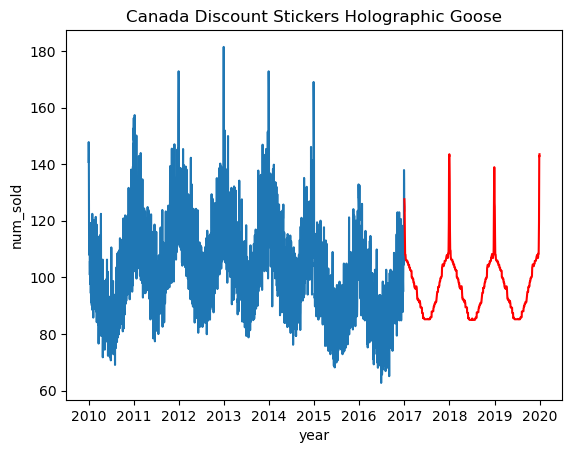

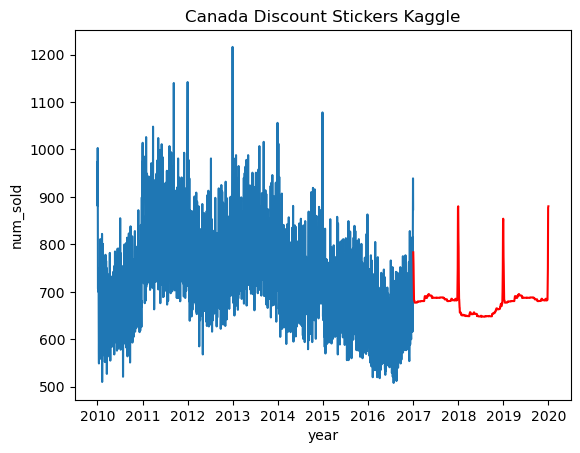

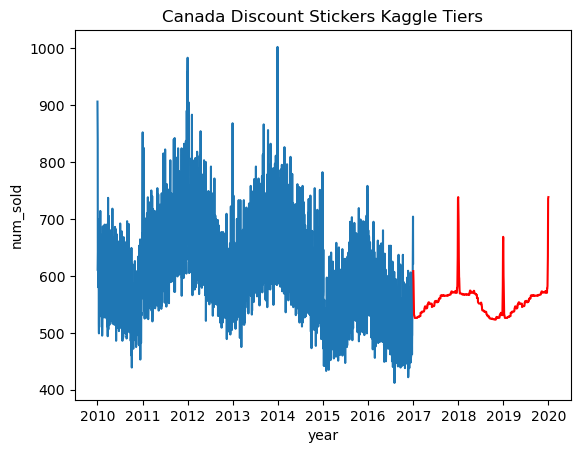

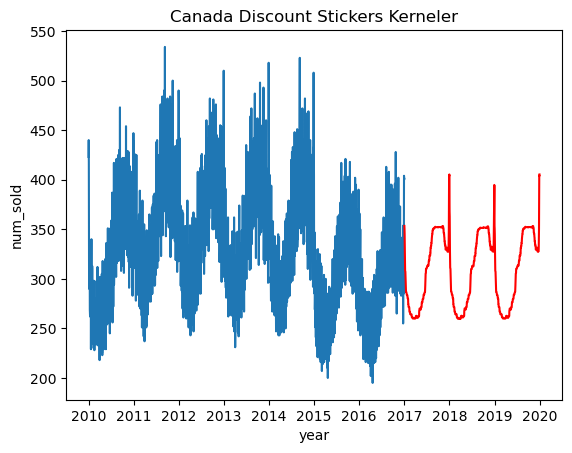

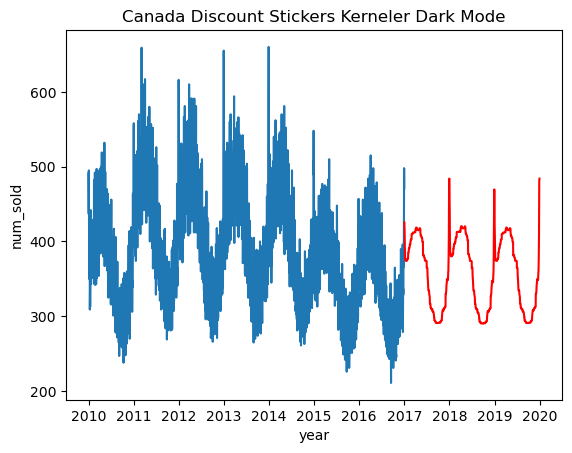

...

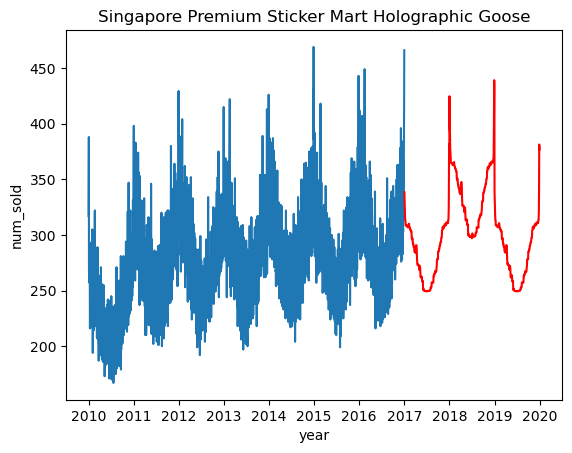

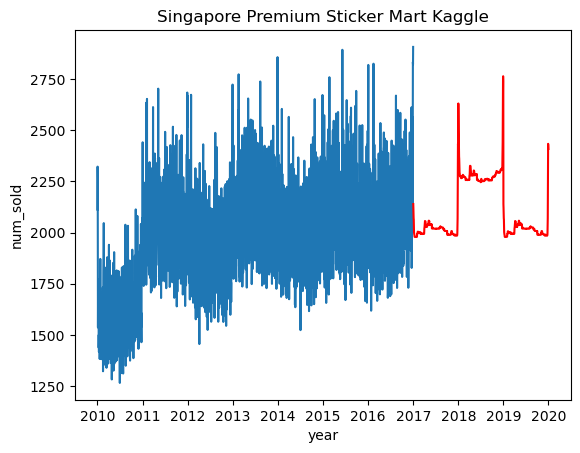

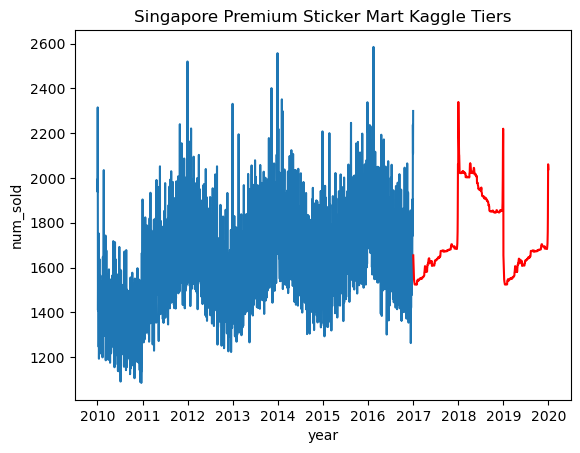

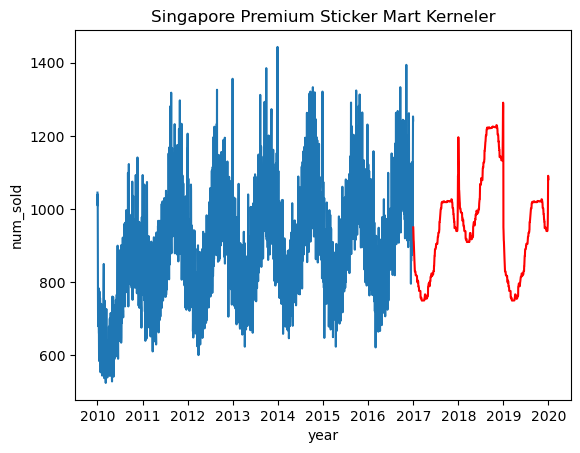

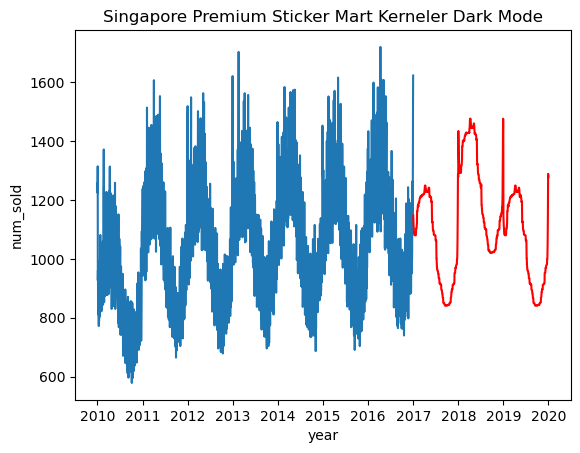

In [44]:
dfTest = pd.merge(dfTest, y_test_pred, on = 'id')
dfTest["date"] = pd.to_datetime(dfTest["date"])
for i in dfTest["country"].unique():
    for j in dfTest["store"].unique():
        for k in dfTest["product"].unique():
            sns.lineplot(data=df.loc[(df["country"] == i) & (df["store"] == j) & (df["product"] == k)], x='date', y=df['num_sold'])
            sns.lineplot(data=dfTest.loc[(dfTest["country"] == i) & (dfTest["store"] == j) & (dfTest["product"] == k)], x='date', y=dfTest['num_sold'], color = "red")
            plt.xlabel('year')                   # X-axis label
            plt.ylabel('num_sold')
            plt.title(f"{i} {j} {k}")
            plt.show()